<a href="https://colab.research.google.com/github/eliottmlg/Statapp-Hail-storm/blob/main/clean/model/fusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Modules à importer

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
from scipy import stats
from sklearn import preprocessing
import scipy
import seaborn as sns
from datetime import datetime
from mpl_toolkits.mplot3d import axes3d
import plotly.express as px
import folium
from sklearn.linear_model import LinearRegression

In [ ]:
!pip install st_dbscan
from st_dbscan import ST_DBSCAN

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 414.9/414.9 kB 11.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for st_dbscan: filename=st_dbscan-0.2.2-py2.py3-none-any.whl size=6845 sha256=5aa7d57bbc47d61b51237d3ab579eb62d9b179c91b3c20bd4b894c10a3f19c3c
  Stored in directory: /root/.cache/pip/wheels/4f/9b/13/026abf2c760c681bd487f56c7a59bce5027d176ded5a4c75a1
Successfully built st_dbscan


## Trash

In [ ]:
df = pd.read_csv('eswd_reports_europe_1970_2022.csv',)
df.dropna(axis = 1, how = 'all',inplace = True)
#df.isnull().sum()


/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3326: DtypeWarning: Columns (18,22,23,24,50,51,77,78,79,85,88) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
mycol = ['ID','QC_LEVEL','TIME_EVENT','TIME_ACCURACY','LATITUDE','LONGITUDE','PLACE_ACCURACY','COUNTRY','MAX_HAIL_DIAMETER']
df2 = df[mycol]

In [ ]:
indices = date(df2)
df3 = df2.loc[indices,:] #we get data after 2007

df3.dropna(axis = 0, subset = ['TIME_ACCURACY'],inplace = True)

In [ ]:
indices2 = precision(df3)

df4 = df3.iloc[indices2,:] # we drop observartions with time acc => 1D

In [ ]:
#def cluster(data,classi):
    orages = []
    n = len(data)
    p = len(np.unique(classi))
    for j in range(p):
        L = []
        for i in range(n):
            if classi[i] == np.unique(classi)[j]:
                L.append(i)
        orages.append(L)
    return orages

## Fonctions à lancer

In [ ]:
def date(df2):
    indices = []
    for i in range(len(df2)):
        a = float(df2.iloc[i,2][0:4])
        if a > 2006:
            id = df2.iloc[i,0]
            indices.append(i)
    return indices

In [ ]:
valide = ['5M','15M','1H','30M','3H','6H','12H'] #we don't want unprecise observations

In [ ]:
def precision(df3):
    L = df3['TIME_ACCURACY'].to_numpy()
    n = len(L)
    indices2 = []
    for i in range(n):
        if L[i] in valide:
            indices2.append(i)
    return indices2

In [ ]:
def get_year(donnee):
    date=donnee['TIME_EVENT']
    dt=datetime.strptime(date,'%Y-%m-%d %H:%M:%S')
    dt=dt.year
    return dt

In [ ]:
#df4['YEAR']=df4.apply(lambda data: get_year(data), axis=1) #we create a YEAR column to help select our training set

In [ ]:
#df4['TIME_EVENT'] = pd.to_datetime(df4['TIME_EVENT'],format = '%Y-%m-%d %H:%M:%S') #we put the columns time_event in datetime format

In [ ]:
#we initialize the first observation of our database at t=0 then we calculate time spent since in hours  
def convert_to_hour(df4,j):
    dftemps = df4.copy()
    début = df4.iloc[-1,j]
    for i in range(len(df4)):
        diff = (df4.iloc[i,j] - début).days*24 + (df4.iloc[i,j]-début).seconds/3600
        dftemps.iloc[i,j] = diff
    return dftemps

In [ ]:
# à tester pour voir si amélioration de cluster
def cluster2(data,classi):
    orages = []
    n = len(data)
    p = len(np.unique(classi))
    for j in range(p):
        L = np.where(classi == j-1)[0]
        orages.append(L)
    return orages

In [ ]:
#to plot j tracks excluding the first one (too many erratic observations)
def constru(X,orages,j,l):
    m = len(orages)
    figure = plt.figure(figsize = (20, 10))
    if j == -1:
        j = m
    for o in range(1,j):
        longitude = [X.iloc[i,2] for i in orages[o]]
        latitude = [X.iloc[i,1] for i in orages[o]]
        plt.scatter(longitude,latitude)
    if j<len(l)-2 :
      plt.title('tracé des n='+str(j-1)+' premiers orages sans le cluster -1')
    else:
      plt.title('tracé de tous les orages sans le cluster -1')
    plt.xlabel('LONGITUDE')
    plt.ylabel('LATITUDE')
    plt.legend()
    plt.show()

## Essais

In [ ]:
orages_test = cluster2(dtf_X,classi)

NameError: ignored

In [ ]:
#we check cluster = cluster2
if len(orages_test) == len(orages):
  L = []
  for i in range(len(orages_test)):
    L.append(sum(orages_test[i] == orages[i]))
print(sum(L) == len(dtf_X))

In [ ]:
#we only use cluster2 which is faster than cluster

In [ ]:
orages_fin = cluster2(dtf_X,classi)

In [ ]:
#mean number of observations per cluster
c=0
for i in range(1,len(orages_fin)):
    c+= len(orages_fin[i])
print(c/(len(orages_fin)-1))


15.941176470588236


In [ ]:
#distribution of the number of observations per cluster
l=[]
for i in range(1,len(orages_fin)):
    l.append(len(orages_fin[i]))

# l = np.unique(classi, return_counts = True)[1]

In [ ]:
l = np.unique(classi, return_counts = True)[1]

In [ ]:
np.mean(l[1:])

15.941176470588236

In [ ]:
l.tolist().index(np.max(l))

43

In [ ]:
np.max(l),orages_fin[l.tolist().index(np.max(l))]

(244, array([417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 427, 428, 429,
        430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442,
        443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 454, 455,
        456, 457, 458, 459, 460, 461, 462, 463, 464, 465, 466, 467, 468,
        469, 470, 471, 472, 473, 474, 475, 476, 477, 478, 479, 480, 481,
        482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493, 494,
        495, 496, 497, 498, 499, 500, 501, 502, 503, 504, 505, 506, 507,
        508, 509, 510, 511, 512, 513, 514, 515, 516, 517, 518, 519, 520,
        521, 522, 523, 524, 525, 526, 527, 528, 529, 530, 531, 532, 533,
        534, 535, 536, 537, 538, 539, 540, 541, 542, 543, 544, 545, 546,
        547, 548, 549, 550, 551, 552, 553, 554, 555, 556, 557, 558, 559,
        560, 561, 562, 563, 564, 565, 566, 567, 568, 569, 570, 571, 572,
        573, 574, 575, 576, 577, 578, 579, 580, 581, 582, 583, 584, 585,
        586, 587, 588, 589, 590, 591, 592, 593

In [ ]:
oragesmax = dtf_X_results[dtf_X_results.CLASSI == l.tolist().index(np.max(l))-1]

In [ ]:
oragesmax

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
3206,135508.166667,47.471,7.308,42
3207,135508.083333,47.533,7.183,42
3208,135508.05,47.549,7.157,42
3209,135508.05,47.502,7.166,42
3210,135508.0,47.564,7.151,42
...,...,...,...,...
3445,135504.7,48.186,6.791,42
3446,135504.7,48.217,6.800,42
3447,135504.466667,47.756,6.131,42
3448,135504.066667,47.885,6.273,42


In [ ]:
oragesmax.describe() #in order to analyze the orage

,LATITUDE,LONGITUDE,CLASSI
count,244.000000,244.000000,244.0
mean,47.942176,6.961381,42.0
std,0.515053,0.546645,0.0
min,47.000000,5.457000,42.0
25%,47.531250,6.667750,42.0
50%,47.893000,7.003500,42.0
75%,48.450250,7.412000,42.0
max,48.801000,7.905000,42.0


In [ ]:
diff_lat = oragesmax.describe().iloc[-1,0] - oragesmax.describe().iloc[3,0]
diff_long = oragesmax.describe().iloc[-1,1] - oragesmax.describe().iloc[3,1]
diff_lat, diff_long

(1.801000000000002, 2.4480000000000004)

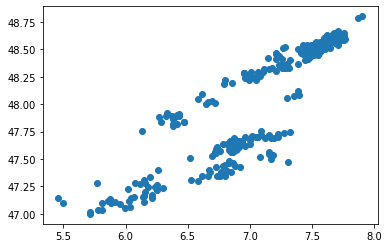

In [ ]:
longitude = [oragesmax.iloc[i,2] for i in range(len(oragesmax))]
latitude = [oragesmax.iloc[i,1] for i in range(len(oragesmax))]
plt.scatter(longitude,latitude)
plt.show()

In [ ]:
#sûrement 2 orages ???

In [ ]:
#we plot the distribution of the clustering (number of observations per storm)

In [ ]:
np.unique(classi, return_counts=True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159]),
 array([137,   2,   7,   7,   8,  17,   6,   2,   5,   3,   3,   2,   4,
          2,  19

In [ ]:
len(l)

161

In [ ]:
l

array([ 83,   2,  26,  15,   6,   2,   5,   3,   3,   2,   4,   2,  23,
        19,   3,   6,   2,   3,   2,   2,   5,   5,  11,  21,  17,   4,
         2,   4,   2,   2,   2,   2,   2,   3,   2,  15,  67,   8,   7,
         2,  26,  33,   7, 244,   2,  16,  15,  14,   2,  11,   3,   8,
         6,   6,  15,   7,   6,   2,   2,   3,   4,   2,   2,   4,  63,
       114,  76, 125,  17,   6,   4,   2,   5,   3,   2,  21,   2,   2,
       190,   3,   4,  11,   2,   3,   4,  10,  12,  38,   4,  23,  10,
         6,  33,   2,   2,   9,   3, 120,  10,   2,  73,  19,   9,   9,
         5,   3,  29,   4,  10,   2,   2,   5,   9,   2,   2,   4,   4,
         2,   6,   2])

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'distribution du nombre de rapports par cluster')

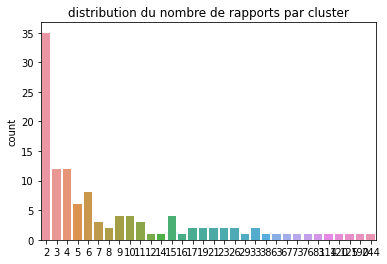

In [ ]:
sns.countplot(l).set_title("distribution du nombre de rapports par cluster")

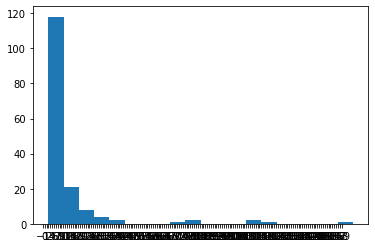

In [ ]:
labels, count = np.unique(classi, return_counts=True)
plt.hist(count[1:], bins = 20)
plt.gca().set_xticks(labels)
plt.show()

In [ ]:
#plot 1 track 
orages1 = orages_fin[1]
longitude = [dtf_X.iloc[i,2] for i in orages1]
latitude = [dtf_X.iloc[i,1] for i in orages1]
plt.scatter(longitude,latitude)
plt.show()

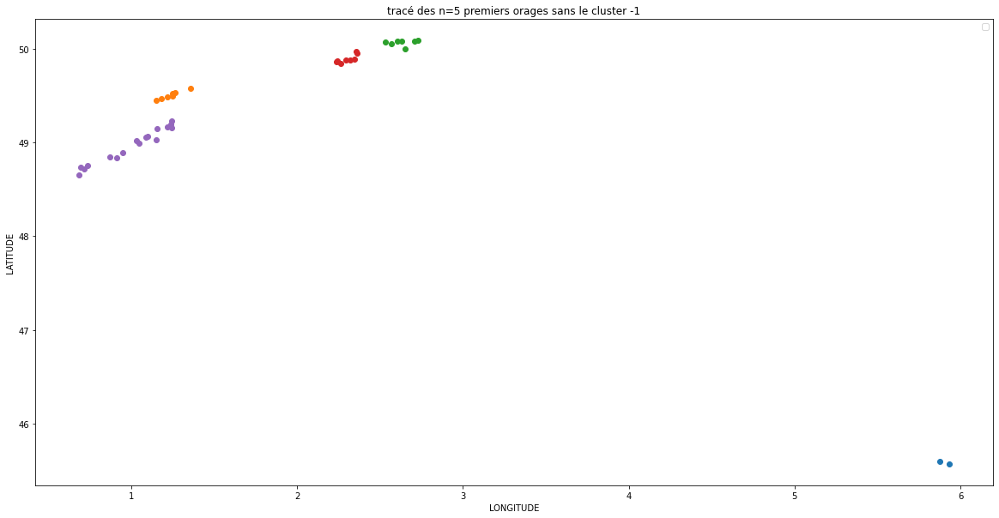

In [ ]:
constru(dtf_X,orages_fin,6)

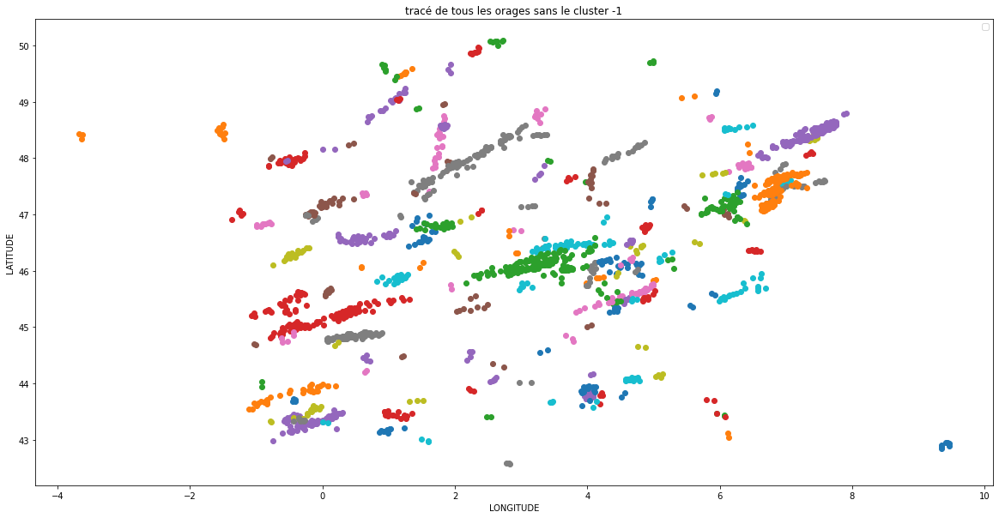

In [ ]:
constru(dtf_X,orages_fin,159)

In [ ]:
orages_test = dtf_X_results[dtf_X_results.CLASSI == 42]

In [ ]:
dtf_X_results.describe().iloc[-1,-1]

159.0

In [ ]:
orages_test

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
3206,135508.166667,47.471,7.308,42
3207,135508.083333,47.533,7.183,42
3208,135508.05,47.549,7.157,42
3209,135508.05,47.502,7.166,42
3210,135508.0,47.564,7.151,42
...,...,...,...,...
3445,135504.7,48.186,6.791,42
3446,135504.7,48.217,6.800,42
3447,135504.466667,47.756,6.131,42
3448,135504.066667,47.885,6.273,42


In [ ]:
m = folium.Map(
            location=[46.8534, 2.3488],
            zoom_start=6
	    )


In [ ]:
points = []
for i in range(len(orages_test)):
  longi = orages_test.iloc[i,2]
  lati = orages_test.iloc[i,1]
  points.append((lati,longi))
  #ajouter cette liste de points à la carte
folium.PolyLine(points, color="red", weight=5, opacity=0.8).add_to(m)

In [ ]:
m

In [ ]:
map = folium.Map(location=[46.8534, 2.3488],zoom_start=6)

In [ ]:
def mapping_FR(dtf_X_results):
  map = folium.Map(location=[46.8534, 2.3488],zoom_start=6)
  n = int(dtf_X_results.describe().iloc[-1,-1])
  colors = ["red",'blue',"green","yellow",'orange','brown','black','purple']
  for i in range(n):
    orages_boucle = dtf_X_results[dtf_X_results.CLASSI == i]
    points = []
    for j in range(len(orages_boucle)):
      longi = orages_boucle.iloc[j,2]
      lati = orages_boucle.iloc[j,1]
      points.append((lati,longi))
    folium.PolyLine(points, color=colors[i%8], weight=5, opacity=0.8).add_to(map)
  map

In [ ]:
mapping_FR(dtf_X_results)

## Fonctions de clustering

In [ ]:
def prep_data():
  df = pd.read_csv('/content/drive/MyDrive/eswd_reports_europe_1970_2022.csv')
  df.dropna(axis = 1, how = 'all',inplace = True)
  mycol = ['ID','QC_LEVEL','TIME_EVENT','TIME_ACCURACY','LATITUDE','LONGITUDE','PLACE_ACCURACY','COUNTRY','MAX_HAIL_DIAMETER']
  df2 = df[mycol]
  indices = date(df2)
  df3 = df2.loc[indices,:]
  df3.dropna(axis = 0, subset = ['TIME_ACCURACY'],inplace = True)
  valide = ['5M','15M','1H','30M','3H','1M','6H','12H']
  indices2 = precision(df3)
  df4 = df3.iloc[indices2,:]
  df4['YEAR']=df4.apply(lambda data: get_year(data), axis=1)
  df4['TIME_EVENT'] = pd.to_datetime(df4['TIME_EVENT'],format = '%Y-%m-%d %H:%M:%S')
  df5 = convert_to_hour(df4,2) #take 1 minute to proceed
  return df5

In [ ]:
df5 = prep_data()

<ipython-input-13-750f03871b76>:2: DtypeWarning: Columns (18,22,23,24,50,51,77,78,79,85,88) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/content/drive/MyDrive/eswd_reports_europe_1970_2022.csv')
<ipython-input-13-750f03871b76>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4['YEAR']=df4.apply(lambda data: get_year(data), axis=1)
<ipython-input-13-750f03871b76>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4['TIME_EVENT'] = pd.to_datetime(df4['TIME

In [ ]:
def visu(df5,country,year,var_eps1,var_eps2,var_min_samples):
  print('model = spatial: ',var_eps1,', time :',var_eps2,', min_samples :',var_min_samples )
  data = df5[df5.YEAR == year]
  data = data[data.COUNTRY == country]
  data_visu = data[['TIME_EVENT','LATITUDE','LONGITUDE']]
  model_visu = ST_DBSCAN(eps1=var_eps1, eps2=var_eps2,
                         min_samples=var_min_samples)
  model_visu.fit(data_visu)
  classi_visu = model_visu.labels
  visu_results = data_visu.copy()
  visu_results['CLASSI'] = classi_visu
  orages_visu = cluster2(data_visu,classi_visu)
  #stats about clustering distribution 
  # l_visu : list with number of observations per orage without the -1
  l_visu = np.unique(classi_visu, return_counts = True)[1]
  #number of clusters
  print('we cluster',len(l_visu)-1,'orages in',country,'during the year',year)
  percentage = round((l_visu[0]/len(data_visu))*100,1)
  print("we can't cluster", l_visu[0],'obsverations over',len(data_visu),'(',percentage,'%)')
  #mean observations per orage
  print('In',country,'during the year',year,'the mean number of observations per orage is', round(np.mean(l_visu[1:]),3))
  print('In',country,'during the year',year,'the median number of observations per orage is', np.median(l_visu[1:]))
  # max obsverations for an orage
  orage_max = l_visu.tolist().index(np.max(l_visu[1:]))
  print('the biggest orage has been reported',np.max(l_visu[1:]),'times')
  data_max = visu_results[visu_results.CLASSI == (orage_max -1)]
  #we check the size of this orage
  large = round(data_max.describe().iloc[-1,1] - data_max.describe().iloc[3,1],3)
  high = round(data_max.describe().iloc[-1,0] - data_max.describe().iloc[3,0],3)
  timezer = round(data_max.iloc[0,0] - data_max.iloc[-1,0],1)
  hours = int(timezer)
  minutes = round((timezer - hours)*60)
  print('the biggest orage has moved :',large,'longitude degrees and',high,'latitude degrees')
  print('the biggest orage has last :',hours,'h',minutes,'min')
  #we plot this orage_max
  plt.figure(1)
  longitude = [data_max.iloc[i,2] for i in range(len(data_max))]
  latitude = [data_max.iloc[i,1] for i in range(len(data_max))]
  temps = [data_max.iloc[i,0] - data_max.iloc[-1,0] for i in range(len(data_max))]
  plt.scatter(longitude,latitude, c = temps)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.title('track of the biggest orage')
  plt.show()
  #plot the distribution of the number of obsverations per cluster
  sns.displot(x = l_visu)#.set_title("distribution of the number of observations per cluster")
  #we plot all of the orages
  constru(data_visu,orages_visu,len(l_visu)-2,l_visu)
  return visu_results


In [ ]:
def visu_from_year(df5,country,year,var_eps1,var_eps2,var_min_samples):
  print('model = spatial: ',var_eps1,', time :',var_eps2,', min_samples :',var_min_samples )
  data = df5[df5.YEAR > year]
  data = data[data.COUNTRY == country]
  data_visu = data[['TIME_EVENT','LATITUDE','LONGITUDE']]
  model_visu = ST_DBSCAN(eps1=var_eps1, eps2=var_eps2,
                         min_samples=var_min_samples)
  model_visu.fit(data_visu)
  classi_visu = model_visu.labels
  visu_results = data_visu.copy()
  visu_results['CLASSI'] = classi_visu
  orages_visu = cluster2(data_visu,classi_visu)
  #stats about clustering distribution 
  # l_visu : list with number of observations per orage without the -1
  l_visu = np.unique(classi_visu, return_counts = True)[1]
  #number of clusters
  print('we cluster',len(l_visu)-1,'orages in',country,'during the year',year)
  percentage = round((l_visu[0]/len(data_visu))*100,1)
  print("we can't cluster", l_visu[0],'obsverations over',len(data_visu),'(',percentage,'%)')
  #mean observations per orage
  print('In',country,'during the year',year,'the mean number of observations per orage is', round(np.mean(l_visu[1:]),3))
  print('In',country,'during the year',year,'the median number of observations per orage is', np.median(l_visu[1:]))
  # max obsverations for an orage
  orage_max = l_visu.tolist().index(np.max(l_visu[1:]))
  print('the biggest orage has been reported',np.max(l_visu[1:]),'times')
  data_max = visu_results[visu_results.CLASSI == (orage_max -1)]
  #we check the size of this orage
  large = round(data_max.describe().iloc[-1,1] - data_max.describe().iloc[3,1],3)
  high = round(data_max.describe().iloc[-1,0] - data_max.describe().iloc[3,0],3)
  timezer = round(data_max.iloc[0,0] - data_max.iloc[-1,0],1)
  hours = int(timezer)
  minutes = round((timezer - hours)*60)
  print('the biggest orage has moved :',large,'longitude degrees and',high,'latitude degrees')
  print('the biggest orage has last :',hours,'h',minutes,'min')
  #we plot this orage_max
  plt.figure(1)
  longitude = [data_max.iloc[i,2] for i in range(len(data_max))]
  latitude = [data_max.iloc[i,1] for i in range(len(data_max))]
  temps = [data_max.iloc[i,0] - data_max.iloc[-1,0] for i in range(len(data_max))]
  plt.scatter(longitude,latitude, c = temps)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.title('track of the biggest orage')
  plt.show()
  #plot the distribution of the number of obsverations per cluster
  sns.displot(x = l_visu)#.set_title("distribution of the number of observations per cluster")
  #we plot all of the orages
  constru(data_visu,orages_visu,len(l_visu)-2,l_visu)
  return visu_results


model = spatial:  0.16 , time : 1 , min_samples : 2
we cluster 182 orages in FR during the year 2022
we can't cluster 188 obsverations over 1980 ( 9.5 %)
In FR during the year 2022 the mean number of observations per orage is 9.846
In FR during the year 2022 the median number of observations per orage is 4.5
the biggest orage has been reported 117 times
the biggest orage has moved : 0.833 longitude degrees and 0.169 latitude degrees
the biggest orage has last : 1 h 12 min


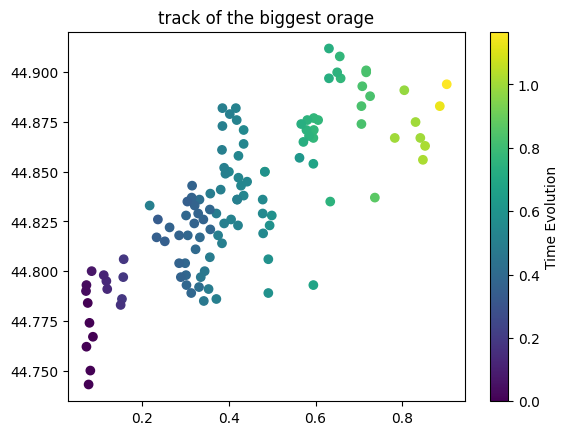

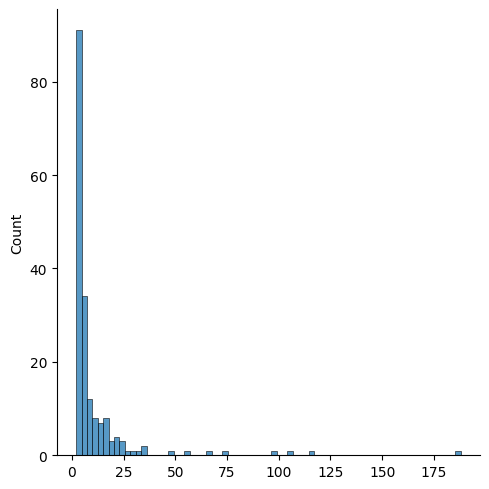

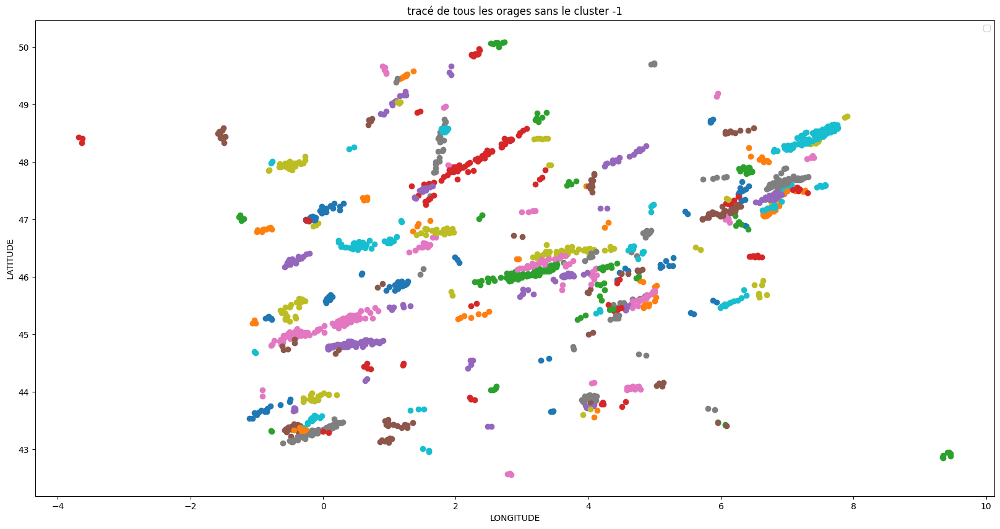

In [ ]:
visu_results = visu(df5,'FR',2022,0.16,1,2)

# TESTS VISU

model = spatial:  0.16 , time : 1 , min_samples : 2
we cluster 182 orages in FR during the year 2022
we can't cluster 188 obsverations over 1980 ( 9.5 %)
In FR during the year 2022 the mean number of observations per orage is 9.846
In FR during the year 2022 the median number of observations per orage is 4.5
the biggest orage has been reported 117 times
the biggest orage has moved : 0.833 longitude degrees and 0.169 latitude degrees
the biggest orage has last : 1 h 12 min


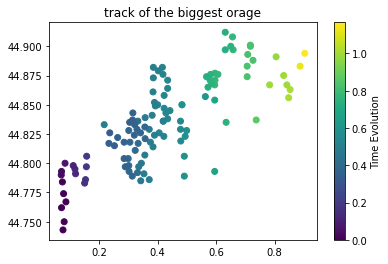

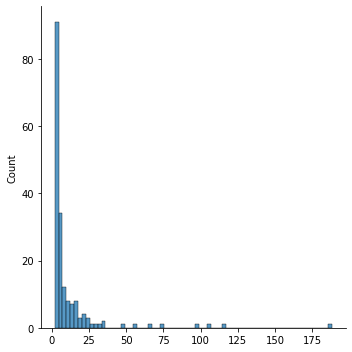

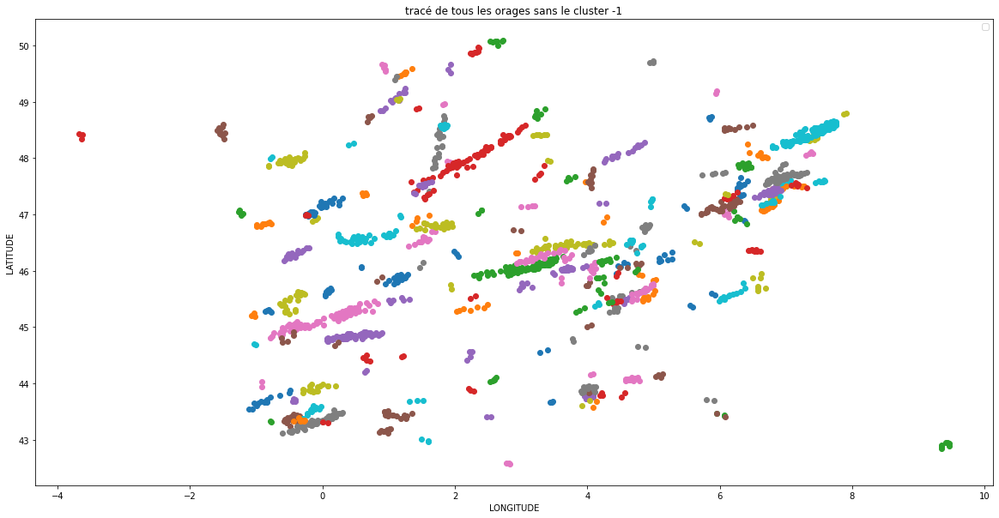

In [ ]:
visu_results = visu(df5,'FR',2022,0.16,1,2)

model = spatial:  0.2 , time : 2 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 139 obsverations over 1980 ( 7.0 %)
In FR during the year 2022 the mean number of observations per orage is 11.506
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


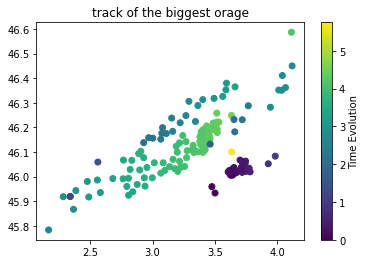

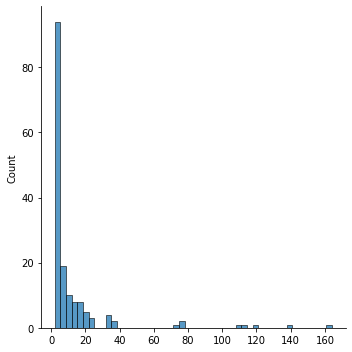

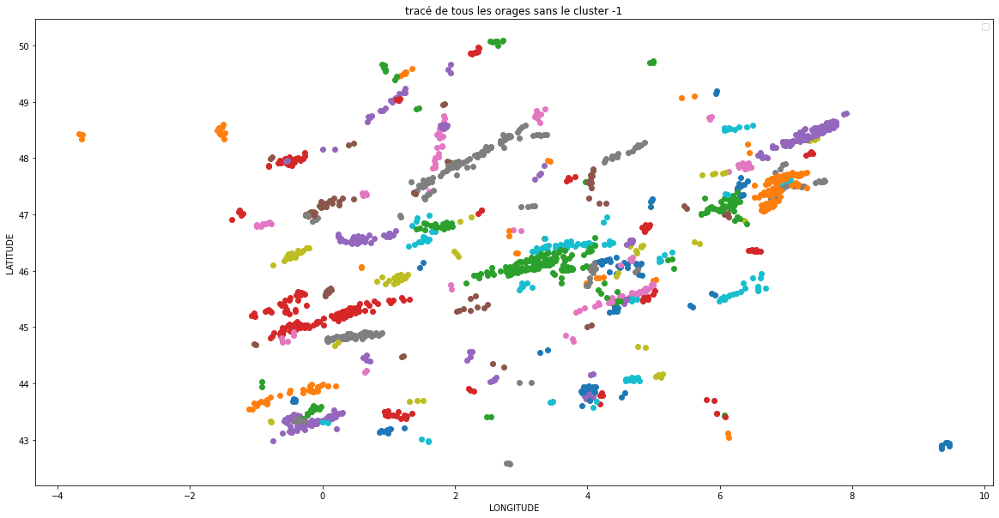

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,158
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,159
7309,133604.083333,48.636,4.952,159


In [ ]:
visu(df5,'FR',2022,0.2,2,2)

model = spatial:  0.2 , time : 3 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 137 obsverations over 1980 ( 6.9 %)
In FR during the year 2022 the mean number of observations per orage is 11.519
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 165 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 6 h 30 min


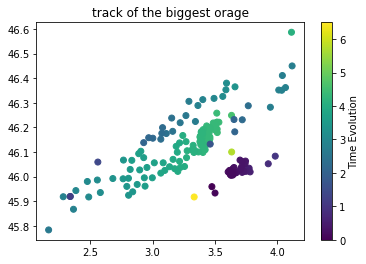

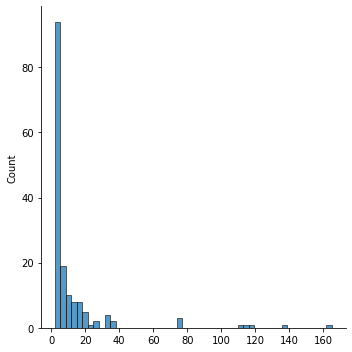

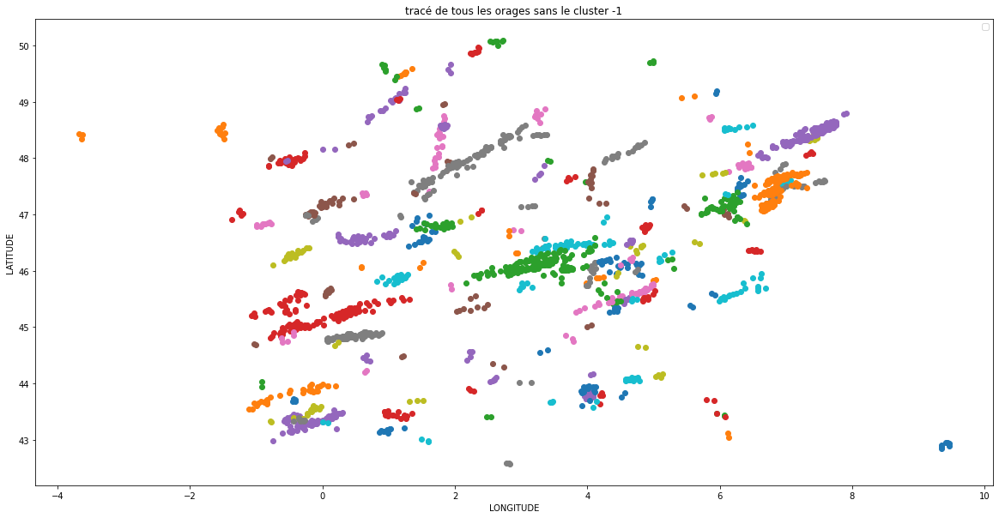

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,158
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,159
7309,133604.083333,48.636,4.952,159


In [ ]:
visu(df5,'FR',2022,0.2,3,2)

model = spatial:  0.2 , time : 2 , min_samples : 3
we cluster 104 orages in FR during the year 2022
we can't cluster 251 obsverations over 1980 ( 12.7 %)
In FR during the year 2022 the mean number of observations per orage is 16.625
In FR during the year 2022 the median number of observations per orage is 7.5
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


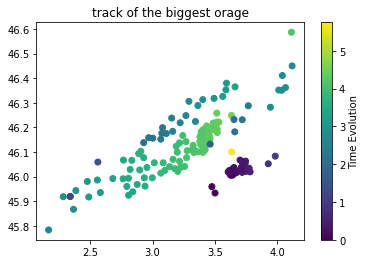

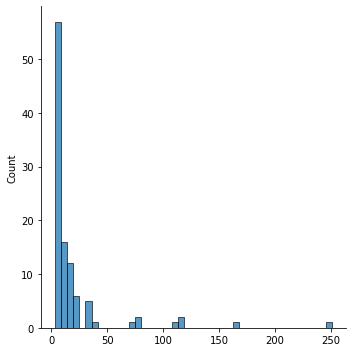

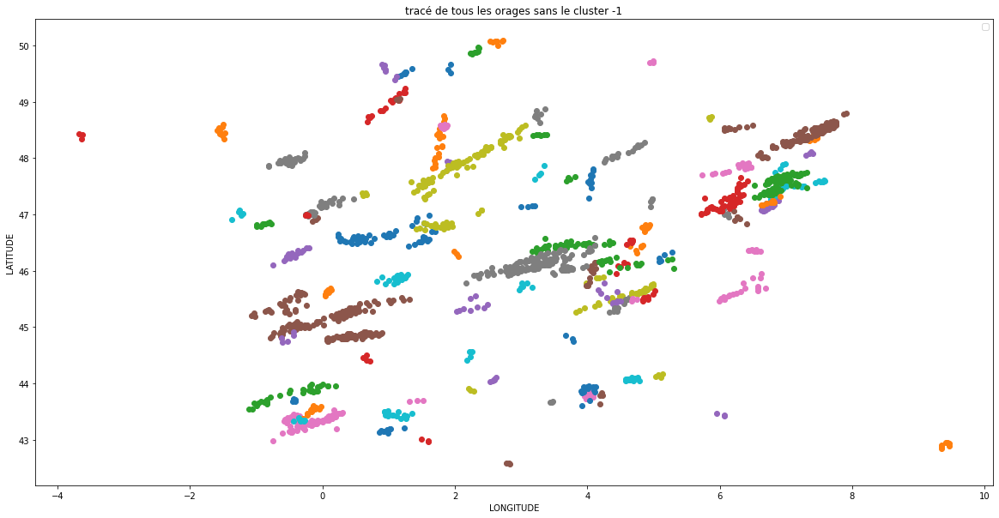

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,-1
1,138375.783333,45.596,5.875,-1
4,138358.416667,49.583,1.358,0
5,138358.333333,49.533,1.267,0
6,138358.3,49.521,1.251,0
...,...,...,...,...
7274,133961.583333,43.279,2.460,103
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
visu(df5,'FR',2022,0.2,2,3)

model = spatial:  0.2 , time : 3 , min_samples : 2
we cluster 81 orages in DE during the year 2022
we can't cluster 79 obsverations over 577 ( 13.7 %)
In DE during the year 2022 the mean number of observations per orage is 6.148
In DE during the year 2022 the median number of observations per orage is 3.0
the biggest orage has been reported 58 times
the biggest orage has moved : 1.806 longitude degrees and 0.288 latitude degrees
the biggest orage has last : 5 h 18 min


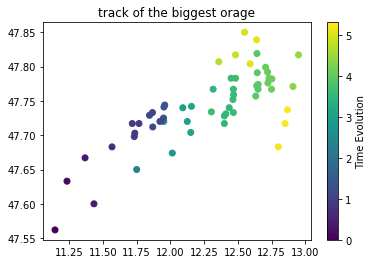

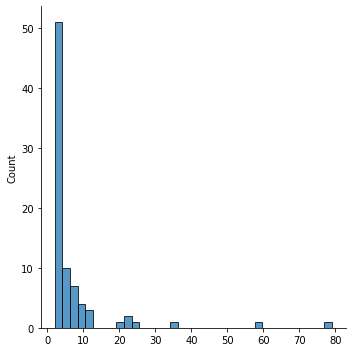

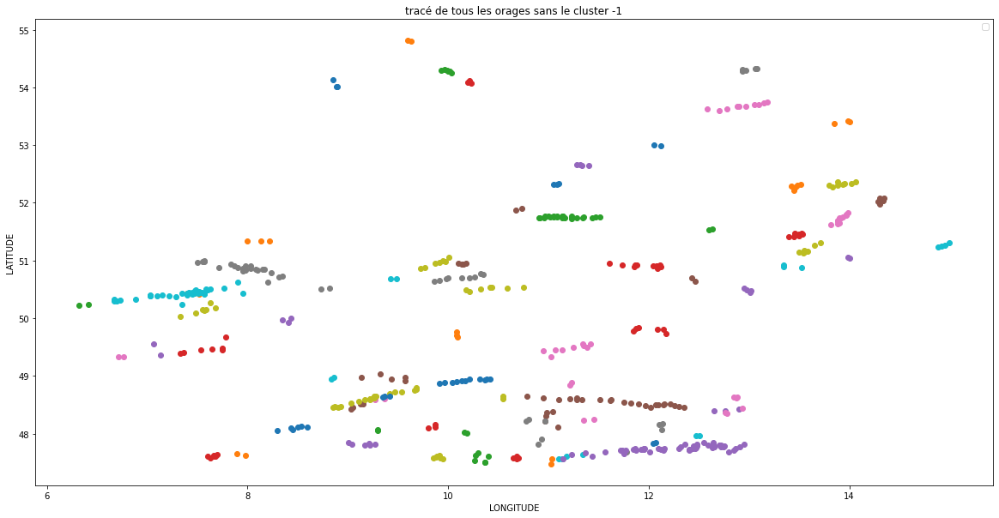

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
183,137544.083333,53.783,11.517,-1
184,137541.583333,53.550,12.983,-1
186,137539.75,52.983,12.117,0
187,137539.75,54.800,9.633,1
188,137539.666667,54.817,9.600,1
...,...,...,...,...
7117,134229.333333,50.667,10.483,-1
7166,134201.35,48.043,8.305,-1
7228,134032.416667,47.900,7.667,-1
7235,134012.583333,50.267,8.450,80


In [ ]:
visu(df5,'DE',2022,0.2,3,2)

model = spatial:  0.2 , time : 3 , min_samples : 2
we cluster 64 orages in PL during the year 2021
we can't cluster 89 obsverations over 1067 ( 8.3 %)
In PL during the year 2021 the mean number of observations per orage is 15.281
In PL during the year 2021 the median number of observations per orage is 3.0
the biggest orage has been reported 349 times
the biggest orage has moved : 2.274 longitude degrees and 1.145 latitude degrees
the biggest orage has last : 8 h 42 min


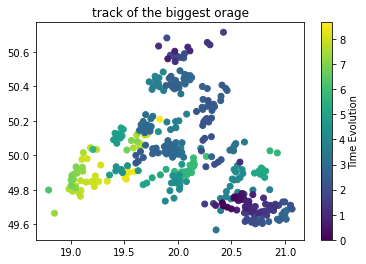

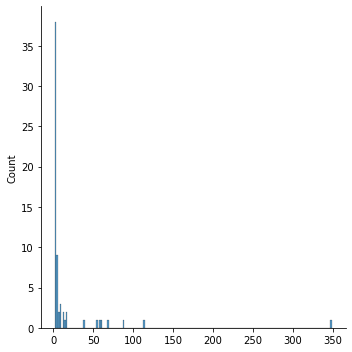

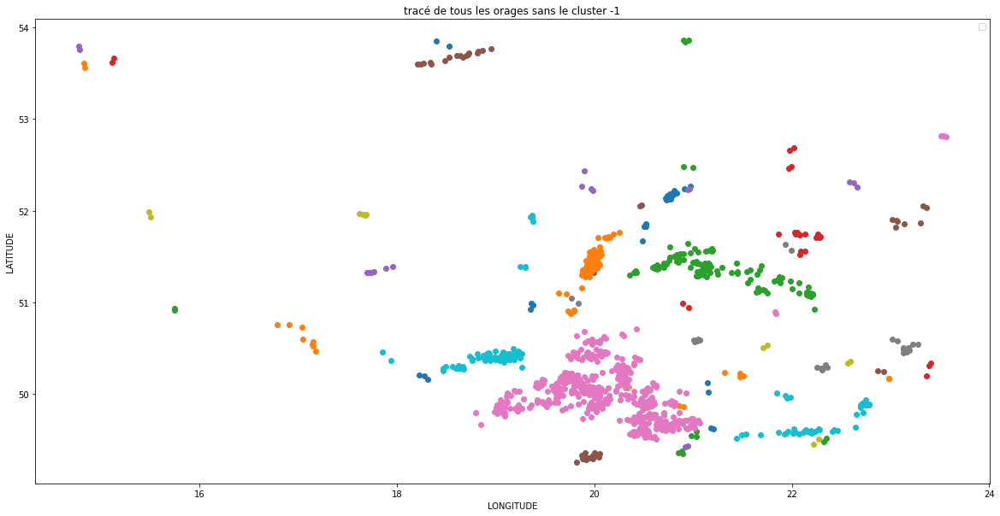

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
7525,128588.083333,52.904,16.732,-1
7526,128586.083333,54.436,17.888,-1
7527,128585.583333,54.256,18.111,-1
7790,127966.133333,52.271,20.975,0
7792,127965.916667,52.237,20.913,0
...,...,...,...,...
12478,125659.916667,50.465,17.175,61
12479,125659.75,50.417,16.442,63
12480,125659.5,50.405,16.289,63
12481,125659.25,50.387,16.361,63


In [ ]:
visu(df5,'PL',2021,0.2,3,2)

In [ ]:
spatial_params = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8]
time_params = [1,2,3,4,5,6,7]
sample_params = [1,2,3,4,5,6,7]

In [ ]:
def grid(df5,country,year,sp_params,t_params,sa_params):
  for eps1 in sp_params:
    for eps2 in t_params:
      for eps3 in sa_params:
        visu(df5,country,year,eps1,eps2,eps3)

model = spatial:  0.2 , time : 2 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 139 obsverations over 1980 ( 7.0 %)
In FR during the year 2022 the mean number of observations per orage is 11.506
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


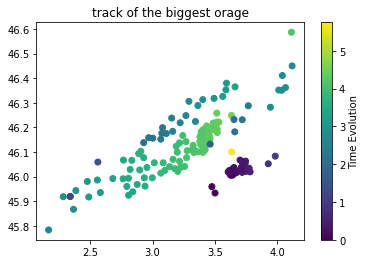

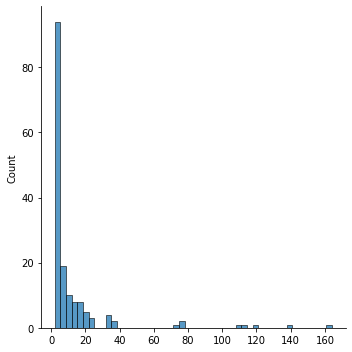

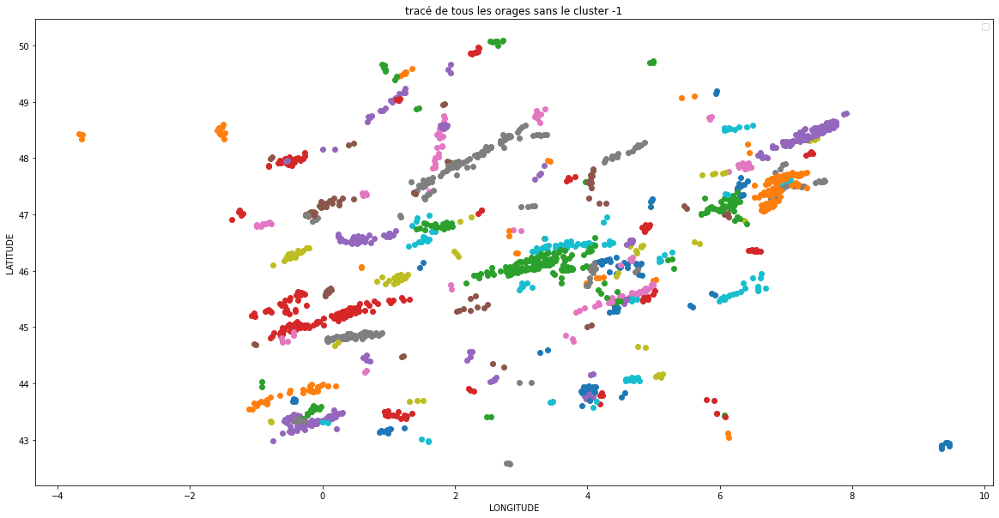

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,158
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,159
7309,133604.083333,48.636,4.952,159


In [ ]:
visu(df5,'FR',2022,0.2,2,2)

model = spatial:  0.15 , time : 1 , min_samples : 2
we cluster 191 orages in FR during the year 2022
we can't cluster 193 obsverations over 1980 ( 9.7 %)
In FR during the year 2022 the mean number of observations per orage is 9.356
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 117 times
the biggest orage has moved : 0.833 longitude degrees and 0.169 latitude degrees
the biggest orage has last : 1 h 12 min


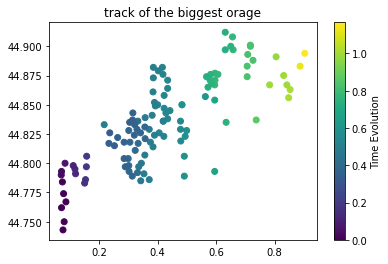

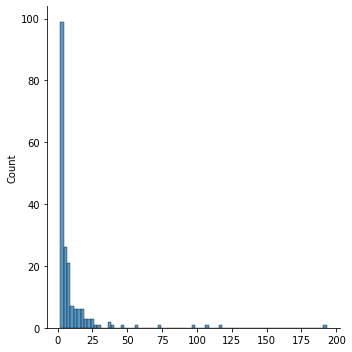

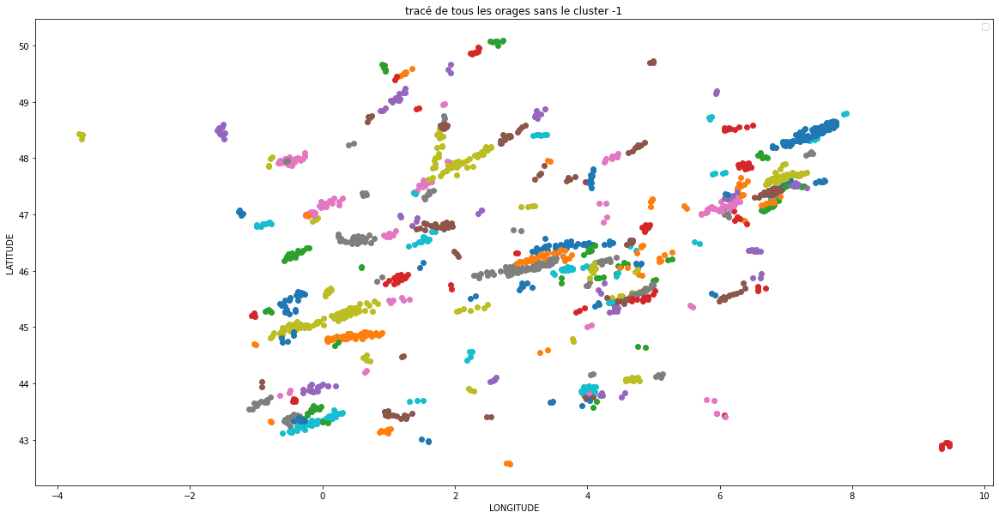

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,190
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
visu(df5,'FR',2022,0.15,1,2)

#Influence of spatial threshold in st_dbscan

we fix the time threshold and min_samples parameters and we change spatial threshold

In [ ]:
time_fix = [3]
sample_fix = [3]

model = spatial:  0.1 , time : 3 , min_samples : 3
we cluster 136 orages in FR during the year 2022
we can't cluster 376 obsverations over 1980 ( 19.0 %)
In FR during the year 2022 the mean number of observations per orage is 11.794
In FR during the year 2022 the median number of observations per orage is 6.0
the biggest orage has been reported 118 times
the biggest orage has moved : 0.833 longitude degrees and 0.169 latitude degrees
the biggest orage has last : 2 h 42 min


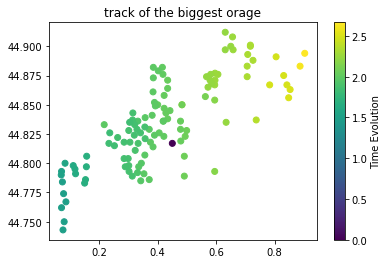

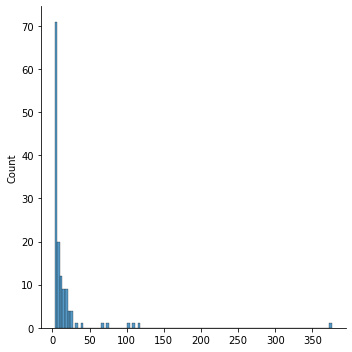

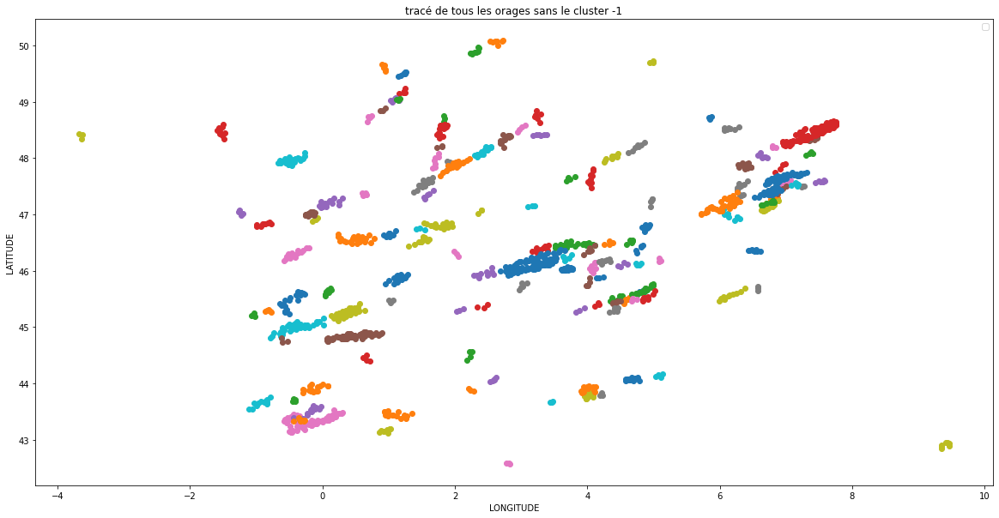

model = spatial:  0.2 , time : 3 , min_samples : 3
we cluster 104 orages in FR during the year 2022
we can't cluster 249 obsverations over 1980 ( 12.6 %)
In FR during the year 2022 the mean number of observations per orage is 16.644
In FR during the year 2022 the median number of observations per orage is 7.5
the biggest orage has been reported 165 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 6 h 30 min


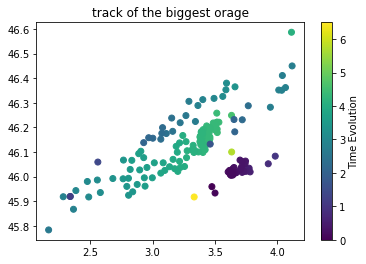

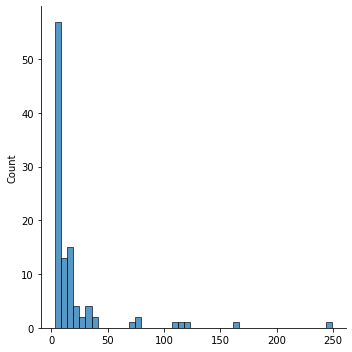

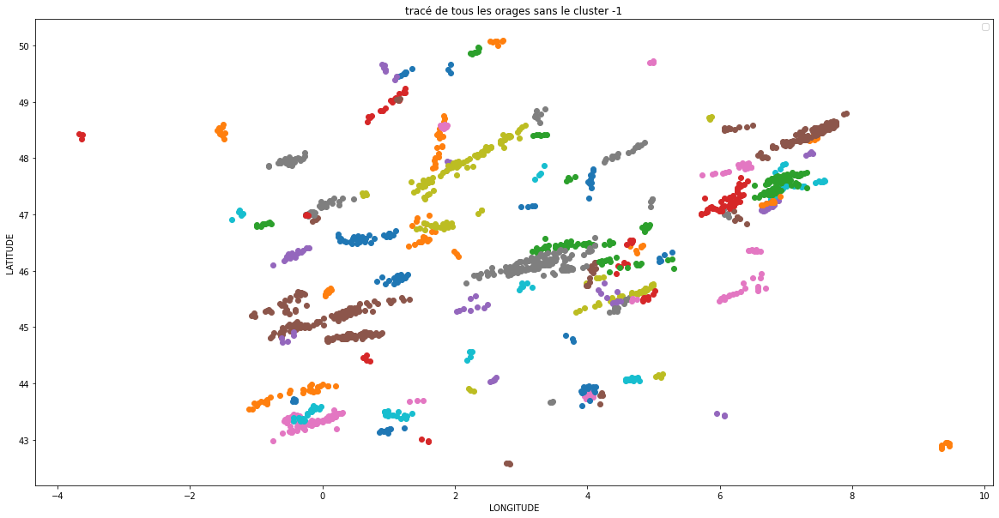

model = spatial:  0.3 , time : 3 , min_samples : 3
we cluster 88 orages in FR during the year 2022
we can't cluster 189 obsverations over 1980 ( 9.5 %)
In FR during the year 2022 the mean number of observations per orage is 20.352
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 186 times
the biggest orage has moved : 2.878 longitude degrees and 1.152 latitude degrees
the biggest orage has last : 7 h 30 min


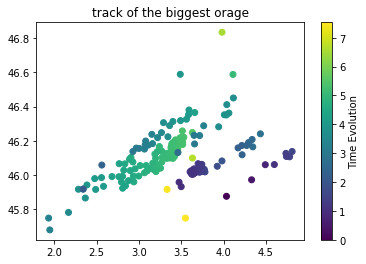

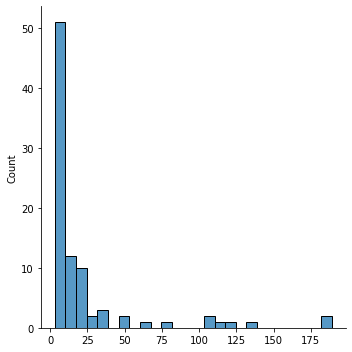

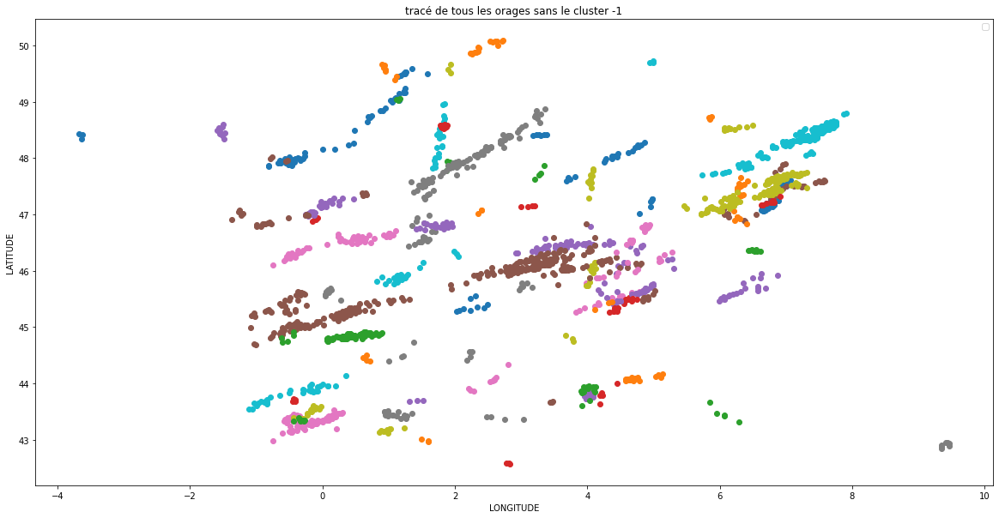

model = spatial:  0.4 , time : 3 , min_samples : 3
we cluster 84 orages in FR during the year 2022
we can't cluster 156 obsverations over 1980 ( 7.9 %)
In FR during the year 2022 the mean number of observations per orage is 21.714
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


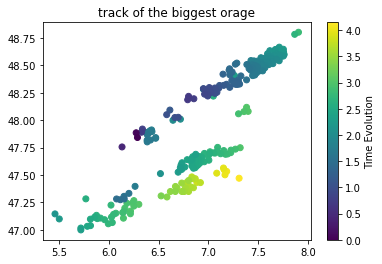

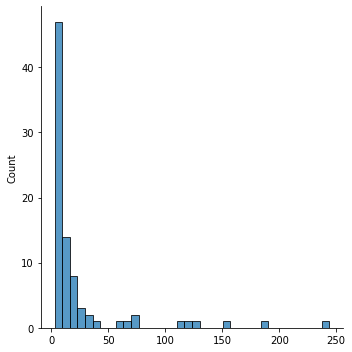

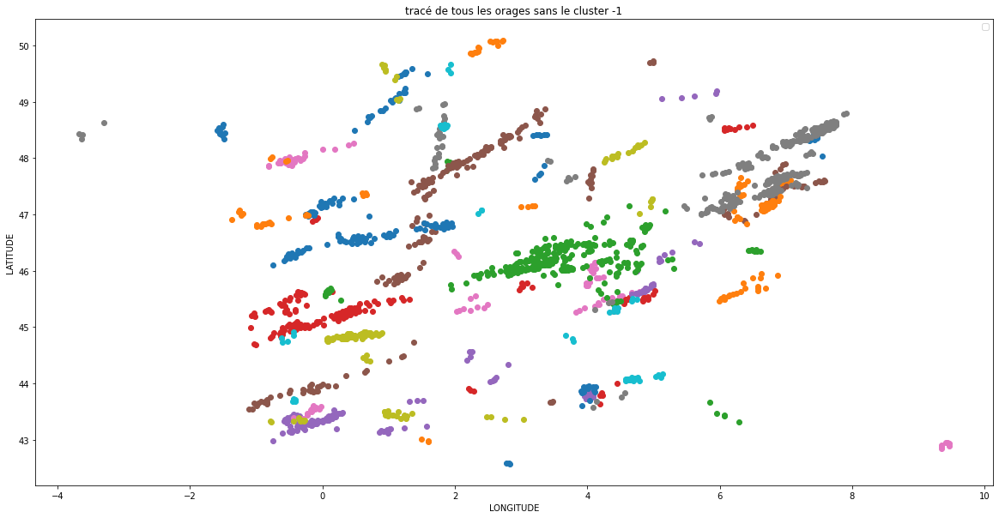

model = spatial:  0.5 , time : 3 , min_samples : 3
we cluster 83 orages in FR during the year 2022
we can't cluster 124 obsverations over 1980 ( 6.3 %)
In FR during the year 2022 the mean number of observations per orage is 22.361
In FR during the year 2022 the median number of observations per orage is 9.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


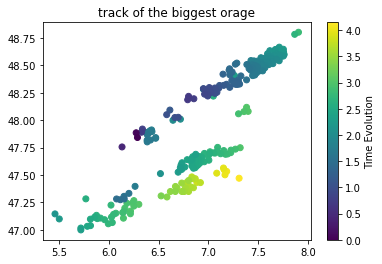

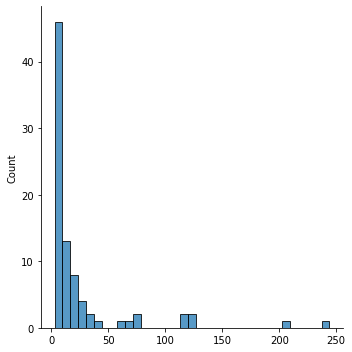

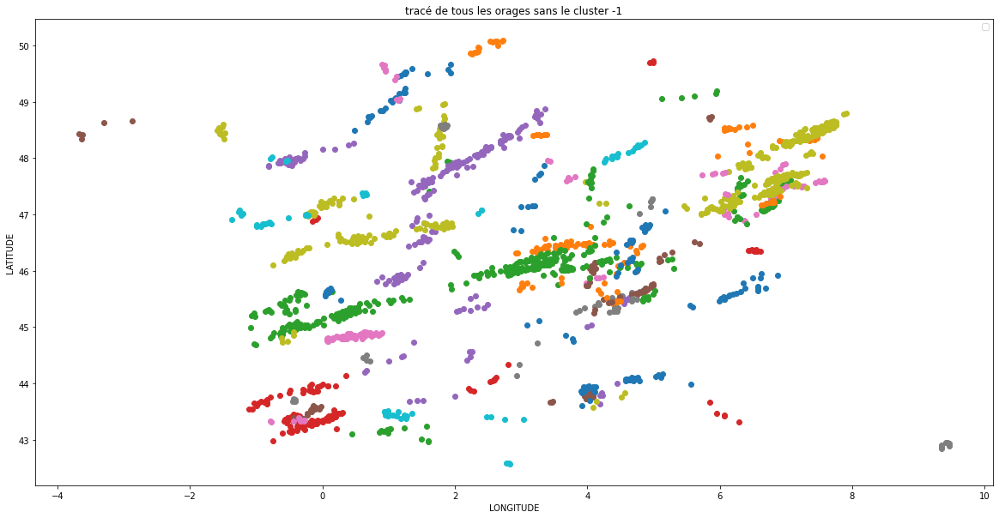

model = spatial:  0.6 , time : 3 , min_samples : 3
we cluster 78 orages in FR during the year 2022
we can't cluster 112 obsverations over 1980 ( 5.7 %)
In FR during the year 2022 the mean number of observations per orage is 23.949
In FR during the year 2022 the median number of observations per orage is 9.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


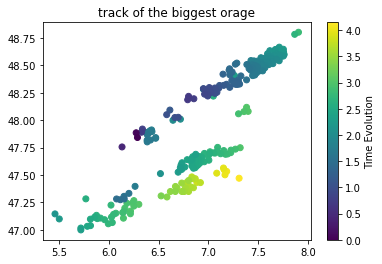

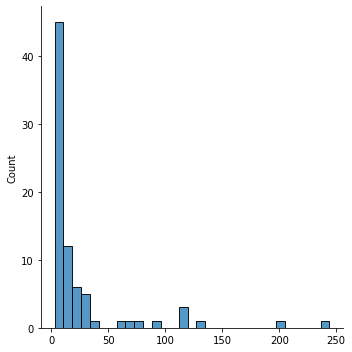

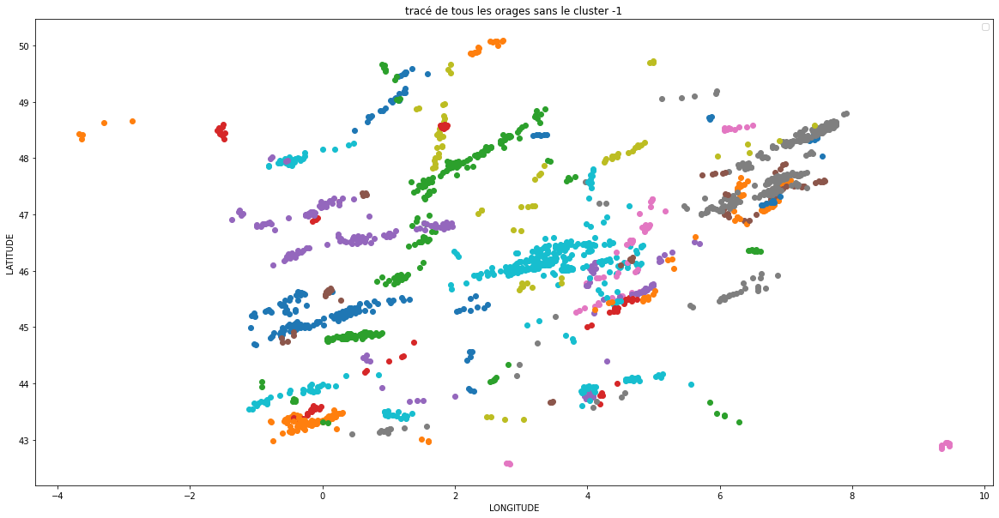

model = spatial:  0.7 , time : 3 , min_samples : 3
we cluster 73 orages in FR during the year 2022
we can't cluster 104 obsverations over 1980 ( 5.3 %)
In FR during the year 2022 the mean number of observations per orage is 25.699
In FR during the year 2022 the median number of observations per orage is 9.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


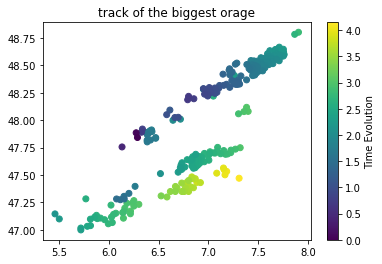

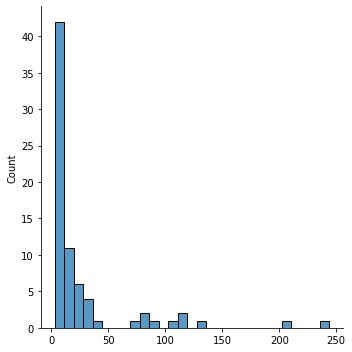

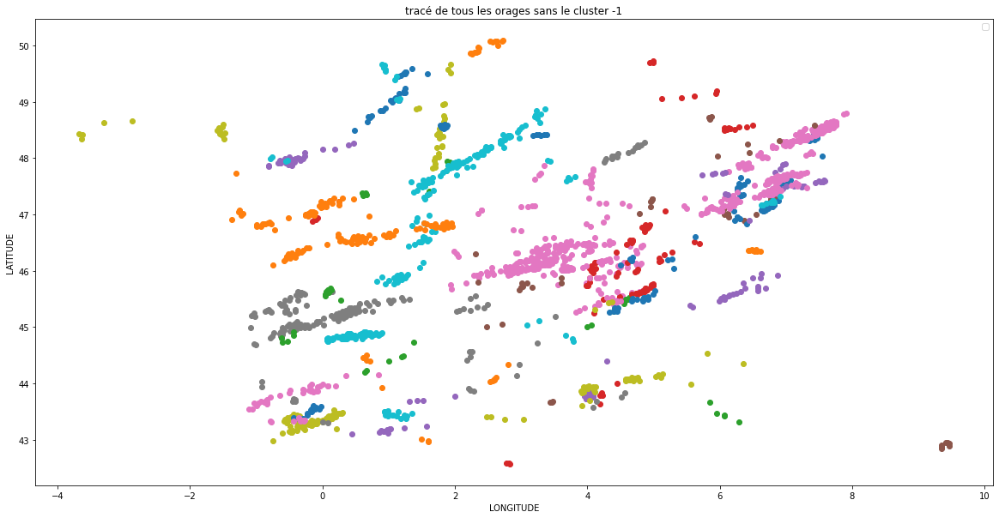

model = spatial:  0.8 , time : 3 , min_samples : 3
we cluster 72 orages in FR during the year 2022
we can't cluster 93 obsverations over 1980 ( 4.7 %)
In FR during the year 2022 the mean number of observations per orage is 26.208
In FR during the year 2022 the median number of observations per orage is 9.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


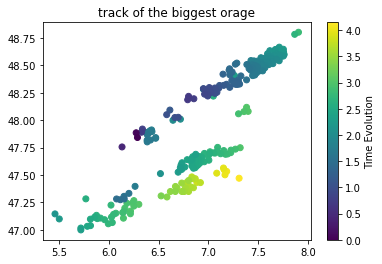

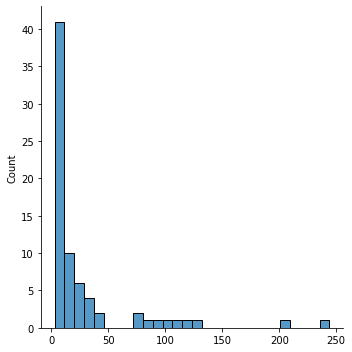

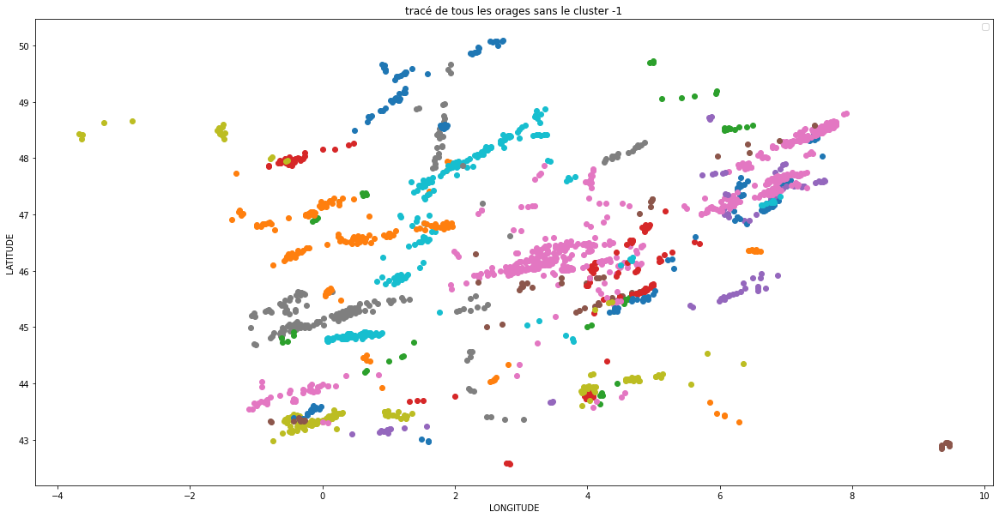

In [ ]:
grid(df5,'FR',2022,spatial_params,time_fix,sample_fix)

#Influence of time threshold in st_dbscan

In [ ]:
spatial_fix = [0.3]
sample_fix = [2]

model = spatial:  0.4 , time : 1 , min_samples : 3
we cluster 93 orages in FR during the year 2022
we can't cluster 175 obsverations over 1980 ( 8.8 %)
In FR during the year 2022 the mean number of observations per orage is 19.409
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


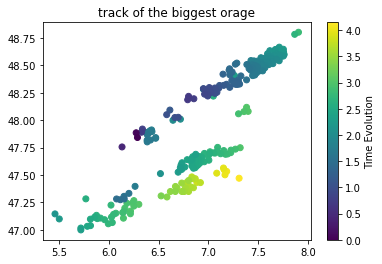

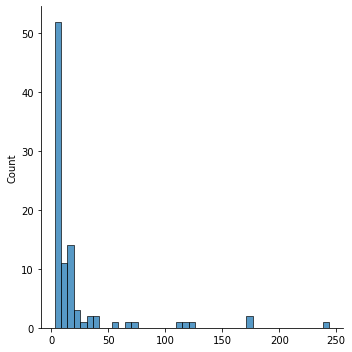

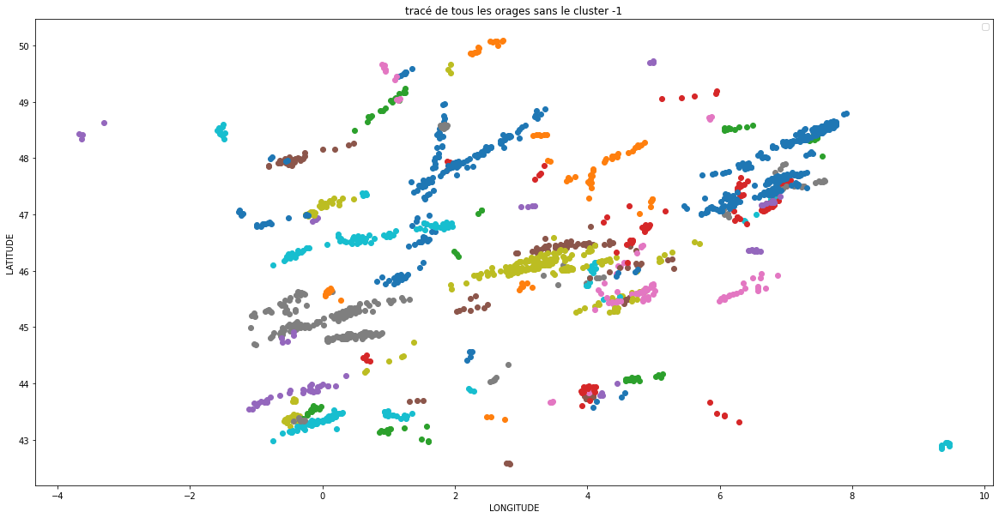

model = spatial:  0.4 , time : 2 , min_samples : 3
we cluster 86 orages in FR during the year 2022
we can't cluster 156 obsverations over 1980 ( 7.9 %)
In FR during the year 2022 the mean number of observations per orage is 21.209
In FR during the year 2022 the median number of observations per orage is 7.5
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


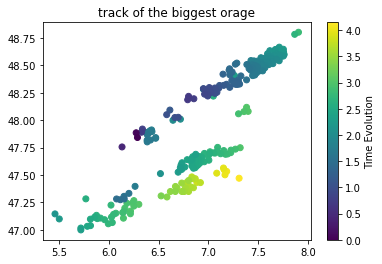

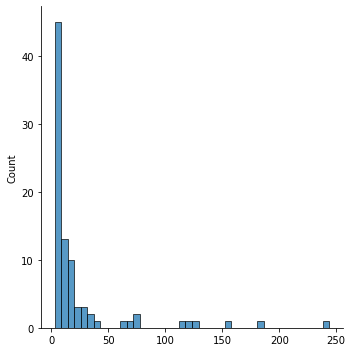

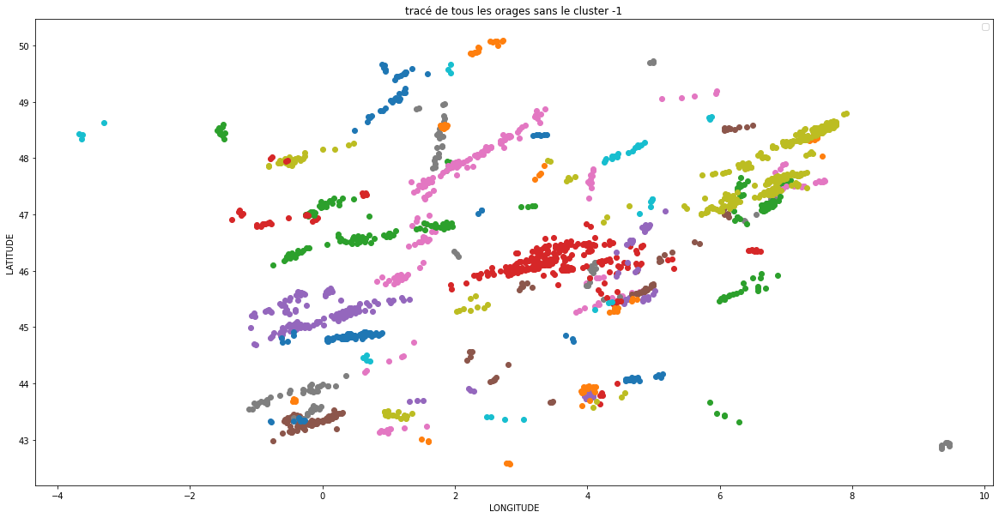

model = spatial:  0.4 , time : 3 , min_samples : 3
we cluster 84 orages in FR during the year 2022
we can't cluster 156 obsverations over 1980 ( 7.9 %)
In FR during the year 2022 the mean number of observations per orage is 21.714
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


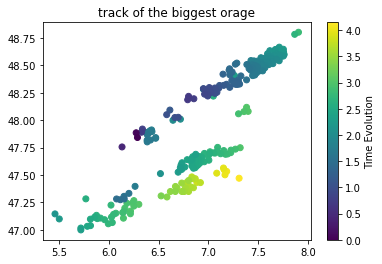

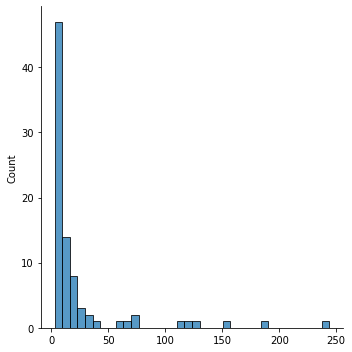

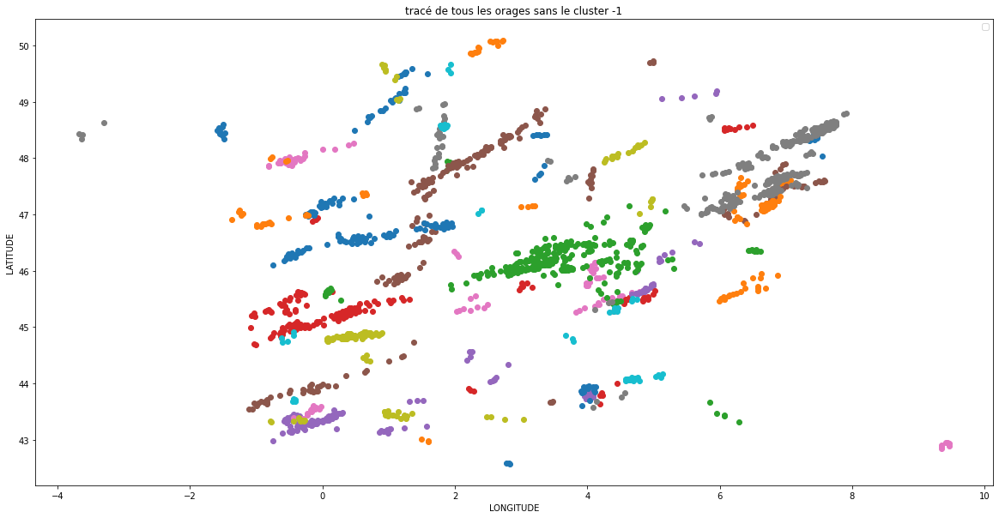

model = spatial:  0.4 , time : 4 , min_samples : 3
we cluster 84 orages in FR during the year 2022
we can't cluster 153 obsverations over 1980 ( 7.7 %)
In FR during the year 2022 the mean number of observations per orage is 21.75
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


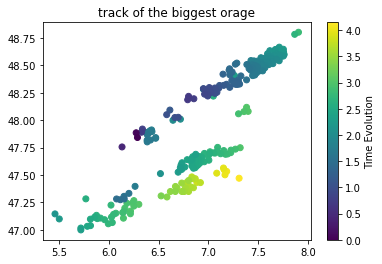

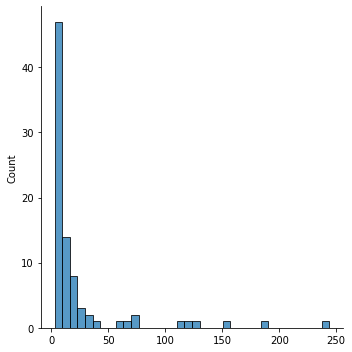

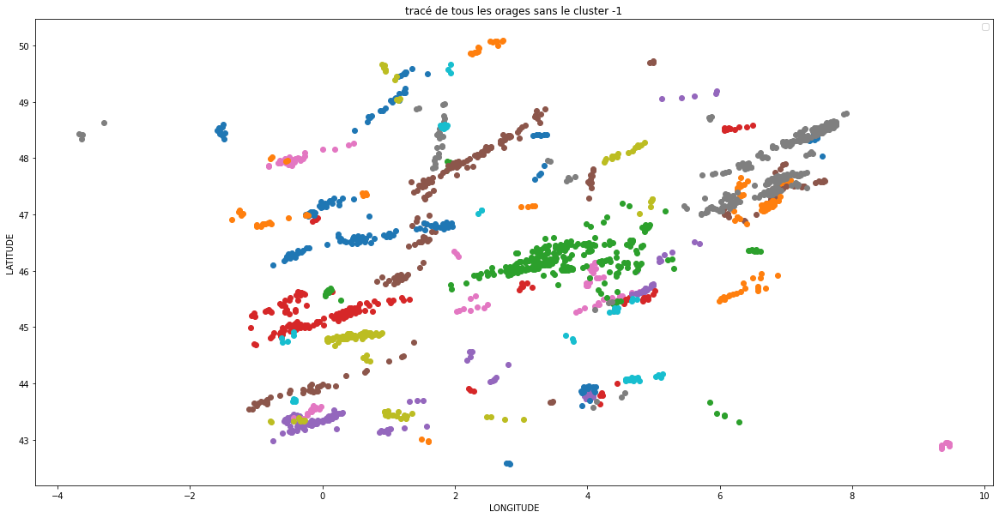

model = spatial:  0.4 , time : 5 , min_samples : 3
we cluster 84 orages in FR during the year 2022
we can't cluster 151 obsverations over 1980 ( 7.6 %)
In FR during the year 2022 the mean number of observations per orage is 21.774
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


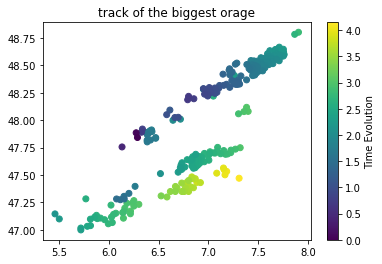

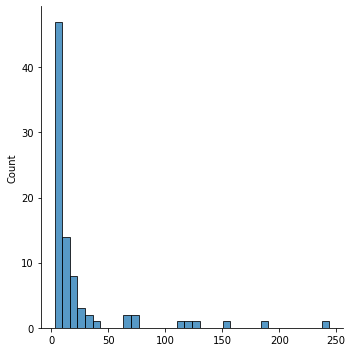

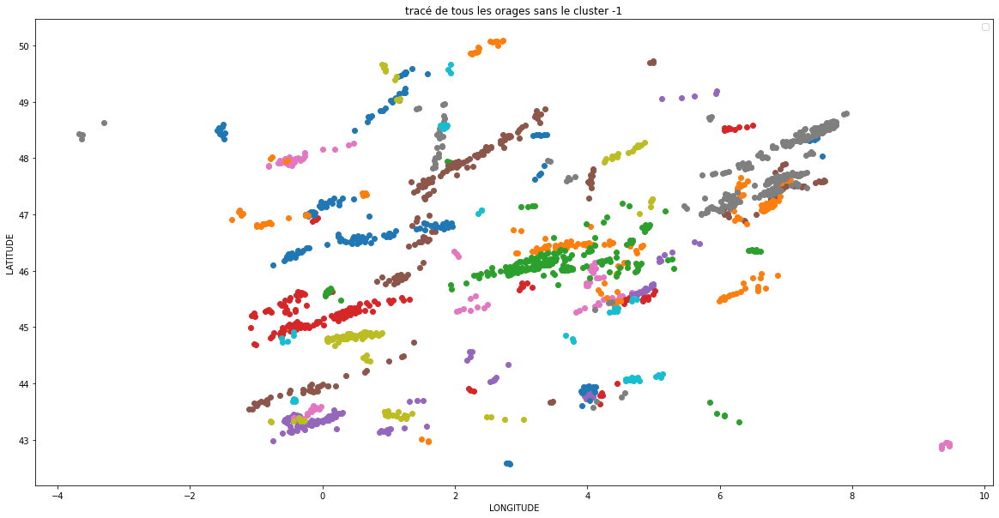

model = spatial:  0.4 , time : 6 , min_samples : 3
we cluster 84 orages in FR during the year 2022
we can't cluster 151 obsverations over 1980 ( 7.6 %)
In FR during the year 2022 the mean number of observations per orage is 21.774
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


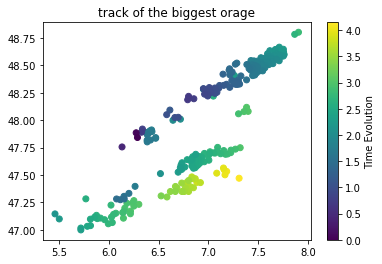

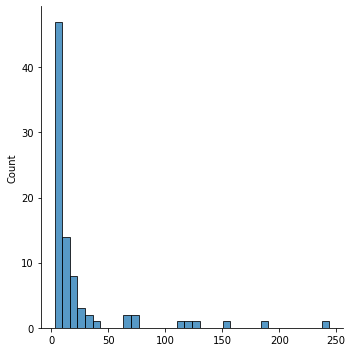

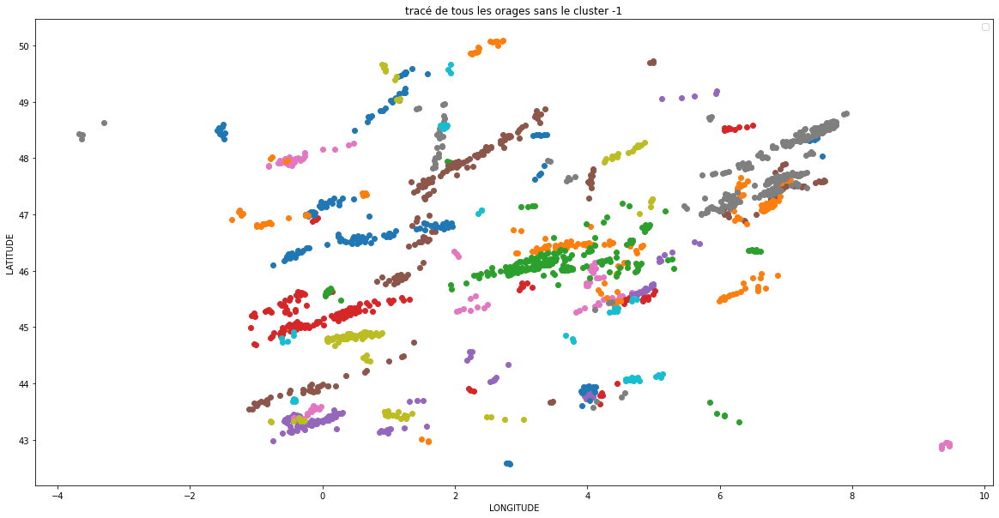

model = spatial:  0.4 , time : 7 , min_samples : 3
we cluster 85 orages in FR during the year 2022
we can't cluster 148 obsverations over 1980 ( 7.5 %)
In FR during the year 2022 the mean number of observations per orage is 21.553
In FR during the year 2022 the median number of observations per orage is 8.0
the biggest orage has been reported 244 times
the biggest orage has moved : 2.448 longitude degrees and 1.801 latitude degrees
the biggest orage has last : 4 h 6 min


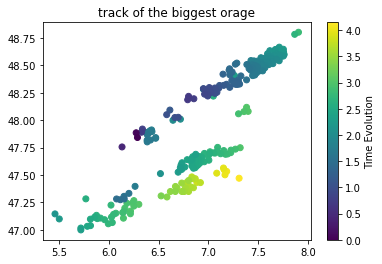

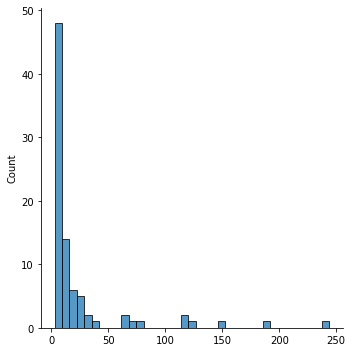

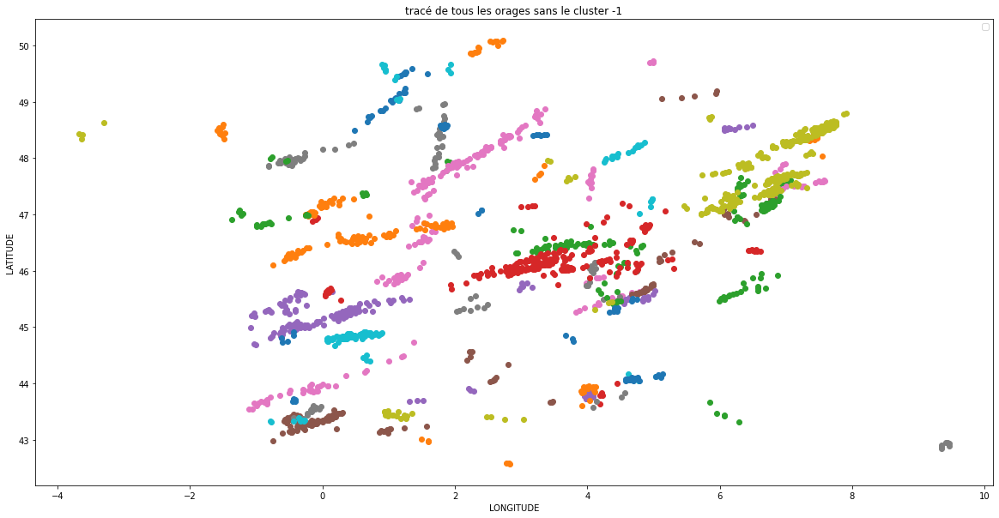

In [ ]:
grid(df5,'FR',2022,spatial_fix,time_params,sample_fix)

The biggest orage isn't changed at all by the time parameter ! The mean number of observations per orage seems constant to 21,5. Results seem pretty identical, not a big influence of the time parameter.


#Influence of min samples parameter

In [ ]:
spatial_fix = [0.2]
time_fix = [2]

model = spatial:  0.2 , time : 2 , min_samples : 1
we cluster 298 orages in FR during the year 2022
we can't cluster 2 obsverations over 1980 ( 0.1 %)
In FR during the year 2022 the mean number of observations per orage is 6.638
In FR during the year 2022 the median number of observations per orage is 2.0
the biggest orage has been reported 164 times
the biggest orage has moved : 0.0 longitude degrees and 0.0 latitude degrees
the biggest orage has last : 0 h 0 min


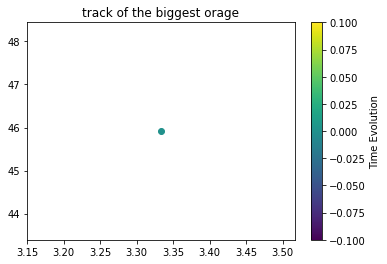

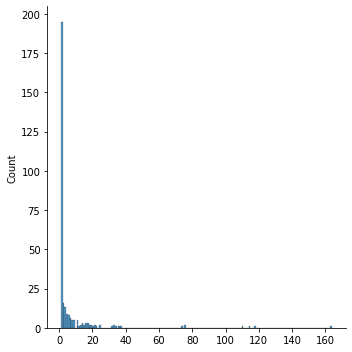

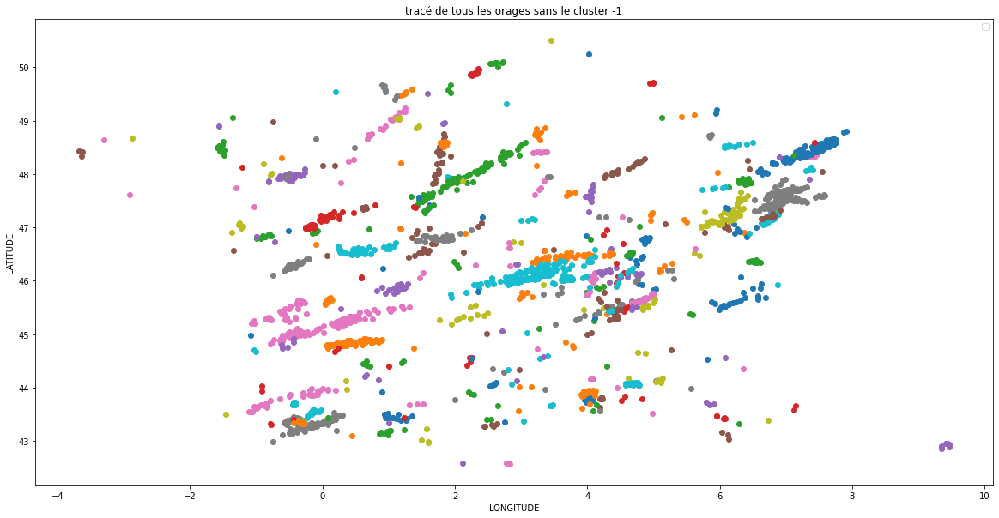

model = spatial:  0.2 , time : 2 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 139 obsverations over 1980 ( 7.0 %)
In FR during the year 2022 the mean number of observations per orage is 11.506
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


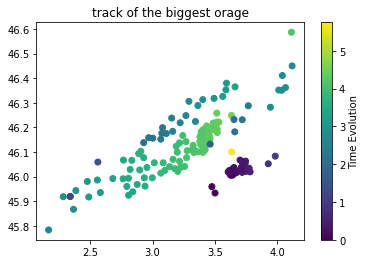

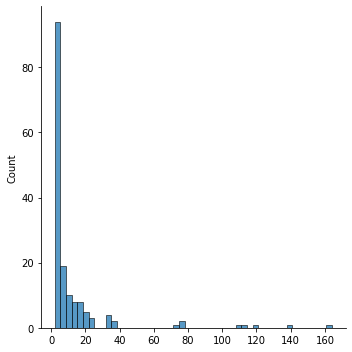

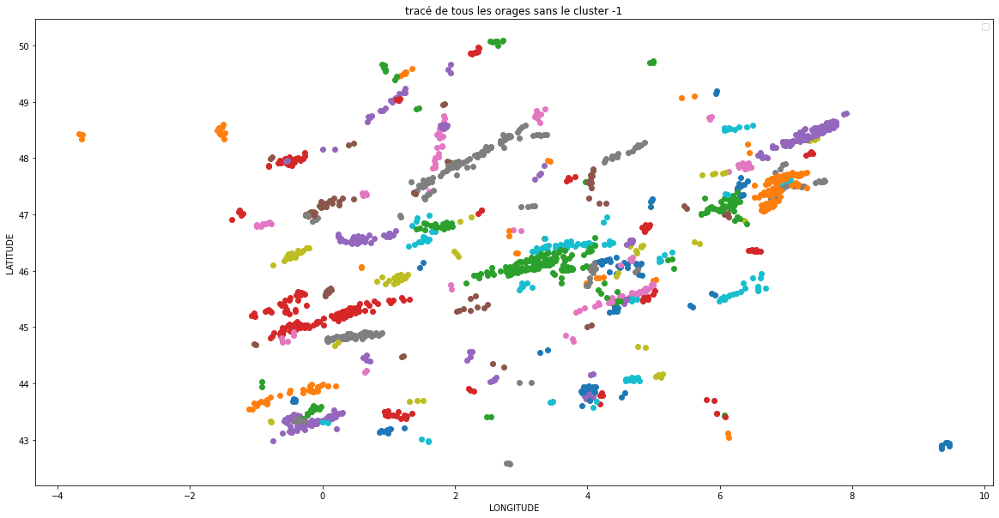

model = spatial:  0.2 , time : 2 , min_samples : 3
we cluster 104 orages in FR during the year 2022
we can't cluster 251 obsverations over 1980 ( 12.7 %)
In FR during the year 2022 the mean number of observations per orage is 16.625
In FR during the year 2022 the median number of observations per orage is 7.5
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


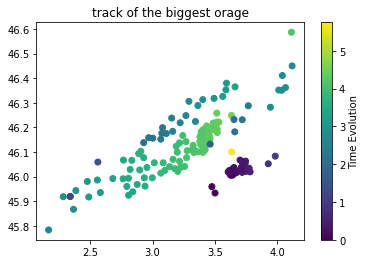

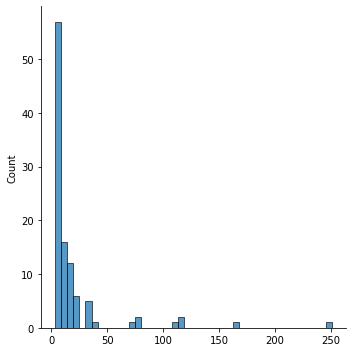

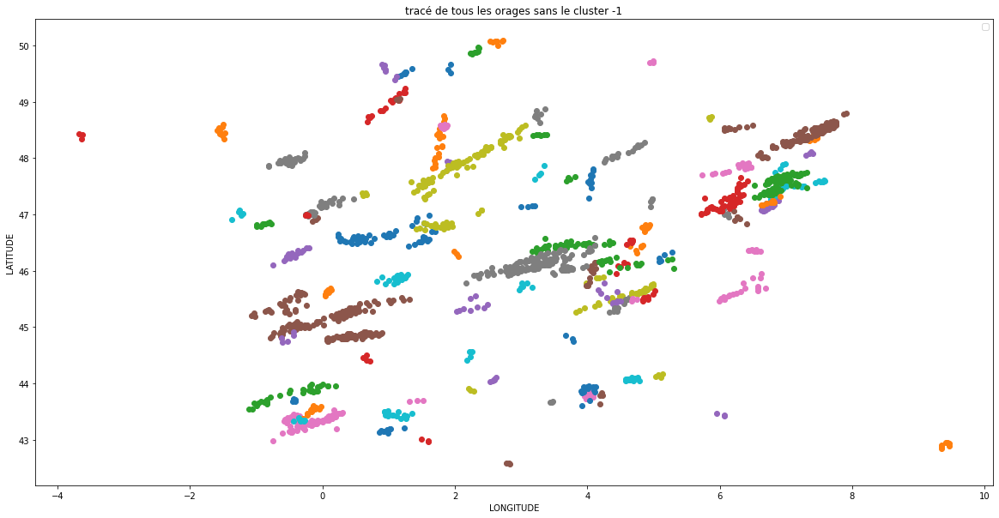

model = spatial:  0.2 , time : 2 , min_samples : 4
we cluster 88 orages in FR during the year 2022
we can't cluster 299 obsverations over 1980 ( 15.1 %)
In FR during the year 2022 the mean number of observations per orage is 19.102
In FR during the year 2022 the median number of observations per orage is 9.0
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


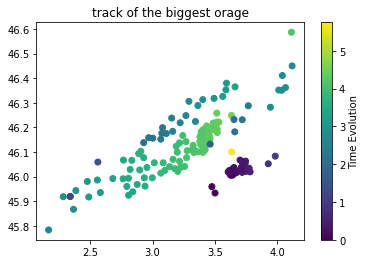

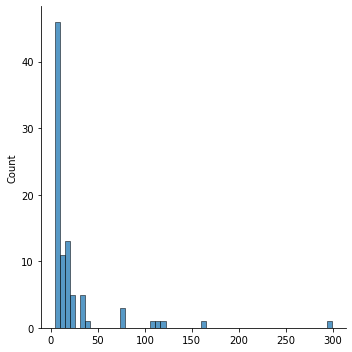

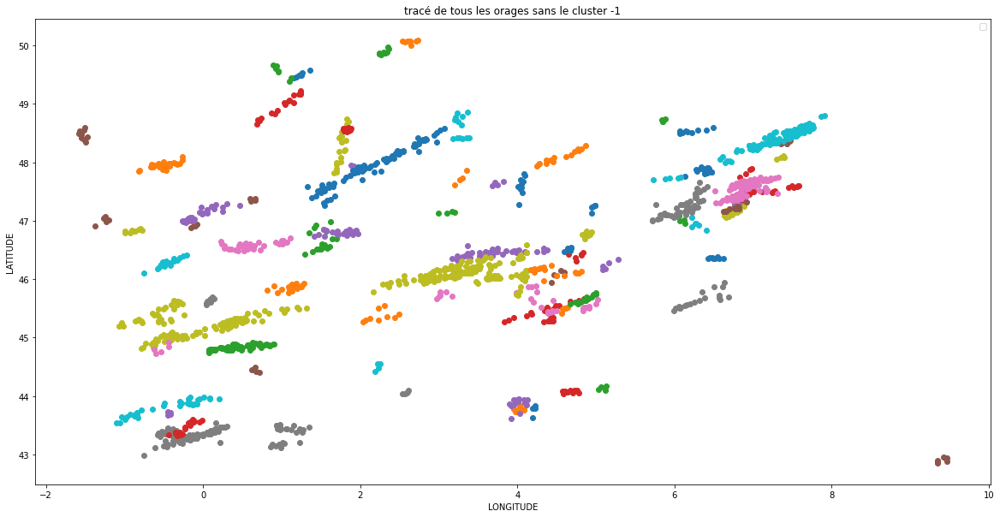

model = spatial:  0.2 , time : 2 , min_samples : 5
we cluster 77 orages in FR during the year 2022
we can't cluster 370 obsverations over 1980 ( 18.7 %)
In FR during the year 2022 the mean number of observations per orage is 20.909
In FR during the year 2022 the median number of observations per orage is 11.0
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


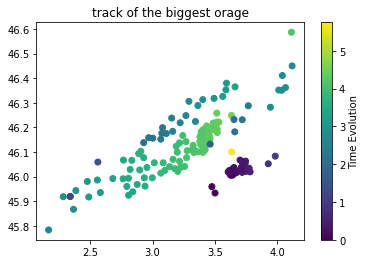

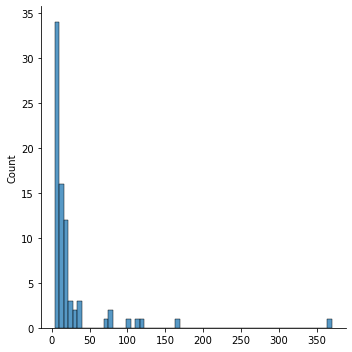

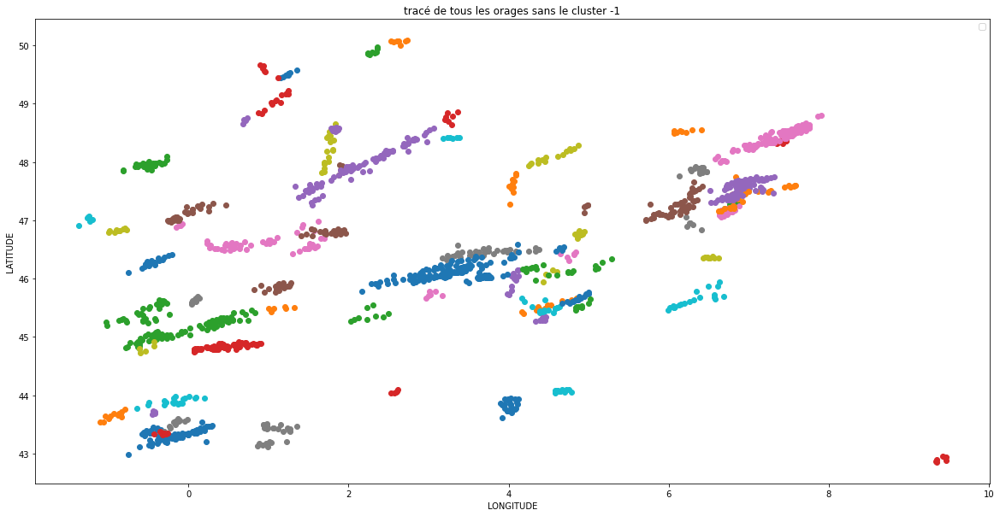

model = spatial:  0.2 , time : 2 , min_samples : 6
we cluster 69 orages in FR during the year 2022
we can't cluster 426 obsverations over 1980 ( 21.5 %)
In FR during the year 2022 the mean number of observations per orage is 22.522
In FR during the year 2022 the median number of observations per orage is 12.0
the biggest orage has been reported 164 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 5 h 48 min


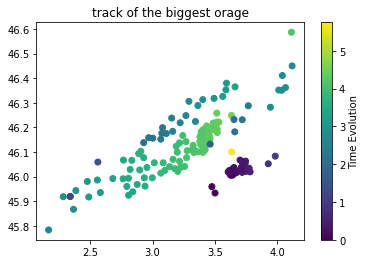

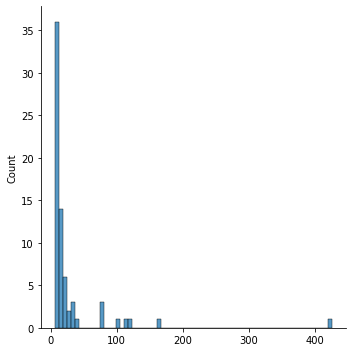

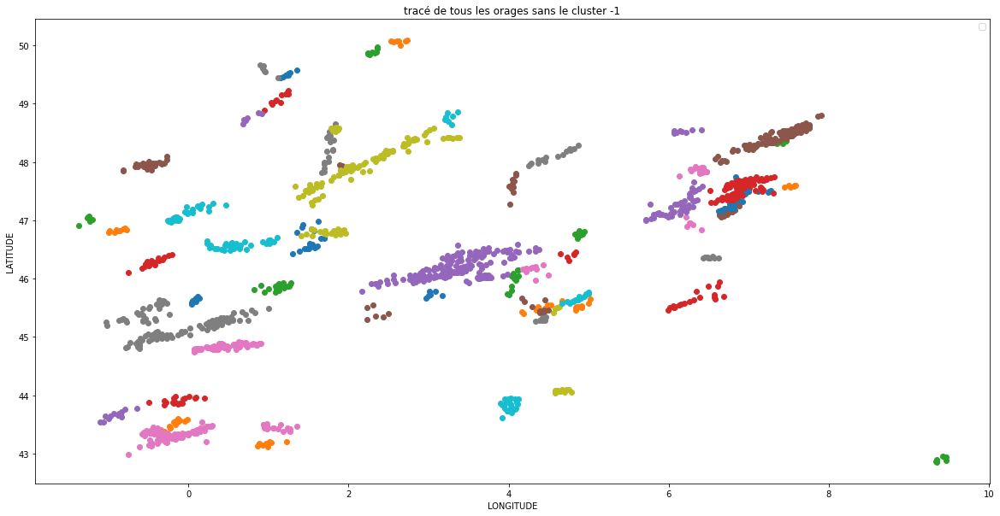

model = spatial:  0.2 , time : 2 , min_samples : 7
we cluster 61 orages in FR during the year 2022
we can't cluster 502 obsverations over 1980 ( 25.4 %)
In FR during the year 2022 the mean number of observations per orage is 24.23
In FR during the year 2022 the median number of observations per orage is 13.0
the biggest orage has been reported 157 times
the biggest orage has moved : 1.697 longitude degrees and 0.513 latitude degrees
the biggest orage has last : 5 h 48 min


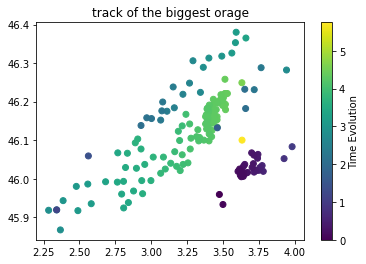

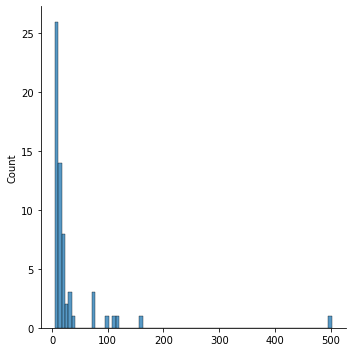

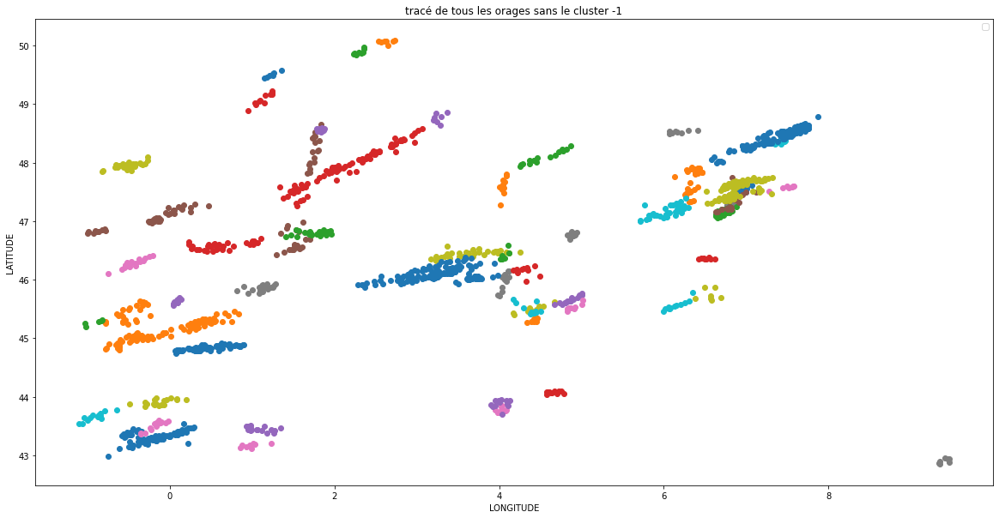

In [ ]:
grid(df5,'FR',2022,spatial_fix,time_fix,sample_params)

Il faut un petit min_samples sinon beaucoup trop clusterisé. Pb biggest track min_samples = 1. Sinon choix entre 1 et 3.

A l'oeil, eps1 = 0.4, eps2 = 5, min_samples = 3

Idée : on cluster d'abord les rapports précis. Logiquement, bon modèle et on ajoute 1 à 1 les autres rapports de moins en moins précis en augmentant peu à peu les seuils.

model = spatial:  0.2 , time : 3 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 137 obsverations over 1980 ( 6.9 %)
In FR during the year 2022 the mean number of observations per orage is 11.519
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 165 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 6 h 30 min


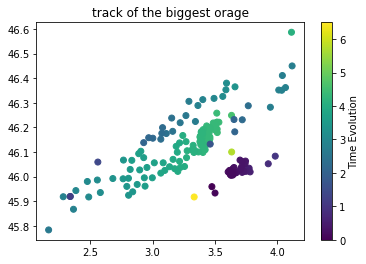

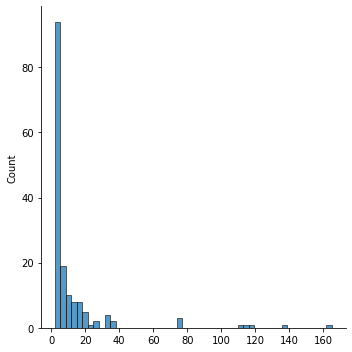

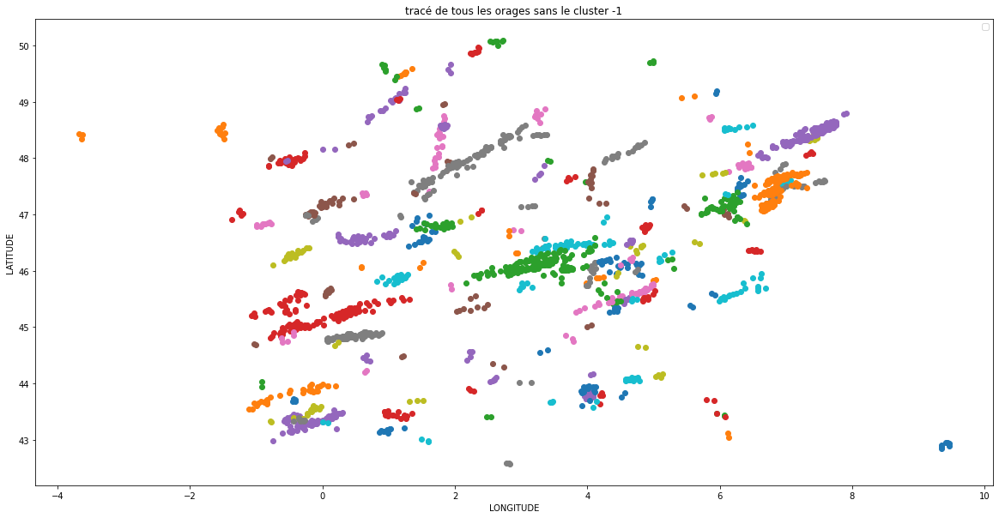

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,158
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,159
7309,133604.083333,48.636,4.952,159


In [ ]:
visu(df5,'FR',2022,0.2,3,2)

model = spatial:  0.2 , time : 2 , min_samples : 2
we cluster 47 orages in FR during the year 2021
we can't cluster 51 obsverations over 238 ( 21.4 %)
In FR during the year 2021 the mean number of observations per orage is 3.979
In FR during the year 2021 the median number of observations per orage is 3.0
the biggest orage has been reported 11 times
the biggest orage has moved : 0.094 longitude degrees and 0.15 latitude degrees
the biggest orage has last : 0 h 18 min


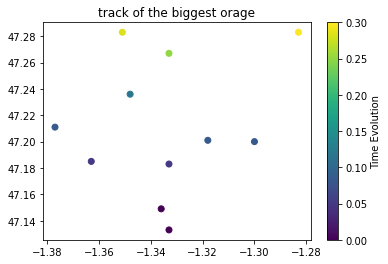

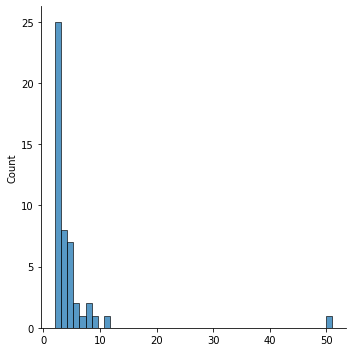

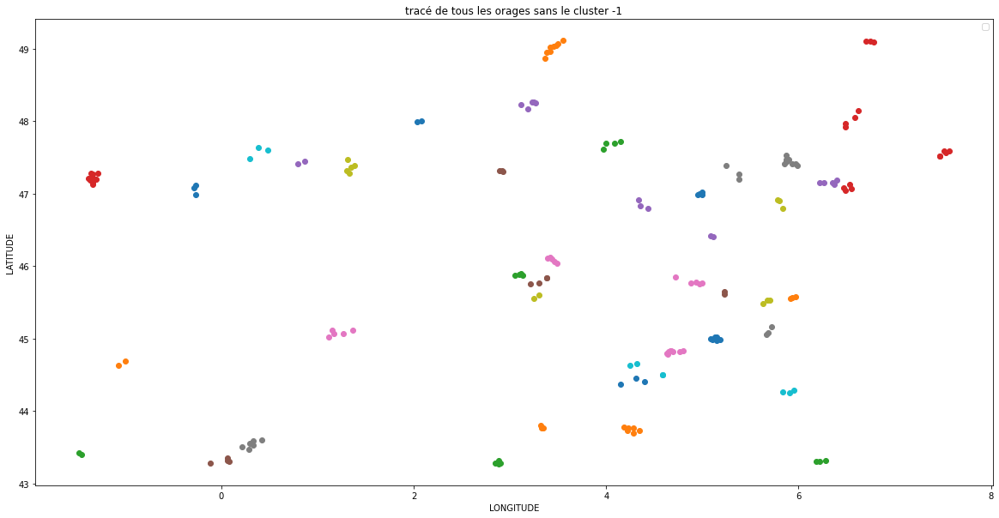

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
7505,128687.916667,43.667,3.717,-1
7507,128663.166667,48.000,2.083,0
7508,128663.083333,47.987,2.040,0
7510,128654.75,43.733,4.350,1
7511,128654.416667,43.767,4.283,1
...,...,...,...,...
12680,125082.416667,41.917,8.733,-1
12734,124123.916667,43.600,7.000,46
12735,124123.416667,43.633,6.999,46
12736,124123.0,43.633,7.100,46


In [ ]:
visu(df5,'FR',2021,0.2,2,2)

model = spatial:  0.2 , time : 2 , min_samples : 2
we cluster 14 orages in FR during the year 2020
we can't cluster 57 obsverations over 93 ( 61.3 %)
In FR during the year 2020 the mean number of observations per orage is 2.571
In FR during the year 2020 the median number of observations per orage is 2.0
the biggest orage has been reported 57 times
the biggest orage has moved : 9.067 longitude degrees and 7.333 latitude degrees


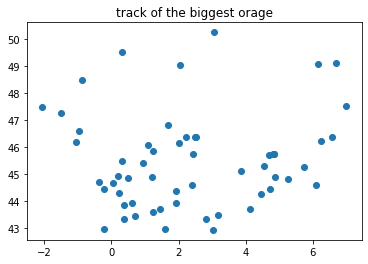

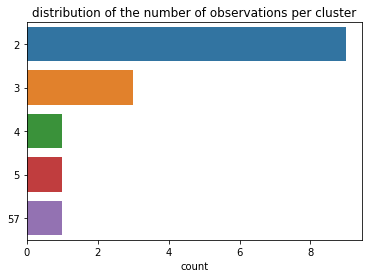

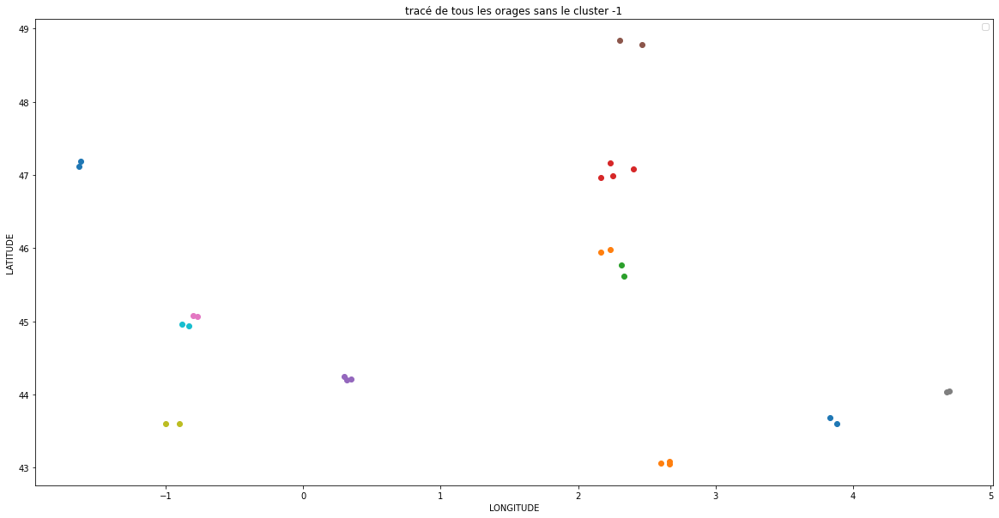

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
12773,122391.916667,47.467,-2.067,-1
12799,120836.916667,43.333,2.817,-1
12800,120835.916667,43.600,3.883,0
12801,120835.916667,43.683,3.833,0
12802,120835.916667,43.683,4.133,-1
...,...,...,...,...
15975,116301.416667,42.917,3.033,-1
15976,116301.416667,44.883,-0.100,12
15977,116273.166667,50.183,2.983,13
15978,116273.166667,50.167,3.000,13


In [ ]:
visu(df5,'FR',2020,0.2,2,2)

ON CHOISIT EPS1 = 0.2, EPS2 = 3 ET MIN_SAMPLES = 2


model = spatial:  0.2 , time : 3 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 137 obsverations over 1980 ( 6.9 %)
In FR during the year 2022 the mean number of observations per orage is 11.519
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 165 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 6 h 30 min


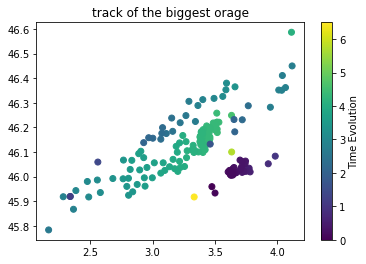

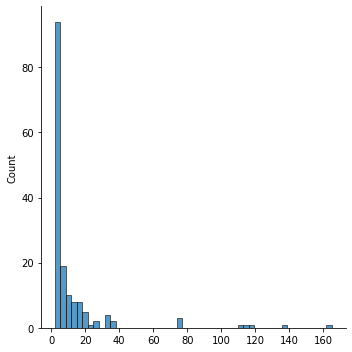

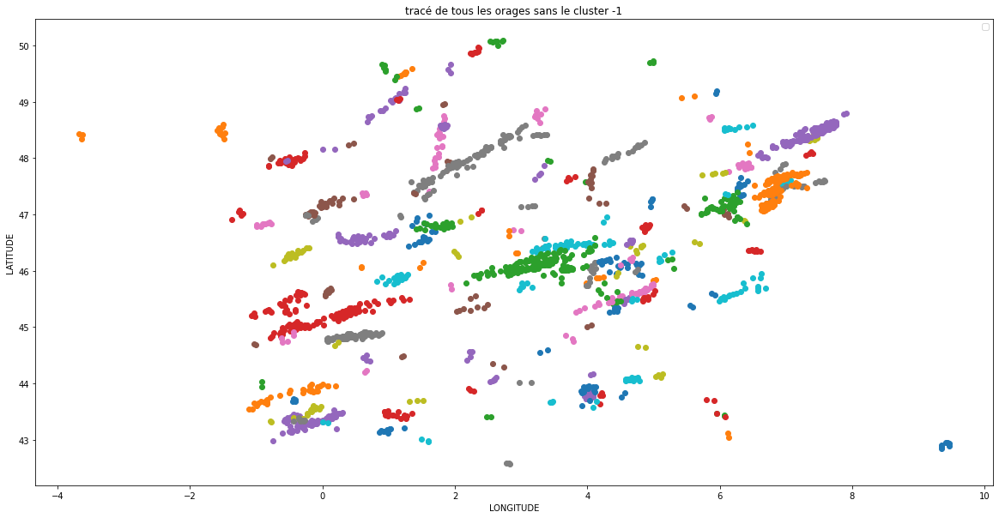

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,158
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,159
7309,133604.083333,48.636,4.952,159


In [ ]:
visu(df5,'FR',2022,0.2,3,2)

On voit clairement 3 tracks distinctes dans le biggest orage en France 2022 avec les paramètres retenus

model = spatial:  0.11 , time : 3 , min_samples : 2
we cluster 200 orages in FR during the year 2022
we can't cluster 213 obsverations over 1980 ( 10.8 %)
In FR during the year 2022 the mean number of observations per orage is 8.835
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 118 times
the biggest orage has moved : 0.833 longitude degrees and 0.169 latitude degrees
the biggest orage has last : 2 h 42 min


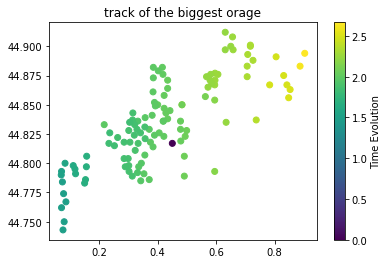

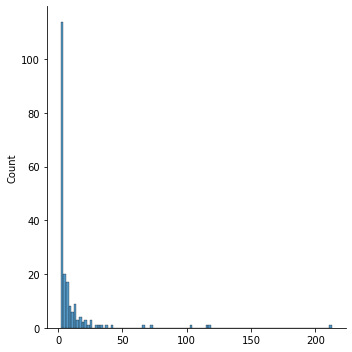

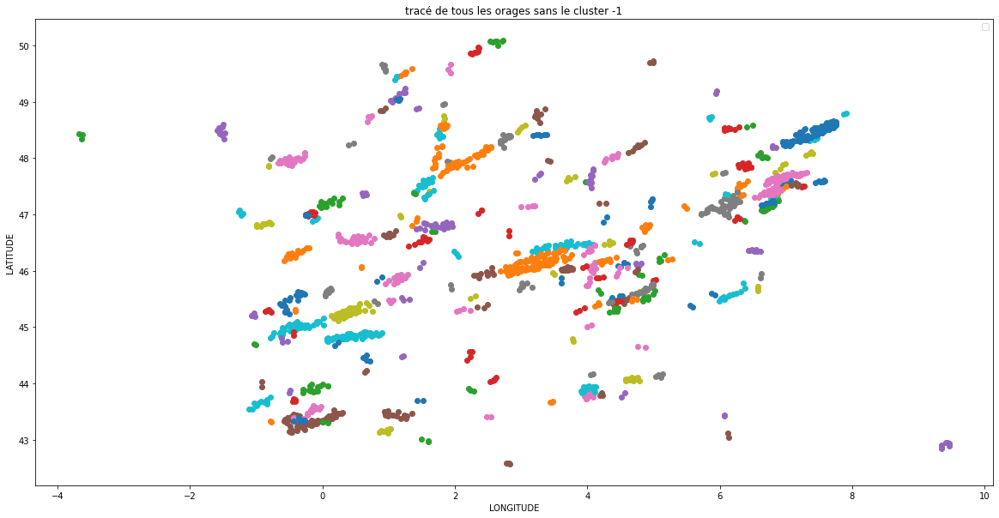

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,199
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
visu(df5,'FR',2022,0.11,3,2)

In [ ]:
# on veut récupérer les clusters -1 en France 2022 avec différents paramètres et les comparer entre eux

In [ ]:
def get_trash(df5,country,year,var_eps1,var_eps2,var_min_samples):
  #print('model = spatial: ',var_eps1,', time :',var_eps2,', min_samples :',var_min_samples )
  data = df5[df5.YEAR == year]
  data = data[data.COUNTRY == country]
  data_visu = data[['TIME_EVENT','LATITUDE','LONGITUDE']]
  model_visu = ST_DBSCAN(eps1=var_eps1, eps2=var_eps2,
                         min_samples=var_min_samples)
  model_visu.fit(data_visu)
  classi_visu = model_visu.labels
  visu_results = data_visu.copy()
  visu_results['CLASSI'] = classi_visu
  visu_bis = visu_results.reset_index(drop = True)
  return set(visu_bis[visu_bis.CLASSI == -1].index),visu_bis


In [ ]:
get_trash(df5,'FR',2022,0.2,3,2)

({24,
  25,
  28,
  44,
  53,
  59,
  60,
  61,
  64,
  66,
  72,
  77,
  78,
  79,
  80,
  81,
  84,
  86,
  90,
  145,
  146,
  150,
  152,
  156,
  157,
  158,
  167,
  171,
  172,
  173,
  178,
  180,
  205,
  218,
  221,
  222,
  223,
  224,
  225,
  226,
  231,
  232,
  237,
  238,
  239,
  241,
  246,
  247,
  329,
  343,
  371,
  372,
  386,
  392,
  415,
  416,
  661,
  662,
  679,
  680,
  694,
  711,
  712,
  713,
  725,
  737,
  743,
  746,
  749,
  751,
  754,
  777,
  806,
  911,
  1049,
  1113,
  1141,
  1211,
  1215,
  1218,
  1239,
  1242,
  1243,
  1245,
  1246,
  1250,
  1251,
  1368,
  1373,
  1387,
  1388,
  1400,
  1430,
  1476,
  1477,
  1487,
  1528,
  1533,
  1536,
  1539,
  1544,
  1545,
  1548,
  1560,
  1561,
  1576,
  1596,
  1599,
  1602,
  1614,
  1615,
  1625,
  1685,
  1790,
  1823,
  1843,
  1844,
  1863,
  1877,
  1914,
  1915,
  1916,
  1925,
  1928,
  1929,
  1930,
  1933,
  1939,
  1940,
  1950,
  1955,
  1964,
  1967,
  1968,
  1969,
  1976,
  197

In [ ]:
params_spatial = np.linspace(0.05,0.25,50)

In [ ]:
def plot_trash(df5,country,year,params_spatial,var_eps2,min_samples):
  len_trash = []
  for e in params_spatial:
    len_trash.append(len(get_trash(df5,'FR',year,e,var_eps2,min_samples)[0]))
    #print('longueur du cluster -1 =',len(get_trash(df5,'FR',year,e,var_eps2,min_samples)),'pour eps_1 =',e)
  plt.scatter(params_spatial,len_trash)
  plt.title('Number of unclassified observations for different spatial parameters')
  plt.xlabel('eps_1')
  plt.show()

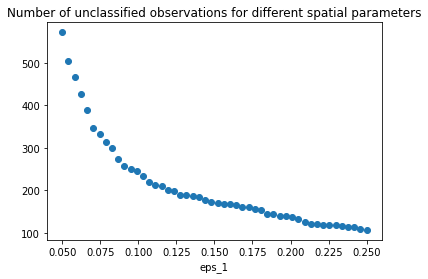

In [ ]:
plot_trash(df5,'FR',2022,params_spatial,3,2)

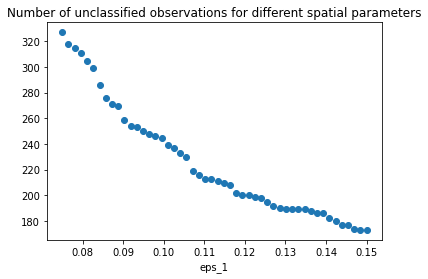

In [ ]:
plot_trash(df5,'FR',2022,np.linspace(0.075,0.15,50),3,2)

In [ ]:
test = np.linspace(0.075,0.15,50)
values = []
for i in range(len(test)-1):
  values.append(get_trash(df5,'FR',2022,test[i+1],3,2)[0].issubset(get_trash(df5,'FR',2022,test[i],3,2)[0]))
a = sum(values)
print (a == len(test)-1)

True


Cela montre que tous les clusters -1 sont des sous-ensembles imbriqués. Ils forment une suite décroissante au sens de l'inclusion lorsque eps_1 augmente

In [ ]:
get_trash(df5,'FR',2022,25,5,2)

({59, 66, 172, 173, 329, 1211, 1215, 1976, 1979},
          TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 0     138376.166667    45.567      5.933       0
 1     138375.783333    45.596      5.875       0
 2     138358.416667    49.583      1.358       1
 3     138358.333333    49.533      1.267       1
 4          138358.3    49.521      1.251       1
 ...             ...       ...        ...     ...
 1975  133961.583333    43.279      2.460      43
 1976  133944.416667    44.600     -0.933      -1
 1977       133604.2    48.669      5.114      44
 1978  133604.083333    48.636      4.952      44
 1979  132910.916667    44.750     -0.533      -1
 
 [1980 rows x 4 columns])

{59, 66, 172, 173, 329, 1211, 1215, 1976, 1979} sont les index des rapports en France 2022 qu'on ne pourra jamais classer

In [ ]:
get_trash(df5,'FR',2022,0.2,3,2)

In [ ]:
from random import *

In [ ]:
def plot_solo(df5,country,year,eps1,eps2,min_samples):
  trash_cluster,df = get_trash(df5,country,year,eps1,eps2,min_samples)
  trash_cluster = list(trash_cluster)
  n = len(trash_cluster)
  obs = randint(0,n-1)
  index = trash_cluster[obs]
  print("on regarde pour le rapport d'index",index)
  lati,longi,temps = df.iloc[index,1],df.iloc[index,2],df.iloc[index,0]
  index_low, index_high = index,index
  while df.iloc[index_low,-1] == -1:
    index_low-=1
  while df.iloc[index_high,-1] == -1:
    index_high+=1
  classi_low,classi_high = df.iloc[index_low,-1],df.iloc[index_high,-1]
  df_low_low,df_low,df_high,df_high_high = df[df.CLASSI == classi_low-1],df[df.CLASSI == classi_low],df[df.CLASSI == classi_high],df[df.CLASSI == classi_high+1]
  plt.figure(1)
  longitude_low_low = [df_low_low.iloc[i,2] for i in range(len(df_low_low))]
  latitude_low_low = [df_low_low.iloc[i,1] for i in range(len(df_low_low))]
  temps_low_low = [df_low_low.iloc[i,0] - df_low_low.iloc[-1,0] for i in range(len(df_low_low))]
  longitude_low_low.append(longi),latitude_low_low.append(lati),temps_low_low.append(temps - df_low_low.iloc[-1,0])
  plt.scatter(longitude_low_low,latitude_low_low, c = temps_low_low)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  print('track du',classi_low-1,'ème orage')
  plt.show()
  plt.figure(2)
  longitude_low = [df_low.iloc[i,2] for i in range(len(df_low))]
  latitude_low = [df_low.iloc[i,1] for i in range(len(df_low))]
  temps_low = [df_low.iloc[i,0] - df_low.iloc[-1,0] for i in range(len(df_low))]
  longitude_low.append(longi),latitude_low.append(lati),temps_low.append(temps - df_low.iloc[-1,0])
  plt.scatter(longitude_low,latitude_low, c = temps_low)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  print('track du',classi_low,'ème orage')
  plt.show()
  plt.figure(3)
  longitude_high = [df_high.iloc[i,2] for i in range(len(df_high))]
  latitude_high = [df_high.iloc[i,1] for i in range(len(df_high))]
  temps_high = [df_high.iloc[i,0] - df_high.iloc[-1,0] for i in range(len(df_high))]
  longitude_high.append(longi),latitude_high.append(lati),temps_high.append(temps - df_high.iloc[-1,0])
  plt.scatter(longitude_high,latitude_high, c = temps_high)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  print('track du',classi_high,'ème orage')
  plt.show()
  plt.figure(4)
  longitude_high_high = [df_high_high.iloc[i,2] for i in range(len(df_high_high))]
  latitude_high_high = [df_high_high.iloc[i,1] for i in range(len(df_high_high))]
  temps_high_high = [df_high_high.iloc[i,0] - df_high_high.iloc[-1,0] for i in range(len(df_high_high))]
  longitude_high_high.append(longi),latitude_high_high.append(lati),temps_high_high.append(temps - df_high_high.iloc[-1,0])
  plt.scatter(longitude_high_high,latitude_high_high, c = temps_high_high)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  print('track du',classi_high+1,'ème orage')
  plt.show()  

on regarde pour le rapport d'index 53
track du 5 ème orage


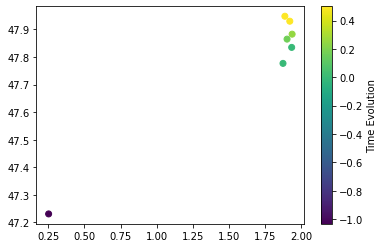

track du 6 ème orage


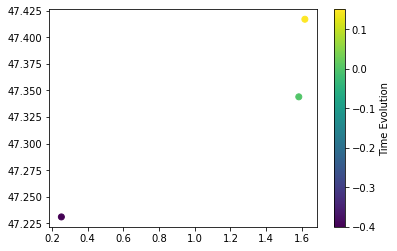

track du 7 ème orage


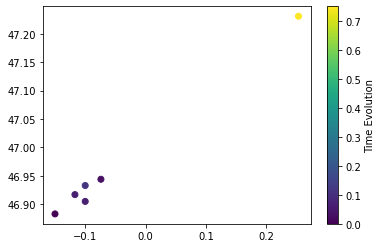

track du 8 ème orage


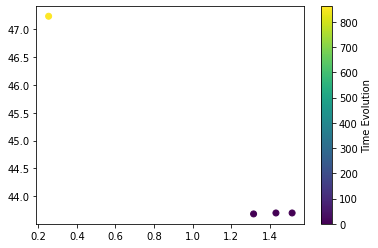

In [ ]:
plot_solo(df5,'FR',2022,0.2,3,2)

In [ ]:
#le 54ème rapport en France 2022, classé -1 par notre modèle, peut appartenir à l'orage 7.

In [ ]:
from matplotlib_venn import venn2,venn2_circles

In [ ]:
def constru_venn(df5,country,year,eps1_A,eps1_B,eps2,min_samples):
  A,B = get_trash(df5,country,year,eps1_A,eps2,min_samples)[0],get_trash(df5,country,year,eps1_B,eps2,min_samples)[0]
  Ab = len(A.difference(B))
  aB = len(B.difference(A))
  AB = len(A & B)
  venn2(subsets = (Ab, aB, AB), set_labels = ('eps1_A', 'eps1_B'), alpha = 0.5);
  venn2_circles(subsets = (Ab, aB, AB));
  print('eps1_A =',eps1_A,'and eps1_B =',eps1_B)
  plt.show()

eps1_A = 0.1 and eps1_B = 0.2


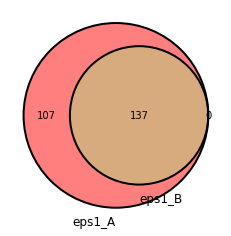

In [ ]:
constru_venn(df5,'FR',2022,0.1,0.2,3,2)

eps1_A = 0.15 and eps1_B = 0.2


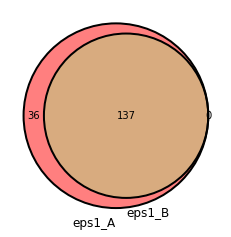

In [ ]:
constru_venn(df5,'FR',2022,0.15,0.2,3,2)

eps1_A = 0.15 and eps1_B = 0.25


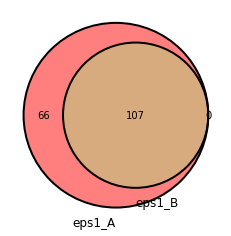

In [ ]:
constru_venn(df5,'FR',2022,0.15,0.25,3,2)

# Travail sur l'inertie des orages

model = spatial:  0.2 , time : 3 , min_samples : 2
we cluster 160 orages in FR during the year 2022
we can't cluster 137 obsverations over 1980 ( 6.9 %)
In FR during the year 2022 the mean number of observations per orage is 11.519
In FR during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 165 times
the biggest orage has moved : 1.949 longitude degrees and 0.804 latitude degrees
the biggest orage has last : 6 h 30 min


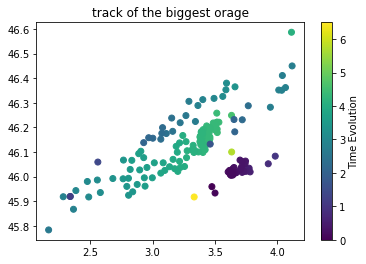

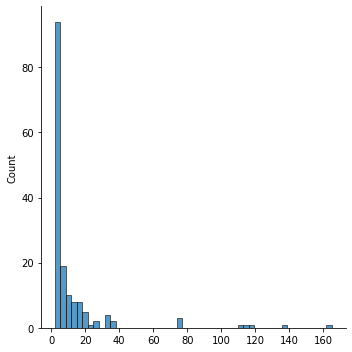

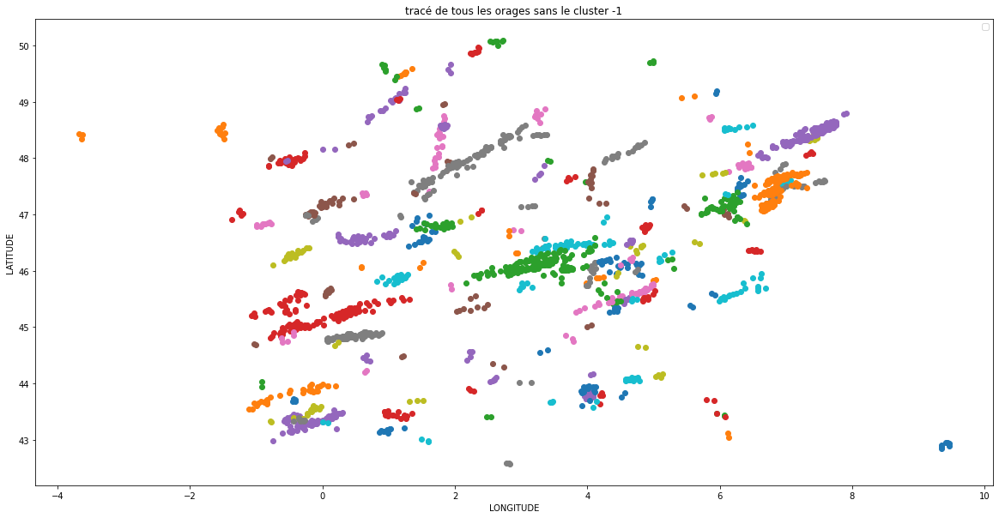

In [ ]:
visu_results = visu(df5,'FR',2022,0.2,3,2)

In [ ]:
visu_results[visu_results['CLASSI']==102]

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
5115,134980.583333,45.917,3.333,102
5118,134979.833333,46.100,3.633,102
5121,134978.666667,46.249,3.632,102
5122,134978.5,46.258,3.514,102
5123,134978.483333,46.179,3.518,102
...,...,...,...,...
5373,134974.25,46.005,3.628,102
5374,134974.25,46.006,3.642,102
5375,134974.25,46.013,3.626,102
5379,134974.166667,45.933,3.500,102


In [ ]:
df[df['TIME_EVENT'].str[:10] == '2022-06-04'] #superposer avec données radar, correspondance cluster - points radar activité

,ID,QC_LEVEL,INFO_SOURCE,CONTACT,ORGANISATION,ORGANISATION_ID,NO_REVISION,PERSON_REVISION,TIME_EVENT,TIME_CREATION,...,PATH_END_LONGITUDE,PATH_END_DATETIME,EXT_URL,REFERENCE,IMPACTS,CREATOR_ID,REVISOR_ID,LINK_ORG,LINK_ID,DELETED
5110,5391,QC0+,EYEWTN,Thilo Kühne (ESWD management/ESSL Team),NaN,NaN,1,ESSL,2022-06-04 23:33:00,2022-06-06 20:39:41,...,NaN,NaN,NaN,Witness observer report; reported v. MeteoSwis...,NaN,Thilo,Thilo,ESSL,5391.0,N
5111,50946,QC0+,EYEWTN,Thilo Kühne (ESWD management/ESSL Team),NaN,NaN,1,ESSL,2022-06-04 23:03:00,2022-06-08 21:10:03,...,NaN,NaN,NaN,Witness observer report; reported v. My Weathe...,NaN,Thilo,Thilo,ESSL,50946.0,N
5112,50944,QC0+,EYEWTN,Thilo Kühne (ESWD management/ESSL Team),NaN,NaN,1,ESSL,2022-06-04 22:47:00,2022-06-08 21:08:16,...,NaN,NaN,NaN,Witness observer report; reported v. My Weathe...,NaN,Thilo,Thilo,ESSL,50944.0,N
5113,50942,QC0+,EYEWTN,Thilo Kühne (ESWD management/ESSL Team),NaN,NaN,1,ESSL,2022-06-04 22:45:00,2022-06-08 21:05:25,...,NaN,NaN,NaN,Witness observer report; reported v. My Weathe...,NaN,Thilo,Thilo,ESSL,50942.0,N
5114,50943,QC0+,EYEWTN,Thilo Kühne (ESWD management/ESSL Team),NaN,NaN,1,ESSL,2022-06-04 22:45:00,2022-06-08 21:06:49,...,NaN,NaN,NaN,Witness observer report; reported v. My Weathe...,NaN,Thilo,Thilo,ESSL,50943.0,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5451,50912,QC1,"EVTPHOTO,EYEWTN,WWW",Igor Laskowski (ESWD management),Skywarn Poland,NaN,2,ESSL,2022-06-04 10:50:00,2022-06-08 15:50:33,...,NaN,NaN,https://www.facebook.com/ClimatVendee/posts/pf...,Eyewitness report via Climat-Vendée - Votre in...,NaN,Igor,Igor,ESSL,50912.0,N
5452,50619,QC0+,"EVTPHOTO,EYEWTN,WWW",Igor Laskowski (ESWD management),Skywarn Poland,NaN,1,ESSL,2022-06-04 02:20:00,2022-06-04 05:59:40,...,NaN,NaN,https://www.facebook.com/meteo.centre/posts/pf...,"Eyewitness report via Météo89 (on Facebook), 0...",NaN,Igor,Igor,ESSL,50619.0,N
5453,50661,QC1,"EVTPHOTO,EYEWTN,WWW",Igor Laskowski (ESWD management),Skywarn Poland,NaN,2,ESSL,2022-06-04 02:19:00,2022-06-04 16:42:47,...,NaN,NaN,https://www.facebook.com/lanouvellerepubliquei...,Eyewitness report via La Nouvelle République I...,NaN,Igor,Igor,ESSL,50661.0,N
5454,50618,QC1,"EVTPHOTO,EYEWTN,DMGEYEWTN,WWW",Nicolas Baluteau (Voluntary Observer Person) /...,Skywarn Poland,NaN,4,ESSL,2022-06-04 02:15:00,2022-06-04 05:57:32,...,NaN,NaN,https://www.facebook.com/francebleutouraineoff...,"Eyewitness report via Météo89 (on Facebook), 0...",V2V3,Igor,Igor,ESSL,50618.0,N


In [ ]:
  np.unique(visu_results['CLASSI'], return_counts = True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159]),
 array([137,   2,   7,   7,   8,  17,   6,   2,   5,   3,   3,   2,   4,
          2,  19

In [ ]:
condition sur la monotonie des tracks : elles ne peuvent pas retourner en arrière

In [ ]:
se base plus sur la longitude, les tracks vont vers Est

In [ ]:
#longitude colonne 2, latitude colonne 1

In [ ]:
def sens(df):

  #première étape : trouver la direction de l'orage (est ou ouest)
  #on va à l'est si longi(n+1)>longi(n)
  n = len(df)
  c = 0

  inverse = [] #liste des indices qui vont à contre-sens

  for i in range(n-1):
    if df.iloc[i+1,2] - df.iloc[i,2] <0: #on va vers l'Est car le temps diminue quand i augmente
      c+=1
    else :
      inverse.append(i+1)
  
  if c>= n//2:
    pourcent = round(c/(n-1),1)*100
    print("L'orage va vers l'Est :",pourcent,"% de déplacements vers l'Est")
  else:
    pourcent = 100 - round(c/(n-1),1)*100
    print("L'orage va vers l'Ouest:",pourcent,"% de déplacements vers l'Ouest")
  print("liste des indices qui sont derrière la track :")
  return inverse




In [ ]:
sens(visu_results[visu_results.CLASSI == 4])

L'orage va vers l'Est : 80.0 % de déplacements vers l'Est
liste des indices qui sont derrière la track :


[2, 9, 12, 15]

In [ ]:
sens(visu_results[visu_results.CLASSI == 3])

L'orage va vers l'Est : 60.0 % de déplacements vers l'Est
liste des indices qui sont derrière la track :


[1, 2, 5]

In [ ]:
  sens(visu_results[visu_results.CLASSI == 127])

In [ ]:
sens(visu_results[visu_results.CLASSI == 102])

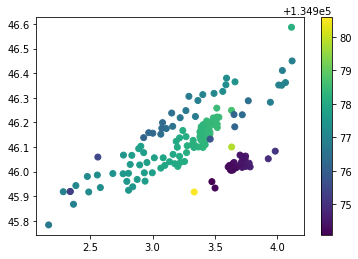

In [ ]:
plt.scatter(visu_results[visu_results.CLASSI == 102].LONGITUDE,visu_results[visu_results.CLASSI == 102].LATITUDE,c = visu_results[visu_results.CLASSI == 102].TIME_EVENT)
cbar = plt.colorbar()

In [ ]:
visu_results.iloc[:,[1,2]]

,LATITUDE,LONGITUDE
0,45.567,5.933
1,45.596,5.875
4,49.583,1.358
5,49.533,1.267
6,49.521,1.251
...,...,...
7274,43.279,2.460
7275,44.600,-0.933
7308,48.669,5.114
7309,48.636,4.952


In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

In [ ]:
base = visu_results[visu_results.CLASSI == 102]
X = base.iloc[:,[1,2]] #var explicatives lat et long
Y = base.iloc[:,0] #var target time_event

In [ ]:
len(X)

165

In [ ]:
def séparation(visu_results,numero):
  base = visu_results[visu_results.CLASSI == numero]
  X = base.iloc[:,[1,2]] #var explicatives lat et long
  Y = base.iloc[:,0] #var target time_event
  n = len(X)
  l = [] #liste de nos résultats
  # on crée différents datasets en faisant glisser les indices limites et en gardant minimum  2 orages par tracks

  for i in range(2,n-4):
    for j in range(i+2,n-2):

      l0 = [i,j]

      #on divise en 3 notre dataset

      X1,Y1 = X.iloc[0:i],Y.iloc[0:i]
      X2,Y2 = X.iloc[i:j],Y.iloc[i:j]
      X3,Y3 = X.iloc[j:],Y.iloc[j:]

      #on effectue les régressions
      model_1 = LinearRegression()
      model_2 = LinearRegression()
      model_3 = LinearRegression()
      model_1.fit(X1, Y1)
      model_2.fit(X2, Y2)
      model_3.fit(X3, Y3)

      #comparaison des erreurs quadratiques moyennes
      y_1 = model_1.predict(X1)
      rmse_1 = (np.sqrt(mean_squared_error(Y1, y_1)))
      y_2 = model_2.predict(X2)
      rmse_2 = (np.sqrt(mean_squared_error(Y2, y_2)))
      y_3 = model_3.predict(X3)
      rmse_3 = (np.sqrt(mean_squared_error(Y3, y_3)))

      l0.append(np.mean([rmse_1*len(X1),rmse_2*len(X2),rmse_3*len(X3)]))
      l.append(l0)

  L = [l[i][2] for i in range(len(l))]
  minpos = L.index(min(L)) # on trouve l'indice du minimum de la moyenne des rmse
  return l[minpos]

In [ ]:
def séparation2(visu_results,numero):
  base = visu_results[visu_results.CLASSI == numero]
  X = base.iloc[:,2] #var explicatives lat et long
  Y = base.iloc[:,1] #var target time_event
  n = len(X)
  l = [] #liste de nos résultats
  # on crée différents datasets en faisant glisser les indices limites et en gardant minimum  2 orages par tracks

  for i in range(2,n-4):
    for j in range(i+2,n-2):

      l0 = [i,j]

      #on divise en 3 notre dataset

      X1,Y1 = X.iloc[0:i],Y.iloc[0:i]
      X2,Y2 = X.iloc[i:j],Y.iloc[i:j]
      X3,Y3 = X.iloc[j:],Y.iloc[j:]

      #on effectue les régressions
      model_1 = LinearRegression()
      model_2 = LinearRegression()
      model_3 = LinearRegression()
      model_1.fit(X1, Y1)
      model_2.fit(X2, Y2)
      model_3.fit(X3, Y3)

      #comparaison des erreurs quadratiques moyennes
      y_1 = model_1.predict(X1)
      rmse_1 = (np.sqrt(mean_squared_error(Y1, y_1)))
      y_2 = model_2.predict(X2)
      rmse_2 = (np.sqrt(mean_squared_error(Y2, y_2)))
      y_3 = model_3.predict(X3)
      rmse_3 = (np.sqrt(mean_squared_error(Y3, y_3)))

      l0.append(np.mean([rmse_1*len(X1),rmse_2*len(X2),rmse_3*len(X3)]))
      l.append(l0)

  L = [l[i][2] for i in range(len(l))]
  minpos = L.index(min(L)) # on trouve l'indice du minimum de la moyenne des rmse
  return l[minpos]

In [ ]:
séparation2(visu_results,102)

In [ ]:
test = visu_results[visu_results.CLASSI == 102]

In [ ]:
classe1 = test.iloc[:93,:]
classe2 = test.iloc[93:117,:]
classe3 = test.iloc[117:,:]

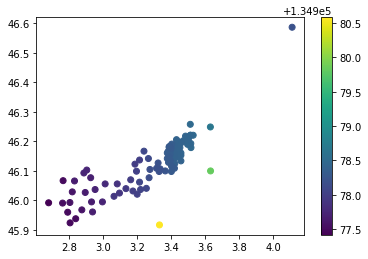

In [ ]:
plt.scatter(classe1.LONGITUDE,classe1.LATITUDE,c = classe1.TIME_EVENT)
cbar = plt.colorbar()

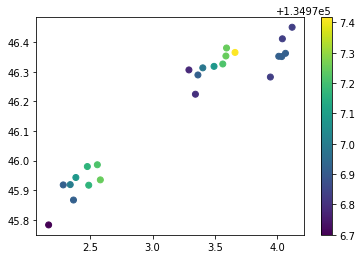

In [ ]:
plt.scatter(classe2.LONGITUDE,classe2.LATITUDE,c = classe2.TIME_EVENT)
cbar = plt.colorbar()

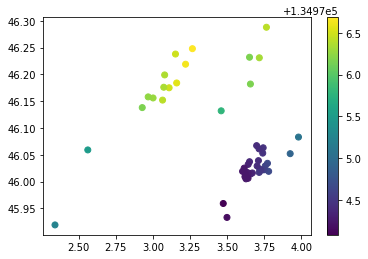

In [ ]:
plt.scatter(classe3.LONGITUDE,classe3.LATITUDE,c = classe3.TIME_EVENT)
cbar = plt.colorbar()

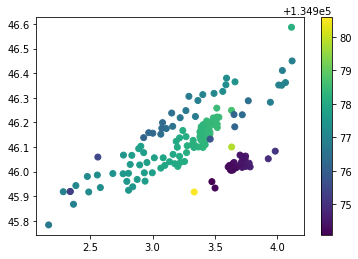

In [ ]:
plt.scatter(visu_results[visu_results.CLASSI == 102].LONGITUDE,visu_results[visu_results.CLASSI == 102].LATITUDE,c = visu_results[visu_results.CLASSI == 102].TIME_EVENT)
cbar = plt.colorbar()

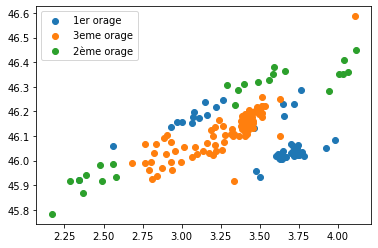

In [ ]:
plt.scatter(classe3.LONGITUDE,classe3.LATITUDE, label = '1er orage')
plt.scatter(classe1.LONGITUDE,classe1.LATITUDE, label = '3eme orage')
plt.scatter(classe2.LONGITUDE,classe2.LATITUDE, label = '2ème orage')
plt.legend()
plt.show()

In [ ]:
def monotony(df5,country,year,var_eps1,var_eps2,var_min_samples):
  visu_results = visu(df5,country,year,var_eps1,var_eps2,var_min_samples)
   L = np.unique(np.array(visu_results['CLASSI']))
   for e in L:
     orages_cours = visu_results[visu_results['CLASSI'] == e]
     

# Travail sur la population

In [ ]:
trouver comment inclure les données démographiques ?
utiliser des paramètres restrictifs pour créer plus de clusters et ensuite regarder si on peut en fusionner certains 
si personne entre deux tracks distinctes qui se suivent bien -> on peut les fusionner


In [ ]:
données radar pour la validation des données de population
projection superposée des différentes sources de données pour validation croisée du modèle

In [ ]:
faire première version du rapport

In [ ]:
def distance (métrique et temporelle) entre deux clusters, cluster et un rapport
chercher si densité de population est faible entre rapport et cluster
trouver moyen de fusionner


# Distances

In [ ]:
np.unique(visu_results.CLASSI,return_counts = True) #classification

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
        168, 169, 170, 171, 172, 173, 174, 175, 176

In [ ]:
visu_results[visu_results.CLASSI == 154]

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
5645,134915.083333,44.894,0.903,154
5646,134915.05,44.883,0.887,154
5647,134914.933333,44.863,0.853,154
5648,134914.933333,44.856,0.848,154
5649,134914.916667,44.867,0.783,154
...,...,...,...,...
5761,134913.916667,44.774,0.078,154
5762,134913.916667,44.767,0.086,154
5763,134913.916667,44.762,0.071,154
5764,134913.916667,44.750,0.080,154


In [ ]:
def distance_cluster_rapport(visu_results,rapport,cluster,type):

  # rapport : liste de 3 éléments : time_event,latitude et longitde
  # cluster : numéro du cluster
  # type : str "moyenne" ou "miniamle"

  orage = visu_results[visu_results.CLASSI == cluster]
  n = len(orage)

  if type == "moyenne":

    centre_cluster_long, centre_cluster_lat = orage.describe().iloc[1,1],orage.describe().iloc[1,0] ## on récup les coordonées moyennes de l'orage
    distance = np.sqrt((rapport[2]-centre_cluster_long)**2+(rapport[1]-centre_cluster_lat)**2) ## on calcule la distance du rapport à ces coord moyennes

  elif type == "minimale":

    dists = []

    for i in range(n):

      a,b = rapport[2]-orage.iloc[i,2],rapport[1]-orage.iloc[i,1] ## on calcule la distance du rapport avec chaque rapports du cluster
      dists.append(np.sqrt(a**2 + b**2))

    distance = np.min(dists) ## on prend la minimale

  return distance

In [ ]:
def distance_cluster_cluster(visu_results,cluster_1,cluster_2,type):

  # cluster1 & cluster2 : numéros de cluster 
  # type : str "moyenne" ou "minimale"

  orage_1 = visu_results[visu_results.CLASSI == cluster_1]
  orage_2 = visu_results[visu_results.CLASSI == cluster_2]
  n1,n2 = len(orage_1),len(orage_2)
  distances = []

  for i in range(n1):

    rapport = orage_1.iloc[i,[0,1,2]] #on regarde rapport par rapport du premier cluster
    dist = distance_cluster_rapport(visu_results,rapport,cluster_2,type) #on calcule sa distance pour le deuxième cluster 
    distances.append(dist)
  
  distance_min = np.min(distances) #on prend la distance minimale sur tous les rapports
  return distance_min # en unité de degrés de latitude/longitude


In [ ]:
distance_cluster_cluster(visu_results,4,5,"moyenne"),distance_cluster_cluster(visu_results,4,5,"minimale")

(0.20923461711676908, 0.16115210206509936)

# Données démographiques





In [ ]:
demog = pd.read_csv("/content/drive/MyDrive/Filosofi2017_carreaux_1km_met.csv")

In [ ]:
demog.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 374797 entries, 0 to 374796
Data columns (total 31 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Idcar_1km  374797 non-null  object 
 1   I_est_1km  374797 non-null  int64  
 2   Ind        374797 non-null  float64
 3   Men_1ind   374797 non-null  float64
 4   Men_5ind   374797 non-null  float64
 5   Men_prop   374797 non-null  float64
 6   Men_fmp    374797 non-null  float64
 7   Ind_snv    374797 non-null  float64
 8   Men_surf   374797 non-null  float64
 9   Men_coll   374797 non-null  float64
 10  Men_mais   374797 non-null  float64
 11  Log_av45   374797 non-null  float64
 12  Log_45_70  374797 non-null  float64
 13  Log_70_90  374797 non-null  float64
 14  Log_ap90   374797 non-null  float64
 15  Log_inc    374797 non-null  float64
 16  Log_soc    374797 non-null  float64
 17  Ind_0_3    374797 non-null  float64
 18  Ind_4_5    374797 non-null  float64
 19  Ind_6_10   374797 non-n

In [ ]:

liste = list(demog['Ind'])
liste.index(max(liste))

316314

In [ ]:
demog.iloc[316314,:]

Idcar_1km    CRS3035RES1000mN2893000E3760000
I_est_1km                                  0
Ind                                  47997.5
Men_1ind                             14979.0
Men_5ind                               868.0
Men_prop                             10808.0
Men_fmp                               2121.0
Ind_snv                         1452640929.1
Men_surf                           1211551.8
Men_coll                             26761.0
Men_mais                               183.0
Log_av45                             21146.0
Log_45_70                             2361.0
Log_70_90                             1295.0
Log_ap90                              2127.0
Log_inc                                 15.0
Log_soc                               2542.0
Ind_0_3                               2146.0
Ind_4_5                                880.5
Ind_6_10                              2013.5
Ind_11_17                             2396.5
Ind_18_24                             2490.0
Ind_25_39 

In [ ]:
demog.head(5)

,Idcar_1km,I_est_1km,Ind,Men_1ind,Men_5ind,Men_prop,Men_fmp,Ind_snv,Men_surf,Men_coll,...,Ind_18_24,Ind_25_39,Ind_40_54,Ind_55_64,Ind_65_79,Ind_80p,Ind_inc,Men_pauv,Men,lcog_geo
0,CRS3035RES1000mN2029000E4254000,1,2.0,0.3,0.0,0.6,0.0,59349.4,145.1,0.1,...,0.2,0.0,0.4,0.3,0.7,0.1,0.0,0.2,0.9,2A041
1,CRS3035RES1000mN2030000E4251000,1,4.0,0.7,0.1,1.2,0.1,118698.9,290.1,0.2,...,0.3,0.1,0.9,0.5,1.4,0.3,0.0,0.3,1.8,2A041
2,CRS3035RES1000mN2030000E4252000,1,6.0,0.5,0.2,2.0,0.3,162912.9,334.3,0.3,...,0.1,0.5,1.8,1.5,1.2,0.3,0.0,0.3,2.6,2A041
3,CRS3035RES1000mN2030000E4253000,1,14.0,1.2,0.4,4.8,0.8,380130.2,780.0,0.8,...,0.2,1.2,4.0,3.6,2.8,0.8,0.0,0.8,6.2,2A041
4,CRS3035RES1000mN2030000E4254000,1,9.0,1.6,0.2,2.7,0.2,267072.5,652.8,0.3,...,0.7,0.2,1.9,1.2,3.3,0.6,0.0,0.8,3.9,2A041


In [ ]:
def conversion_degre(X,Y):
 
  a = 6378137.0
  e = 0.081819191043
  lambda0 = 0.174532925199
  phi1 = 0.907571211037
  X0 = 4321000
  Y0 = 3210000
  epsilon = 10**(-11)
 
  x = X-X0
  y = Y-Y0
  qp = (1-e**2)*(1/(1-e**2) - 1/(2*e) * np.log((1-e)/(1+e)))
 
  q1 = (1-e**2)*(np.sin(phi1)/(1-e**2*np.sin(phi1)**2) - (1/(2*e)) * np.log((1-e*np.sin(phi1))/(1+e*np.sin(phi1))))
  beta1 = np.arcsin(q1/qp)
  m1 = np.cos(phi1)/np.sqrt(1-e**2*np.sin(phi1)**2)
  Rq = a*np.sqrt(qp/2)
  D = (a*m1)/(Rq*np.cos(beta1))
  rho = np.sqrt((x/D)**2 + (D*y)**2)
  ce = 2*np.arcsin(rho/(2*Rq))
 
  q = qp*(np.cos(ce)*np.sin(beta1) + D*y*np.sin(ce)*np.cos(beta1)/rho)
 
  lambda_var = lambda0 + np.arctan((x*np.sin(ce))/((D*rho*np.cos(beta1)*np.cos(ce)) - D**2*y*np.sin(beta1)*np.sin(ce)))
  phi0 = np.arcsin(q/2)
 
  phi_iplus1 = 0
  phi_i = phi0
  ecart = 1
  while ecart>epsilon :
    phi_iplus1 = phi_i + (1-e**2*np.sin(phi_i)**2**2/(2*np.cos(phi_i)))*( q/(1-e**2)-np.sin(phi_i)/(1-e**2*np.sin(phi_i)**2)+(1/(2*e))*np.log((1-e*np.sin(phi_i)) / (1+e*np.sin(phi_i))))
    ecart = np.abs(phi_iplus1 - phi_i)
    phi_i = phi_iplus1
  phi = phi_i
 
  return([lambda_var*(180/np.pi),phi*(180/np.pi)])


In [ ]:
conversion_degre(4253000,2030000)

[9.190557300110584, 41.36766244515354]

In [ ]:
def convert(chaine):
  X,Y = int(chaine[-7:]),int(chaine[-15:-8])
  longitude,latitude = conversion_degre(X,Y)
  return longitude,latitude

In [ ]:
convert("CRS3035RES1000mN2893000E3760000")

(2.336856095904312, 48.88730281945152)

In [ ]:
def crea_geo(demog):
  n = len(demog)
  LATITUDE, LONGITUDE = [],[]
  c=0
  for i in range(n):
    c+=1
    if c == n//4:
      print('25%')
    elif c == n//2:
      print('50%')
    elif c == (3*n)//4:
      print('75%')
    longit,latit = convert(demog.iloc[i,0])
    LATITUDE.append(latit)
    LONGITUDE.append(longit)
  new_demog=demog.assign(Latitude=LATITUDE)
  new_demog_demog=new_demog.assign(Longitude=LONGITUDE)
  return new_demog_demog
  

In [ ]:
new_df = crea_geo(demog)

25%
50%
75%


In [ ]:
new_df.head(3)

,Idcar_1km,I_est_1km,Ind,Men_1ind,Men_5ind,Men_prop,Men_fmp,Ind_snv,Men_surf,Men_coll,...,Ind_40_54,Ind_55_64,Ind_65_79,Ind_80p,Ind_inc,Men_pauv,Men,lcog_geo,Latitude,Longitude
0,CRS3035RES1000mN2029000E4254000,1,2.0,0.3,0.0,0.6,0.0,59349.4,145.1,0.1,...,0.4,0.3,0.7,0.1,0.0,0.2,0.9,2A041,41.358718,9.202576
1,CRS3035RES1000mN2030000E4251000,1,4.0,0.7,0.1,1.2,0.1,118698.9,290.1,0.2,...,0.9,0.5,1.4,0.3,0.0,0.3,1.8,2A041,41.367466,9.166752
2,CRS3035RES1000mN2030000E4252000,1,6.0,0.5,0.2,2.0,0.3,162912.9,334.3,0.3,...,1.8,1.5,1.2,0.3,0.0,0.3,2.6,2A041,41.367565,9.178654


In [ ]:
demog_use = new_df[['Ind','Latitude','Longitude']]

In [ ]:
demog_use

,Ind,Latitude,Longitude
0,2.0,41.358718,9.202576
1,4.0,41.367466,9.166752
2,6.0,41.367565,9.178654
3,14.0,41.367662,9.190557
4,9.0,41.367758,9.202460
...,...,...,...
374792,18.0,51.074386,2.494042
374793,1012.0,51.075307,2.508248
374794,50.0,51.076226,2.522454
374795,1.0,51.077143,2.536660


In [ ]:
demog_use.describe()

,Ind,Latitude,Longitude
count,374797.000000,374797.000000,374797.000000
mean,167.752780,46.518846,1.991455
std,786.623702,2.049366,2.720375
min,1.000000,41.358718,-5.135014
25%,8.000000,44.804079,0.001045
50%,22.000000,46.612290,1.850050
75%,78.000000,48.193166,4.003484
max,47997.500000,51.078059,9.553615


# Fusion clusters

3 étapes : 
- trajectoires concordent (on régresse lat sur long intra cluster et on compare les pentes : certaine précision sur la différence des pentes)
- prendre en compte le temps (seuil)
- pas d'habitants entre les clusters candidats pour fusion 

plusieurs conditions :     
- petite distance entre les clusters 
- peu de temps écoulé entre clusters
- pentes & ordonnées à l'origine des trajectoires sont proches
- densité moyenne entre clusters est faible

Alors si une de ces conditions n'est pas vérifiée, on peut laisser les clusters disjoints. Sinon, pas sûr de la fusion

In [ ]:
np.array(visu_results[visu_results.CLASSI == 1].LATITUDE)

array([49.583, 49.533, 49.521, 49.498, 49.492, 49.467, 49.45 ])

In [ ]:
def lineaire(pente,ordonnée,x):
  return pente*x+ordonnée

In [ ]:
def regression_visu(visu_results,cluster):

  ## on effectue la régression de la latitude sur la longitude pour trouver la trajectoire

  orage = visu_results[visu_results.CLASSI == cluster]
  X = np.array(orage.LONGITUDE).reshape(-1, 1)
  Y = np.array(orage.LATITUDE).reshape(-1, 1)
  reg = LinearRegression().fit(X, Y)
  reg.score(X, Y)
  ordonnée = float(reg.intercept_)
  pente = float(reg.coef_)
  print ("la trajectoire a pour équation :", pente,'*x +', ordonnée)
  print ("le coefficient de regression vaut", reg.score(X,Y))

  ## on trace l'orage et sa trajectoire régressée

  borne_basse,borne_haute = orage.describe().iloc[3,1],orage.describe().iloc[-1,1]
  xx = np.linspace(borne_basse,borne_haute)
  yy = [lineaire(pente,ordonnée,e) for e in xx]
  temps = [orage.iloc[i,0] - orage.iloc[-1,0] for i in range(len(orage))]
  plt.scatter(orage.LONGITUDE,orage.LATITUDE,c = temps)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.plot(xx,yy,linewidth = 4,color = 'red',label = 'regression lat sur long')
  plt.legend()
  plt.show()

  ## on renvoie la trajectoire si jamais besoin 

  return [pente,ordonnée]

In [ ]:
def regression(visu_results,cluster):

  ## on effectue la régression de la latitude sur la longitude pour trouver la trajectoire

  orage = visu_results[visu_results.CLASSI == cluster]
  X = np.array(orage.LONGITUDE).reshape(-1, 1)
  Y = np.array(orage.LATITUDE).reshape(-1, 1)
  reg = LinearRegression().fit(X, Y)
  reg.score(X, Y)
  ordonnée = float(reg.intercept_)
  pente = float(reg.coef_)

  return [pente,ordonnée]

In [ ]:
np.unique(visu_results.CLASSI,return_counts = True) #classification

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
        168, 169, 170, 171, 172, 173, 174, 175, 176

la trajectoire a pour équation : 0.14420828429560292 *x + 44.77441425398914
le coefficient de regression vaut 0.6172378588420568


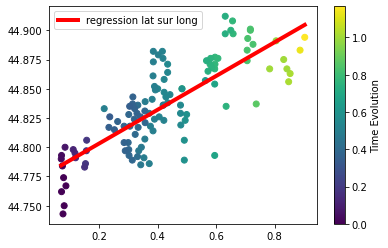

[0.14420828429560292, 44.77441425398914]

In [ ]:
regression_visu(visu_results,154)

la trajectoire a pour équation : 0.14420828429560292 *x + 44.77441425398914
le coefficient de regression vaut 0.6172378588420568


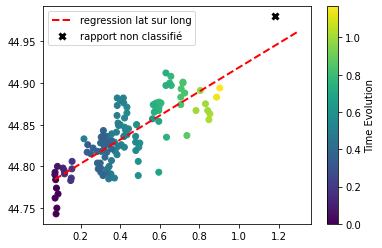

In [ ]:
  orage = visu_results[visu_results.CLASSI == 154]
  X = np.array(orage.LONGITUDE).reshape(-1, 1)
  Y = np.array(orage.LATITUDE).reshape(-1, 1)
  reg = LinearRegression().fit(X, Y)
  reg.score(X, Y)
  ordonnée = float(reg.intercept_)
  pente = float(reg.coef_)
  print ("la trajectoire a pour équation :", pente,'*x +', ordonnée)
  print ("le coefficient de regression vaut", reg.score(X,Y))

  ## on trace l'orage et sa trajectoire régressée

  borne_basse,borne_haute = orage.describe().iloc[3,1],orage.describe().iloc[-1,1]
  xx = np.linspace(borne_basse,1.3)
  yy = [lineaire(pente,ordonnée,e) for e in xx]
  temps = [orage.iloc[i,0] - orage.iloc[-1,0] for i in range(len(orage))]
  plt.scatter(orage.LONGITUDE,orage.LATITUDE,c = temps)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.plot(xx,yy,linewidth = 2,color = 'red',ls = '--',label = 'regression lat sur long')
  plt.scatter(1.18,44.98,color = 'black', marker = 'x', linewidth = 3, label = 'rapport non classifié')
  plt.legend()
  plt.show()


la trajectoire a pour équation : 0.6977754211172345 *x + 46.42547552918832
le coefficient de regression vaut 0.9425339531598488


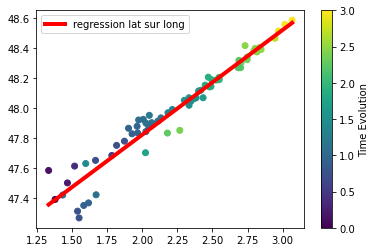

[0.6977754211172345, 46.42547552918832]

In [ ]:
regression_visu(visu_results,103)

la trajectoire a pour équation : 0.47040730840408906 *x + 44.97264121899874
le coefficient de regression vaut 0.8676437309529764


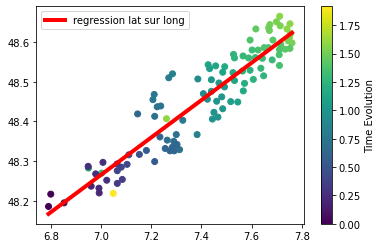

[0.47040730840408906, 44.97264121899874]

In [ ]:
regression_visu(visu_results,59)

la trajectoire a pour équation : 0.26605391427523584 *x + 48.08606108458218
le coefficient de regression vaut 0.4973537265412813


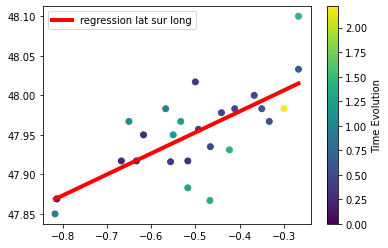

[0.26605391427523584, 48.08606108458218]

In [ ]:
regression_visu(visu_results,168)

In [ ]:
1/2,np.arctan(1/2), np.arctan(1/2)*180/np.pi #coef de la pente,angle de la pente en rad, angle de la pente en degré

(0.4636476090008061, 26.56505117707799)

In [ ]:
def condition_pente_visu(visu_results,cluster1,cluster2,seuil_pente_degre):
  pente1,ordonnée1 = regression(visu_results,cluster1)
  pente2,ordonnée2 = regression(visu_results,cluster2)

  orage_1 = visu_results[visu_results.CLASSI == cluster1]
  orage_2 = visu_results[visu_results.CLASSI == cluster2]

  borne_basse_1,borne_haute_1 = orage_1.describe().iloc[3,1],orage_1.describe().iloc[-1,1]
  borne_basse_2,borne_haute_2 = orage_2.describe().iloc[3,1],orage_2.describe().iloc[-1,1]

  borne_basse,borne_haute = np.min([borne_basse_1,borne_basse_2]), np.max([borne_haute_1,borne_haute_2])

  xx_1 = np.linspace(borne_basse_1,borne_haute_1)
  xx_2 = np.linspace(borne_basse_2,borne_haute_2)
  xx = np.linspace(borne_basse,borne_haute)

  yy_1 = [lineaire(pente1,ordonnée1,e) for e in xx]
  yy_2 = [lineaire(pente2,ordonnée2,e) for e in xx]


  #temps_1 = [orage_1.iloc[i,0] - orage_1.iloc[-1,0] for i in range(len(orage_1))]
  #temps_2 = [orage_2.iloc[i,0] - orage_2.iloc[-1,0] for i in range(len(orage_2))]

  plt.scatter(orage_1.LONGITUDE,orage_1.LATITUDE, color = 'lightsalmon')#,c = temps)
  plt.plot(xx_1,[lineaire(pente1,ordonnée1,e) for e in xx_1],linewidth = 3, color = 'red')
  plt.plot(xx,yy_1,linewidth = 1,color = 'red',linestyle='--', label = 'regression cluster1 lat sur long')
  #cbar = plt.colorbar()
  #cbar.set_label('Time Evolution')
  plt.scatter(orage_2.LONGITUDE,orage_2.LATITUDE, color = 'lightskyblue')#,c = temps)
  plt.plot(xx_2,[lineaire(pente2,ordonnée2,e) for e in xx_2],linewidth = 3, color = 'blue')
  plt.plot(xx,yy_2,linewidth = 1,color = 'blue',linestyle='--',label = 'regression cluster2 lat sur long')
  plt.legend()
  plt.show()

  #calcul de la différence des pentes avec les angles
  angle1,angle2 = np.arctan(pente1)*180/np.pi,np.arctan(pente2)*180/np.pi

  return abs(angle1 - angle2) < seuil_pente_degre

In [ ]:
def condition_pente(visu_results,cluster1,cluster2,seuil_pente_degre):
  pente1,ordonnée1 = regression(visu_results,cluster1)
  pente2,ordonnée2 = regression(visu_results,cluster2)

  #calcul de la différence des pentes avec les angles
  angle1,angle2 = np.arctan(pente1)*180/np.pi,np.arctan(pente2)*180/np.pi

  return abs(angle1 - angle2) < seuil_pente_degre

In [ ]:
def condition_distance(visu_results,cluster1,cluster2,seuil_distance,type):
  distance = distance_cluster_cluster(visu_results,cluster1,cluster2,type)
  return distance < seuil_distance

In [ ]:
def condition_temps(visu_results,cluster1,cluster2,seuil_temps):
  
  # par principe, on suppose toujours que le cluster1 a lieu après le cluster2
  # c'est-à-dire cluster1 < cluster2

  start_time_cluster1 = visu_results[visu_results.CLASSI == cluster1].iloc[-1,0]
  end_time_cluster2 = visu_results[visu_results.CLASSI == cluster2].iloc[0,0]

  return start_time_cluster1 - end_time_cluster2 < seuil_temps

In [ ]:
def condition_temps2(visu_results,cluster1,cluster2,seuil_temps):

  start_time_cluster1 = visu_results[visu_results.CLASSI == cluster1].iloc[-1,0]
  end_time_cluster1 = visu_results[visu_results.CLASSI == cluster1].iloc[0,0]

  start_time_cluster2 = visu_results[visu_results.CLASSI == cluster2].iloc[-1,0]
  end_time_cluster2 = visu_results[visu_results.CLASSI == cluster2].iloc[0,0]
  
  delta1 = abs(start_time_cluster1 - end_time_cluster2) #si cluster1 a lieu après cluster2
  delta2 = abs(start_time_cluster2 - end_time_cluster1) #si cluster1 a lieu avant cluster2

  delta = np.min([delta1,delta2])
  return delta < seuil_temps

In [ ]:
trouver temps minimal entre deux clusters sans suppposer que le cluster1 a eu lieu après cluster2

In [ ]:
def select_n_min(liste,n):
    ensemble = liste.copy()
    ensemble.sort()
    return ensemble[:n]

In [ ]:
def condition_densite(visu_results,cluster1,cluster2,seuil_densite,c = 0.1):

  orage1 = visu_results[visu_results.CLASSI == cluster1]
  orage2 = visu_results[visu_results.CLASSI == cluster2]
  lat_mean = (orage1.describe().iloc[1,0] + orage2.describe().iloc[1,0])/2
  long_mean = (orage1.describe().iloc[1,1] + orage2.describe().iloc[1,1])/2

  # on définit un carré autour de notre position moyenne 

  lat_mean_up,lat_mean_down = lat_mean+c,lat_mean-c
  long_mean_up,long_mean_down = long_mean+c,long_mean-c

  # on réduit la taille du dataset démog en sélectionnant les carreaux proches de notre position moyenne entre orages

  demog_2 = demog_use[(demog_use.Latitude < lat_mean_up) & (demog_use.Latitude > lat_mean_down) & (demog_use.Longitude < long_mean_up) & (demog_use.Longitude > long_mean_down)]

  # on choisit les c carrés les plus proches de la position pour estimer une densité moyenne

  #n = len(demog_2)
  densite_moyenne = demog_2['Ind'].mean() #mean de Ind
  #for i in range(n):
    #loin = (demog_2.iloc[i,1]-lat_mean)**2 + (demog_2.iloc[i,2]-long_mean)**2
    #dist.append(loin)
  #demog_2["Distance"] = dist

  #c_carrés = select_n_min(dist,c)
  #densité_moyenne = []
  #for j in range(c):
    #densité_moyenne.append(demog_2[demog_2.Distance == c_carrés[j]].iloc[0,0])
  return densite_moyenne < seuil_densite



In [ ]:
demog_use['Ind'].describe()

count    374797.000000
mean        167.752780
std         786.623702
min           1.000000
25%           8.000000
50%          22.000000
75%          78.000000
max       47997.500000
Name: Ind, dtype: float64

In [ ]:
def fusion(visu_results,cluster1,cluster2,seuil_pente,seuil_distance,type,seuil_temps,seuil_densite,c):
  if condition_temps(visu_results,cluster1,cluster2,seuil_temps):
    if condition_distance(visu_results,cluster1,cluster2,seuil_distance,type):
      if condition_pente(visu_results,cluster1,cluster2,seuil_pente):
        if condition_densite(visu_results,cluster1,cluster2,seuil_densite,c):
          print('TOUTES LES CONDITIONS SONT VALIDEES POUR FUSIONNER')
          #n1 = len(visu_results[visu_results.CLASSI == cluster1])
          #for i in range(n1):
            #visu_results[visu_results.CLASSI == cluster1].CLASSI = cluster2
  else:
    print('PAS DE FUSION')
  #return visu_results

In [ ]:
def fusion2(visu_results,cluster1,cluster2,seuil_pente_degre = 20,seuil_distance = 0.5,type = "moyenne",
            seuil_temps = 2,seuil_densite = 80,c = 0.1):

  L = [condition_temps2(visu_results,cluster1,cluster2,seuil_temps),condition_distance(visu_results,cluster1,cluster2,seuil_distance,type),
       condition_pente(visu_results,cluster1,cluster2,seuil_pente_degre),condition_densite(visu_results,cluster1,cluster2,seuil_densite,c)]

  if sum(L) == len(L):
    print('TOUTES LES CONDITIONS SONT VALIDEES POUR FUSIONNER')

  else:
    print('PAS DE FUSION')
    print("conditions validées ou non dans l'ordre : temps, distance, pente, densité")
    print(L)
  return sum(L) == len(L)

In [ ]:
fusion2(visu_results,4,9)#,20,0.5,"moyenne",2,20,0.2)

PAS DE FUSION
conditions validées ou non dans l'ordre : temps, distance, pente, densité
[True, False, False, True]


False

In [ ]:
def fusion3(visu_results,cluster1,cluster2,seuil_pente_degre = 30,seuil_distance = 1,type = "moyenne",
            seuil_temps = 3,seuil_densite = 70,c = 0.1):

  L = [condition_temps2(visu_results,cluster1,cluster2,seuil_temps),condition_distance(visu_results,cluster1,cluster2,seuil_distance,type),
       condition_pente(visu_results,cluster1,cluster2,seuil_pente_degre),condition_densite(visu_results,cluster1,cluster2,seuil_densite,c)]
  return sum(L) == len(L)

In [ ]:
def fusion4(visu_results,cluster1,cluster2,seuil_pente_degre = 30,seuil_distance = 1,type = "moyenne",
            seuil_temps = 3,seuil_densite = 70,c = 0.1):

  L = [condition_temps2(visu_results,cluster1,cluster2,seuil_temps),condition_distance(visu_results,cluster1,cluster2,seuil_distance,type),
       condition_pente(visu_results,cluster1,cluster2,seuil_pente_degre),condition_densite(visu_results,cluster1,cluster2,seuil_densite,c),
       condition_tempo(visu_results,cluster1,clusetr2)]
  return sum(L) == len(L)

In [ ]:
regarder sur allemagne, plus de rapports

# Recherche clusters possiblement fusionnables

In [ ]:
data = df5[df5.YEAR == 2022]
data = data[data.COUNTRY == 'FR']
data_visu = data[['TIME_EVENT','LATITUDE','LONGITUDE']]
model_visu = ST_DBSCAN(eps1=0.16, eps2=1,
                         min_samples=2)
model_visu.fit(data_visu)
classi_visu = model_visu.labels
visu_results = data_visu.copy()
visu_results['CLASSI'] = classi_visu
orages_visu = cluster2(data_visu,classi_visu)

In [ ]:
l_visu = np.unique(classi_visu, return_counts = True)[1]

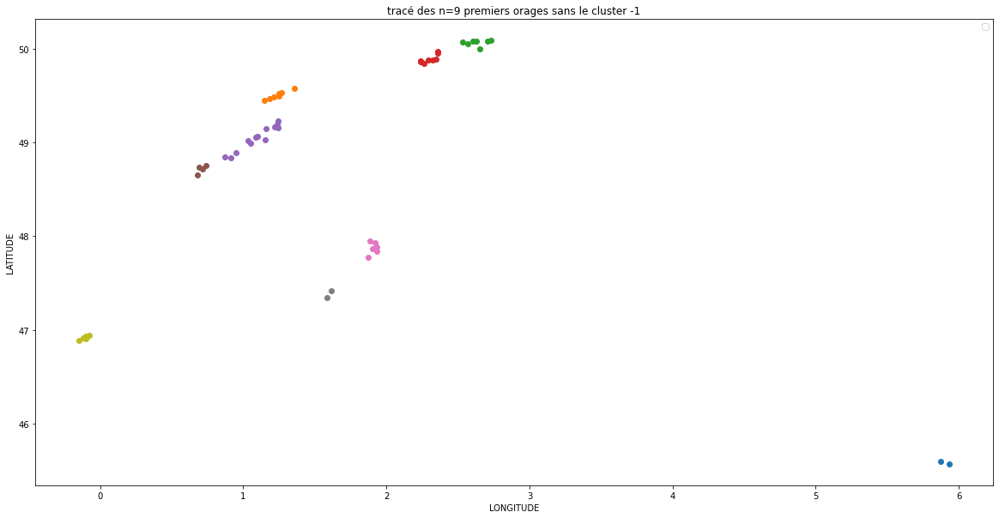

In [ ]:
constru(data_visu,orages_visu,10,l_visu)

la trajectoire a pour équation : 1.3647832505704125 *x + 47.747142262783505
le coefficient de regression vaut 0.5719075648020354


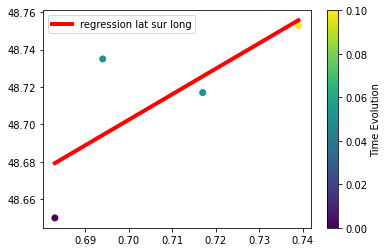

[1.3647832505704125, 47.747142262783505]

In [ ]:
regression_visu(visu_results,5)

la trajectoire a pour équation : 0.9916113353737217 *x + 47.96120236509503
le coefficient de regression vaut 0.9333814706514761


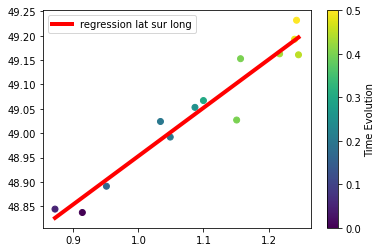

[0.9916113353737217, 47.96120236509503]

In [ ]:
regression_visu(visu_results,4)

In [ ]:
visu_results[visu_results.CLASSI == 4],visu_results[visu_results.CLASSI == 5]

(       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 28  138356.466667    49.232      1.243       4
 29      138356.45    49.193      1.240       4
 31  138356.416667    49.161      1.246       4
 32       138356.4    49.163      1.217       4
 33  138356.366667    49.153      1.157       4
 34  138356.366667    49.027      1.151       4
 35  138356.266667    49.067      1.100       4
 36  138356.216667    49.053      1.087       4
 37  138356.166667    49.024      1.034       4
 38  138356.166667    48.992      1.049       4
 39  138356.133333    48.891      0.951       4
 40  138356.016667    48.844      0.872       4
 41  138355.966667    48.837      0.914       4,
    TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 42  138355.75    48.753      0.739       5
 43   138355.7    48.735      0.694       5
 44   138355.7    48.717      0.717       5
 45  138355.65    48.650      0.683       5)

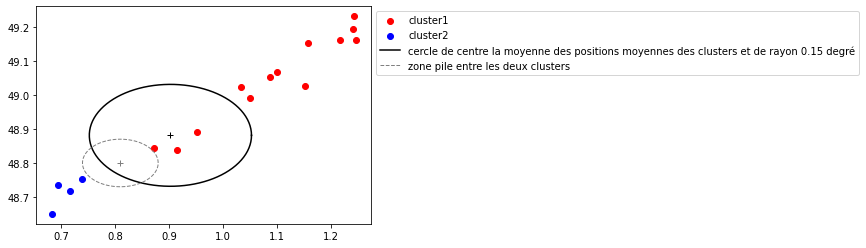

In [ ]:
longi1 = visu_results[visu_results.CLASSI == 4].LONGITUDE.values
lati1 = visu_results[visu_results.CLASSI == 4].LATITUDE.values

longi2 = visu_results[visu_results.CLASSI == 5].LONGITUDE.values
lati2 = visu_results[visu_results.CLASSI == 5].LATITUDE.values

longi1_mean = np.mean(longi1)
lati1_mean = np.mean(lati1)

longi_mid = (np.mean(longi1)+np.mean(longi2))/2
lati_mid = (np.mean(lati1)+np.mean(lati2))/2

plt.scatter(longi1,lati1,color = 'red', label = 'cluster1')
plt.scatter(longi2,lati2,color = 'blue', label = 'cluster2')

r = 0.15
theta = np.linspace(0, 2*np.pi, 100)
x1 = r*np.cos(theta) + longi_mid
x2 = r*np.sin(theta) + lati_mid
plt.plot(x1,x2, color = 'black', label = 'cercle de centre la moyenne des positions moyennes des clusters et de rayon 0.15 degré')
plt.plot(longi_mid,lati_mid, color = 'black', marker = '+')

rprime = 0.07
x11 = rprime*np.cos(theta) + 0.81
x22 = rprime*np.sin(theta) + 48.8
plt.plot(x11,x22, color = 'grey', linestyle = '--', linewidth = 1, label = 'zone pile entre les deux clusters')
plt.plot(0.81,48.8, color = 'grey', marker = '+')

#plt.text(longi_mid, lati_mid+0.05, 'position moyenne entre les deux clusters', horizontalalignment = 'center', verticalalignment = 'center')

plt.legend(bbox_to_anchor=(1, 1))
plt.show()

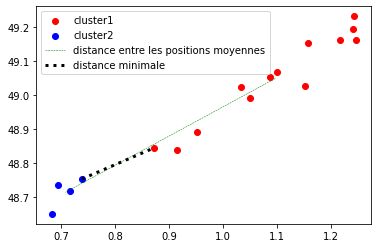

In [ ]:
longi1 = visu_results[visu_results.CLASSI == 4].LONGITUDE.values
lati1 = visu_results[visu_results.CLASSI == 4].LATITUDE.values

longi2 = visu_results[visu_results.CLASSI == 5].LONGITUDE.values
lati2 = visu_results[visu_results.CLASSI == 5].LATITUDE.values

longi1_mean = np.mean(longi1)
lati1_mean = np.mean(lati1)

longi_mid = (np.mean(longi1)+np.mean(longi2))/2
lati_mid = (np.mean(lati1)+np.mean(lati2))/2

plt.scatter(longi1,lati1,color = 'red', label = 'cluster1')
plt.scatter(longi2,lati2,color = 'blue', label = 'cluster2')

plt.plot([np.mean(longi1),np.mean(longi2)],[np.mean(lati1),np.mean(lati2)], color = 'green', linewidth = 0.5, linestyle = '--', label = 'distance entre les positions moyennes')
plt.plot([0.739,0.872],[48.753,48.844], color = 'black', linestyle = 'dotted', linewidth = 3, label = 'distance minimale')
plt.legend()
plt.show()

In [ ]:
fusion2()

In [ ]:
fusion2(visu_results,4,5,20,0.5,"moyenne",2,70,0.2)

PAS DE FUSION
conditions validées ou non dans l'ordre : temps, distance, pente, densité
[True, True, True, False]


False

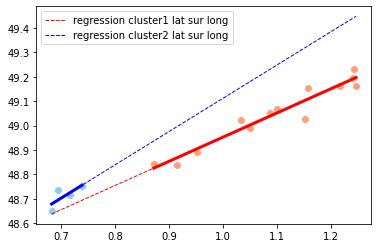

True

In [ ]:
condition_pente_visu(visu_results,4,5,10)

In [ ]:
fusion(visu_results,4,9,0.5,1,"moyenne",1,15,4)

PAS DE FUSION


In [ ]:
visu_results[visu_results.CLASSI == 4],visu_results[visu_results.CLASSI == 9]

(       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 28  138356.466667    49.232      1.243       4
 29      138356.45    49.193      1.240       4
 31  138356.416667    49.161      1.246       4
 32       138356.4    49.163      1.217       4
 33  138356.366667    49.153      1.157       4
 34  138356.366667    49.027      1.151       4
 35  138356.266667    49.067      1.100       4
 36  138356.216667    49.053      1.087       4
 37  138356.166667    49.024      1.034       4
 38  138356.166667    48.992      1.049       4
 39  138356.133333    48.891      0.951       4
 40  138356.016667    48.844      0.872       4
 41  138355.966667    48.837      0.914       4,
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 250  137423.416667    43.700      1.517       9
 251  137423.416667    43.683      1.317       9
 253  137422.416667    43.700      1.433       9)

la trajectoire a pour équation : 0.9916113353737217 *x + 47.96120236509503
le coefficient de regression vaut 0.9333814706514761


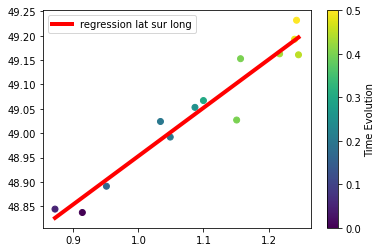

la trajectoire a pour équation : 0.0887757800105922 *x + 43.56806458223161
le coefficient de regression vaut 0.8250925436276754


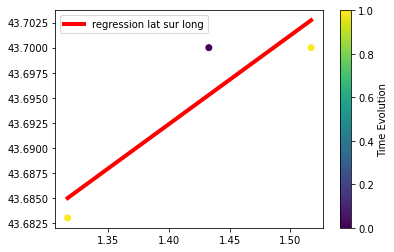

([0.9916113353737217, 47.96120236509503],
 [0.0887757800105922, 43.56806458223161])

In [ ]:
regression_visu(visu_results,4),regression_visu(visu_results,9)

# Choix des seuils

différents seuils:
- différence maximale entre les valeurs des pentes des trajectoires
- temps maximal entre deux orages
- distance maximale entre deux orages
- densité de population maximale entre deux orages

In [ ]:
essayer de le faire avec des points du cluster poubelle : si conditions temp, densité et sur la trajectoire de l orage alors on peut envisager de
l inclure

In [ ]:
préparer slides prés, full projet depuis preprocessing

In [ ]:
tuning paramètres, seuils

(array([91811., 62251., 38365., 25735., 17935., 13321., 10621.,  8685.,
         7165.,  6307.,  5369.,  4608.,  4243.,  3761.,  3523.,  3047.,
         2843.,  2561.,  2380.,  2090.,  2082.,  1875.,  1693.,  1635.,
         1569.,  1439.,  1397.,  1288.,  1206.,  1102.,  1051.,  1012.,
         1005.,   855.,   896.,   881.,   784.,   753.,   745.,   759.,
          685.,   677.,   640.,   670.,   616.,   573.,   553.,   553.,
          507.,   551.]),
 array([  0.,   8.,  16.,  24.,  32.,  40.,  48.,  56.,  64.,  72.,  80.,
         88.,  96., 104., 112., 120., 128., 136., 144., 152., 160., 168.,
        176., 184., 192., 200., 208., 216., 224., 232., 240., 248., 256.,
        264., 272., 280., 288., 296., 304., 312., 320., 328., 336., 344.,
        352., 360., 368., 376., 384., 392., 400.]),
 <BarContainer object of 50 artists>)

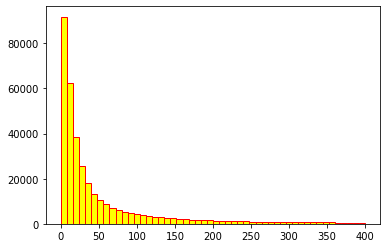

In [ ]:
x = demog_use['Ind']
plt.hist(x, range = (0, 400), bins = 50, color = 'yellow',
            edgecolor = 'red')

In [ ]:
#département le moins peuplé de France = Lozère 14 habitants au km2
#en France en moyenne = 105

In [ ]:
#on peut mettre le seuil à 25 hab/km2
seuil_densité = 

In [ ]:
regression(visu_results,1)[0]

0.6531124712104298

In [ ]:
n = len(visu_results)
x = [i for i in range(182)]
pentes = []
for i in x:
  pentes.append(regression(visu_results,i)[0])
  

In [ ]:
pentes

In [ ]:
pentes.index(max(pentes))
pentes.index(min(pentes))

128

Text(0.5, 1.0, 'Zoom sur le centre')

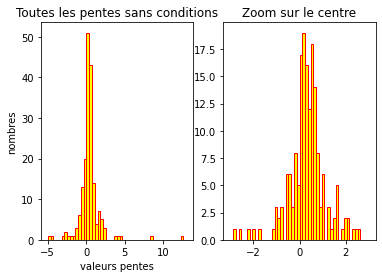

In [ ]:
plt.subplot(121)
plt.hist(pentes, range = (-5,13), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('valeurs pentes')
plt.ylabel('nombres')
plt.title('Toutes les pentes sans conditions')

plt.subplot(122)
plt.hist(pentes, range = (-3,3), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.title('Zoom sur le centre')

In [ ]:
compte_1 = 0
compte_2 = 0
for p in pentes:
  if p>0 and p<1:
    compte_1+=1
  if p>0 and p<2:
    compte_2+=1
pourcentage = compte_1*100/len(pentes)
pourcentage_2 = compte_2*100/len(pentes)
print(str(round(pourcentage,1))+'% de pentes entre 0 et 45°')
print(str(round(pourcentage_2,1))+'% de pentes entre 0 et 64°')

59.3% de pentes entre 0 et 45°
67.6% de pentes entre 0 et 64°


In [ ]:
n = len(visu_results)
xX = [i for i in range(182)]
pentes2 = []
for i in x:
  if len(visu_results[visu_results.CLASSI == i]) >4:
    pentes2.append(regression(visu_results,i)[0])
  

Text(0.5, 1.0, 'Toutes les pentes avec minimum 5 rapports')

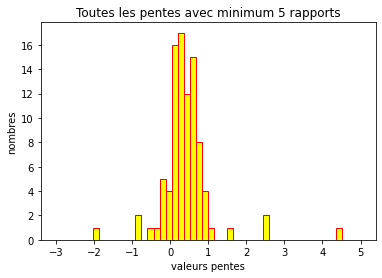

In [ ]:
#plt.subplot(121)
plt.hist(pentes2, range = (-3,5), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('valeurs pentes')
plt.ylabel('nombres')
plt.title('Toutes les pentes avec minimum 5 rapports' )

In [ ]:
#grosse majorité entre 0 et 1 -> angle entre 0 et 45°

# Tests fusion FRANCE

In [ ]:
fusion3(visu_results,4,5)

False

In [ ]:
# on teste toutes les combinaisons de clusters 

In [ ]:
180*181/2

16290.0

In [ ]:
def renvoie_true(listee):
  n = len(listee)
  fus_ok = []
  for i in range(n):
    if listee[i][-1]:
      fus_ok.append(listee[i][:-1])
  return fus_ok

In [ ]:
def fusion_all_FR(visu_results,r):
  n = max(visu_results['CLASSI'])
  fus = []
  compteur = 0
  total = (n+1-r)*r + r*(r-1)/2
  for i in range(0,n+1-r):
    for j in range(i+1,i+r+1):
      compteur +=1
      fus.append([i,j,fusion3(visu_results,i,j)])
      if compteur == total//4:
        print('25%')
      elif compteur == total//2:
        print('50%')
      elif compteur == (3*total)//4:
        print('75%')
  for i in range(n-r,n):
    for j in range(i+1,n+1):
      fus.append([i,j,fusion3(visu_results,i,j)])
      compteur+=1
      if compteur == 3*total//4:
        print('75%')
  return fus,renvoie_true(fus)
      

In [ ]:
fusion3()

In [ ]:
fus,true_fus = fusion_all_FR(visu_results,5)

25%
50%
75%


In [ ]:
true_fus

[[151, 153]]

In [ ]:
def fus_plot(visu_results,cluster1,cluster2):
  longi1 = visu_results[visu_results.CLASSI == cluster1].LONGITUDE.values
  lati1 = visu_results[visu_results.CLASSI == cluster1].LATITUDE.values
  temps1 = visu_results[visu_results.CLASSI == cluster1].TIME_EVENT.values

  longi2 = visu_results[visu_results.CLASSI == cluster2].LONGITUDE.values
  lati2 = visu_results[visu_results.CLASSI == cluster2].LATITUDE.values
  temps2 = visu_results[visu_results.CLASSI == cluster2].TIME_EVENT.values

  longi1_mean = np.mean(longi1)
  lati1_mean = np.mean(lati1)

  longi_mid = (np.mean(longi1)+np.mean(longi2))/2
  lati_mid = (np.mean(lati1)+np.mean(lati2))/2

  plt.scatter(longi1,lati1,color = 'red',label = 'cluster '+str(cluster1))
  plt.scatter(longi2,lati2,color = 'blue',label = 'cluster '+str(cluster2))

  #plt.scatter(longi1,lati1,marker = 'o',label = 'cluster '+str(cluster1), c = temps1)
  #plt.scatter(longi2,lati2,marker = '>',label = 'cluster '+str(cluster2), c = temps2)
  #cbar = plt.colorbar()
  #cbar.set_label('Time Evolution')

  r = 0.1
  theta = np.linspace(0, 2*np.pi, 100)
  x1 = r*np.cos(theta) + longi_mid
  x2 = r*np.sin(theta) + lati_mid
  plt.plot(x1,x2, color = 'black', label = 'cercle de centre la moyenne des positions moyennes des clusters et de rayon 0.1 degré')
  plt.plot(longi_mid,lati_mid, color = 'black', marker = '+')

  plt.legend(bbox_to_anchor = (1.3,1))
  plt.show()

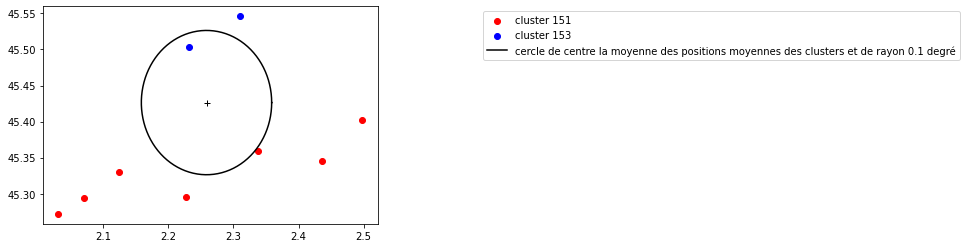

In [ ]:
fus_plot(visu_results,151,153)

In [ ]:
visu_results[visu_results.CLASSI == 151],visu_results[visu_results.CLASSI == 152],visu_results[visu_results.CLASSI == 153]

(         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 5559  134928.916667    45.402      2.498     151
 5565  134928.716667    45.345      2.436     151
 5567       134928.5    45.359      2.338     151
 5568      134928.35    45.295      2.228     151
 5576      134927.95    45.294      2.071     151
 5578  134927.916667    45.272      2.031     151
 5579  134927.916667    45.330      2.124     151,
          TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 5577  134927.916667    45.446      4.378     152
 5580  134927.783333    45.432      4.321     152,
          TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 5601       134927.0    45.546      2.310     153
 5605  134926.916667    45.503      2.232     153)

In [ ]:
def pipe_fusion_FR(visu_results,r):
  fus_r,true_fus_r = fusion_all_FR(visu_results,r)
  if len(true_fus_r) == 0:
    return('pas de fusion')
  else:
    n = len(true_fus_r)
    for i in range(n):
      fus_plot(visu_results,true_fus_r[i][0],true_fus_r[i][1])
      print(visu_results[visu_results.CLASSI == true_fus_r[i][0]])
      print(visu_results[visu_results.CLASSI == true_fus_r[i][1]])


25%
50%
75%


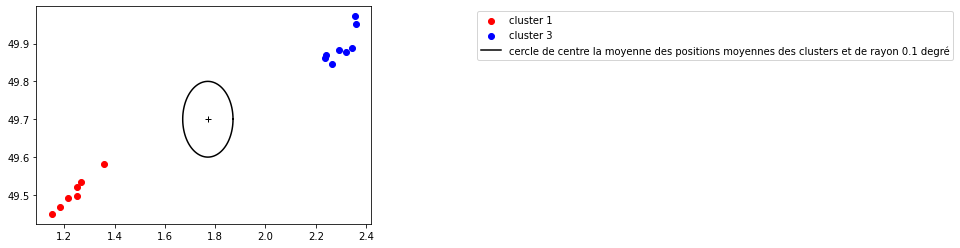

       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4   138358.416667    49.583      1.358       1
5   138358.333333    49.533      1.267       1
6        138358.3    49.521      1.251       1
7   138358.283333    49.498      1.250       1
8       138358.25    49.492      1.216       1
9   138358.216667    49.467      1.183       1
10  138358.166667    49.450      1.150       1
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
18      138357.85    49.887      2.345       3
19  138357.766667    49.972      2.356       3
20      138357.75    49.952      2.360       3
21       138357.7    49.877      2.322       3
22  138357.666667    49.847      2.265       3
23  138357.666667    49.884      2.294       3
24  138357.633333    49.870      2.241       3
25  138357.633333    49.861      2.238       3


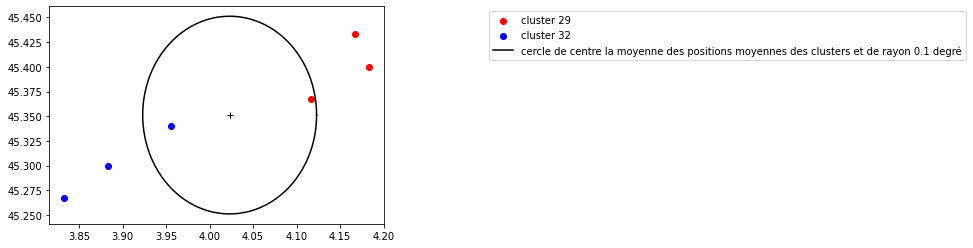

        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
977  136746.333333    45.400      4.183      29
978      136746.25    45.433      4.167      29
982  136745.966667    45.367      4.117      29
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32


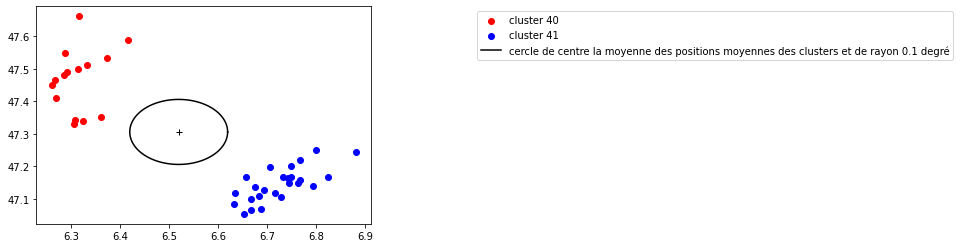

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1645  136077.283333    47.662      6.316      40
1656  136077.116667    47.589      6.416      40
1664      136077.05    47.549      6.288      40
1670       136077.0    47.535      6.374      40
1671  136076.966667    47.491      6.292      40
1672  136076.966667    47.501      6.314      40
1674      136076.95    47.511      6.333      40
1675  136076.916667    47.481      6.285      40
1677  136076.883333    47.449      6.260      40
1683  136076.833333    47.467      6.267      40
1692      136076.75    47.409      6.269      40
1705       136076.6    47.343      6.308      40
1706  136076.583333    47.351      6.361      40
1707  136076.583333    47.339      6.324      40
1708  136076.566667    47.332      6.306      40
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1684  136076.833333    47.244      6.882      41
1694      136076.75    47.168      6.825      41
1696  136076.716667    47.250      6.800      41
1697  136076.666667 

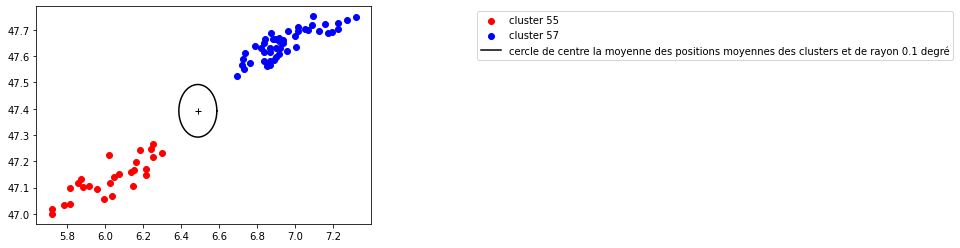

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3235       135507.0    47.217      6.250      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3240  135506.983333    47.267      6.250      55
3241  135506.966667    47.107      6.145      55
3242  135506.966667    47.147      6.215      55
3243      135506.95    47.243      6.180      55
3244      135506.95    47.199      6.159      55
3247       135506.9    47.167      6.150      55
3248  135506.883333    47.158      6.137      55
3251  135506.833333    47.152      6.069      55
3257  135506.783333    47.142      6.046      55
3258  135506.783333    47.117      6.025      55
3261      135506.75    47.067      6.033      55
3262      135506.75    47.226      6.020      55
3263      135506.75    47.056      5.993      55
3266       135506.7    47.093      5.956      55
3269  135506.683333    47.108      5.914      55
3273      135506.65 

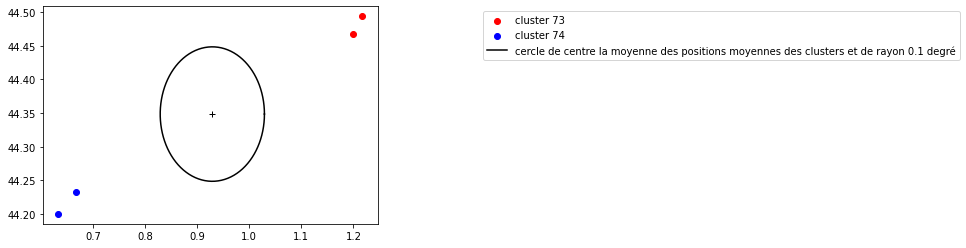

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74


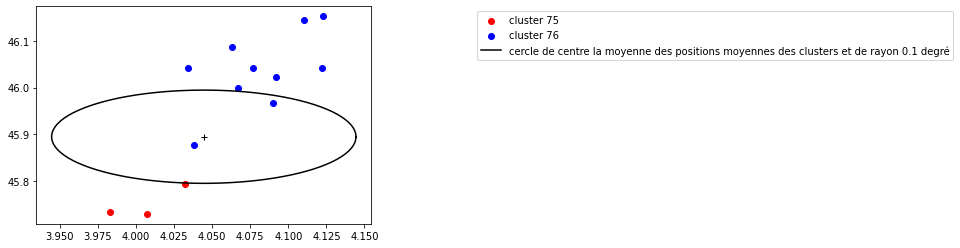

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3638       135406.0    45.793      4.032      75
3640      135405.75    45.729      4.007      75
3641  135405.716667    45.733      3.983      75
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3645  135404.866667    46.153      4.123      76
3647  135404.833333    46.146      4.110      76
3650      135404.75    46.086      4.063      76
3651  135404.666667    46.041      4.077      76
3652  135404.666667    46.041      4.122      76
3654  135404.633333    46.043      4.034      76
3656  135404.583333    46.022      4.092      76
3658  135404.516667    46.000      4.067      76
3660  135404.416667    45.966      4.090      76
3666      135404.25    45.877      4.038      76


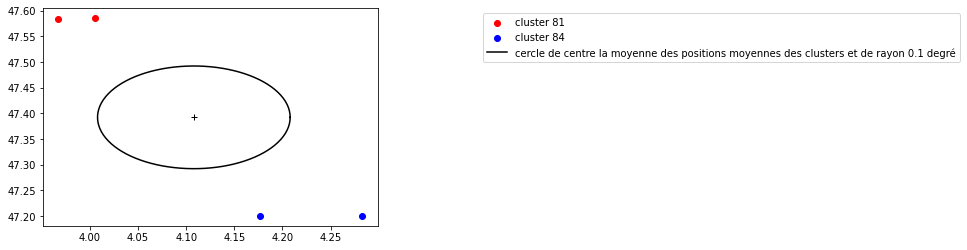

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3700  135386.916667    47.585      4.005      81
3701  135386.833333    47.583      3.967      81
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3737  135385.383333      47.2      4.177      84
3739      135385.15      47.2      4.283      84


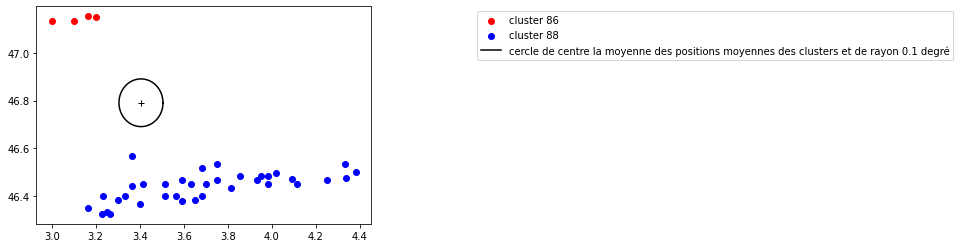

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3787  135383.716667    47.150      3.200      86
3788  135383.683333    47.154      3.167      86
3789  135383.666667    47.133      3.100      86
3803      135383.45    47.133      3.000      86
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667 

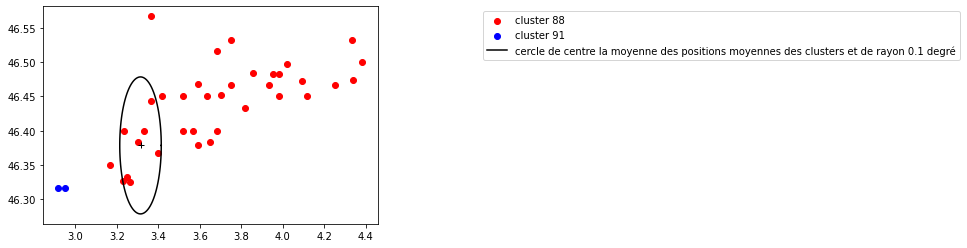

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0    46.533      3.750      88
3877       135381.0    46.452      3.703      88
3884      135380.95    46.567      3.367      88
3886  135380.933333 

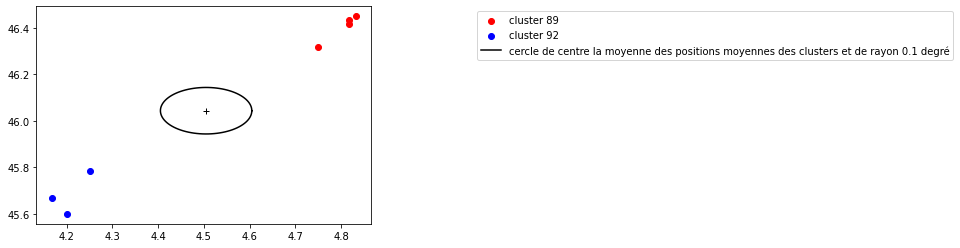

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92


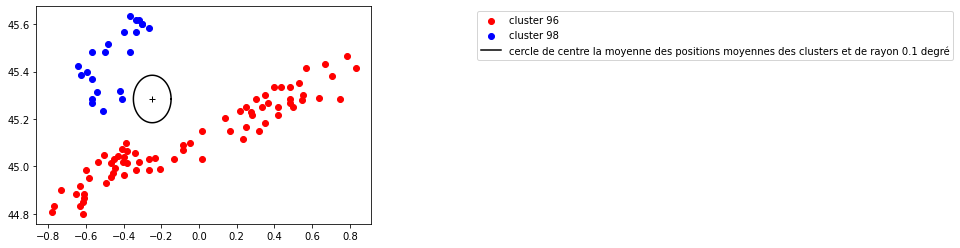

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      

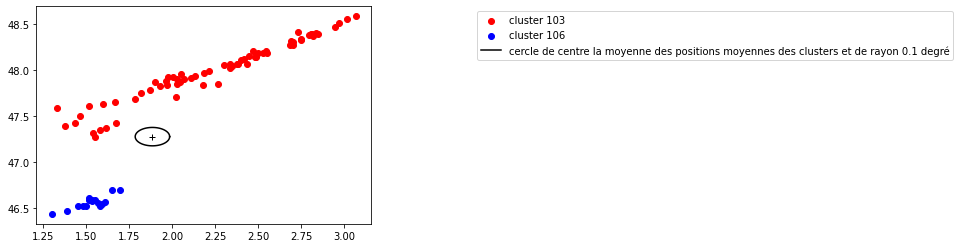

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4261      135338.95    48.583      3.067     103
4262  135338.916667    48.555      3.015     103
4263      135338.85    48.511      2.970     103
4265  135338.666667    48.463      2.945     103
4271      135338.45    48.388      2.846     103
...             ...       ...        ...     ...
4400       135336.5    47.683      1.783     103
4402  135336.333333    47.612      1.518     103
4403  135336.166667    47.500      1.467     103
4404  135336.083333    47.583      1.333     103
4405      135335.95    47.390      1.379     103

[67 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     1

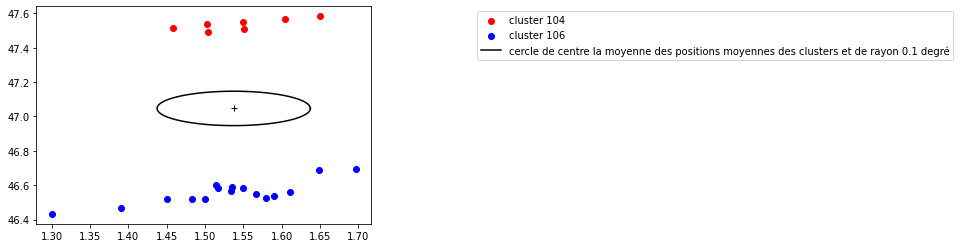

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333 

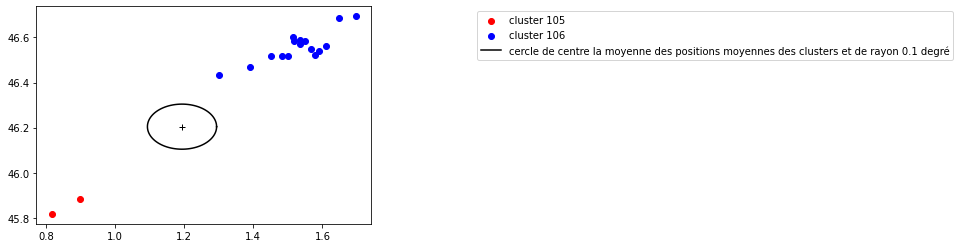

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106


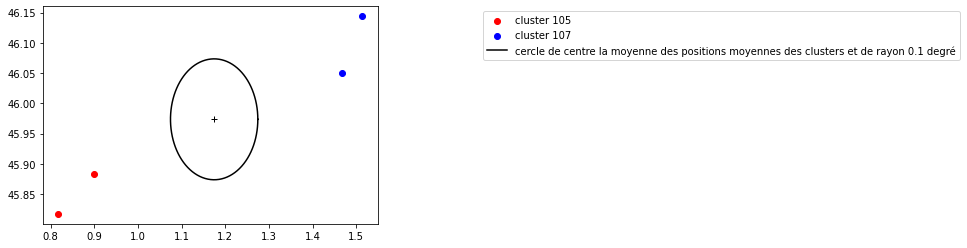

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4297      135337.95    46.144      1.514     107
4317  135337.683333    46.050      1.467     107


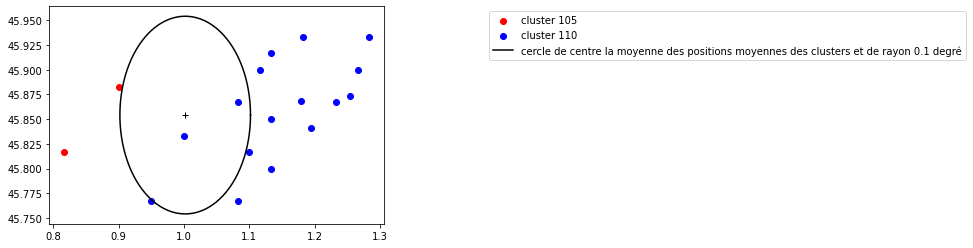

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110


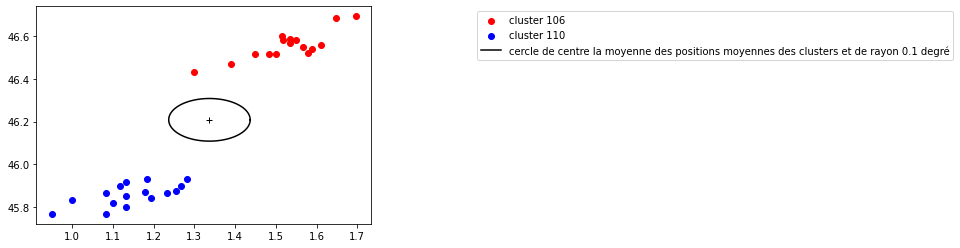

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333 

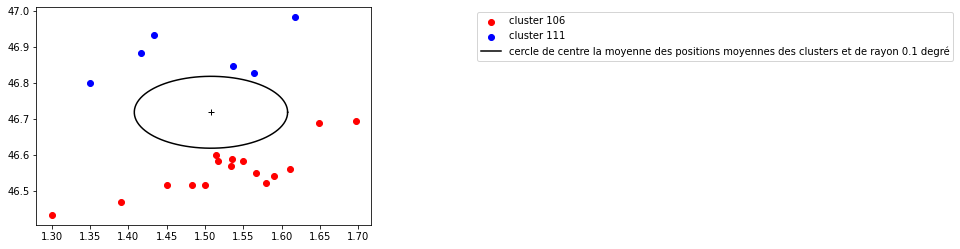

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

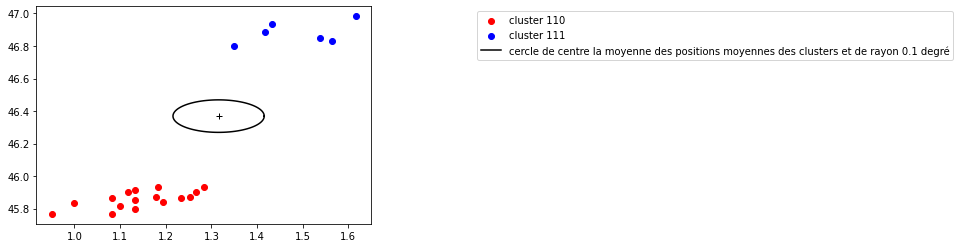

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

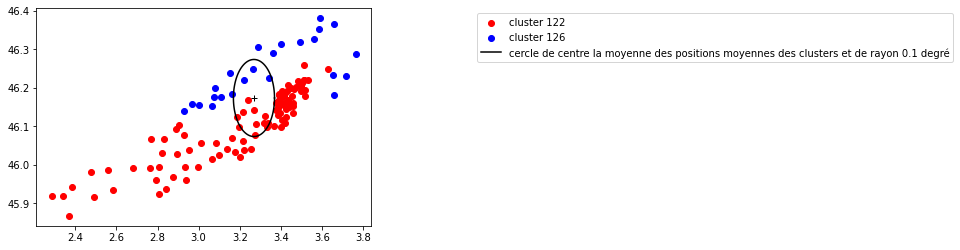

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     1

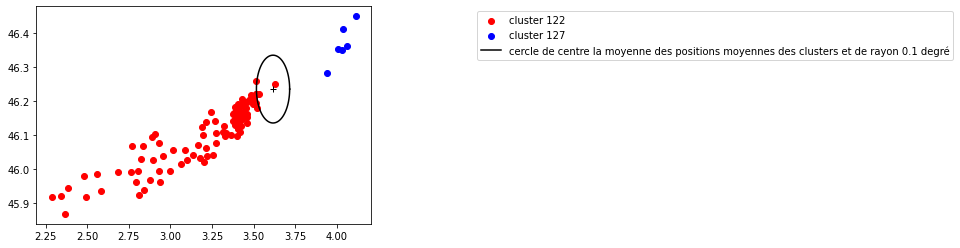

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


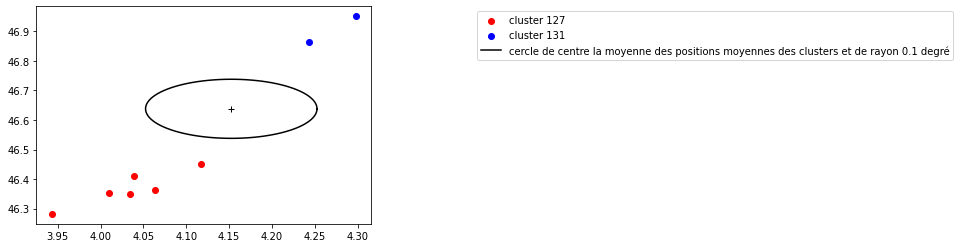

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


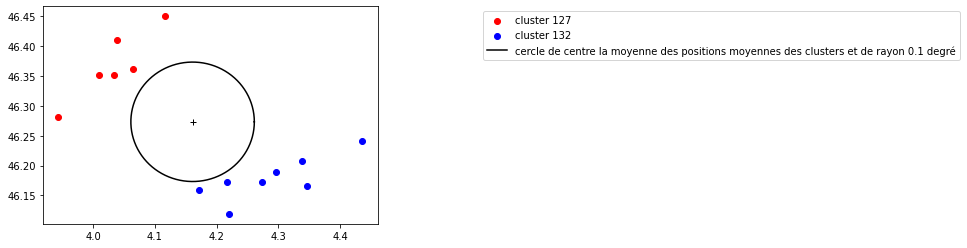

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


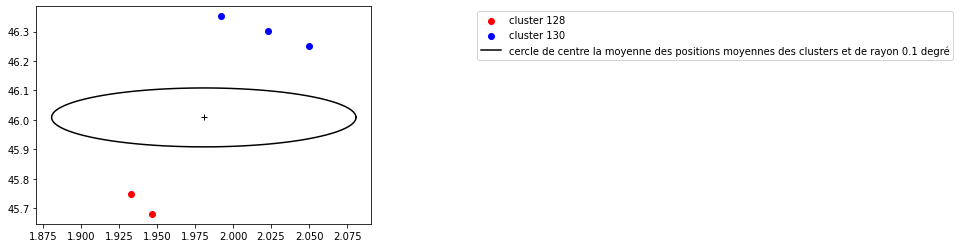

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130


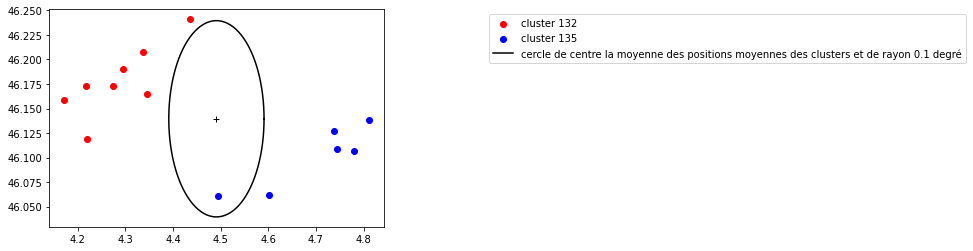

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135


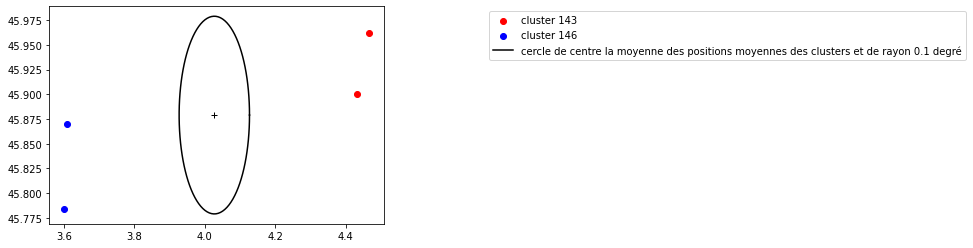

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


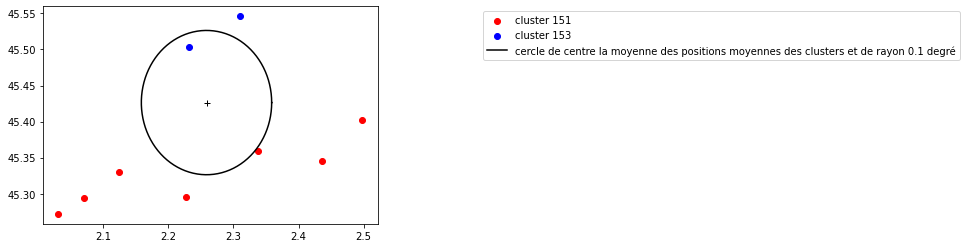

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5559  134928.916667    45.402      2.498     151
5565  134928.716667    45.345      2.436     151
5567       134928.5    45.359      2.338     151
5568      134928.35    45.295      2.228     151
5576      134927.95    45.294      2.071     151
5578  134927.916667    45.272      2.031     151
5579  134927.916667    45.330      2.124     151
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5601       134927.0    45.546      2.310     153
5605  134926.916667    45.503      2.232     153


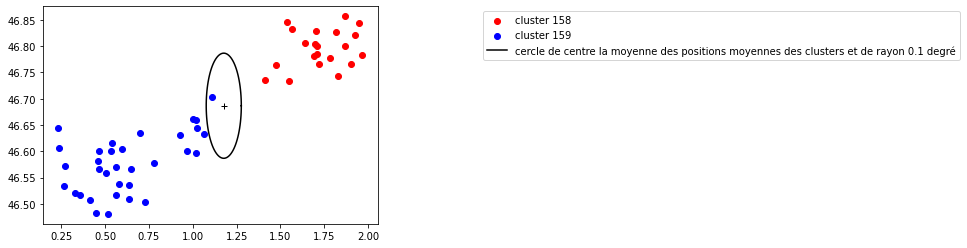

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6484  134667.416667    46.844      1.947     158
6485  134667.333333    46.857      1.865     158
6486  134667.216667    46.783      1.967     158
6487       134667.2    46.743      1.830     158
6488       134667.2    46.822      1.924     158
6489  134667.166667    46.827      1.817     158
6490  134667.166667    46.767      1.900     158
6491      134667.15    46.800      1.867     158
6492  134667.083333    46.778      1.784     158
6493       134667.0    46.804      1.695     158
6494       134667.0    46.828      1.704     158
6495       134667.0    46.786      1.711     158
6496       134667.0    46.801      1.710     158
6497  134666.983333    46.767      1.717     158
6498  134666.966667    46.781      1.693     158
6499      134666.95    46.847      1.538     158
6500      134666.95    46.806      1.639     158
6501      134666.95    46.833      1.567     158
6503  134666.766667    46.733      1.550     158
6505       134666.7 

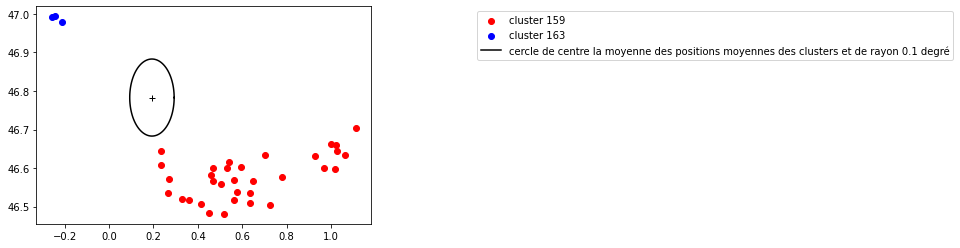

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

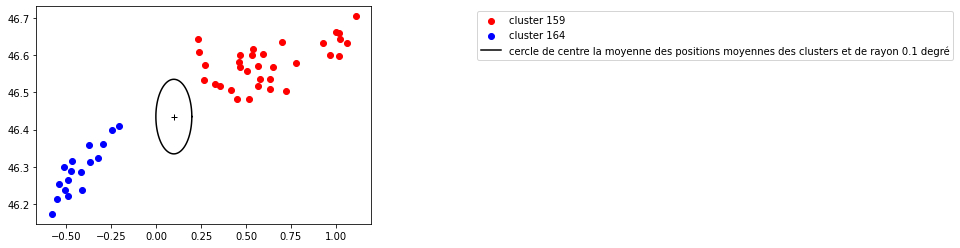

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

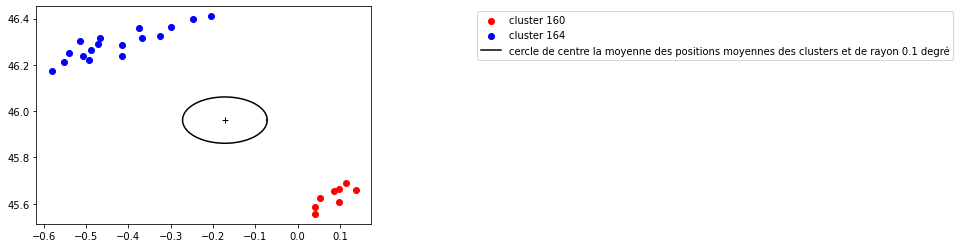

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333 

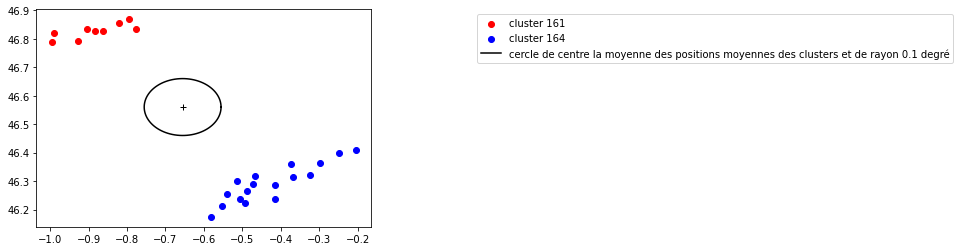

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333 

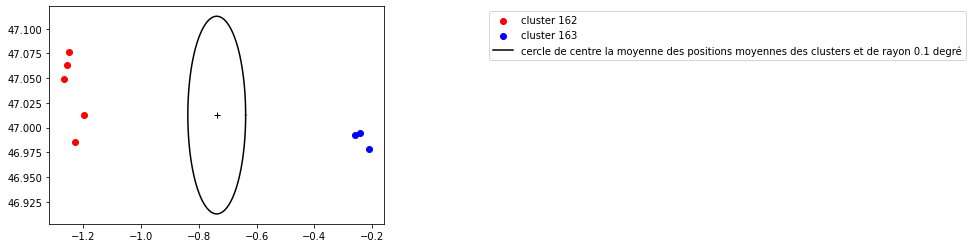

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163


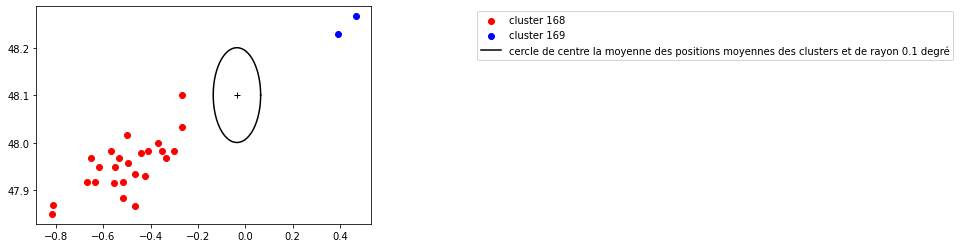

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15    47.978     -0.441     168
6748       134604.1    47.957     -0.493     168
6749  134604.083333    47.916     -0.556     168
6750  134604.083333 

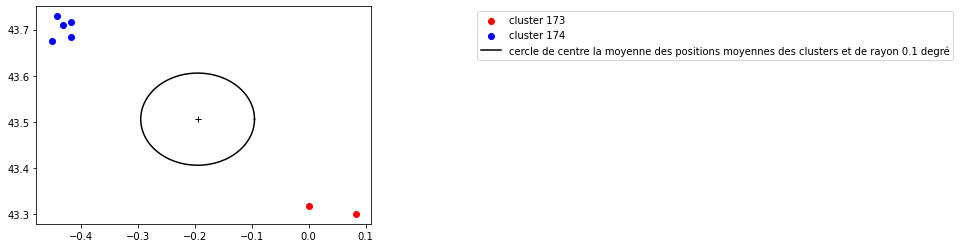

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6952       134496.4    43.300      0.083     173
6953  134496.183333    43.317      0.000     173
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174


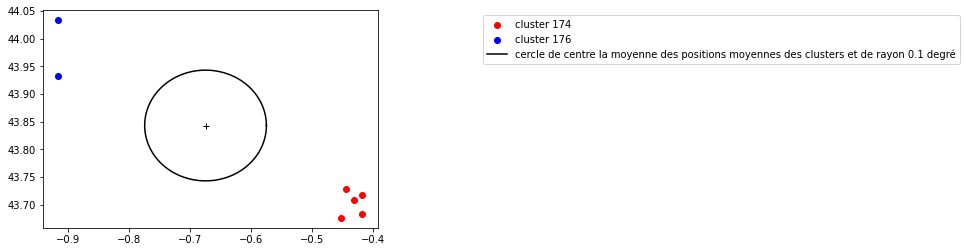

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6972  134493.666667    43.933     -0.917     176
6979       134493.2    44.033     -0.917     176


In [ ]:
pipe_fusion_FR(visu_results,5)

In [ ]:
candidats_fusion = [[29,32],[73,74],[81,84],
                    [81,86],[88,91],[89,92],[96,98],[103,106],
                    [106,110],[106,111],[122,126],[143,146],[158,159],
                    [159,164]]

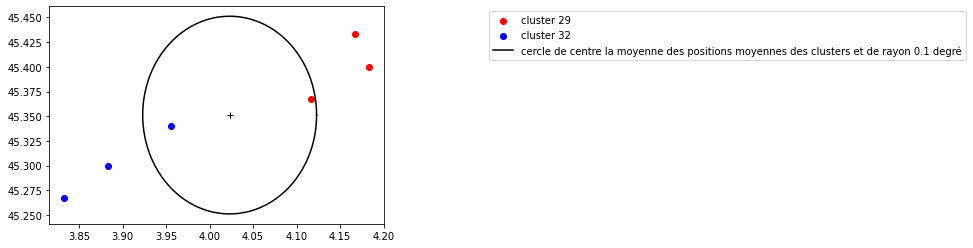

        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
977  136746.333333    45.400      4.183      29
978      136746.25    45.433      4.167      29
982  136745.966667    45.367      4.117      29
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32


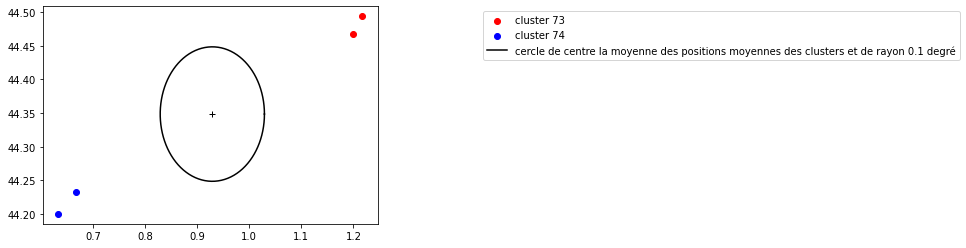

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74


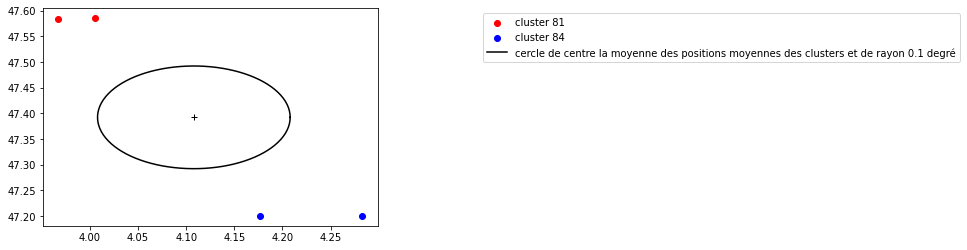

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3700  135386.916667    47.585      4.005      81
3701  135386.833333    47.583      3.967      81
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3737  135385.383333      47.2      4.177      84
3739      135385.15      47.2      4.283      84


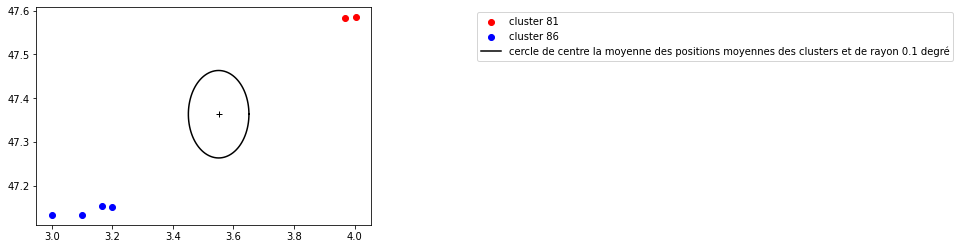

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3700  135386.916667    47.585      4.005      81
3701  135386.833333    47.583      3.967      81
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3787  135383.716667    47.150      3.200      86
3788  135383.683333    47.154      3.167      86
3789  135383.666667    47.133      3.100      86
3803      135383.45    47.133      3.000      86


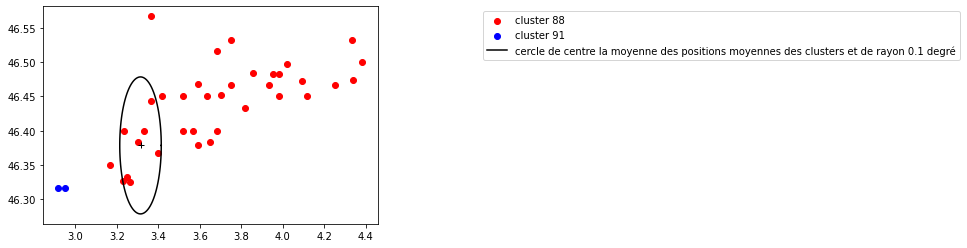

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0    46.533      3.750      88
3877       135381.0    46.452      3.703      88
3884      135380.95    46.567      3.367      88
3886  135380.933333 

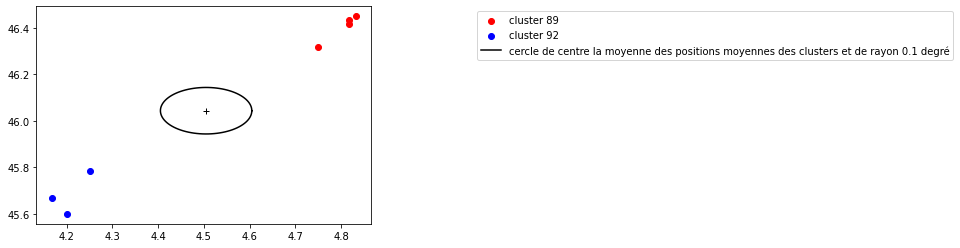

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92


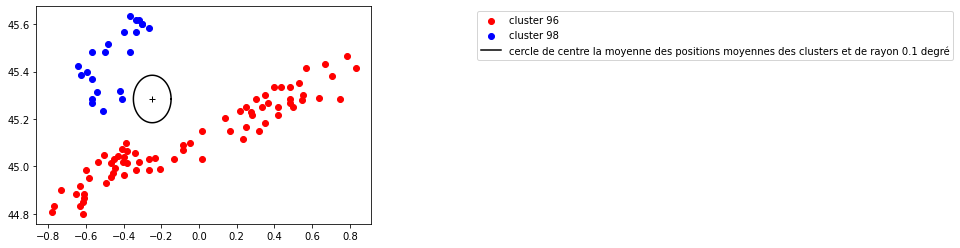

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      

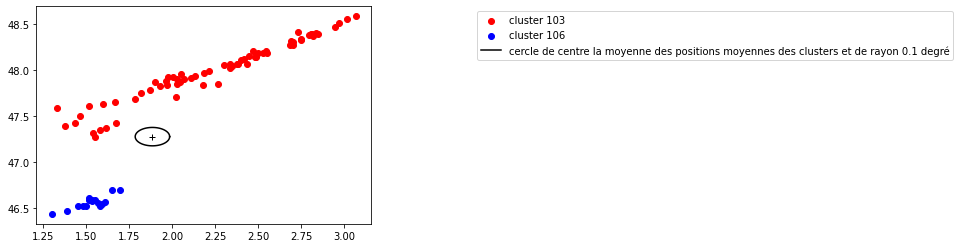

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4261      135338.95    48.583      3.067     103
4262  135338.916667    48.555      3.015     103
4263      135338.85    48.511      2.970     103
4265  135338.666667    48.463      2.945     103
4271      135338.45    48.388      2.846     103
...             ...       ...        ...     ...
4400       135336.5    47.683      1.783     103
4402  135336.333333    47.612      1.518     103
4403  135336.166667    47.500      1.467     103
4404  135336.083333    47.583      1.333     103
4405      135335.95    47.390      1.379     103

[67 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     1

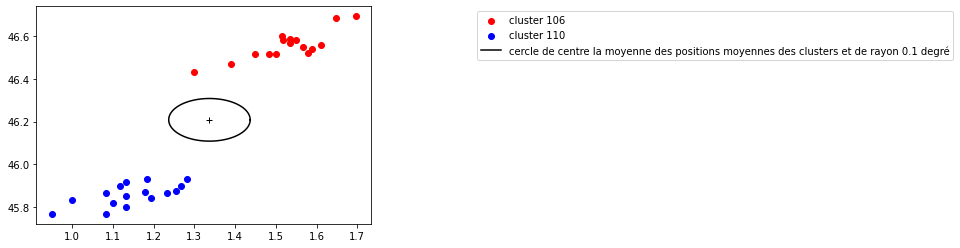

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333 

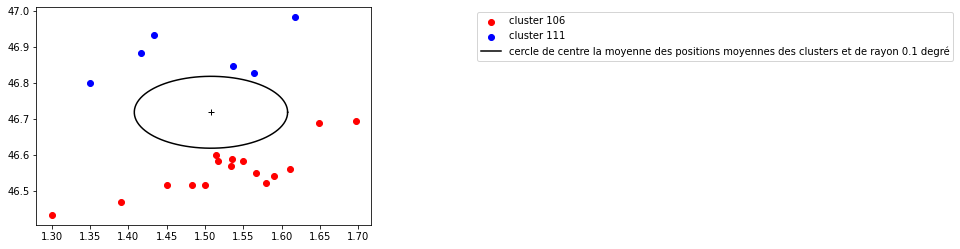

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

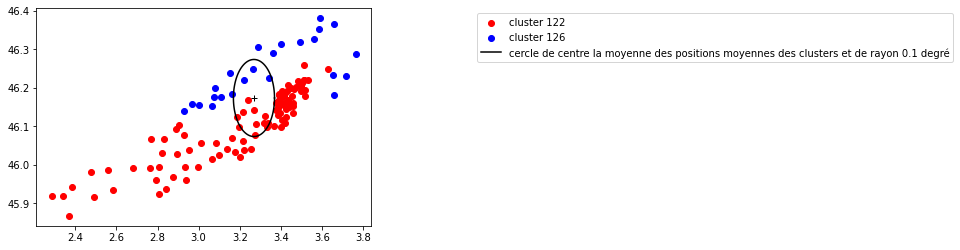

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     1

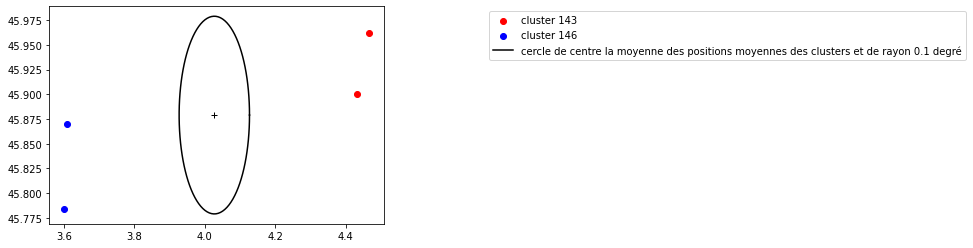

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


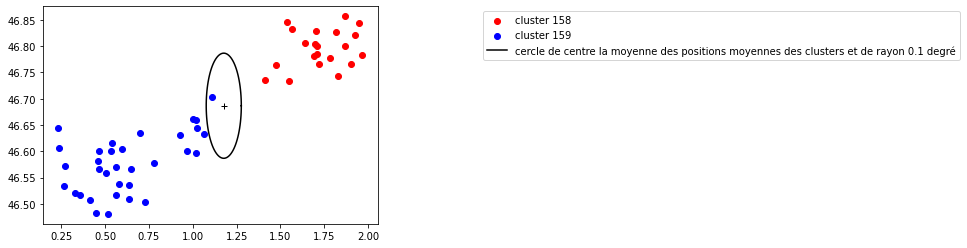

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6484  134667.416667    46.844      1.947     158
6485  134667.333333    46.857      1.865     158
6486  134667.216667    46.783      1.967     158
6487       134667.2    46.743      1.830     158
6488       134667.2    46.822      1.924     158
6489  134667.166667    46.827      1.817     158
6490  134667.166667    46.767      1.900     158
6491      134667.15    46.800      1.867     158
6492  134667.083333    46.778      1.784     158
6493       134667.0    46.804      1.695     158
6494       134667.0    46.828      1.704     158
6495       134667.0    46.786      1.711     158
6496       134667.0    46.801      1.710     158
6497  134666.983333    46.767      1.717     158
6498  134666.966667    46.781      1.693     158
6499      134666.95    46.847      1.538     158
6500      134666.95    46.806      1.639     158
6501      134666.95    46.833      1.567     158
6503  134666.766667    46.733      1.550     158
6505       134666.7 

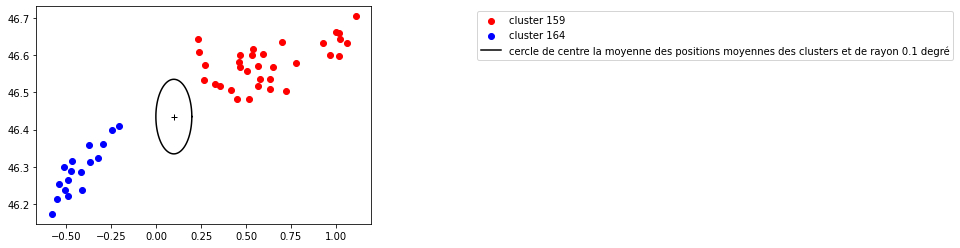

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

In [ ]:
for i in range(len(candidats_fusion)):
  fus_plot(visu_results,candidats_fusion[i][0],candidats_fusion[i][1])
  print(visu_results[visu_results.CLASSI == candidats_fusion[i][0]])
  print(visu_results[visu_results.CLASSI == candidats_fusion[i][1]])

In [ ]:
visu_results_bis = visu_results.copy()

In [ ]:
visu_results_bis[visu_results_bis.CLASSI == 100].loc[4132,:],visu_results_bis[visu_results_bis.CLASSI == 100]

(TIME_EVENT    135360.166667
 LATITUDE             45.317
 LONGITUDE            -0.817
 CLASSI                  100
 Name: 4132, dtype: object,          TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 4132  135360.166667    45.317     -0.817     100
 4133  135360.166667    45.283     -0.783     100
 4134      135360.15    45.261     -0.775     100
 4136  135360.083333    45.300     -0.833     100
 4137  135360.083333    45.283     -0.867     100)

In [ ]:
for i in range(len(candidats_fusion)):
  a,b = candidats_fusion[i][0],candidats_fusion[i][1]
  indices = visu_results_bis[visu_results_bis.CLASSI == b].index
  for e in indices:
    visu_results_bis.loc[e,'CLASSI'] = a

In [ ]:
visu_results[visu_results.CLASSI == 29],visu_results[visu_results.CLASSI == 32]

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
977,136746.333333,45.400,4.183,29
978,136746.25,45.433,4.167,29
982,136745.966667,45.367,4.117,29


In [ ]:
visu_results_bis[visu_results_bis.CLASSI == 29],visu_results_bis[visu_results_bis.CLASSI == 32]

(        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
 977  136746.333333    45.400      4.183      29
 978      136746.25    45.433      4.167      29
 982  136745.966667    45.367      4.117      29
 984  136745.666667    45.340      3.955      29
 988  136745.483333    45.300      3.883      29
 989  136745.416667    45.267      3.833      29, Empty DataFrame
 Columns: [TIME_EVENT, LATITUDE, LONGITUDE, CLASSI]
 Index: [])

In [ ]:
len(np.unique(visu_results_bis.CLASSI, return_counts = True)[1]) #nouveau nombre d'orages dans notre modèle France 2022

171

In [ ]:
np.unique(visu_results.CLASSI, return_counts = True)

In [ ]:
len(visu_results[visu_results.CLASSI == -1])

188

In [ ]:
def condition_densite_poubelle(visu_results,rapport,cluster1,seuil_densite = 70,c = 0.1):

  orage = visu_results[visu_results.CLASSI == cluster1]
  lat_mean = (orage.describe().iloc[1,0] + rapport[1])/2
  long_mean = (orage.describe().iloc[1,1] + rapport[2])/2

  # on définit un carré autour de notre position moyenne 

  lat_mean_up,lat_mean_down = lat_mean+c,lat_mean-c
  long_mean_up,long_mean_down = long_mean+c,long_mean-c

  # on réduit la taille du dataset démog en sélectionnant les carreaux proches de notre position moyenne entre orages

  demog_2 = demog_use[(demog_use.Latitude < lat_mean_up) & (demog_use.Latitude > lat_mean_down) & (demog_use.Longitude < long_mean_up) & (demog_use.Longitude > long_mean_down)]

  densite_moyenne = demog_2['Ind'].mean() #mean de Ind

  return densite_moyenne < seuil_densite

In [ ]:
def fusion_poubelle(visu_results):
  trash = visu_results[visu_results.CLASSI == -1]
  n = len(trash)
  candidats = []
  for i in range(n):
    candi = []
    rapport = trash.iloc[i,:]
    time_event = rapport[0]
    time_low,time_high = time_event-3,time_event+3 #condition de temps validée
    possibles = visu_results[(visu_results.TIME_EVENT > time_low) &  (visu_results.TIME_EVENT < time_high)]
    clusters_ = np.array(np.unique(possibles.CLASSI.values))
    clusters_poss = clusters_[clusters_ > -1]
    for j in clusters_poss:
      if distance_cluster_rapport(visu_results,rapport,j,'moyenne')<1:
        if condition_densite_poubelle(visu_results,rapport,j):
          candi.append(j)
    if candi != []:
      a = [i,candi]
      candidats.append(a)
  return candidats

In [ ]:
# premier élément = indice du rapport dans la liste des rapports dans la poubelle
# deuxième élément = liste des clusters candidats à son accueil

In [ ]:
trash_try = fusion_poubelle(visu_results)

In [ ]:
visu_results[visu_results.CLASSI == -1].iloc[0,:]

TIME_EVENT    138356.966667
LATITUDE             49.502
LONGITUDE             1.586
CLASSI                   -1
Name: 26, dtype: object

In [ ]:
trash_try

[[0, [1]],
 [2, [4, 5]],
 [4, [8]],
 [11, [12]],
 [37, [30]],
 [38, [32]],
 [44, [34]],
 [45, [34]],
 [54, [37]],
 [55, [37]],
 [63, [48, 51]],
 [66, [50]],
 [71, [60]],
 [75, [65]],
 [76, [65]],
 [80, [70]],
 [82, [72]],
 [83, [73, 74]],
 [84, [73, 74]],
 [89, [88, 90]],
 [91, [94, 96, 98]],
 [92, [96, 98, 100, 101]],
 [93, [95]],
 [94, [97]],
 [95, [100, 101]],
 [99, [103, 108]],
 [100, [107, 110]],
 [101, [113]],
 [108, [125]],
 [111, [127]],
 [112, [125, 126, 127]],
 [113, [121]],
 [114, [126, 131, 132]],
 [115, [122, 126, 127, 131, 132, 134]],
 [117, [128, 130]],
 [118, [125, 131]],
 [120, [125, 127, 131]],
 [121, [129]],
 [122, [127, 132, 134]],
 [123, [122, 126, 128, 130]],
 [124, [122, 128, 130]],
 [125, [133]],
 [126, [131, 135]],
 [127, [134]],
 [129, [140]],
 [131, [140]],
 [132, [144]],
 [133, [145]],
 [134, [144]],
 [135, [145]],
 [137, [145, 148]],
 [138, [147]],
 [139, [148, 150]],
 [140, [148]],
 [141, [143, 147, 149]],
 [142, [148]],
 [143, [143, 147, 149]],
 [144, [14

In [ ]:
def plot_cluster_rapport(visu_results,cluster,rapport):
  orage = visu_results[visu_results.CLASSI == cluster]
  ## on trace l'orage et sa trajectoire régressée
  temps = [orage.iloc[i,0] - orage.iloc[-1,0] for i in range(len(orage))]
  plt.scatter(orage.LONGITUDE,orage.LATITUDE,c = temps, label = 'cluster candidat '+str(cluster))
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.scatter(rapport[2],rapport[1],marker ='x', linewidth = 3,color = 'red',label = 'rapport poubelle')
  plt.legend()
  plt.show()

In [ ]:
poubelle = visu_results[visu_results.CLASSI == -1]
poubelle

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
26,138356.966667,49.502,1.586,-1
27,138356.7,48.333,1.933,-1
30,138356.416667,48.500,0.483,-1
46,138354.083333,48.183,-0.892,-1
55,138284.133333,47.231,0.253,-1
...,...,...,...,...
7268,133965.416667,46.817,-1.000,-1
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


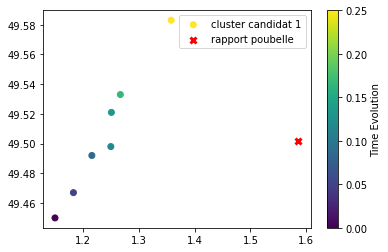

In [ ]:
plot_cluster_rapport(visu_results,1,poubelle.iloc[0,:])

In [ ]:
def plot_cluster_rapport_all(visu_results,trash):
  poubelle = visu_results[visu_results.CLASSI == -1]
  n = len(trash)
  for i in range(n):
    report_index = trash[i][0]
    candi = trash[i][1]
    print("ON TESTE LE RAPPORT D'INDICE",report_index,"DANS LE CLUSTER POUBELLE")
    for j in candi:
      plot_cluster_rapport(visu_results,j,poubelle.iloc[report_index,:])
      print('rapport dans poubelle',poubelle.iloc[report_index,:])
      print(visu_results[visu_results.CLASSI == j])

ON TESTE LE RAPPORT D'INDICE 0 DANS LE CLUSTER POUBELLE


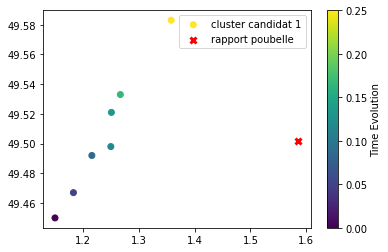

rapport dans poubelle TIME_EVENT    138356.966667
LATITUDE             49.502
LONGITUDE             1.586
CLASSI                   -1
Name: 26, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4   138358.416667    49.583      1.358       1
5   138358.333333    49.533      1.267       1
6        138358.3    49.521      1.251       1
7   138358.283333    49.498      1.250       1
8       138358.25    49.492      1.216       1
9   138358.216667    49.467      1.183       1
10  138358.166667    49.450      1.150       1
ON TESTE LE RAPPORT D'INDICE 2 DANS LE CLUSTER POUBELLE


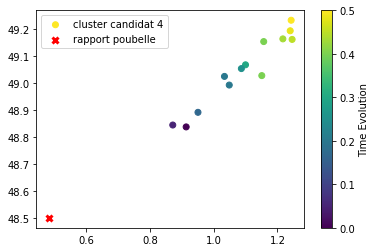

rapport dans poubelle TIME_EVENT    138356.416667
LATITUDE               48.5
LONGITUDE             0.483
CLASSI                   -1
Name: 30, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
28  138356.466667    49.232      1.243       4
29      138356.45    49.193      1.240       4
31  138356.416667    49.161      1.246       4
32       138356.4    49.163      1.217       4
33  138356.366667    49.153      1.157       4
34  138356.366667    49.027      1.151       4
35  138356.266667    49.067      1.100       4
36  138356.216667    49.053      1.087       4
37  138356.166667    49.024      1.034       4
38  138356.166667    48.992      1.049       4
39  138356.133333    48.891      0.951       4
40  138356.016667    48.844      0.872       4
41  138355.966667    48.837      0.914       4


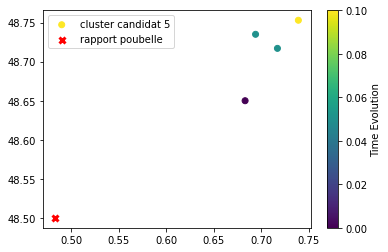

rapport dans poubelle TIME_EVENT    138356.416667
LATITUDE               48.5
LONGITUDE             0.483
CLASSI                   -1
Name: 30, dtype: object
   TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
42  138355.75    48.753      0.739       5
43   138355.7    48.735      0.694       5
44   138355.7    48.717      0.717       5
45  138355.65    48.650      0.683       5
ON TESTE LE RAPPORT D'INDICE 4 DANS LE CLUSTER POUBELLE


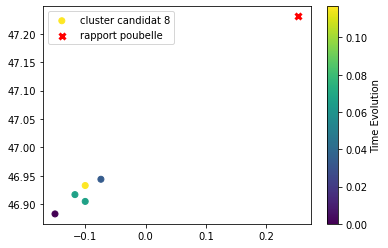

rapport dans poubelle TIME_EVENT    138284.133333
LATITUDE             47.231
LONGITUDE             0.253
CLASSI                   -1
Name: 55, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
56       138283.5    46.933     -0.100       8
57      138283.45    46.905     -0.100       8
58      138283.45    46.917     -0.117       8
59  138283.416667    46.944     -0.074       8
60  138283.383333    46.883     -0.150       8
ON TESTE LE RAPPORT D'INDICE 11 DANS LE CLUSTER POUBELLE


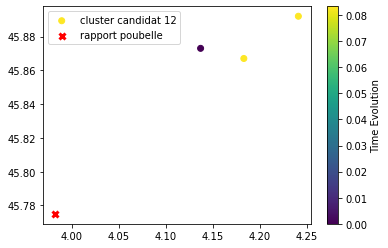

rapport dans poubelle TIME_EVENT    137252.666667
LATITUDE             45.775
LONGITUDE             3.982
CLASSI                   -1
Name: 404, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
401      137252.75    45.867      4.183      12
402      137252.75    45.892      4.241      12
403  137252.666667    45.873      4.137      12
ON TESTE LE RAPPORT D'INDICE 37 DANS LE CLUSTER POUBELLE


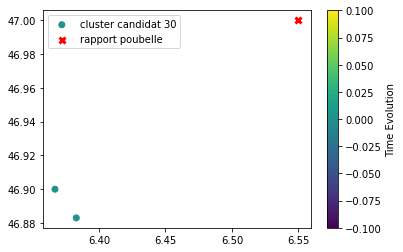

rapport dans poubelle TIME_EVENT    136746.483333
LATITUDE               47.0
LONGITUDE              6.55
CLASSI                   -1
Name: 976, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
980  136746.066667    46.900      6.367      30
981  136746.066667    46.883      6.383      30
ON TESTE LE RAPPORT D'INDICE 38 DANS LE CLUSTER POUBELLE


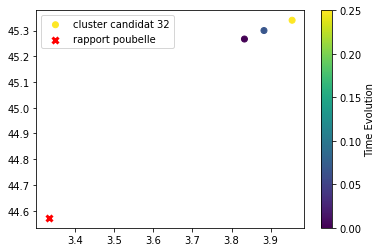

rapport dans poubelle TIME_EVENT    136745.416667
LATITUDE             44.572
LONGITUDE             3.332
CLASSI                   -1
Name: 990, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32
ON TESTE LE RAPPORT D'INDICE 44 DANS LE CLUSTER POUBELLE


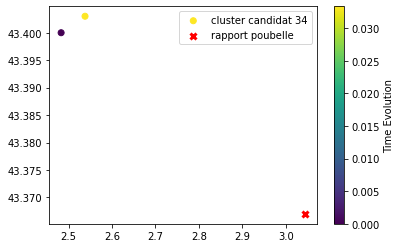

rapport dans poubelle TIME_EVENT    136727.916667
LATITUDE             43.367
LONGITUDE             3.043
CLASSI                   -1
Name: 1004, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34
ON TESTE LE RAPPORT D'INDICE 45 DANS LE CLUSTER POUBELLE


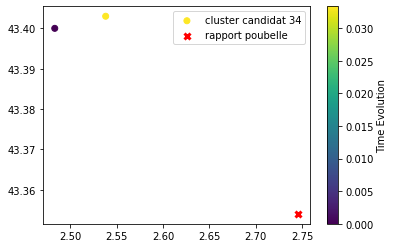

rapport dans poubelle TIME_EVENT    136726.75
LATITUDE         43.354
LONGITUDE         2.746
CLASSI               -1
Name: 1005, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34
ON TESTE LE RAPPORT D'INDICE 54 DANS LE CLUSTER POUBELLE


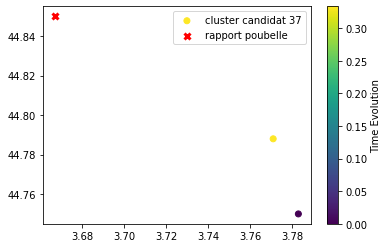

rapport dans poubelle TIME_EVENT    136459.416667
LATITUDE              44.85
LONGITUDE             3.667
CLASSI                   -1
Name: 1224, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1226      136458.25    44.788      3.771      37
1227  136457.916667    44.750      3.783      37
ON TESTE LE RAPPORT D'INDICE 55 DANS LE CLUSTER POUBELLE


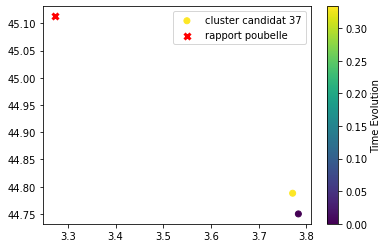

rapport dans poubelle TIME_EVENT    136459.333333
LATITUDE             45.113
LONGITUDE             3.273
CLASSI                   -1
Name: 1225, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1226      136458.25    44.788      3.771      37
1227  136457.916667    44.750      3.783      37
ON TESTE LE RAPPORT D'INDICE 63 DANS LE CLUSTER POUBELLE


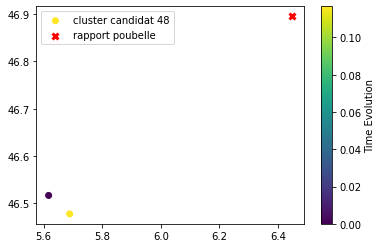

rapport dans poubelle TIME_EVENT    135596.166667
LATITUDE             46.895
LONGITUDE             6.449
CLASSI                   -1
Name: 2725, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2713      135596.45    46.478      5.689      48
2717  135596.333333    46.517      5.617      48


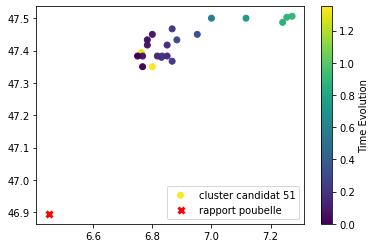

rapport dans poubelle TIME_EVENT    135596.166667
LATITUDE             46.895
LONGITUDE             6.449
CLASSI                   -1
Name: 2725, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2759  135595.783333    47.350      6.800      51
2762      135595.75    47.394      6.763      51
2780  135595.333333    47.506      7.273      51
2781  135595.316667    47.503      7.255      51
2782       135595.3    47.487      7.241      51
2785  135595.166667    47.500      7.117      51
2787       135595.0    47.500      7.000      51
2795  135594.766667    47.450      6.952      51
2797      135594.75    47.433      6.883      51
2798  135594.666667    47.367      6.867      51
2799  135594.666667    47.383      6.833      51
2800  135594.666667    47.467      6.867      51
2801      135594.65    47.379      6.831      51
2802  135594.616667    47.383      6.850      51
2803  135594.616667    47.417      6.850      51
2804  135594.583333    47.383      6.817      51
2808  1

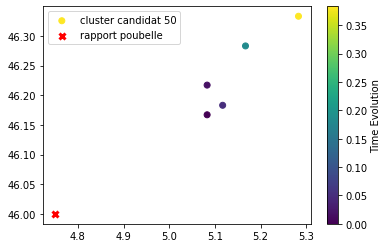

rapport dans poubelle TIME_EVENT    135595.0
LATITUDE          46.0
LONGITUDE         4.75
CLASSI              -1
Name: 2788, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2755  135595.883333    46.333      5.283      50
2766  135595.683333    46.283      5.167      50
2775      135595.55    46.183      5.117      50
2776  135595.516667    46.217      5.083      50
2777       135595.5    46.167      5.083      50
ON TESTE LE RAPPORT D'INDICE 71 DANS LE CLUSTER POUBELLE


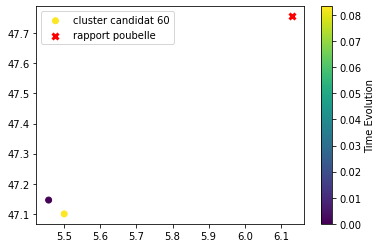

rapport dans poubelle TIME_EVENT    135504.466667
LATITUDE             47.756
LONGITUDE             6.131
CLASSI                   -1
Name: 3447, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3319      135506.25    47.100      5.500      60
3329  135506.166667    47.146      5.457      60
ON TESTE LE RAPPORT D'INDICE 75 DANS LE CLUSTER POUBELLE


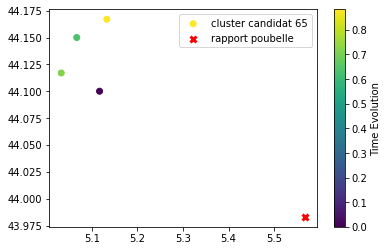

rapport dans poubelle TIME_EVENT    135448.15
LATITUDE         43.983
LONGITUDE         5.567
CLASSI               -1
Name: 3519, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3520  135447.666667    44.167      5.133      65
3521       135447.5    44.117      5.033      65
3522  135447.416667    44.150      5.067      65
3535  135446.783333    44.100      5.117      65
ON TESTE LE RAPPORT D'INDICE 76 DANS LE CLUSTER POUBELLE


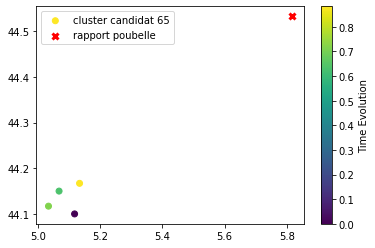

rapport dans poubelle TIME_EVENT    135447.0
LATITUDE        44.533
LONGITUDE        5.817
CLASSI              -1
Name: 3533, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3520  135447.666667    44.167      5.133      65
3521       135447.5    44.117      5.033      65
3522  135447.416667    44.150      5.067      65
3535  135446.783333    44.100      5.117      65
ON TESTE LE RAPPORT D'INDICE 80 DANS LE CLUSTER POUBELLE


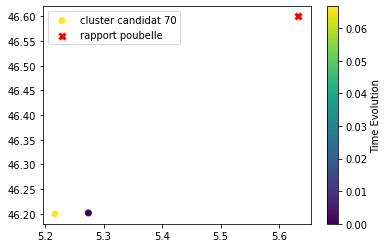

rapport dans poubelle TIME_EVENT    135428.383333
LATITUDE               46.6
LONGITUDE             5.633
CLASSI                   -1
Name: 3597, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3605       135427.3    46.200      5.217      70
3608  135427.233333    46.202      5.274      70
ON TESTE LE RAPPORT D'INDICE 82 DANS LE CLUSTER POUBELLE


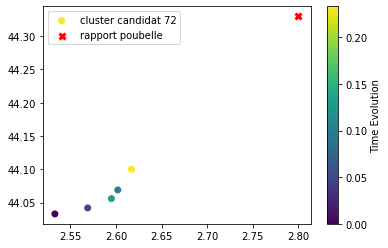

rapport dans poubelle TIME_EVENT    135426.166667
LATITUDE              44.33
LONGITUDE               2.8
CLASSI                   -1
Name: 3618, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3619       135426.0    44.100      2.617      72
3620       135425.9    44.056      2.595      72
3621  135425.866667    44.069      2.602      72
3622  135425.816667    44.042      2.569      72
3623  135425.766667    44.033      2.533      72
ON TESTE LE RAPPORT D'INDICE 83 DANS LE CLUSTER POUBELLE


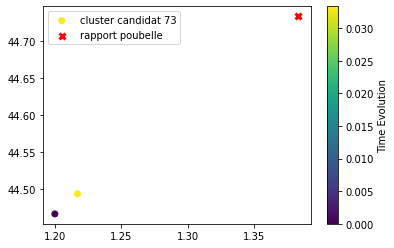

rapport dans poubelle TIME_EVENT    135424.35
LATITUDE         44.733
LONGITUDE         1.383
CLASSI               -1
Name: 3627, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73


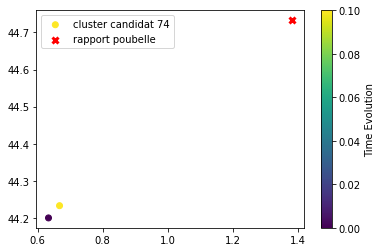

rapport dans poubelle TIME_EVENT    135424.35
LATITUDE         44.733
LONGITUDE         1.383
CLASSI               -1
Name: 3627, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74
ON TESTE LE RAPPORT D'INDICE 84 DANS LE CLUSTER POUBELLE


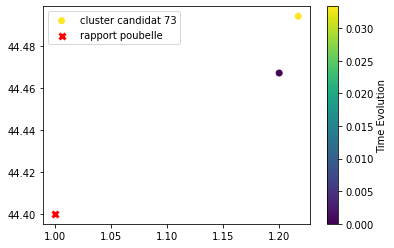

rapport dans poubelle TIME_EVENT    135423.266667
LATITUDE               44.4
LONGITUDE               1.0
CLASSI                   -1
Name: 3630, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73


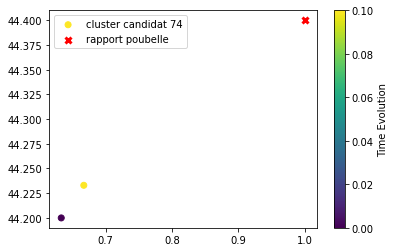

rapport dans poubelle TIME_EVENT    135423.266667
LATITUDE               44.4
LONGITUDE               1.0
CLASSI                   -1
Name: 3630, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74
ON TESTE LE RAPPORT D'INDICE 89 DANS LE CLUSTER POUBELLE


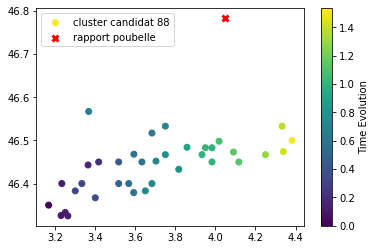

rapport dans poubelle TIME_EVENT    135381.366667
LATITUDE             46.783
LONGITUDE              4.05
CLASSI                   -1
Name: 3849, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876   

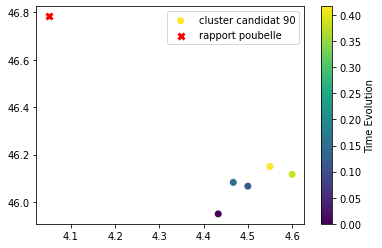

rapport dans poubelle TIME_EVENT    135381.366667
LATITUDE             46.783
LONGITUDE              4.05
CLASSI                   -1
Name: 3849, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3908      135380.45    46.150      4.550      90
3912  135380.416667    46.117      4.600      90
3915  135380.183333    46.083      4.467      90
3917      135380.15    46.067      4.500      90
3919  135380.033333    45.950      4.433      90
ON TESTE LE RAPPORT D'INDICE 91 DANS LE CLUSTER POUBELLE


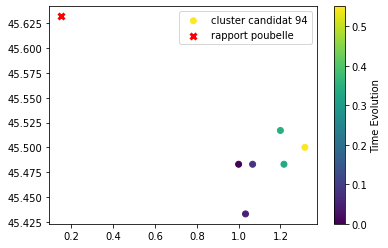

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      94
3958  135363.433333    45.517      1.200      94
3959  135363.416667    45.483      1.217      94
3968  135363.166667    45.483      1.067      94
3969  135363.133333    45.433      1.033      94
3970  135363.083333    45.483      1.000      94


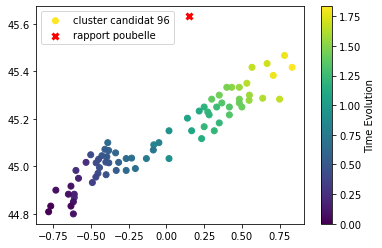

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


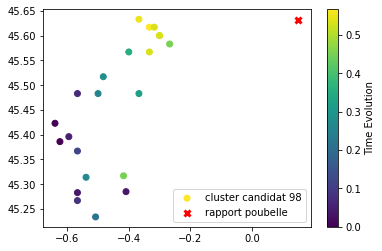

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

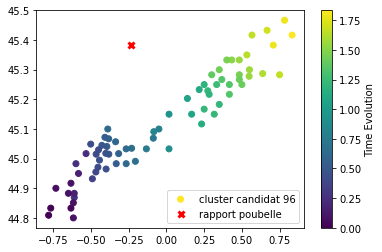

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


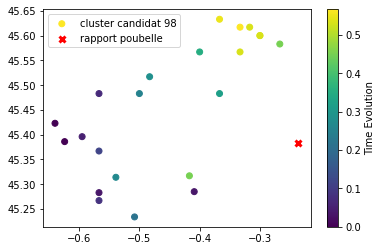

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

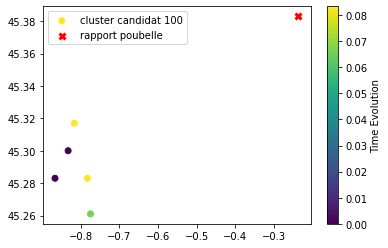

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4132  135360.166667    45.317     -0.817     100
4133  135360.166667    45.283     -0.783     100
4134      135360.15    45.261     -0.775     100
4136  135360.083333    45.300     -0.833     100
4137  135360.083333    45.283     -0.867     100


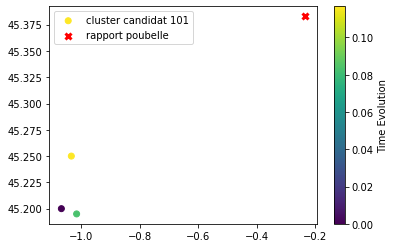

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4138  135360.033333    45.250     -1.033     101
4139       135360.0    45.195     -1.015     101
4143  135359.916667    45.200     -1.067     101
ON TESTE LE RAPPORT D'INDICE 93 DANS LE CLUSTER POUBELLE


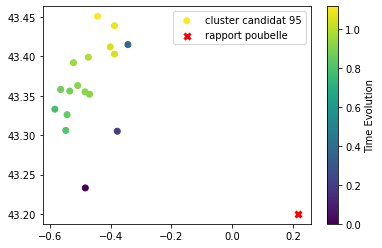

rapport dans poubelle TIME_EVENT    135360.983333
LATITUDE               43.2
LONGITUDE             0.217
CLASSI                   -1
Name: 4090, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3952  135363.616667    43.451     -0.443      95
3953  135363.583333    43.439     -0.387      95
3954      135363.55    43.403     -0.387      95
3955      135363.55    43.412     -0.401      95
3956  135363.483333    43.399     -0.473      95
3957      135363.45    43.392     -0.522      95
3960  135363.416667    43.355     -0.484      95
3961  135363.416667    43.363     -0.508      95
3962  135363.416667    43.352     -0.469      95
3963  135363.383333    43.356     -0.534      95
3964  135363.366667    43.358     -0.564      95
3965      135363.35    43.326     -0.543      95
3966  135363.316667    43.306     -0.547      95
3967  135363.283333    43.333     -0.583      95
3971  135362.866667    43.415     -0.343      95
3975       135362.7    43.305     -0.378      95
3985   

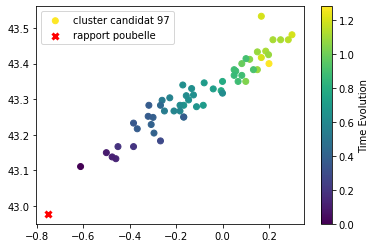

rapport dans poubelle TIME_EVENT    135360.833333
LATITUDE             42.978
LONGITUDE            -0.749
CLASSI                   -1
Name: 4107, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4009  135361.833333    43.400      0.200      97
4012      135361.75    43.533      0.167      97
4013      135361.75    43.417      0.167      97
4015      135361.75    43.481      0.299      97
4017       135361.7    43.467      0.283      97
4018  135361.666667    43.435      0.186      97
4019  135361.666667    43.467      0.250      97
4020  135361.666667    43.467      0.217      97
4023  135361.633333    43.383      0.150      97
4024  135361.633333    43.433      0.150      97
4026  135361.633333    43.425      0.198      97
4029       135361.6    43.412      0.117      97
4031  135361.583333    43.350      0.100      97
4034  135361.533333    43.400      0.083      97
4040  135361.466667    43.383      0.133      97
4042      135361.45    43.414      0.101      97
4045  1

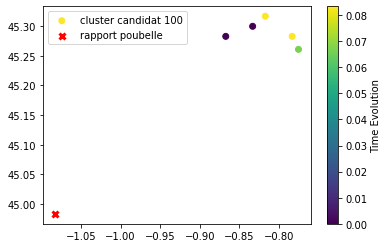

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4132  135360.166667    45.317     -0.817     100
4133  135360.166667    45.283     -0.783     100
4134      135360.15    45.261     -0.775     100
4136  135360.083333    45.300     -0.833     100
4137  135360.083333    45.283     -0.867     100


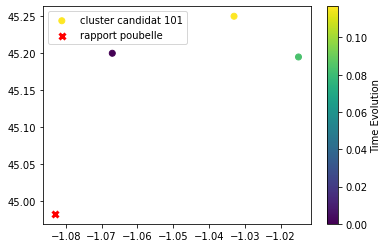

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4138  135360.033333    45.250     -1.033     101
4139       135360.0    45.195     -1.015     101
4143  135359.916667    45.200     -1.067     101
ON TESTE LE RAPPORT D'INDICE 99 DANS LE CLUSTER POUBELLE


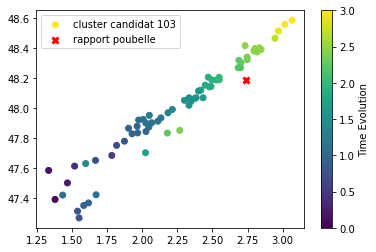

rapport dans poubelle TIME_EVENT    135339.383333
LATITUDE             48.186
LONGITUDE              2.74
CLASSI                   -1
Name: 4260, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4261      135338.95    48.583      3.067     103
4262  135338.916667    48.555      3.015     103
4263      135338.85    48.511      2.970     103
4265  135338.666667    48.463      2.945     103
4271      135338.45    48.388      2.846     103
...             ...       ...        ...     ...
4400       135336.5    47.683      1.783     103
4402  135336.333333    47.612      1.518     103
4403  135336.166667    47.500      1.467     103
4404  135336.083333    47.583      1.333     103
4405      135335.95    47.390      1.379     103

[67 rows x 4 columns]


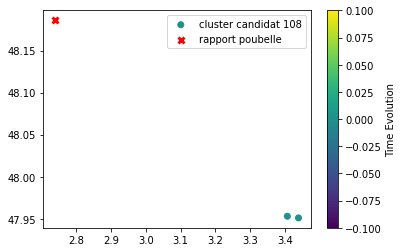

rapport dans poubelle TIME_EVENT    135339.383333
LATITUDE             48.186
LONGITUDE              2.74
CLASSI                   -1
Name: 4260, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4303  135337.916667    47.951      3.438     108
4304  135337.916667    47.953      3.406     108
ON TESTE LE RAPPORT D'INDICE 100 DANS LE CLUSTER POUBELLE


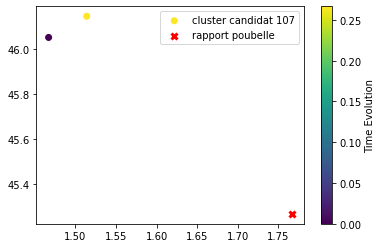

rapport dans poubelle TIME_EVENT    135337.75
LATITUDE         45.267
LONGITUDE         1.767
CLASSI               -1
Name: 4314, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4297      135337.95    46.144      1.514     107
4317  135337.683333    46.050      1.467     107


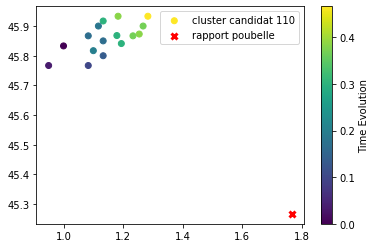

rapport dans poubelle TIME_EVENT    135337.75
LATITUDE         45.267
LONGITUDE         1.767
CLASSI               -1
Name: 4314, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
ON TESTE LE RAPPORT D'I

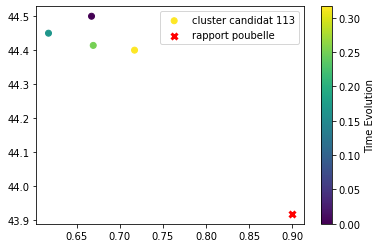

rapport dans poubelle TIME_EVENT    135337.433333
LATITUDE             43.917
LONGITUDE               0.9
CLASSI                   -1
Name: 4342, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4380  135336.983333    44.400      0.717     113
4382  135336.916667    44.414      0.669     113
4391  135336.833333    44.450      0.617     113
4396  135336.666667    44.500      0.667     113
ON TESTE LE RAPPORT D'INDICE 108 DANS LE CLUSTER POUBELLE


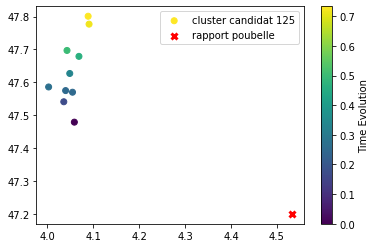

rapport dans poubelle TIME_EVENT    134980.666667
LATITUDE               47.2
LONGITUDE             4.533
CLASSI                   -1
Name: 5113, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125
ON TESTE LE RAPPORT D'INDICE 111 DANS LE CLUSTER POUBELLE


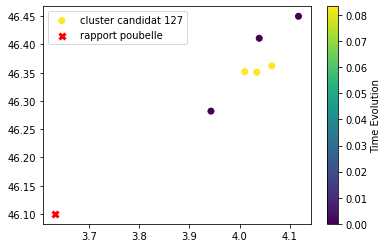

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
ON TESTE LE RAPPORT D'INDICE 112 DANS LE CLUSTER POUBELLE


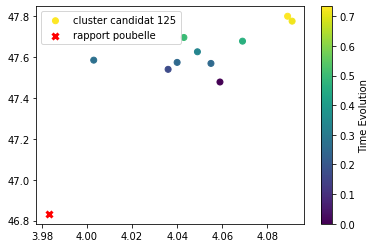

rapport dans poubelle TIME_EVENT    134979.666667
LATITUDE             46.833
LONGITUDE             3.983
CLASSI                   -1
Name: 5119, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


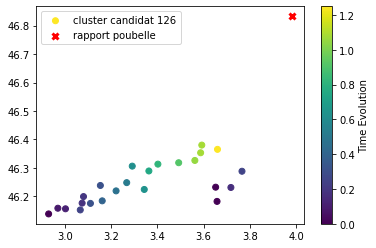

rapport dans poubelle TIME_EVENT    134979.666667
LATITUDE             46.833
LONGITUDE             3.983
CLASSI                   -1
Name: 5119, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

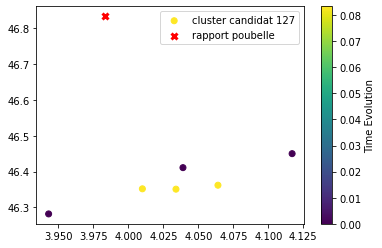

rapport dans poubelle TIME_EVENT    134979.666667
LATITUDE             46.833
LONGITUDE             3.983
CLASSI                   -1
Name: 5119, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
ON TESTE LE RAPPORT D'INDICE 113 DANS LE CLUSTER POUBELLE


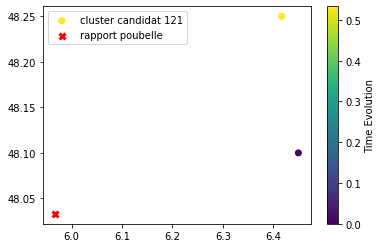

rapport dans poubelle TIME_EVENT    134979.3
LATITUDE        48.033
LONGITUDE        5.967
CLASSI              -1
Name: 5120, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5112       134980.7     48.25      6.417     121
5117  134980.166667     48.10      6.450     121
ON TESTE LE RAPPORT D'INDICE 114 DANS LE CLUSTER POUBELLE


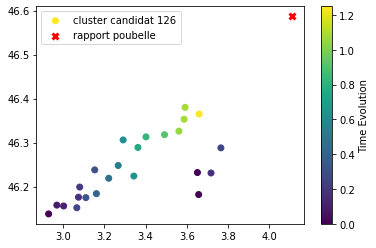

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

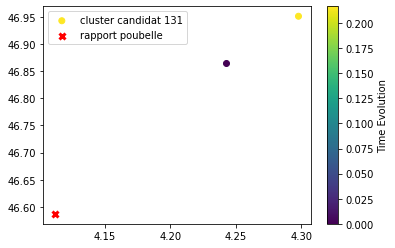

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


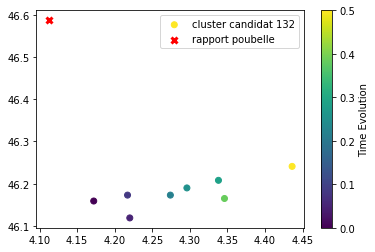

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
ON TESTE LE RAPPORT D'INDICE 115 DANS LE CLUSTER POUBELLE


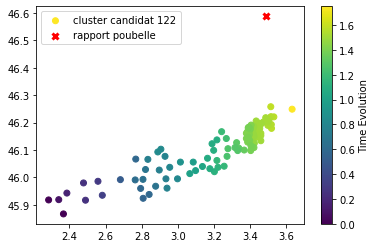

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


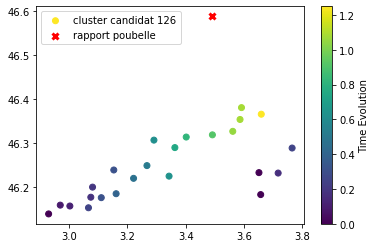

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

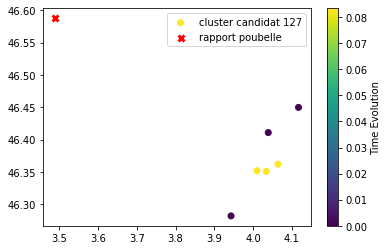

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


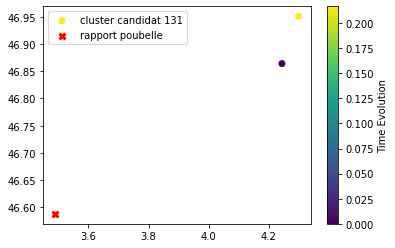

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


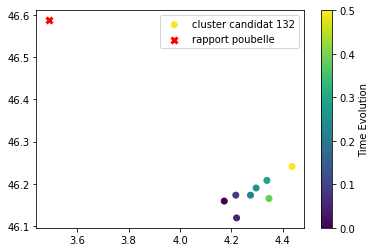

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


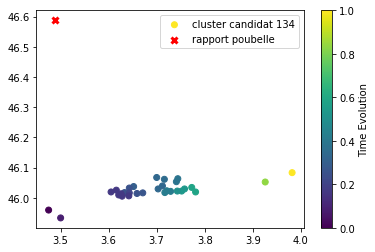

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  1

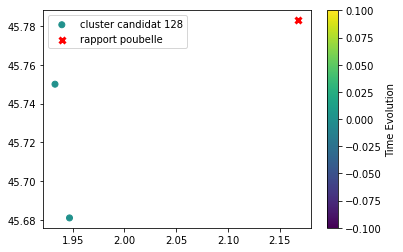

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


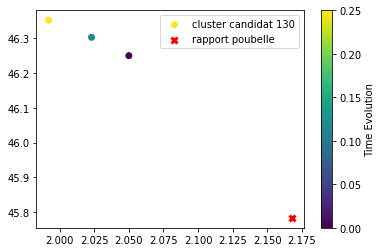

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 118 DANS LE CLUSTER POUBELLE


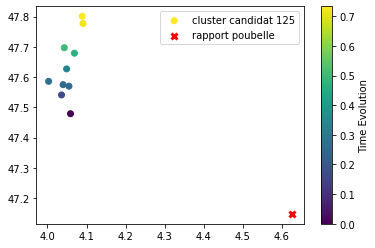

rapport dans poubelle TIME_EVENT    134976.666667
LATITUDE             47.148
LONGITUDE             4.626
CLASSI                   -1
Name: 5266, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


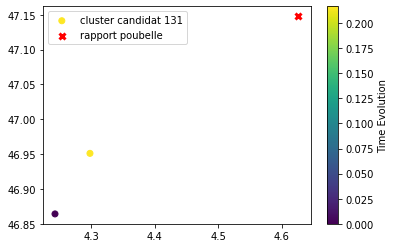

rapport dans poubelle TIME_EVENT    134976.666667
LATITUDE             47.148
LONGITUDE             4.626
CLASSI                   -1
Name: 5266, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 120 DANS LE CLUSTER POUBELLE


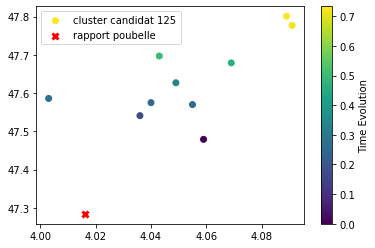

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


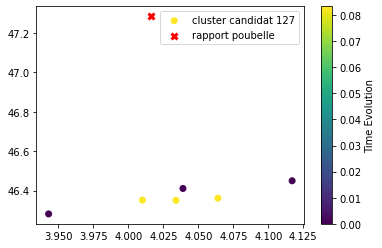

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


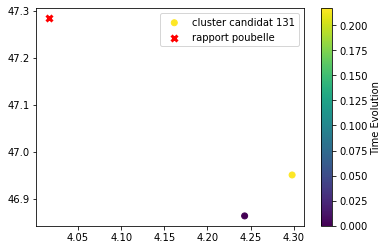

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 121 DANS LE CLUSTER POUBELLE


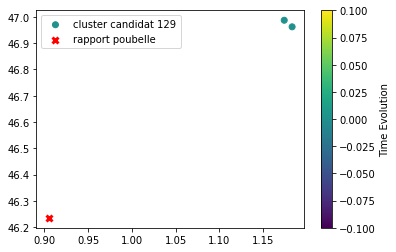

rapport dans poubelle TIME_EVENT    134976.35
LATITUDE         46.235
LONGITUDE         0.905
CLASSI               -1
Name: 5280, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5287  134976.166667    46.962      1.183     129
5288  134976.166667    46.987      1.174     129
ON TESTE LE RAPPORT D'INDICE 122 DANS LE CLUSTER POUBELLE


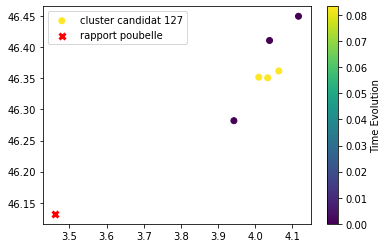

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


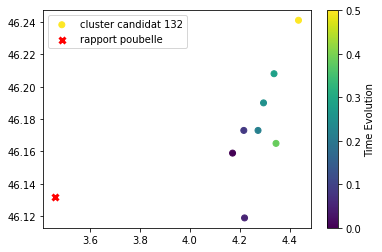

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


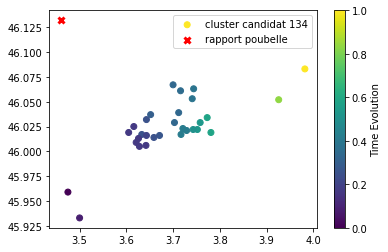

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  1

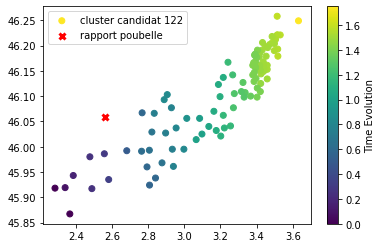

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


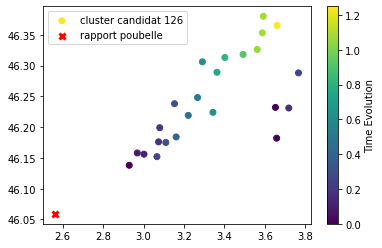

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.1

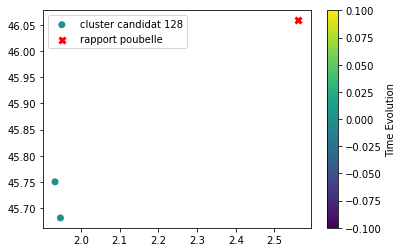

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


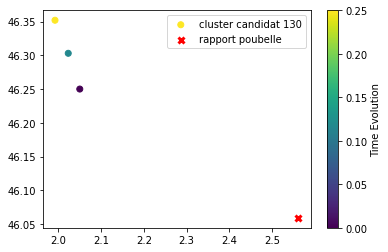

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 124 DANS LE CLUSTER POUBELLE


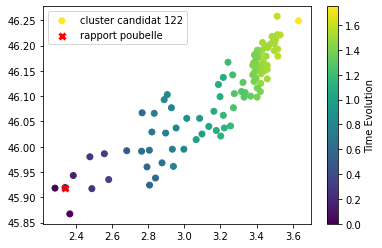

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


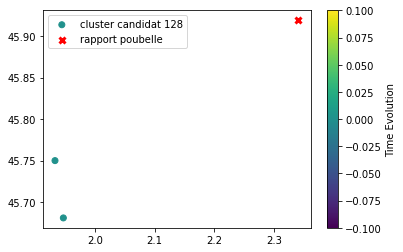

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


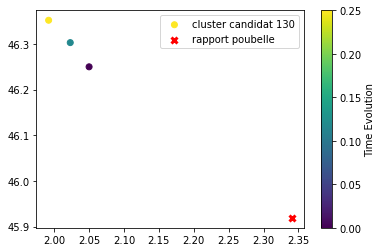

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 125 DANS LE CLUSTER POUBELLE


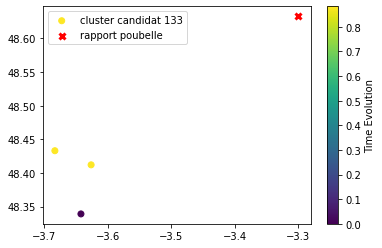

rapport dans poubelle TIME_EVENT    134974.666667
LATITUDE             48.633
LONGITUDE              -3.3
CLASSI                   -1
Name: 5338, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5320  134975.416667    48.433     -3.683     133
5321  134975.416667    48.412     -3.626     133
5345  134974.533333    48.339     -3.642     133
ON TESTE LE RAPPORT D'INDICE 126 DANS LE CLUSTER POUBELLE


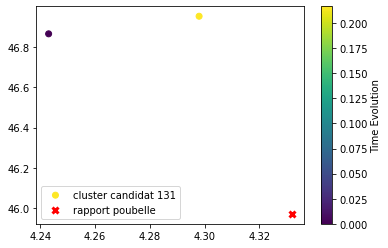

rapport dans poubelle TIME_EVENT    134973.633333
LATITUDE             45.973
LONGITUDE             4.332
CLASSI                   -1
Name: 5393, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


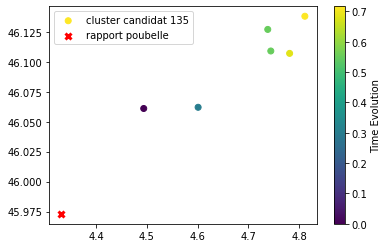

rapport dans poubelle TIME_EVENT    134973.633333
LATITUDE             45.973
LONGITUDE             4.332
CLASSI                   -1
Name: 5393, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135
ON TESTE LE RAPPORT D'INDICE 127 DANS LE CLUSTER POUBELLE


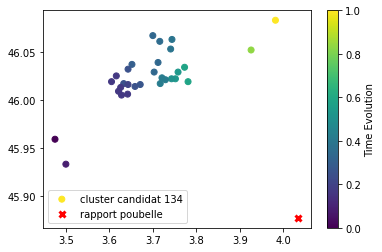

rapport dans poubelle TIME_EVENT    134973.133333
LATITUDE             45.877
LONGITUDE             4.035
CLASSI                   -1
Name: 5396, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  1

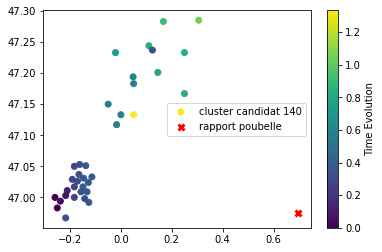

rapport dans poubelle TIME_EVENT    134972.083333
LATITUDE             46.975
LONGITUDE             0.698
CLASSI                   -1
Name: 5407, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5413  134970.916667    47.133      0.050     140
5415  134970.633333    47.285      0.306     140
5416       134970.5    47.283      0.167     140
5417  134970.416667    47.167      0.250     140
5418  134970.416667    47.233      0.250     140
5419  134970.416667    47.244      0.110     140
5420  134970.366667    47.201      0.145     140
5421  134970.316667    47.233     -0.021     140
5422  134970.183333    47.133      0.000     140
5423  134970.166667    47.183      0.050     140
5424  134970.166667    47.194      0.048     140
5425      134970.15    47.150     -0.050     140
5426      134970.15    47.117     -0.017     140
5427  134969.966667    47.024     -0.128     140
5428  134969.966667    47.033     -0.114     140
5429      134969.95    47.017     -0.149     140
5430   

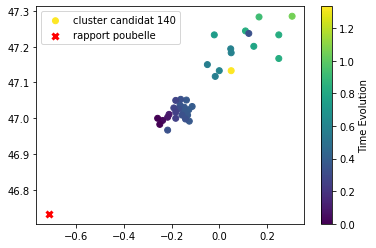

rapport dans poubelle TIME_EVENT    134968.75
LATITUDE         46.733
LONGITUDE        -0.717
CLASSI               -1
Name: 5451, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5413  134970.916667    47.133      0.050     140
5415  134970.633333    47.285      0.306     140
5416       134970.5    47.283      0.167     140
5417  134970.416667    47.167      0.250     140
5418  134970.416667    47.233      0.250     140
5419  134970.416667    47.244      0.110     140
5420  134970.366667    47.201      0.145     140
5421  134970.316667    47.233     -0.021     140
5422  134970.183333    47.133      0.000     140
5423  134970.166667    47.183      0.050     140
5424  134970.166667    47.194      0.048     140
5425      134970.15    47.150     -0.050     140
5426      134970.15    47.117     -0.017     140
5427  134969.966667    47.024     -0.128     140
5428  134969.966667    47.033     -0.114     140
5429      134969.95    47.017     -0.149     140
5430      134969.95    

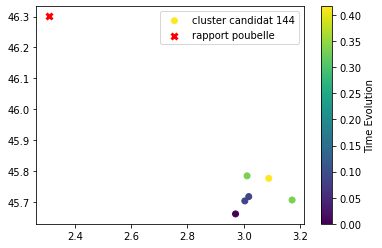

rapport dans poubelle TIME_EVENT    134955.25
LATITUDE         46.301
LONGITUDE         2.307
CLASSI               -1
Name: 5457, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
ON TESTE LE RAPPORT D'INDICE 133 DANS LE CLUSTER POUBELLE


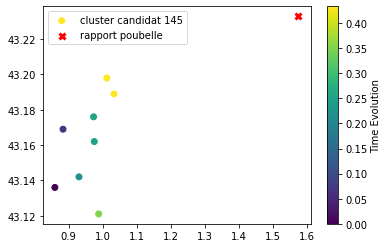

rapport dans poubelle TIME_EVENT    134953.833333
LATITUDE             43.233
LONGITUDE             1.576
CLASSI                   -1
Name: 5460, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145
ON TESTE LE RAPPORT D'INDICE 134 DANS LE CLUSTER POUBELLE


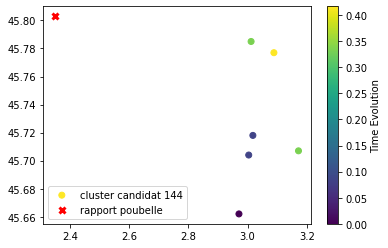

rapport dans poubelle TIME_EVENT    134953.416667
LATITUDE             45.803
LONGITUDE              2.35
CLASSI                   -1
Name: 5463, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
ON TESTE LE RAPPORT D'INDICE 135 DANS LE CLUSTER POUBELLE


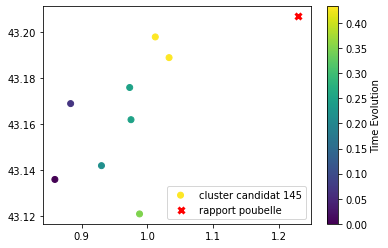

rapport dans poubelle TIME_EVENT    134953.216667
LATITUDE             43.207
LONGITUDE              1.23
CLASSI                   -1
Name: 5465, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145
ON TESTE LE RAPPORT D'INDICE 137 DANS LE CLUSTER POUBELLE


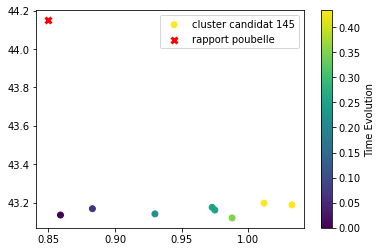

rapport dans poubelle TIME_EVENT    134952.983333
LATITUDE              44.15
LONGITUDE              0.85
CLASSI                   -1
Name: 5469, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145


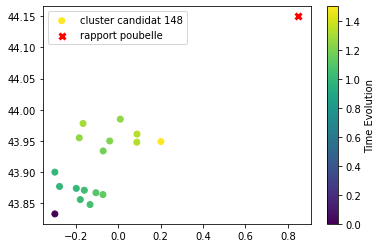

rapport dans poubelle TIME_EVENT    134952.983333
LATITUDE              44.15
LONGITUDE              0.85
CLASSI                   -1
Name: 5469, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  1

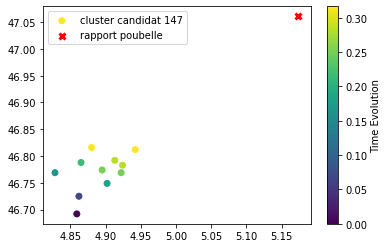

rapport dans poubelle TIME_EVENT    134952.9
LATITUDE        47.061
LONGITUDE        5.174
CLASSI              -1
Name: 5472, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5486  134952.233333    46.816      4.880     147
5487  134952.233333    46.812      4.942     147
5488       134952.2    46.792      4.913     147
5489       134952.2    46.783      4.924     147
5490  134952.166667    46.774      4.895     147
5491  134952.166667    46.769      4.922     147
5493  134952.133333    46.788      4.865     147
5494       134952.1    46.749      4.902     147
5495  134952.083333    46.769      4.828     147
5496  134951.983333    46.725      4.862     147
5497  134951.916667    46.692      4.859     147
ON TESTE LE RAPPORT D'INDICE 139 DANS LE CLUSTER POUBELLE


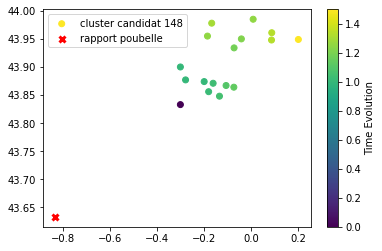

rapport dans poubelle TIME_EVENT    134952.666667
LATITUDE             43.633
LONGITUDE            -0.833
CLASSI                   -1
Name: 5480, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  1

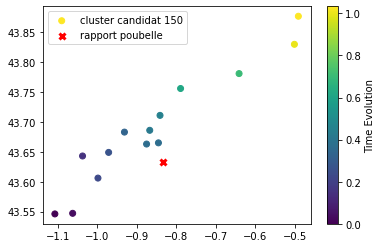

rapport dans poubelle TIME_EVENT    134952.666667
LATITUDE             43.633
LONGITUDE            -0.833
CLASSI                   -1
Name: 5480, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5521  134951.083333    43.877     -0.491     150
5522      134951.05    43.830     -0.501     150
5524      134950.75    43.781     -0.641     150
5526  134950.666667    43.756     -0.789     150
5528       134950.5    43.711     -0.841     150
5529  134950.466667    43.686     -0.867     150
5530  134950.416667    43.665     -0.845     150
5531  134950.416667    43.663     -0.875     150
5533  134950.383333    43.683     -0.931     150
5534  134950.316667    43.649     -0.971     150
5535  134950.283333    43.606     -0.998     150
5536       134950.2    43.643     -1.037     150
5537  134950.083333    43.547     -1.062     150
5538      134950.05    43.546     -1.107     150
ON TESTE LE RAPPORT D'INDICE 140 DANS LE CLUSTER POUBELLE


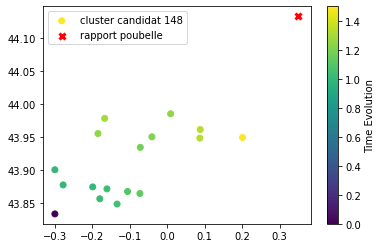

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE         44.133
LONGITUDE          0.35
CLASSI               -1
Name: 5484, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  134950.416667    

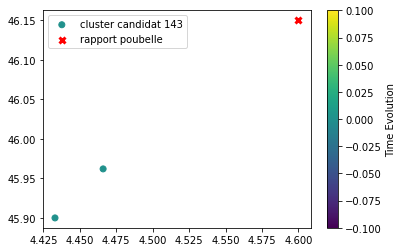

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE          46.15
LONGITUDE           4.6
CLASSI               -1
Name: 5485, dtype: object
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143


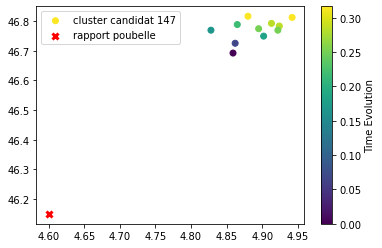

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE          46.15
LONGITUDE           4.6
CLASSI               -1
Name: 5485, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5486  134952.233333    46.816      4.880     147
5487  134952.233333    46.812      4.942     147
5488       134952.2    46.792      4.913     147
5489       134952.2    46.783      4.924     147
5490  134952.166667    46.774      4.895     147
5491  134952.166667    46.769      4.922     147
5493  134952.133333    46.788      4.865     147
5494       134952.1    46.749      4.902     147
5495  134952.083333    46.769      4.828     147
5496  134951.983333    46.725      4.862     147
5497  134951.916667    46.692      4.859     147


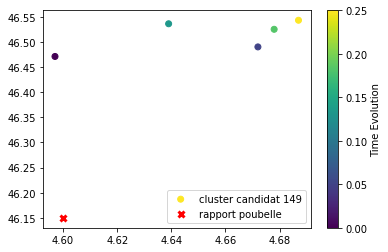

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE          46.15
LONGITUDE           4.6
CLASSI               -1
Name: 5485, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5506  134951.616667    46.543      4.687     149
5508      134951.55    46.525      4.678     149
5511       134951.5    46.536      4.639     149
5515  134951.416667    46.490      4.672     149
5519  134951.366667    46.471      4.597     149
ON TESTE LE RAPPORT D'INDICE 142 DANS LE CLUSTER POUBELLE


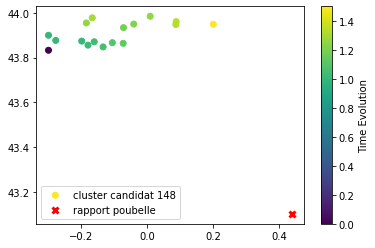

rapport dans poubelle TIME_EVENT    134951.75
LATITUDE         43.102
LONGITUDE          0.44
CLASSI               -1
Name: 5500, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  134950.416667    

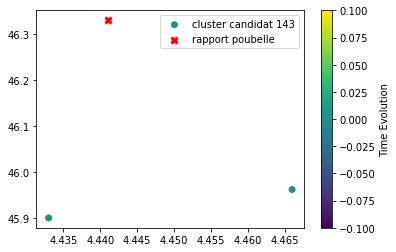

rapport dans poubelle TIME_EVENT    134951.2
LATITUDE        46.331
LONGITUDE        4.441
CLASSI              -1
Name: 5520, dtype: object
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143


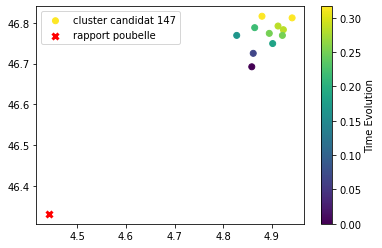

rapport dans poubelle TIME_EVENT    134951.2
LATITUDE        46.331
LONGITUDE        4.441
CLASSI              -1
Name: 5520, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5486  134952.233333    46.816      4.880     147
5487  134952.233333    46.812      4.942     147
5488       134952.2    46.792      4.913     147
5489       134952.2    46.783      4.924     147
5490  134952.166667    46.774      4.895     147
5491  134952.166667    46.769      4.922     147
5493  134952.133333    46.788      4.865     147
5494       134952.1    46.749      4.902     147
5495  134952.083333    46.769      4.828     147
5496  134951.983333    46.725      4.862     147
5497  134951.916667    46.692      4.859     147


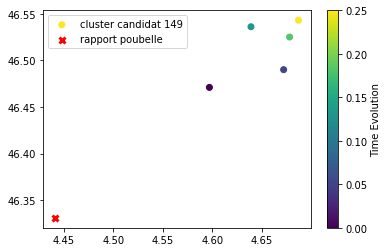

rapport dans poubelle TIME_EVENT    134951.2
LATITUDE        46.331
LONGITUDE        4.441
CLASSI              -1
Name: 5520, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5506  134951.616667    46.543      4.687     149
5508      134951.55    46.525      4.678     149
5511       134951.5    46.536      4.639     149
5515  134951.416667    46.490      4.672     149
5519  134951.366667    46.471      4.597     149
ON TESTE LE RAPPORT D'INDICE 144 DANS LE CLUSTER POUBELLE


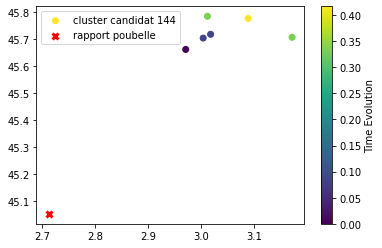

rapport dans poubelle TIME_EVENT    134951.016667
LATITUDE             45.052
LONGITUDE             2.712
CLASSI                   -1
Name: 5523, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
ON TESTE LE RAPPORT D'INDICE 145 DANS LE CLUSTER POUBELLE


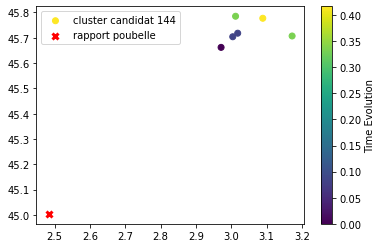

rapport dans poubelle TIME_EVENT    134950.583333
LATITUDE             45.004
LONGITUDE             2.483
CLASSI                   -1
Name: 5527, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
ON TESTE LE RAPPORT D'INDICE 154 DANS LE CLUSTER POUBELLE


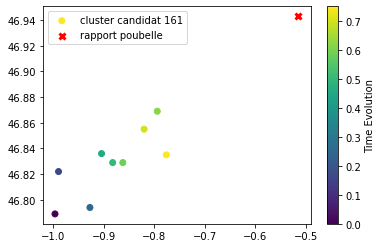

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161


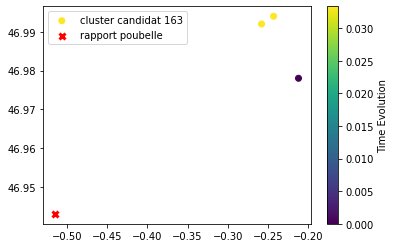

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163


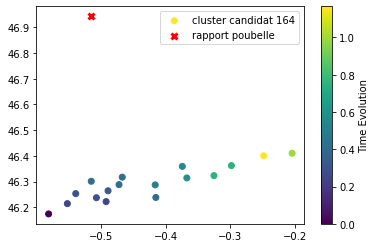

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333    46.288     -0.472     164
6580      134663.25    46.264     -0.489     164
6583  134663.216667    46.253     -0.539     164
6584       134663.2    46.237     -0.507     164
6585  134663.166667    46.214     -0.552     164
6586  134663.166667    46.222     -0.492     164
6588  134662.916667    46.1

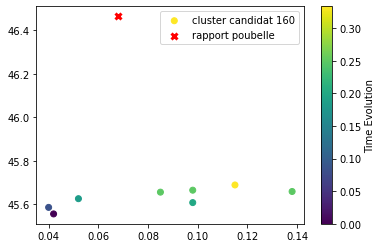

rapport dans poubelle TIME_EVENT    134664.533333
LATITUDE             46.464
LONGITUDE             0.068
CLASSI                   -1
Name: 6567, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160


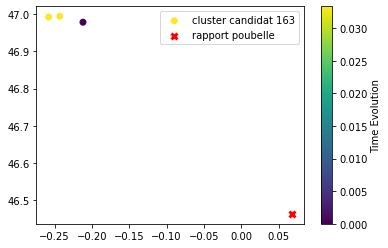

rapport dans poubelle TIME_EVENT    134664.533333
LATITUDE             46.464
LONGITUDE             0.068
CLASSI                   -1
Name: 6567, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
ON TESTE LE RAPPORT D'INDICE 158 DANS LE CLUSTER POUBELLE


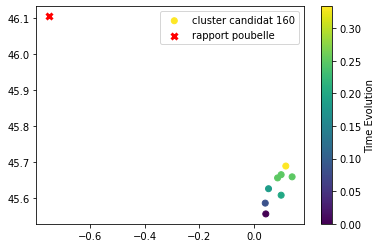

rapport dans poubelle TIME_EVENT    134662.416667
LATITUDE             46.105
LONGITUDE             -0.75
CLASSI                   -1
Name: 6591, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160
ON TESTE LE RAPPORT D'INDICE 160 DANS LE CLUSTER POUBELLE


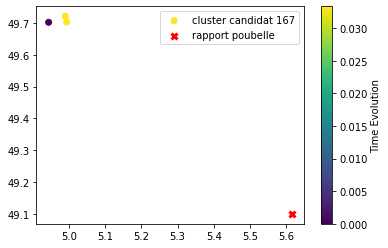

rapport dans poubelle TIME_EVENT    134614.0
LATITUDE          49.1
LONGITUDE        5.617
CLASSI              -1
Name: 6665, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6721  134611.416667    49.703      4.993     167
6722  134611.416667    49.721      4.989     167
6723  134611.383333    49.702      4.943     167
ON TESTE LE RAPPORT D'INDICE 162 DANS LE CLUSTER POUBELLE


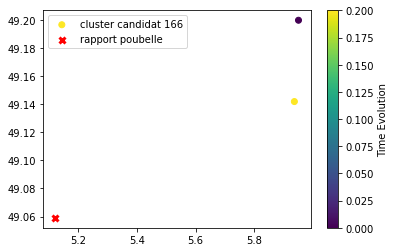

rapport dans poubelle TIME_EVENT    134613.366667
LATITUDE             49.059
LONGITUDE             5.122
CLASSI                   -1
Name: 6674, dtype: object
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6661  134614.25    49.142      5.936     166
6664  134614.05    49.200      5.950     166


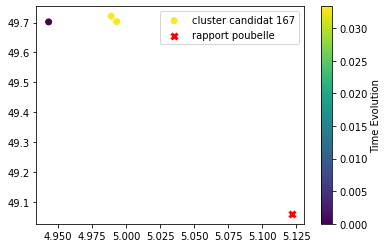

rapport dans poubelle TIME_EVENT    134613.366667
LATITUDE             49.059
LONGITUDE             5.122
CLASSI                   -1
Name: 6674, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6721  134611.416667    49.703      4.993     167
6722  134611.416667    49.721      4.989     167
6723  134611.383333    49.702      4.943     167
ON TESTE LE RAPPORT D'INDICE 163 DANS LE CLUSTER POUBELLE


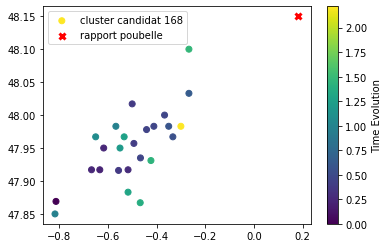

rapport dans poubelle TIME_EVENT    134605.766667
LATITUDE              48.15
LONGITUDE             0.183
CLASSI                   -1
Name: 6728, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747   

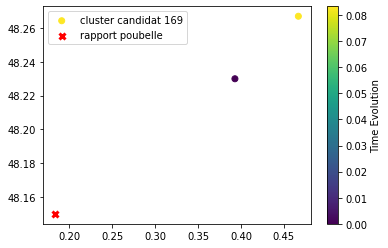

rapport dans poubelle TIME_EVENT    134605.766667
LATITUDE              48.15
LONGITUDE             0.183
CLASSI                   -1
Name: 6728, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
ON TESTE LE RAPPORT D'INDICE 164 DANS LE CLUSTER POUBELLE


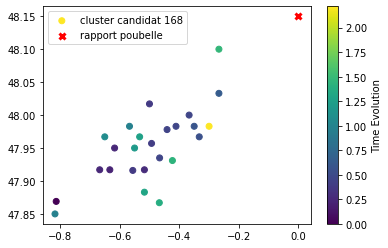

rapport dans poubelle TIME_EVENT    134604.783333
LATITUDE              48.15
LONGITUDE               0.0
CLASSI                   -1
Name: 6737, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747   

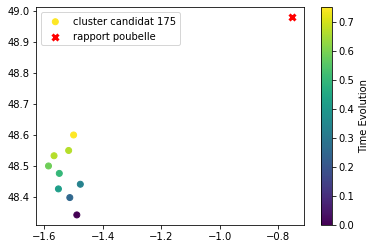

rapport dans poubelle TIME_EVENT    134493.45
LATITUDE          48.98
LONGITUDE        -0.752
CLASSI               -1
Name: 6977, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6967  134493.916667    48.600     -1.500     175
6968  134493.833333    48.550     -1.517     175
6969  134493.833333    48.533     -1.567     175
6970      134493.75    48.500     -1.586     175
6971  134493.666667    48.476     -1.549     175
6974  134493.583333    48.426     -1.552     175
6975       134493.5    48.441     -1.477     175
6978  134493.416667    48.398     -1.513     175
6981  134493.166667    48.342     -1.489     175


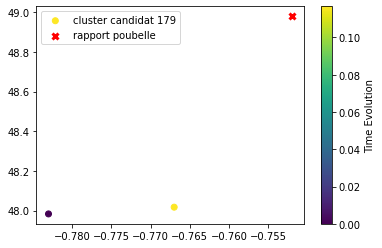

rapport dans poubelle TIME_EVENT    134493.45
LATITUDE          48.98
LONGITUDE        -0.752
CLASSI               -1
Name: 6977, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6990      134492.25    48.017     -0.767     179
6992  134492.133333    47.983     -0.783     179


In [ ]:
plot_cluster_rapport_all(visu_results,trash_try)

In [ ]:
trash_try_bis = fusion_poubelle(visu_results_bis)

In [ ]:
trash_try_bis

[[0, [1]],
 [2, [4, 5]],
 [4, [8]],
 [11, [12]],
 [37, [30]],
 [44, [34]],
 [45, [34]],
 [54, [37]],
 [55, [37]],
 [63, [48, 51]],
 [66, [50]],
 [71, [60]],
 [75, [65]],
 [76, [65]],
 [80, [70]],
 [82, [72]],
 [83, [73]],
 [84, [73]],
 [89, [81, 88, 89, 90]],
 [91, [94, 96]],
 [92, [96, 100, 101]],
 [93, [95]],
 [94, [97]],
 [95, [100, 101]],
 [99, [103, 108]],
 [100, [107]],
 [101, [113]],
 [108, [125]],
 [111, [127]],
 [112, [125, 127]],
 [113, [121]],
 [114, [122, 131, 132]],
 [115, [122, 127, 131, 132, 134]],
 [117, [128, 130]],
 [118, [125, 131]],
 [120, [125, 127, 131]],
 [121, [129]],
 [122, [127, 132, 134]],
 [123, [122, 128, 130]],
 [124, [122, 128, 130]],
 [125, [133]],
 [126, [131, 135]],
 [127, [134]],
 [129, [140]],
 [131, [140]],
 [132, [144]],
 [133, [145]],
 [134, [144]],
 [135, [145]],
 [137, [145, 148]],
 [138, [147]],
 [139, [148, 150]],
 [140, [148]],
 [141, [147, 149]],
 [142, [148]],
 [143, [147, 149]],
 [144, [144]],
 [145, [144]],
 [154, [159, 161, 163]],
 [156,

In [ ]:
candidats_fusion_poubelle = [4,8],[11,12],[37,30],[]

In [ ]:
plot_cluster_rapport_all(visu_results_bis,trash_try_bis)

In [ ]:
# Faire un st_dbscan que sur la poubelle avec paramètres plus larges

In [ ]:
poubelle

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
26,138356.966667,49.502,1.586,-1
27,138356.7,48.333,1.933,-1
30,138356.416667,48.500,0.483,-1
46,138354.083333,48.183,-0.892,-1
55,138284.133333,47.231,0.253,-1
...,...,...,...,...
7268,133965.416667,46.817,-1.000,-1
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
model_poub = ST_DBSCAN(eps1=0.5, eps2=2,
                         min_samples=2)
model_poub.fit(poubelle.iloc[:,:-1])
classi_poubelle = model_poub.labels
visu_poub = poubelle.iloc[:,:-1].copy()
visu_poub['CLASSI'] = classi_poubelle
orages_poub = cluster2(poubelle.iloc[:,:-1],classi_poubelle)

In [ ]:
visu_poub

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
26,138356.966667,49.502,1.586,-1
27,138356.7,48.333,1.933,-1
30,138356.416667,48.500,0.483,-1
46,138354.083333,48.183,-0.892,-1
55,138284.133333,47.231,0.253,-1
...,...,...,...,...
7268,133965.416667,46.817,-1.000,-1
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,32
7309,133604.083333,48.636,4.952,32


In [ ]:
l_poub = np.unique(classi_poubelle)#, return_counts = True)

In [ ]:
l_poub

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32])

In [ ]:
#on arrive à regrouper des couples/triplets de rapports pour former 33 nouveaux clusters

In [ ]:
visu_results_bis = visu_results.copy()

In [ ]:
max_new_clusters = max(visu_poub.CLASSI)
nbr_clusters = max(visu_results_bis.CLASSI)
for i in range(max_new_clusters+1):
  indices = visu_poub[visu_poub.CLASSI == i].index
  for e in indices:
    visu_results_bis.loc[e,'CLASSI'] = nbr_clusters + 1 + i

In [ ]:
visu_results_bis # FRANCE 2022 avec fusion des orages de la poubelle

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,181
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,214
7309,133604.083333,48.636,4.952,214


In [ ]:
visu_test = visu_results_bis.sort_values('TIME_EVENT',ascending = False) 

In [ ]:
visu_test

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,181
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,214
7309,133604.083333,48.636,4.952,214


In [ ]:
visu_test.groupby('CLASSI').count()

,TIME_EVENT,LATITUDE,LONGITUDE
CLASSI,,,
-1,116,116,116
0,2,2,2
1,7,7,7
2,7,7,7
3,8,8,8
...,...,...,...
210,3,3,3
211,2,2,2
212,2,2,2


In [ ]:
[1,3,2].sort()

In [ ]:
#récupère la fin de chaque orage

In [ ]:
end = []
for i in range(0,max(visu_test.CLASSI)+1):
  end.append(min(visu_test[visu_test.CLASSI == i].index))

In [ ]:
end

In [ ]:
end_sort = sorted(end)

In [ ]:
end_sort

In [ ]:
new_clusters = []
for i in range(len(end)):
  new_clusters.append(end_sort.index(end[i]))

In [ ]:
# on repasse dans l'algo de fusion ce nouveau dataset

In [ ]:
def fusion_all_FR_time(visu_results,temps):
  n = max(visu_results['CLASSI'])
  fus = []
  compteur = 0
  total = n+1
  for i in range(0,n+1):
    t_mean = np.mean(visu_results[visu_results.CLASSI == i].TIME_EVENT)
    sub_data = visu_results[(visu_results.TIME_EVENT < t_mean + temps) & (visu_results.TIME_EVENT > t_mean)]
    orages = np.unique(sub_data.CLASSI)
    orages_true = orages[1:]
    orages_true_true = [x for x in orages_true if x!=i]
    for j in orages_true_true:
      fus.append([i,j,fusion3(visu_results,i,j)])
    compteur +=1
    if compteur == total//4:
      print('25%')
    elif compteur == total//2:
      print('50%')
    elif compteur == (3*total)//4:
      print('75%')

  return fus,renvoie_true(fus)
      

In [ ]:
fus_try,true_fus_try = fusion_all_FR_time(visu_test,3)

25%
50%
75%


In [ ]:
true_fus_try

[[32, 29],
 [34, 186],
 [41, 40],
 [55, 57],
 [57, 55],
 [61, 192],
 [62, 55],
 [63, 54],
 [74, 73],
 [76, 75],
 [88, 86],
 [91, 88],
 [92, 89],
 [96, 196],
 [98, 96],
 [98, 196],
 [103, 106],
 [106, 104],
 [106, 105],
 [107, 105],
 [110, 105],
 [110, 106],
 [110, 111],
 [111, 104],
 [111, 106],
 [111, 110],
 [126, 122],
 [126, 201],
 [127, 122],
 [127, 198],
 [130, 128],
 [131, 125],
 [131, 127],
 [131, 200],
 [132, 122],
 [132, 126],
 [132, 127],
 [134, 127],
 [135, 127],
 [135, 132],
 [145, 206],
 [146, 143],
 [153, 151],
 [159, 158],
 [162, 163],
 [163, 159],
 [163, 162],
 [164, 159],
 [164, 160],
 [164, 161],
 [168, 169],
 [168, 211],
 [169, 211],
 [174, 173],
 [176, 174],
 [192, 61],
 [196, 96],
 [201, 122],
 [201, 126],
 [203, 126],
 [203, 135],
 [208, 144]]

In [ ]:
def pipe_fusion_FR_time(visu_results,temps):
  fus_r,true_fus_r = fusion_all_FR_time(visu_results,temps)
  if len(true_fus_r) == 0:
    return('pas de fusion')
  else:
    n = len(true_fus_r)
    for i in range(n):
      fus_plot(visu_results,true_fus_r[i][0],true_fus_r[i][1])
      print(visu_results[visu_results.CLASSI == true_fus_r[i][1]])
      print(visu_results[visu_results.CLASSI == true_fus_r[i][0]])

In [ ]:
candidats_fusion_time = [[29,32],[34,186],[73,74],[81,84],
                    [81,86],[88,91],[89,92],[96,98],[98,196],
                    [126,201],[128,130],[127,134],[145,206],[143,146],[158,159],
                    [162,163],[159,164],[168,169],[168,211],[169,211],[173,174],
                    [174,176],[96,196],[122,201],[126,201],[135,203],[144,208]]

25%
50%
75%


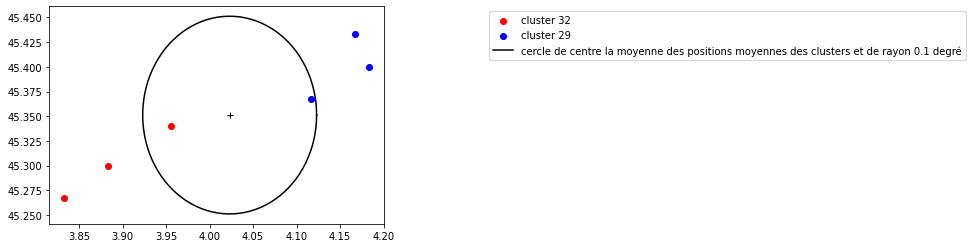

        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
977  136746.333333    45.400      4.183      29
978      136746.25    45.433      4.167      29
982  136745.966667    45.367      4.117      29


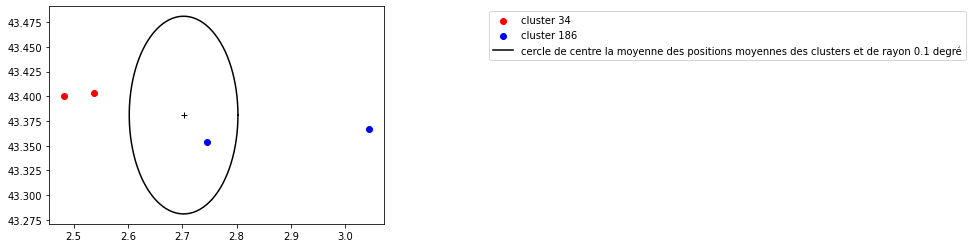

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1004  136727.916667    43.367      3.043     186
1005      136726.75    43.354      2.746     186


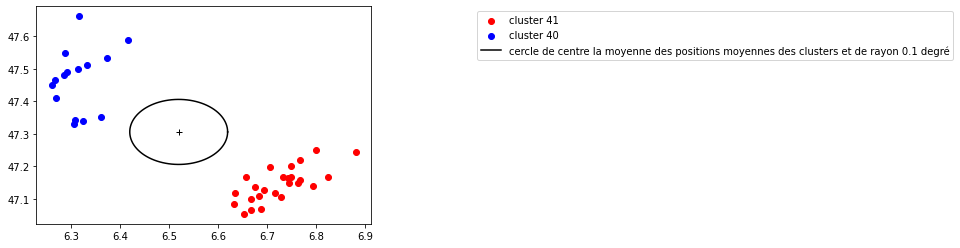

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1684  136076.833333    47.244      6.882      41
1694      136076.75    47.168      6.825      41
1696  136076.716667    47.250      6.800      41
1701  136076.666667    47.157      6.768      41
1703  136076.666667    47.169      6.749      41
1702  136076.666667    47.165      6.742      41
1697  136076.666667    47.220      6.767      41
1700  136076.666667    47.148      6.764      41
1699  136076.666667    47.139      6.794      41
1704      136076.65    47.149      6.746      41
1709  136076.533333    47.200      6.750      41
1710  136076.516667    47.105      6.728      41
1713       136076.5    47.198      6.707      41
1711       136076.5    47.117      6.717      41
1712       136076.5    47.167      6.733      41
1716  136076.483333    47.069      6.688      41
1715  136076.483333    47.168      6.657      41
1717  136076.466667    47.136      6.676      41
1718  136076.466667    47.128      6.694      41
1720      136076.45 

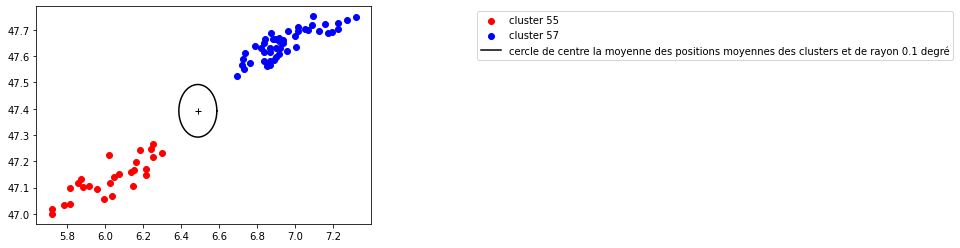

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3235       135507.0    47.217      6.250      55
3240  135506.983333    47.267      6.250      55
3241  135506.966667    47.107      6.145      55
3242  135506.966667    47.147      6.215      55
3243      135506.95    47.243      6.180      55
3244      135506.95    47.199      6.159      55
3247       135506.9    47.167      6.150      55
3248  135506.883333    47.158      6.137      55
3251  135506.833333    47.152      6.069      55
3257  135506.783333    47.142      6.046      55
3258  135506.783333    47.117      6.025      55
3261      135506.75    47.067      6.033      55
3262      135506.75    47.226      6.020      55
3263      135506.75    47.056      5.993      55
3266       135506.7    47.093      5.956      55
3269  135506.683333    47.108      5.914      55
3273      135506.65 

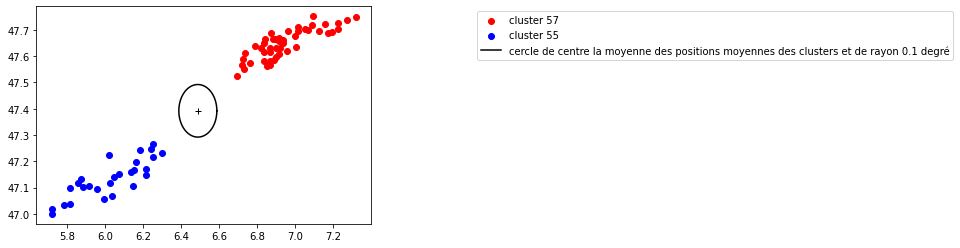

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3237       135507.0    47.749      7.319      57
3246  135506.916667    47.736      7.271      57
3249  135506.866667    47.704      7.224      57
3250  135506.866667    47.727      7.226      57
3252  135506.833333    47.692      7.192      57
3254  135506.816667    47.689      7.171      57
3255       135506.8    47.723      7.154      57
3256  135506.783333    47.752      7.092      57
3259  135506.766667    47.700      7.067      57
3260      135506.75    47.712      7.015      57
3264      135506.75    47.694      7.122      57
3265  135506.733333    47.717      7.089      57
3268  135506.683333    47.702      7.051      57
3271  135506.666667    47.697      6.959      57
3270  135506.666667    47.675      6.998      57
3272      135506.65    47.650      6.933      57
3274      135506.65    47.635      7.004      57
3275  135506.633333    47.696      7.012      57
3279  135506.616667    47.621      6.958      57
3280  135506.583333 

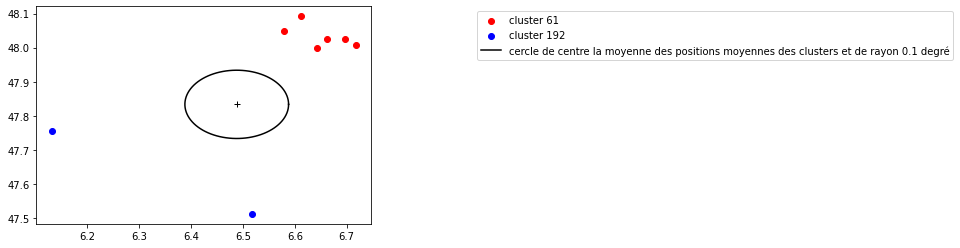

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3343  135506.033333    48.009      6.718      61
3345       135506.0    47.999      6.643      61
3424  135505.166667    48.092      6.612      61
3430      135505.05    48.050      6.580      61
3432  135505.016667    48.024      6.662      61
3433  135505.016667    48.026      6.696      61
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3331  135506.116667    47.513      6.517     192
3447  135504.466667    47.756      6.131     192


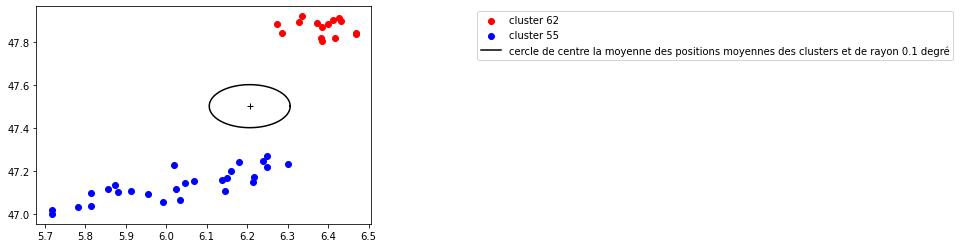

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3369  135505.783333    47.911      6.428      62
3371  135505.766667    47.896      6.432      62
3372      135505.75    47.883      6.400      62
3374      135505.75    47.888      6.373      62
3375      135505.75    47.841      6.469      62
3377      135505.75    47.835      6.469      62
3378      135505.75    47.903      6.411      62
3382       135505.7    47.817      6.383      62
3384       135505.7    47.819      6.417      62
3385       135505.7    47.802      6.384      62
3391  135505.683333    47.867      6.385      62
3442       135504.8    47.919      6.336      62
3444      135504.75    47.890      6.327      62
3448  135504.066667    47.885      6.273      62
3449  135504.016667    47.842      6.286      62
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3235       135507.0 

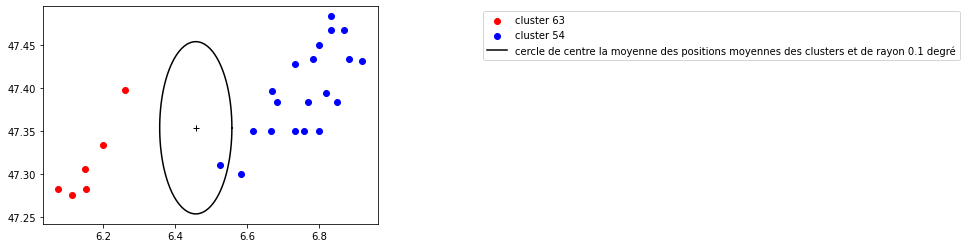

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3376      135505.75    47.397      6.262      63
3396       135505.6    47.333      6.200      63
3397  135505.583333    47.306      6.151      63
3400  135505.516667    47.282      6.153      63
3402       135505.5    47.282      6.076      63
3403       135505.5    47.275      6.114      63
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3212  135507.833333    47.433      6.883      54
3213      135507.75    47.483      6.833      54
3214      135507.75    47.431      6.919      54
3215  135507.733333    47.467      6.867      54
3216       135507.7    47.433      6.783      54
3217  135507.683333    47.467      6.833      54
3218  135507.666667    47.384      6.849      54
3219      135507.65    47.394      6.817      54
3220  135507.616667    47.350      6.800      54
3221       135507.6    47.383      6.767      54
3222  135507.583333    47.350      6.757      54
3223  135507.566667    47.450      6.800      54
3224      135507.55 

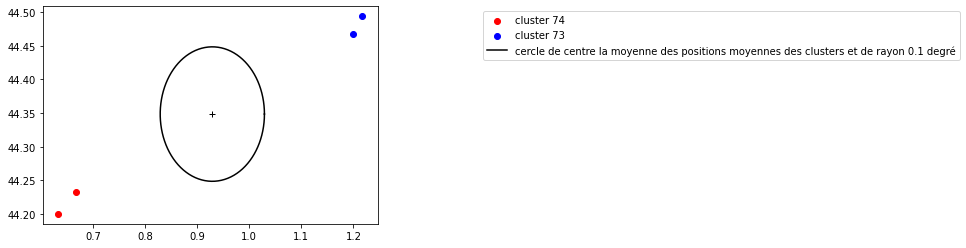

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73


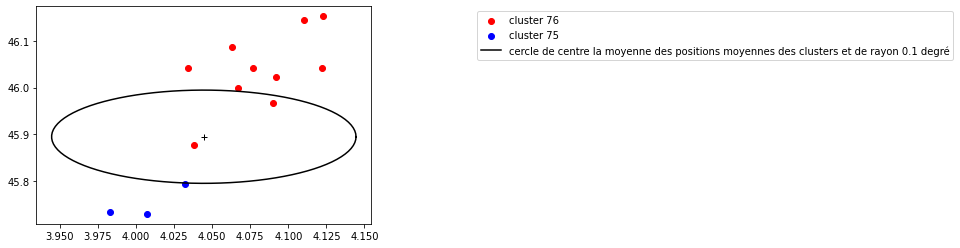

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3645  135404.866667    46.153      4.123      76
3647  135404.833333    46.146      4.110      76
3650      135404.75    46.086      4.063      76
3652  135404.666667    46.041      4.122      76
3651  135404.666667    46.041      4.077      76
3654  135404.633333    46.043      4.034      76
3656  135404.583333    46.022      4.092      76
3658  135404.516667    46.000      4.067      76
3660  135404.416667    45.966      4.090      76
3666      135404.25    45.877      4.038      76
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3638       135406.0    45.793      4.032      75
3640      135405.75    45.729      4.007      75
3641  135405.716667    45.733      3.983      75


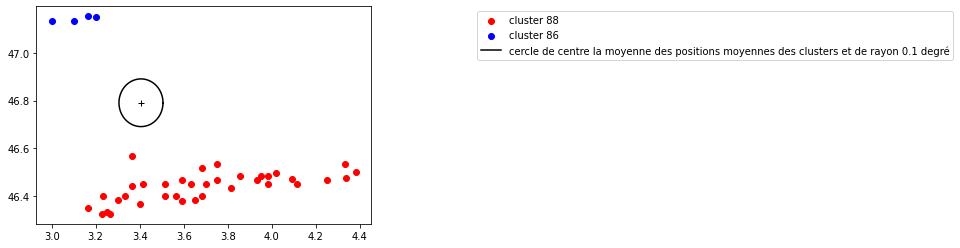

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0    46.533      3.750      88
3877       135381.0    46.452      3.703      88
3884      135380.95    46.567      3.367      88
3886  135380.933333 

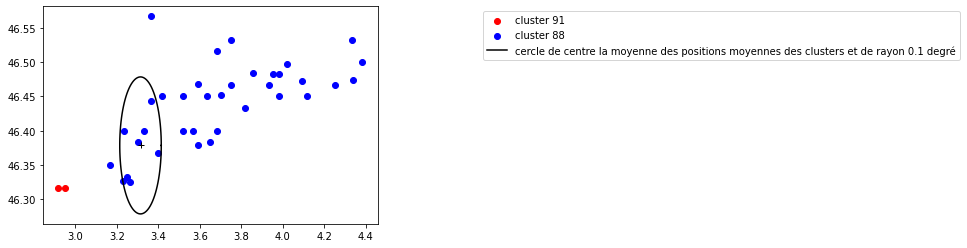

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3921  135379.933333    46.317      2.950      91
3923  135379.883333    46.317      2.917      91
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0 

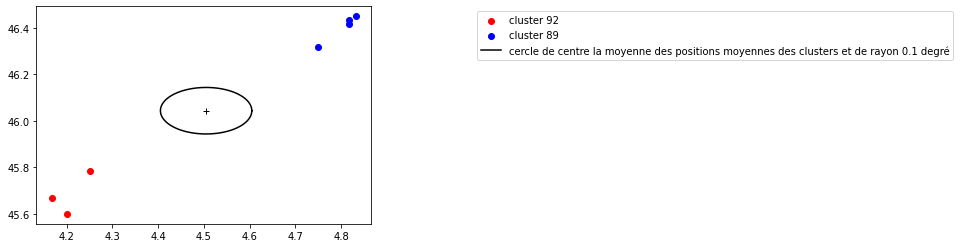

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89


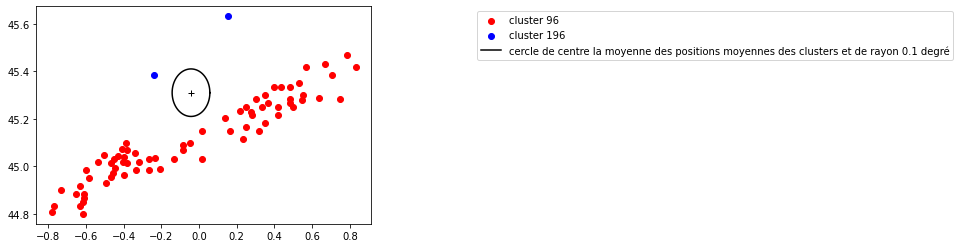

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3974  135362.783333    45.383      0.708      96
3973  135362.783333    45.467      0.783      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4079  135361.083333    44.917     -0.633      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4002  135362.166667    45.632      0.152     196
4087  135361.033333    45.383     -0.236     196


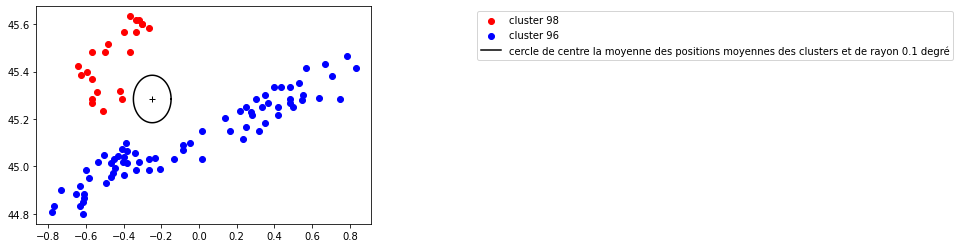

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126      135360.45    45.483     -0.567      98
4127  135360.433333    45.396     -0.595      98
4128  135360.416667    45.283     -0.567      98
4129  135360.416667 

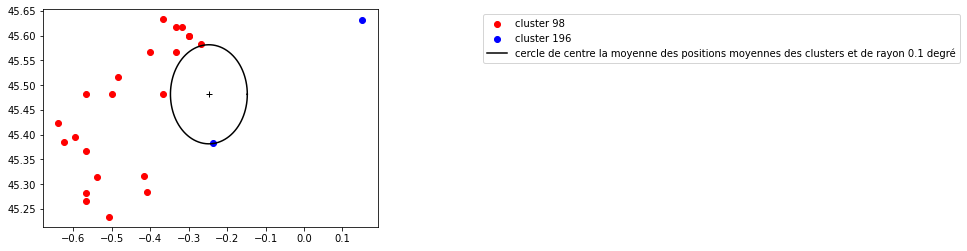

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126      135360.45    45.483     -0.567      98
4127  135360.433333    45.396     -0.595      98
4128  135360.416667    45.283     -0.567      98
4129  135360.416667 

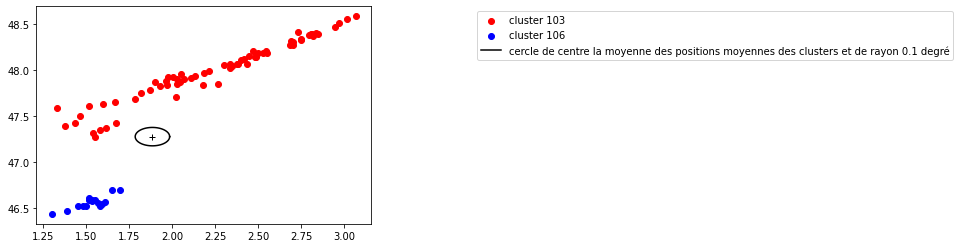

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4261      135338.95    48.583      3.067     103
4262  135338.916667    48.555      3.015     103
4263      135338.85    48.511      2.970     103
4265  135338.666667    48.463      2.945     103
4271      135338.45    48.388      2.846     103
...             ...       ...        ...     ...
4400       135336.5    47.683      1.783     103
4402  135336.333333    47.612      1.518     103
4403  135336.166667    47.500      1.467     103
4404  135336.083333    47.583      1.333     103
4405      135335.95    47.390      1.379     103

[67 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     1

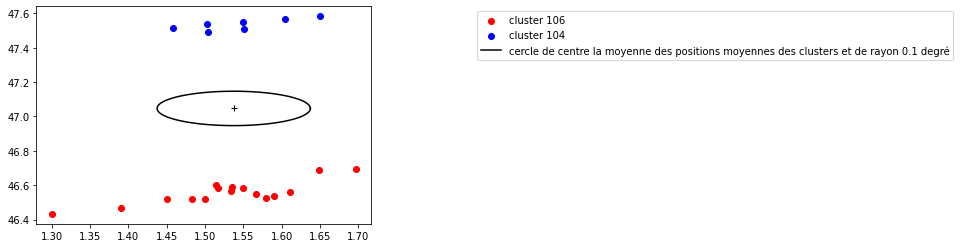

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333 

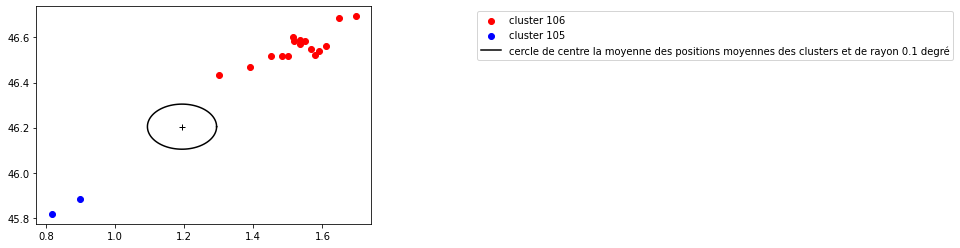

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105


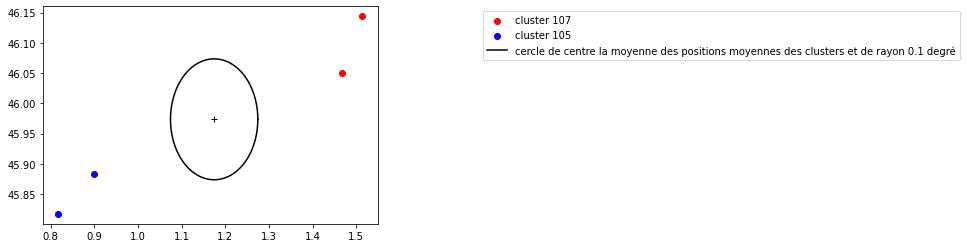

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4297      135337.95    46.144      1.514     107
4317  135337.683333    46.050      1.467     107
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105


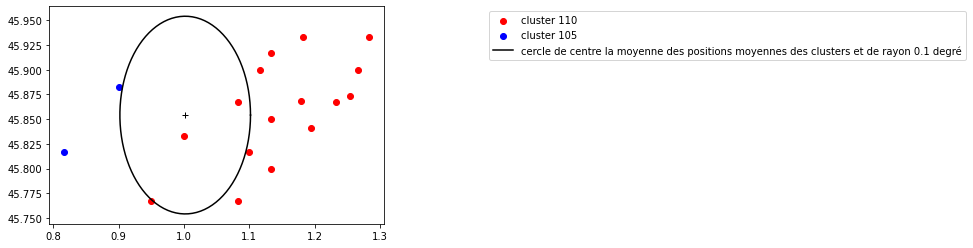

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4344  135337.416667    45.900      1.267     110
4343  135337.416667    45.867      1.233     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105


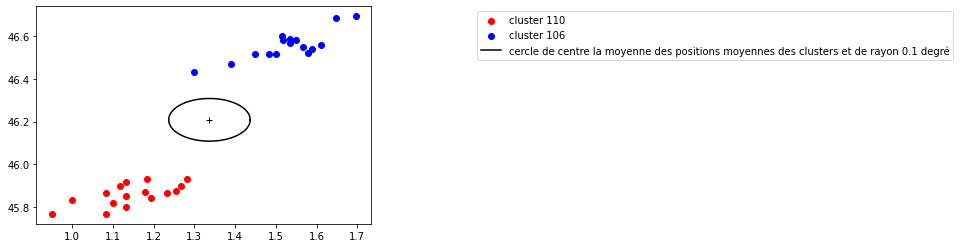

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4344  135337.416667    45.900      1.267     110
4343  135337.416667    45.867      1.233     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0 

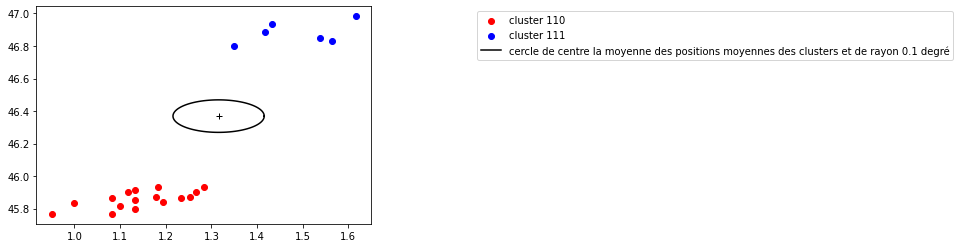

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4344  135337.416667    45.900      1.267     110
4343  135337.416667    45.867      1.233     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4347  135337.416667    46.847      1.537     111
4346  135337.416667    46.828      1.564     111
4387  135336.883333 

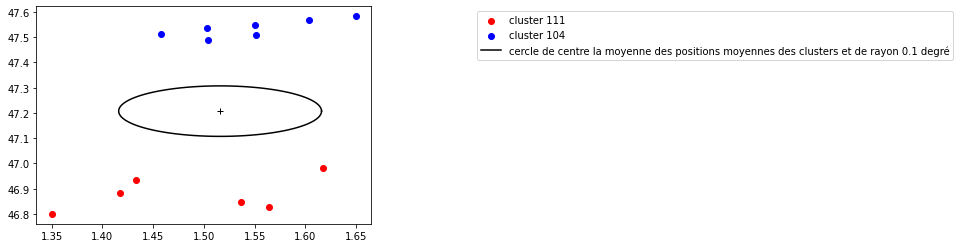

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4347  135337.416667    46.847      1.537     111
4346  135337.416667    46.828      1.564     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104


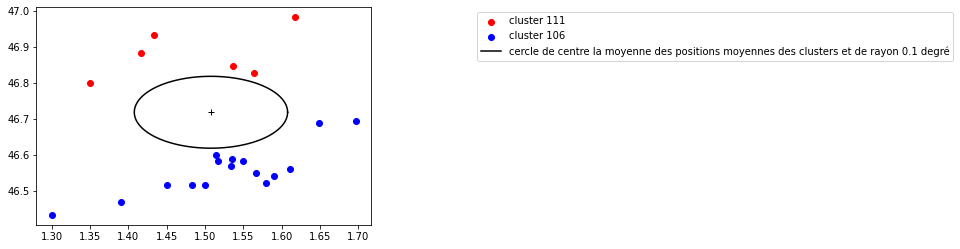

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4347  135337.416667    46.847      1.537     111
4346  135337.416667    46.828      1.564     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85 

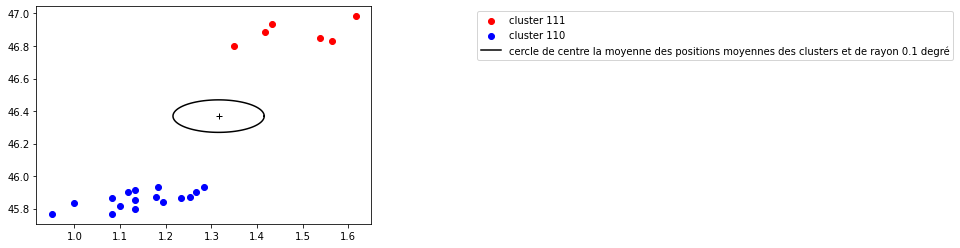

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4347  135337.416667    46.847      1.537     111
4346  135337.416667    46.828      1.564     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4344  135337.416667    45.900      1.267     110
4343  135337.416667    45.867      1.233     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333 

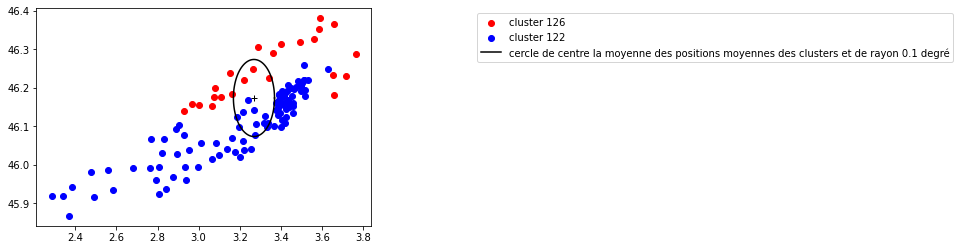

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5276  134976.416667    46.152      3.066     126
5273  134976.416667    46.288      3.766     126
5278  134976.366667    46.199      3.080     126
5279      134976.35    46.176      3.074     126
5281  134976.333333    46.231      3.718     126
5282  134976.283333 

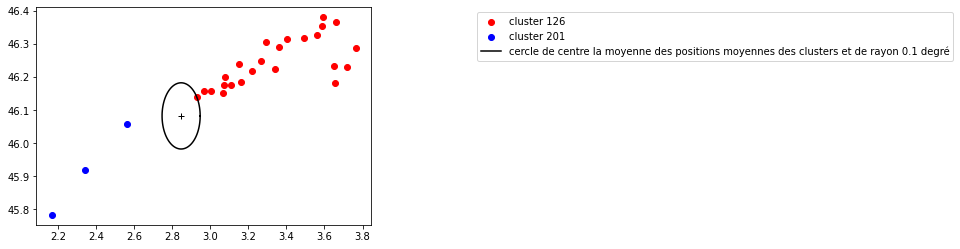

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5276  134976.416667    46.152      3.066     126
5273  134976.416667    46.288      3.766     126
5278  134976.366667    46.199      3.080     126
5279      134976.35    46.176      3.074     126
5281  134976.333333    46.231      3.718     126
5282  134976.283333 

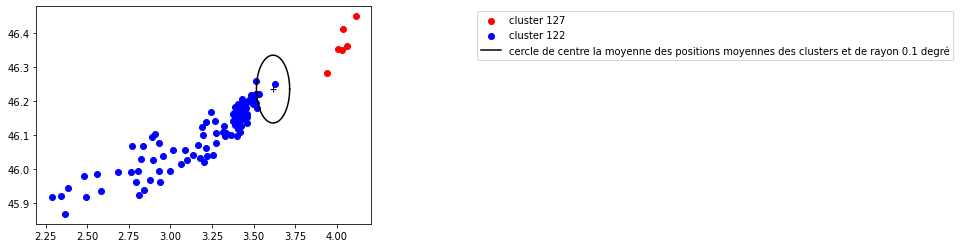

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5260  134976.833333    46.411      4.039     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


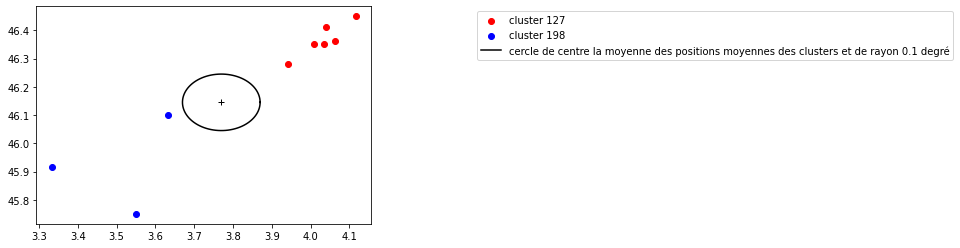

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5260  134976.833333    46.411      4.039     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5114  134980.666667    45.750      3.550     198
5115  134980.583333    45.917      3.333     198
5118  134979.833333    46.100      3.633     198


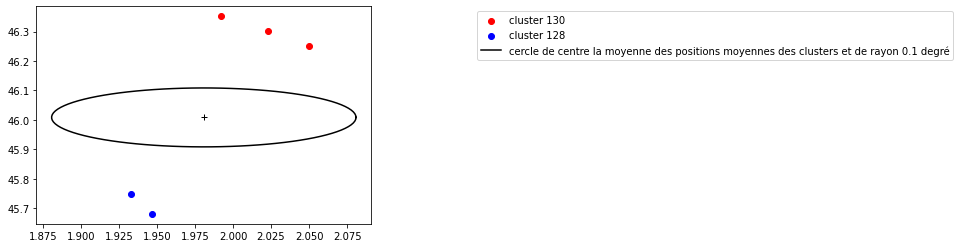

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5275  134976.416667    45.681      1.947     128
5274  134976.416667    45.750      1.933     128


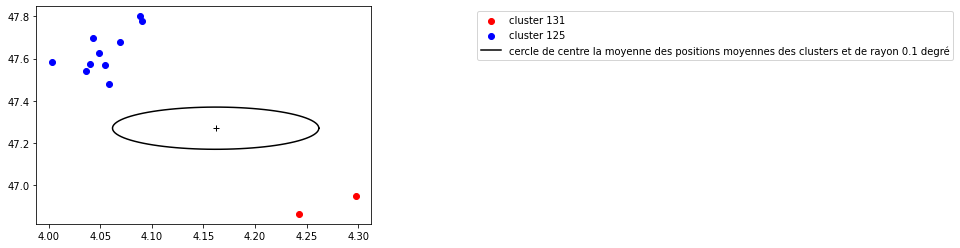

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5233       134977.2    47.575      4.040     125
5232       134977.2    47.570      4.055     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


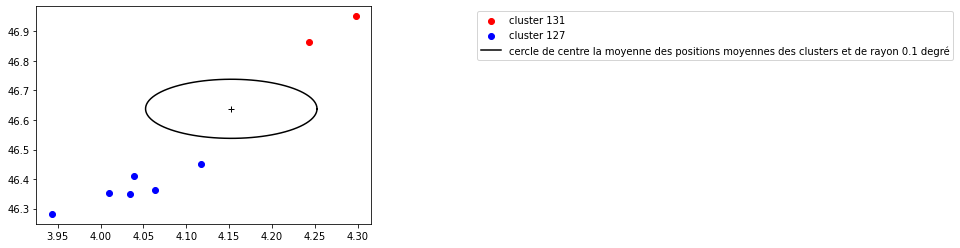

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5260  134976.833333    46.411      4.039     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127


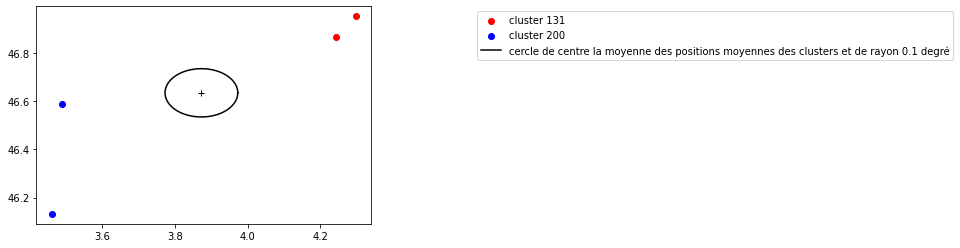

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5243  134977.083333    46.588      3.489     200
5303  134975.783333    46.132      3.461     200


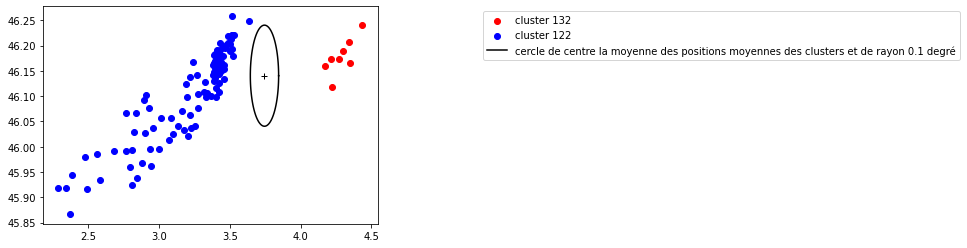

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667 

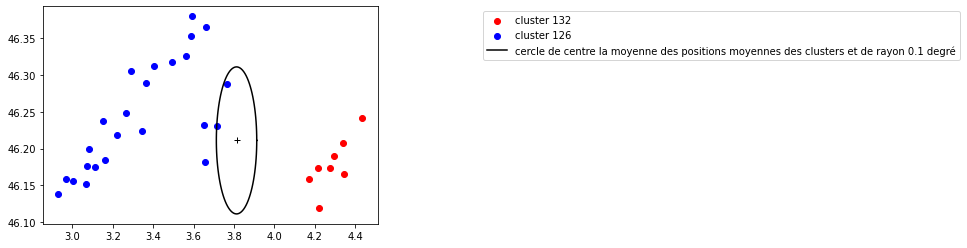

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333 

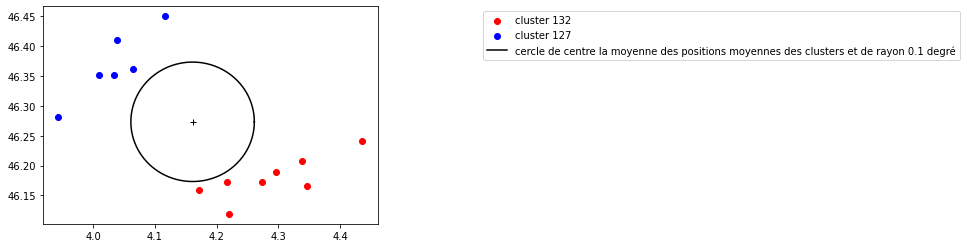

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5260  134976.833333    46.411      4.039     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127


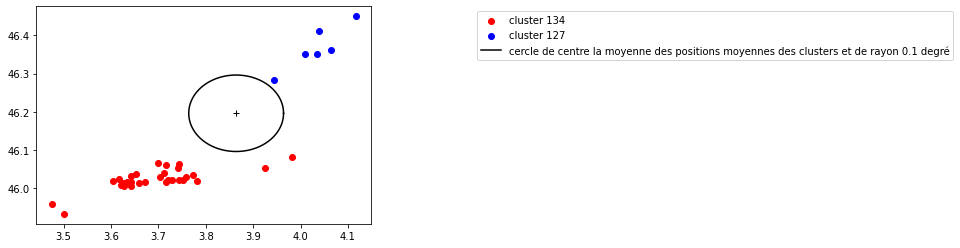

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  134974.383333    46.037      3.652     134
5359      134974.35    46.016      3.671     134
5360  134974.333333    46.017      3.633     134
5361  134974.333333 

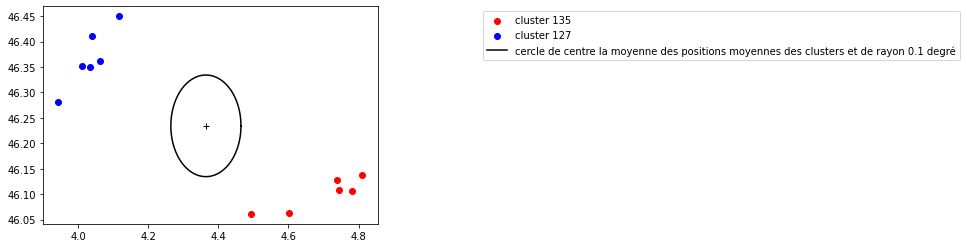

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5347       134974.5    46.127      4.738     135
5346       134974.5    46.109      4.744     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5260  134976.833333    46.411      4.039     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127


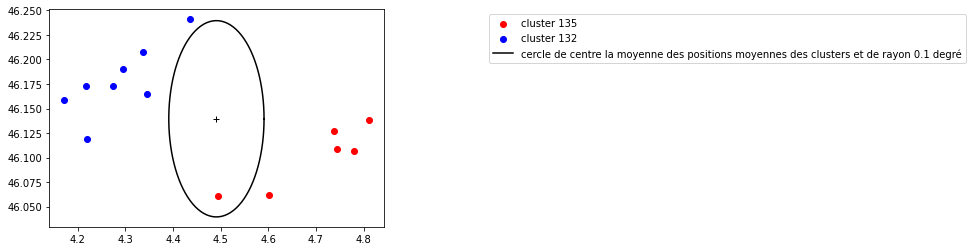

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5347       134974.5    46.127      4.738     135
5346       134974.5    46.109      4.744     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


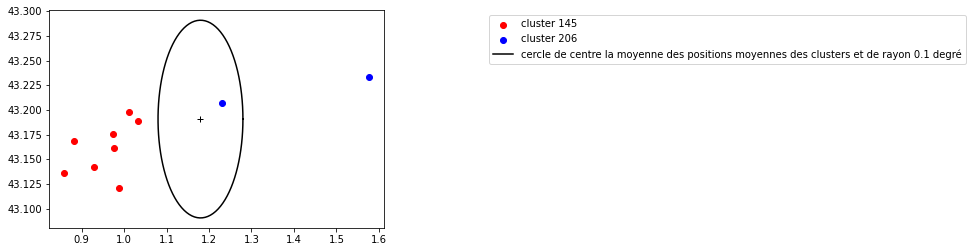

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5460  134953.833333    43.233      1.576     206
5465  134953.216667    43.207      1.230     206


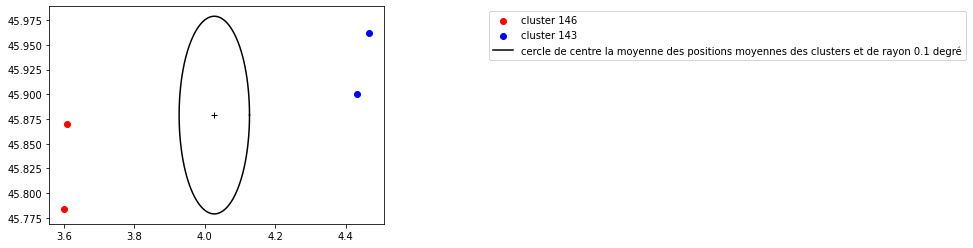

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143


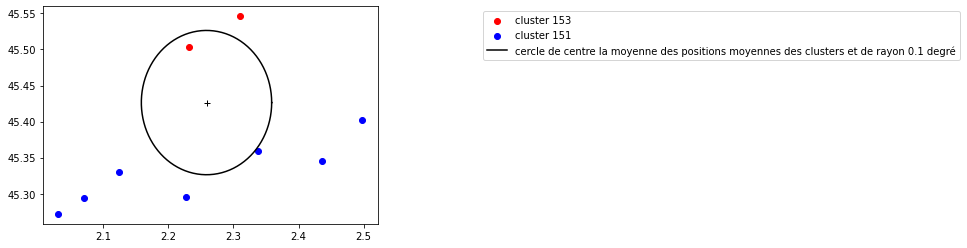

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5601       134927.0    45.546      2.310     153
5605  134926.916667    45.503      2.232     153
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5559  134928.916667    45.402      2.498     151
5565  134928.716667    45.345      2.436     151
5567       134928.5    45.359      2.338     151
5568      134928.35    45.295      2.228     151
5576      134927.95    45.294      2.071     151
5578  134927.916667    45.272      2.031     151
5579  134927.916667    45.330      2.124     151


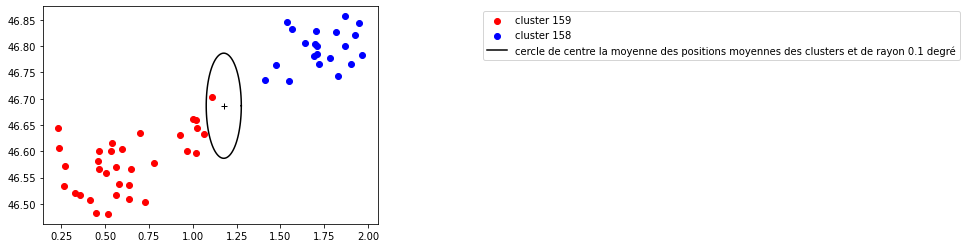

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6523       134665.5    46.634      0.702     159
6520       134665.5    46.567      0.650     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6538      134665.25    46.600      0.533     159
6539      134665.25    46.481      0.519     159
6535      134665.25 

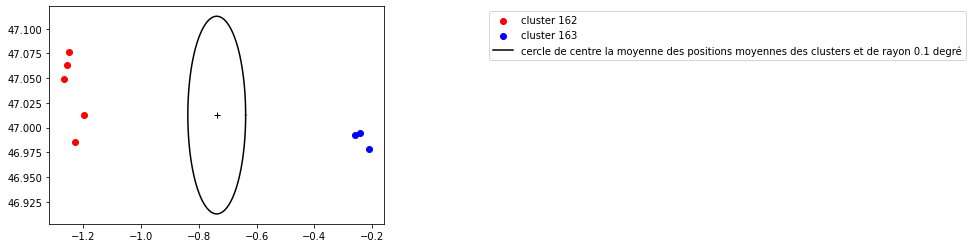

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163


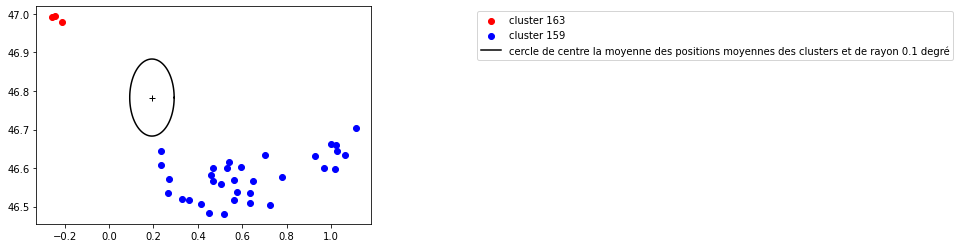

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6523       134665.5    46.634      0.702     159
6520       134665.5    46.567      0.650     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333 

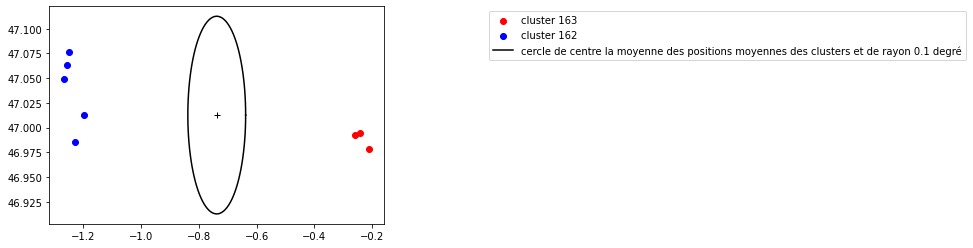

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162


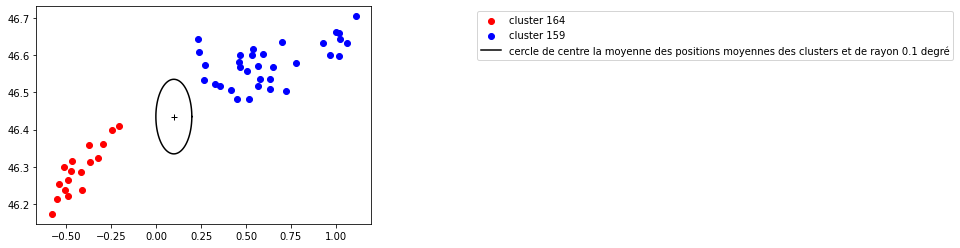

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333    46.288     -0.472     164
6580      134663.25    46.264     -0.489     164
6583  134663.216667    46.253     -0.539     164
6584       134663.2    46.237     -0.507     164
6585  134663.166667    46.214     -0.552     164
6586  134663.166667    46.222     -0.492     164
6588  134662.916667    46.174     -0.581     164
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667 

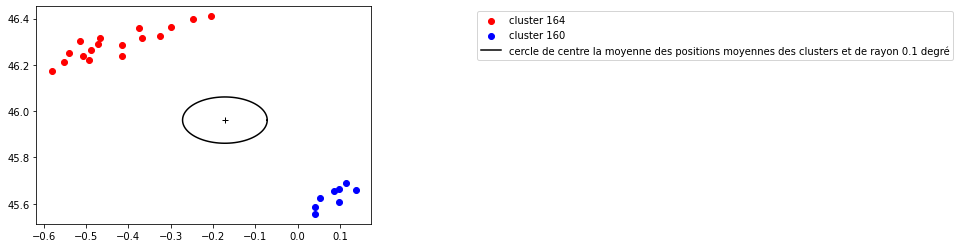

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333    46.288     -0.472     164
6580      134663.25    46.264     -0.489     164
6583  134663.216667    46.253     -0.539     164
6584       134663.2    46.237     -0.507     164
6585  134663.166667    46.214     -0.552     164
6586  134663.166667    46.222     -0.492     164
6588  134662.916667    46.174     -0.581     164
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6522       134665.5 

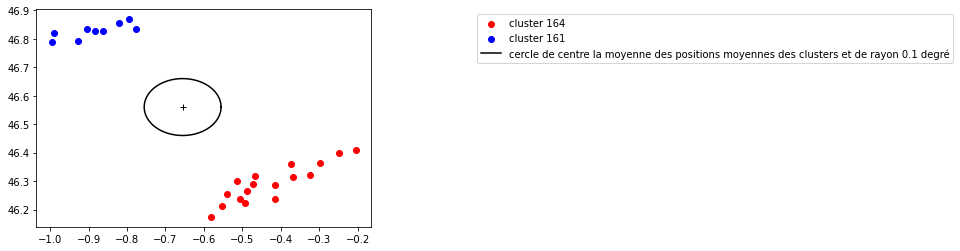

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333    46.288     -0.472     164
6580      134663.25    46.264     -0.489     164
6583  134663.216667    46.253     -0.539     164
6584       134663.2    46.237     -0.507     164
6585  134663.166667    46.214     -0.552     164
6586  134663.166667    46.222     -0.492     164
6588  134662.916667    46.174     -0.581     164
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333 

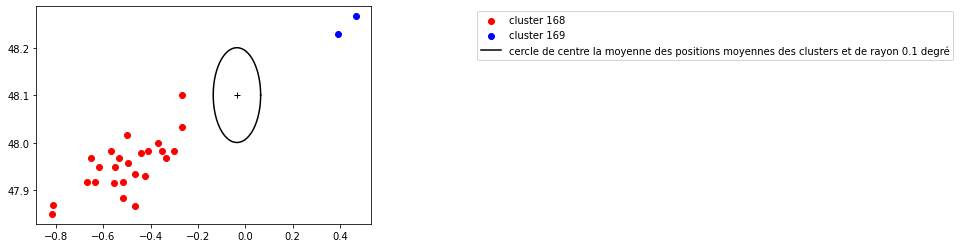

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15    47.978     -0.441     168
6748       134604.1    47.957     -0.493     168
6750  134604.083333    48.017     -0.500     168
6749  134604.083333 

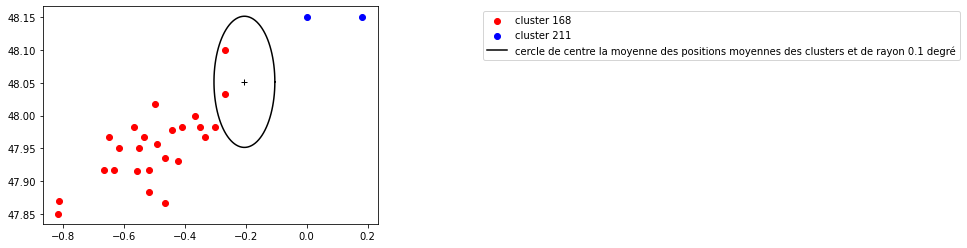

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15    47.978     -0.441     168
6748       134604.1    47.957     -0.493     168
6750  134604.083333    48.017     -0.500     168
6749  134604.083333 

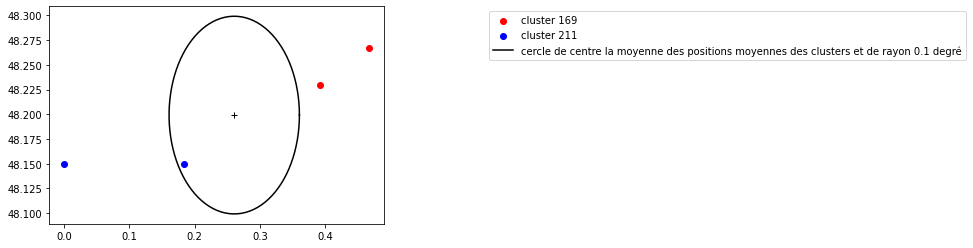

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6728  134605.766667     48.15      0.183     211
6737  134604.783333     48.15      0.000     211


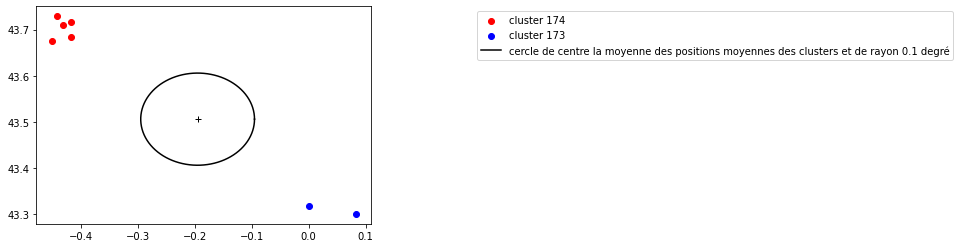

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6961  134494.716667    43.729     -0.443     174
6960  134494.716667    43.709     -0.431     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6952       134496.4    43.300      0.083     173
6953  134496.183333    43.317      0.000     173


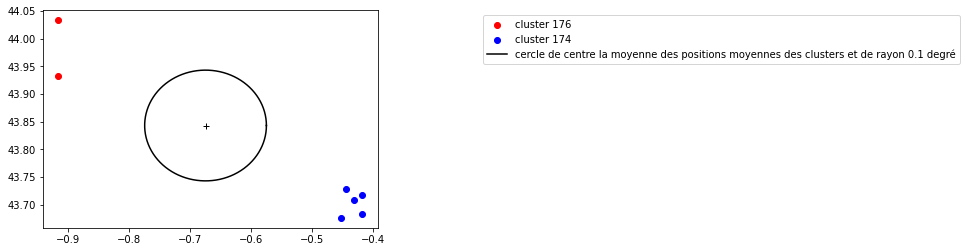

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6972  134493.666667    43.933     -0.917     176
6979       134493.2    44.033     -0.917     176
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6961  134494.716667    43.729     -0.443     174
6960  134494.716667    43.709     -0.431     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174


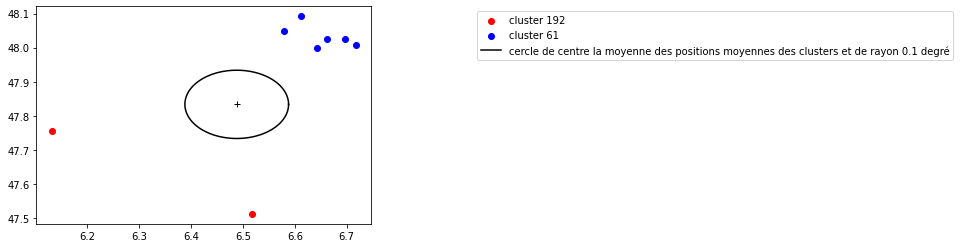

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3331  135506.116667    47.513      6.517     192
3447  135504.466667    47.756      6.131     192
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3343  135506.033333    48.009      6.718      61
3345       135506.0    47.999      6.643      61
3424  135505.166667    48.092      6.612      61
3430      135505.05    48.050      6.580      61
3432  135505.016667    48.024      6.662      61
3433  135505.016667    48.026      6.696      61


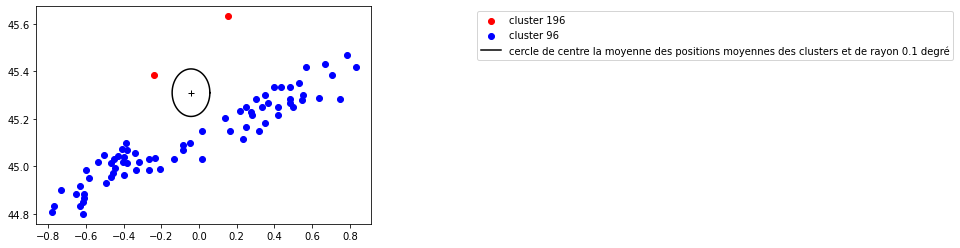

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4002  135362.166667    45.632      0.152     196
4087  135361.033333    45.383     -0.236     196
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3974  135362.783333    45.383      0.708      96
3973  135362.783333    45.467      0.783      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4079  135361.083333    44.917     -0.633      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


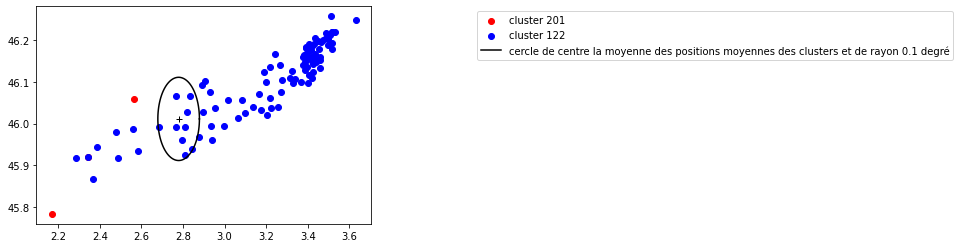

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5264   134976.7    45.783      2.168     201
5316   134975.5    46.059      2.562     201
5325  134975.25    45.919      2.341     201
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


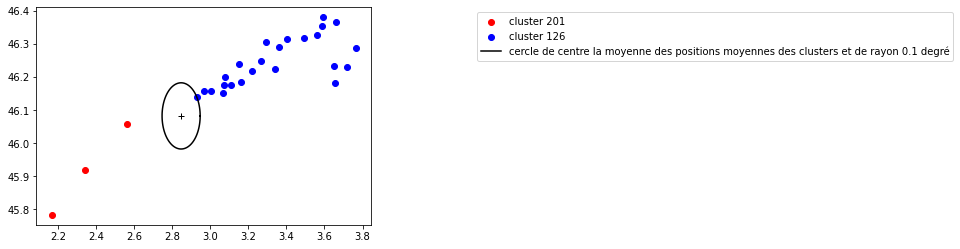

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5264   134976.7    45.783      2.168     201
5316   134975.5    46.059      2.562     201
5325  134975.25    45.919      2.341     201
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5276  134976.416667    46.152      3.066     126
5273  134976.416667    46.288      3

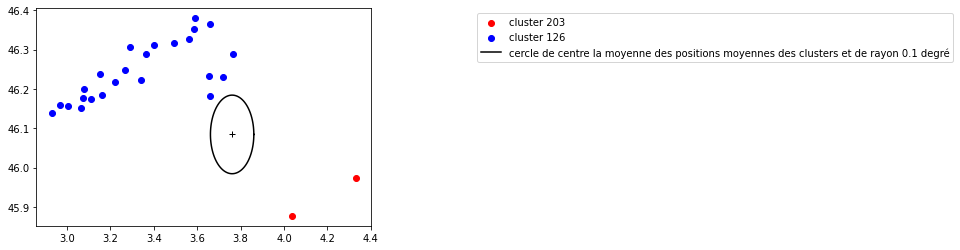

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5393  134973.633333    45.973      4.332     203
5396  134973.133333    45.877      4.035     203
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5276  134976.416667    46.152      3.066     126
5273  134976.416667    46.288      3.766     126
5278  134976.366667 

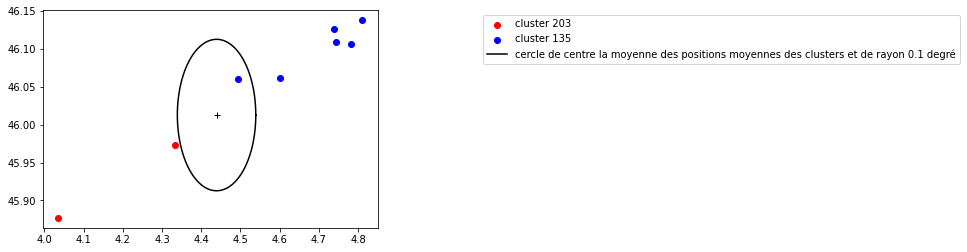

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5393  134973.633333    45.973      4.332     203
5396  134973.133333    45.877      4.035     203
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5347       134974.5    46.127      4.738     135
5346       134974.5    46.109      4.744     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135


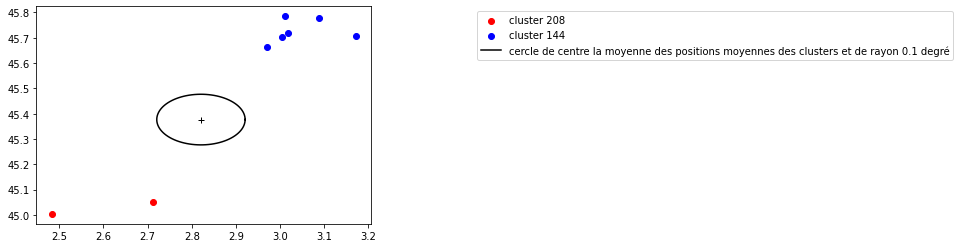

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5523  134951.016667    45.052      2.712     208
5527  134950.583333    45.004      2.483     208
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5471  134952.916667    45.704      3.004     144
5470  134952.916667    45.718      3.018     144
5475  134952.833333    45.662      2.971     144


In [ ]:
pipe_fusion_FR_time(visu_test,3)

In [ ]:
candidats_fusion_time_2 = [[29,32],[34,186],[73,74],
                    [81,84,86],[88,91],[89,92],
                    [122,126,201],[128,130],[127,134],[145,206],[143,146],
                    [158,159,164],[162,163],[168,169,211],
                    [173,174,176],[96,98,196],[135,203],[144,208]]

In [ ]:
visu_test_2 = visu_test.copy()

In [ ]:
for i in range(len(candidats_fusion_time_2)):
  if len(candidats_fusion_time_2[i]) == 2:
    a,b = candidats_fusion_time_2[i][0],candidats_fusion_time_2[i][1]
    indices = visu_test_2[visu_test_2.CLASSI == b].index
    for e in indices:
      visu_test_2.loc[e,'CLASSI'] = a
  elif len(candidats_fusion_time_2[i]) == 3:
    a,b,c = candidats_fusion_time_2[i][0],candidats_fusion_time_2[i][1],candidats_fusion_time_2[i][2]
    indices = list(visu_test_2[visu_test_2.CLASSI == b].index)
    indices_2 = list(visu_test_2[visu_test_2.CLASSI == c].index)
    indices_true = indices + indices_2
    for e in indices_true:
      visu_test_2.loc[e,'CLASSI'] = a

In [ ]:
np.unique(visu_test_2.CLASSI, return_counts = True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  75,  76,  77,  78,
         79,  80,  81,  82,  83,  85,  87,  88,  89,  90,  93,  94,  95,
         96,  97,  99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109,
        110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122,
        123, 124, 125, 127, 128, 129, 131, 132, 133, 135, 136, 137, 138,
        139, 140, 141, 142, 143, 144, 145, 147, 148, 149, 150, 151, 152,
        153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 165, 166, 167,
        168, 170, 171, 172, 173, 175, 177, 178, 179, 180, 181, 182, 183,
        184, 185, 187, 188, 189, 190, 191, 192, 193

In [ ]:
def plot_orages(visu_test_2):
  l = np.unique(visu_test_2.CLASSI, return_counts = True)[0][1:]
  for e in l:
    subset = visu_test_2[visu_test_2.CLASSI == e]
    longi = subset.LONGITUDE
    lati = subset.LATITUDE
    temps = [subset.iloc[j,0]-subset.iloc[-1,0] for j in range(len(subset))]
    plt.scatter(longi,lati, c = temps)
    cbar = plt.colorbar()
    cbar.set_label('Time Evolution')
    plt.title("track de l'orage numéro "+str(e))
    plt.show()

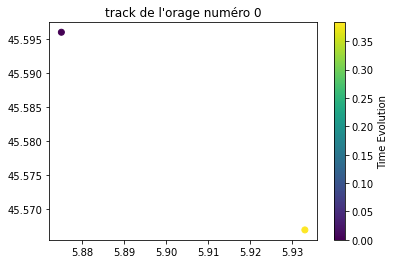

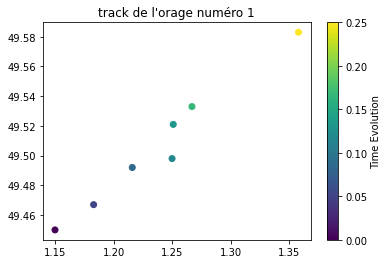

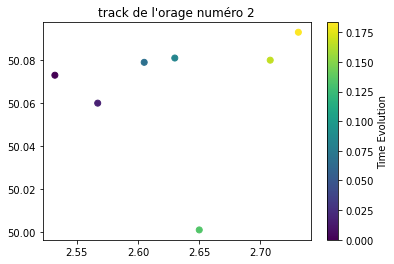

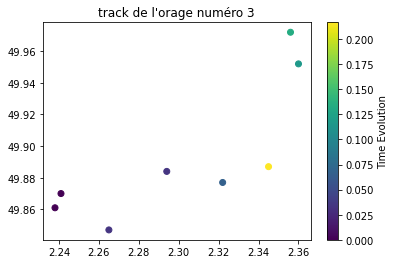

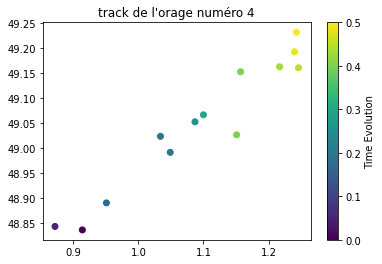

...

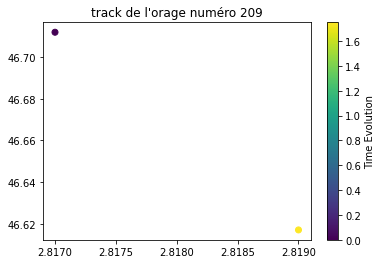

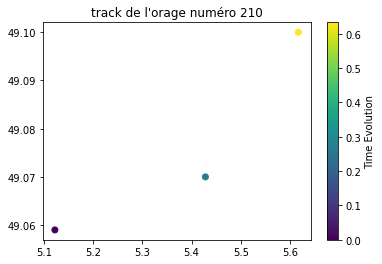

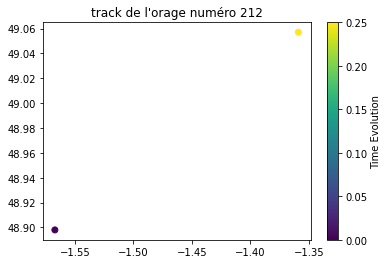

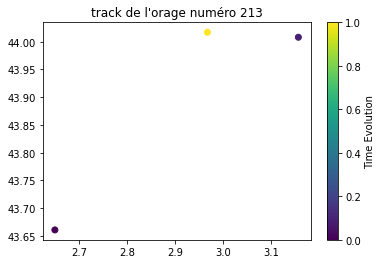

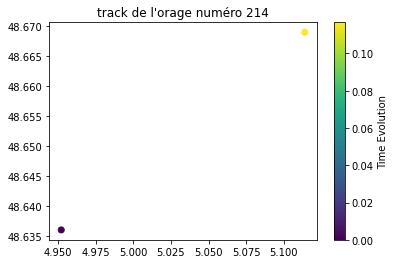

In [ ]:
plot_orages(visu_test_2)

In [ ]:
candidats_fusion_time_2 = [[29,32],[34,186],[73,74],
                    [81,84,86],[88,91],[89,92],
                    [122,126,201],[128,130],[127,134],[145,206],[143,146],
                    [158,159,164],[162,163],[168,169,211],
                    [173,174,176],[96,98,196],[135,203],[144,208]]

In [ ]:
candidats_fusion_time_sur = [[29,32],[73,74],
                    [88,91],[89,92],
                    [145,206],
                    [158,159,164],
                    [173,174,176],[135,203],[144,208]]

In [ ]:
hesitation = [[34,186],[81,84,86],[122,126,201],[128,130],[127,134],[143,146],[168,169,211],[96,98,196]]

In [ ]:
def plot_orage_numero(visu_test_2,i):
  subset = visu_test_2[visu_test_2.CLASSI == i]
  longi = subset.LONGITUDE
  lati = subset.LATITUDE
  temps = [subset.iloc[j,0]-subset.iloc[-1,0] for j in range(len(subset))]
  plt.scatter(longi,lati, c = temps)
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.title("track de l'orage numéro "+str(e))
  plt.show()

In [ ]:
def tracer(visu_results,liste):
  longi,lati = [],[]
  for e in liste:

    longi_0 = visu_results[visu_results.CLASSI == e].LONGITUDE.values
    longi.append(longi_0)
    lati_0 = visu_results[visu_results.CLASSI == e].LATITUDE.values
    lati.append(lati_0)
  
    plt.scatter(longi_0,lati_0, label = str(e))
  plt.legend()
  plt.show()

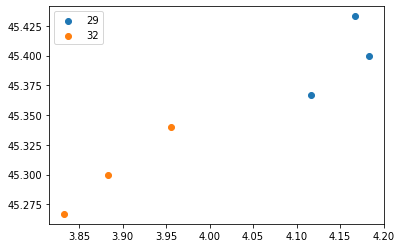

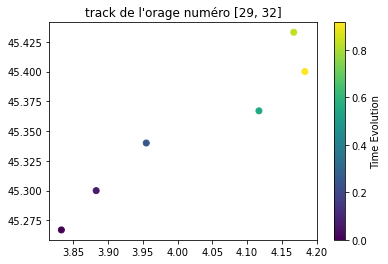

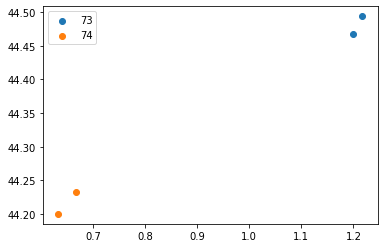

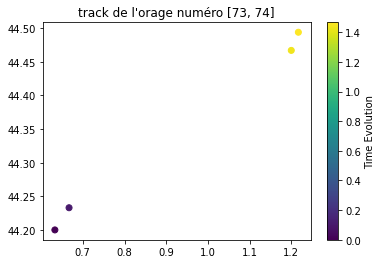

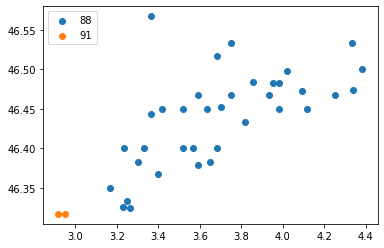

...

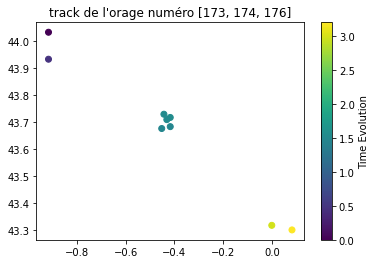

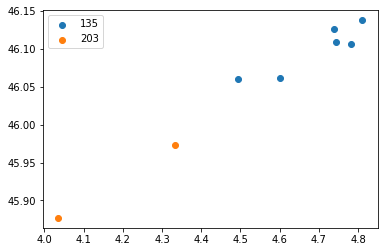

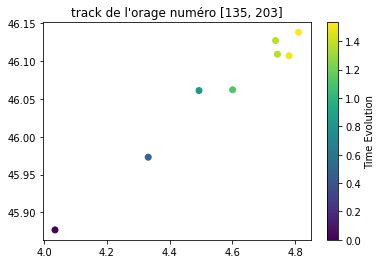

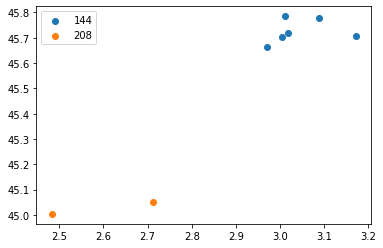

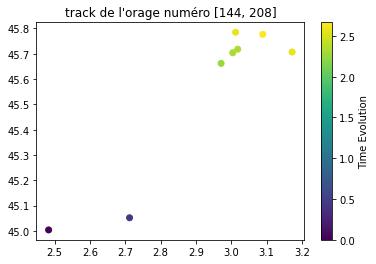

In [ ]:
for e in candidats_fusion_time_sur:
  tracer(visu_test,e)
  plot_orage_numero(visu_test_2,e[0])

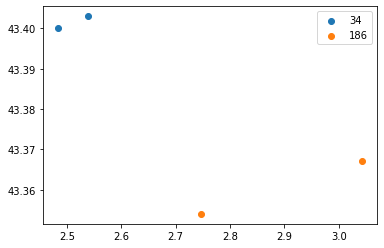

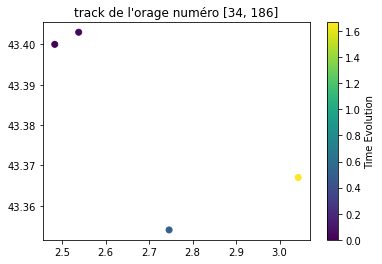

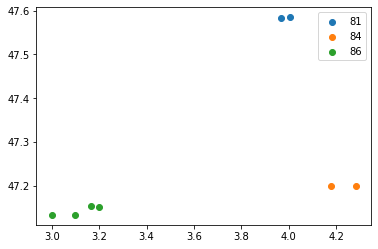

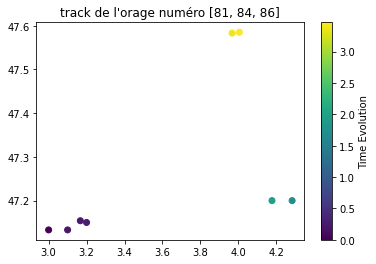

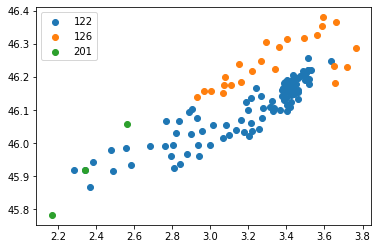

...

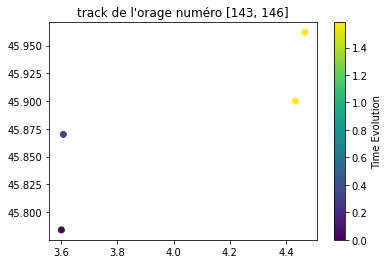

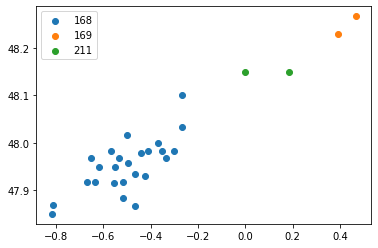

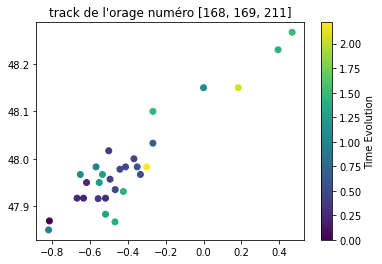

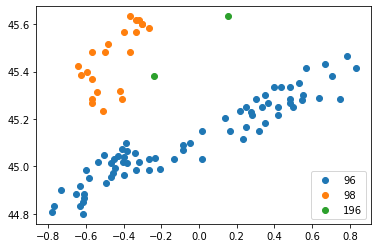

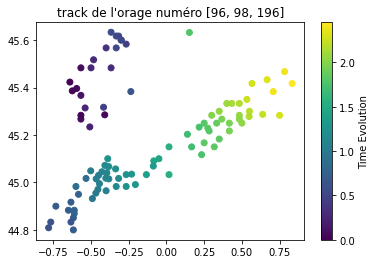

In [ ]:
for e in hesitation:
  tracer(visu_test,e)
  plot_orage_numero(visu_test_2,e[0])

In [ ]:
candidats_fusion_time_sur_sur = [[29,32],[73,74],[88,91],[89,92],[145,206],
                                 [158,159,164],[173,174,176],[135,203],[144,208],
                                 [84,86],[126,201],[98,196]]

In [ ]:
def fusion_finale(visu_test,candidats_fusion):
  for i in range(len(candidats_fusion)):
    if len(candidats_fusion[i]) == 2:
      a,b = candidats_fusion[i][0],candidats_fusion[i][1]
      indices = visu_test[visu_test.CLASSI == b].index
      for e in indices:
        visu_test.loc[e,'CLASSI'] = a
    elif len(candidats_fusion[i]) == 3:
      a,b,c = candidats_fusion[i][0],candidats_fusion[i][1],candidats_fusion[i][2]
      indices = list(visu_test[visu_test.CLASSI == b].index)
      indices_2 = list(visu_test[visu_test.CLASSI == c].index)
      indices_true = indices + indices_2
      for e in indices_true:
        visu_test.loc[e,'CLASSI'] = a

In [ ]:
visu_final = visu_test.copy()

In [ ]:
fusion_finale(visu_final,candidats_fusion_time_sur_sur)

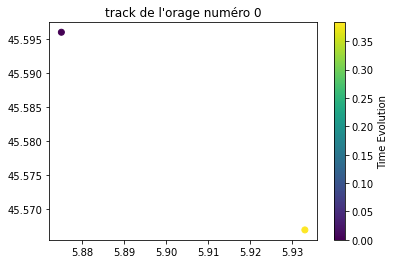

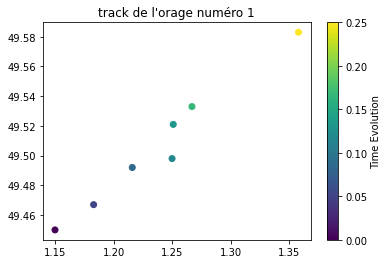

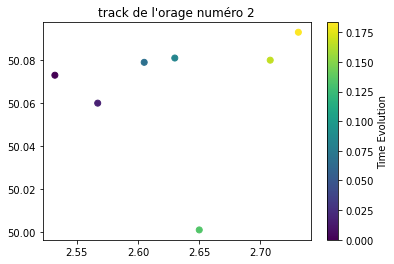

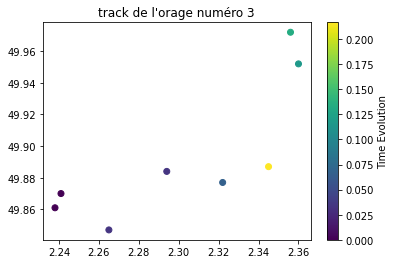

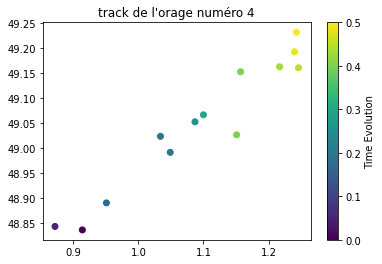

...

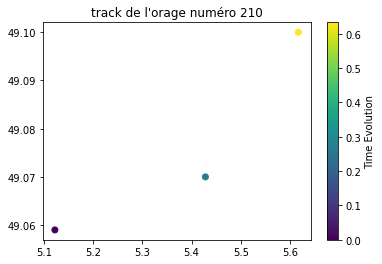

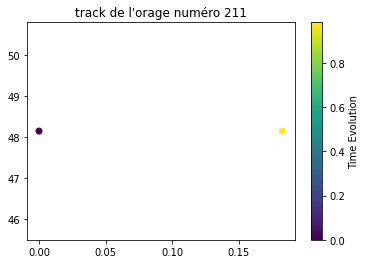

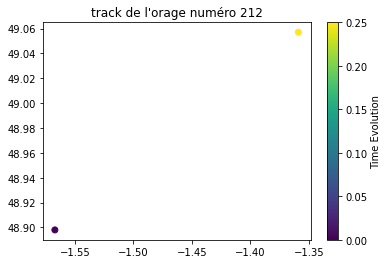

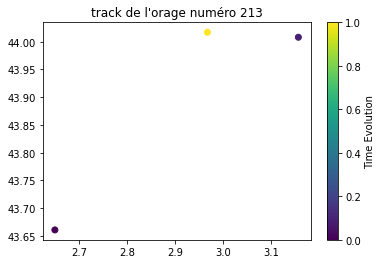

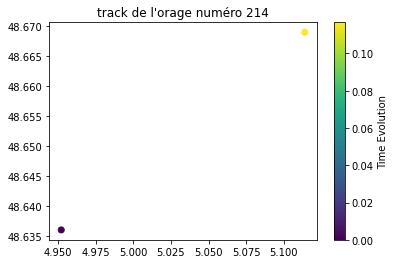

In [ ]:
plot_orages(visu_final)

In [ ]:
visu_final.to_csv('visu_results_v1.csv', index=False)

# 2ème test fusion

In [ ]:
poubelle_bis = visu_results[visu_results.CLASSI == -1]
poubelle_bis

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
26,138356.966667,49.502,1.586,-1
27,138356.7,48.333,1.933,-1
30,138356.416667,48.500,0.483,-1
46,138354.083333,48.183,-0.892,-1
55,138284.133333,47.231,0.253,-1
...,...,...,...,...
7268,133965.416667,46.817,-1.000,-1
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:

model_poub_2 = ST_DBSCAN(eps1=0.3, eps2=2,
                         min_samples=2)
model_poub_2.fit(poubelle_bis.iloc[:,:-1])
classi_poubelle_2 = model_poub_2.labels
visu_poub_2 = poubelle_bis.iloc[:,:-1].copy()
visu_poub_2['CLASSI'] = classi_poubelle_2
orages_poub_2 = cluster2(poubelle_bis.iloc[:,:-1],classi_poubelle_2)

In [ ]:

visu_poub_2

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
26,138356.966667,49.502,1.586,-1
27,138356.7,48.333,1.933,-1
30,138356.416667,48.500,0.483,-1
46,138354.083333,48.183,-0.892,-1
55,138284.133333,47.231,0.253,-1
...,...,...,...,...
7268,133965.416667,46.817,-1.000,-1
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,21
7309,133604.083333,48.636,4.952,21


In [ ]:
l_poub_2 = np.unique(classi_poubelle_2)
l_poub_2

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21])

In [ ]:
visu_results_ter = visu_results.copy()

In [ ]:
max_new_clusters = max(visu_poub_2.CLASSI)
nbr_clusters = max(visu_results_ter.CLASSI)
for i in range(max_new_clusters+1):
  indices = visu_poub_2[visu_poub_2.CLASSI == i].index
  for e in indices:
    visu_results_ter.loc[e,'CLASSI'] = nbr_clusters + 1 + i

In [ ]:
visu_results_ter

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,181
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,203
7309,133604.083333,48.636,4.952,203


25%
50%
75%


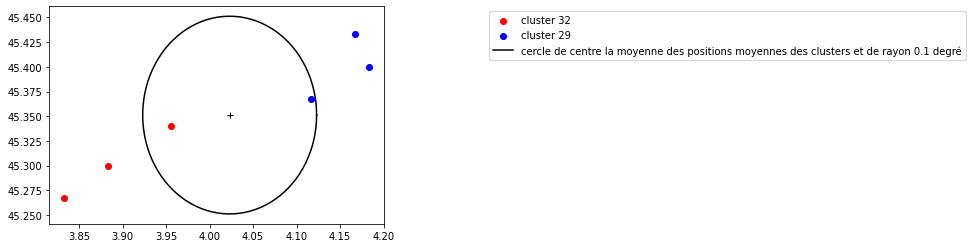

        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
977  136746.333333    45.400      4.183      29
978      136746.25    45.433      4.167      29
982  136745.966667    45.367      4.117      29
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32


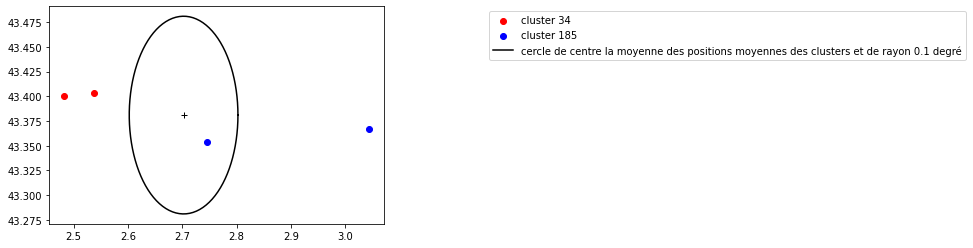

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1004  136727.916667    43.367      3.043     185
1005      136726.75    43.354      2.746     185
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34


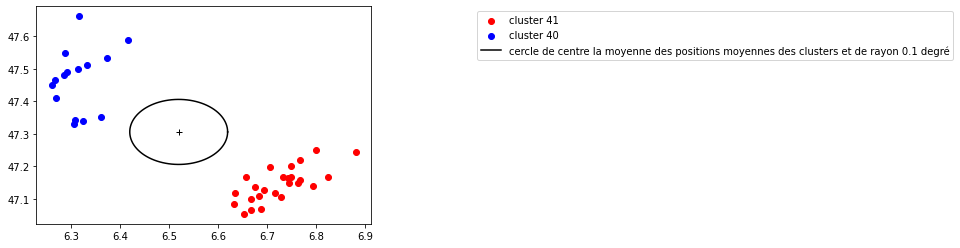

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1645  136077.283333    47.662      6.316      40
1656  136077.116667    47.589      6.416      40
1664      136077.05    47.549      6.288      40
1670       136077.0    47.535      6.374      40
1671  136076.966667    47.491      6.292      40
1672  136076.966667    47.501      6.314      40
1674      136076.95    47.511      6.333      40
1675  136076.916667    47.481      6.285      40
1677  136076.883333    47.449      6.260      40
1683  136076.833333    47.467      6.267      40
1692      136076.75    47.409      6.269      40
1705       136076.6    47.343      6.308      40
1706  136076.583333    47.351      6.361      40
1707  136076.583333    47.339      6.324      40
1708  136076.566667    47.332      6.306      40
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1684  136076.833333    47.244      6.882      41
1694      136076.75    47.168      6.825      41
1696  136076.716667    47.250      6.800      41
1697  136076.666667 

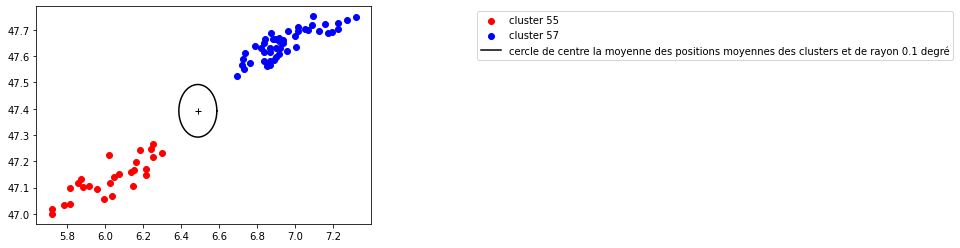

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3237       135507.0    47.749      7.319      57
3246  135506.916667    47.736      7.271      57
3249  135506.866667    47.704      7.224      57
3250  135506.866667    47.727      7.226      57
3252  135506.833333    47.692      7.192      57
3254  135506.816667    47.689      7.171      57
3255       135506.8    47.723      7.154      57
3256  135506.783333    47.752      7.092      57
3259  135506.766667    47.700      7.067      57
3260      135506.75    47.712      7.015      57
3264      135506.75    47.694      7.122      57
3265  135506.733333    47.717      7.089      57
3268  135506.683333    47.702      7.051      57
3270  135506.666667    47.675      6.998      57
3271  135506.666667    47.697      6.959      57
3272      135506.65    47.650      6.933      57
3274      135506.65    47.635      7.004      57
3275  135506.633333    47.696      7.012      57
3279  135506.616667    47.621      6.958      57
3280  135506.583333 

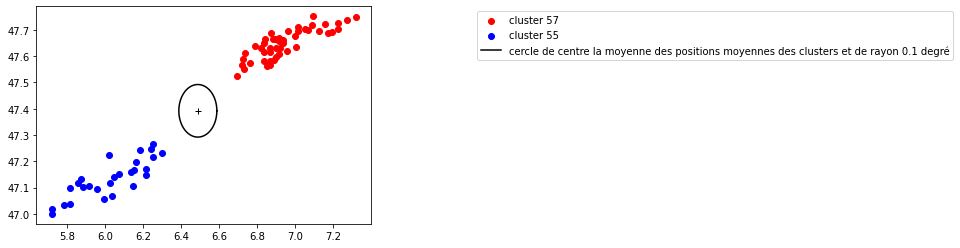

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3235       135507.0    47.217      6.250      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3240  135506.983333    47.267      6.250      55
3241  135506.966667    47.107      6.145      55
3242  135506.966667    47.147      6.215      55
3243      135506.95    47.243      6.180      55
3244      135506.95    47.199      6.159      55
3247       135506.9    47.167      6.150      55
3248  135506.883333    47.158      6.137      55
3251  135506.833333    47.152      6.069      55
3257  135506.783333    47.142      6.046      55
3258  135506.783333    47.117      6.025      55
3261      135506.75    47.067      6.033      55
3262      135506.75    47.226      6.020      55
3263      135506.75    47.056      5.993      55
3266       135506.7    47.093      5.956      55
3269  135506.683333    47.108      5.914      55
3273      135506.65 

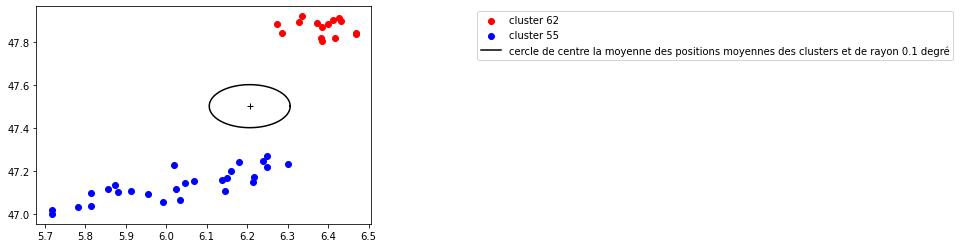

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3235       135507.0    47.217      6.250      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3240  135506.983333    47.267      6.250      55
3241  135506.966667    47.107      6.145      55
3242  135506.966667    47.147      6.215      55
3243      135506.95    47.243      6.180      55
3244      135506.95    47.199      6.159      55
3247       135506.9    47.167      6.150      55
3248  135506.883333    47.158      6.137      55
3251  135506.833333    47.152      6.069      55
3257  135506.783333    47.142      6.046      55
3258  135506.783333    47.117      6.025      55
3261      135506.75    47.067      6.033      55
3262      135506.75    47.226      6.020      55
3263      135506.75    47.056      5.993      55
3266       135506.7    47.093      5.956      55
3269  135506.683333    47.108      5.914      55
3273      135506.65 

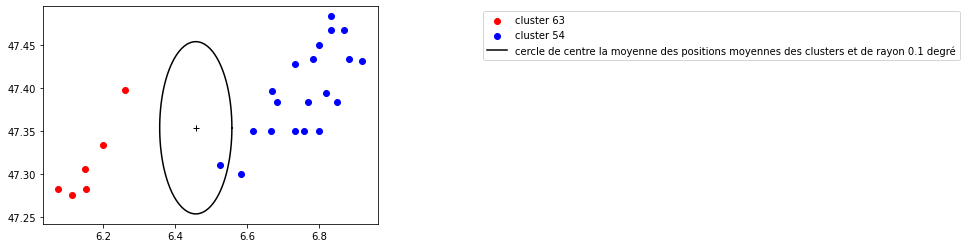

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3212  135507.833333    47.433      6.883      54
3213      135507.75    47.483      6.833      54
3214      135507.75    47.431      6.919      54
3215  135507.733333    47.467      6.867      54
3216       135507.7    47.433      6.783      54
3217  135507.683333    47.467      6.833      54
3218  135507.666667    47.384      6.849      54
3219      135507.65    47.394      6.817      54
3220  135507.616667    47.350      6.800      54
3221       135507.6    47.383      6.767      54
3222  135507.583333    47.350      6.757      54
3223  135507.566667    47.450      6.800      54
3224      135507.55    47.350      6.733      54
3225      135507.55    47.427      6.731      54
3226       135507.5    47.383      6.683      54
3227       135507.5    47.396      6.668      54
3228  135507.466667    47.350      6.617      54
3229      135507.45    47.350      6.667      54
3230  135507.416667    47.300      6.583      54
3231  135507.333333 

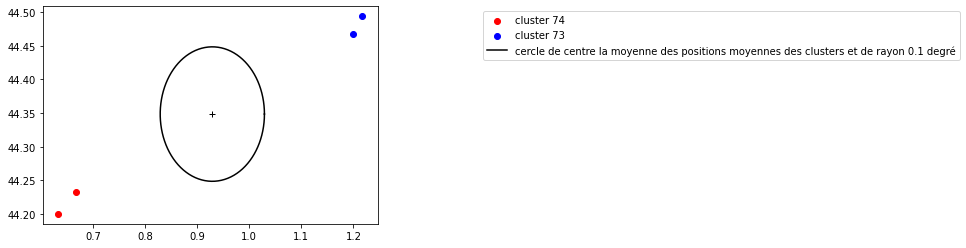

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74


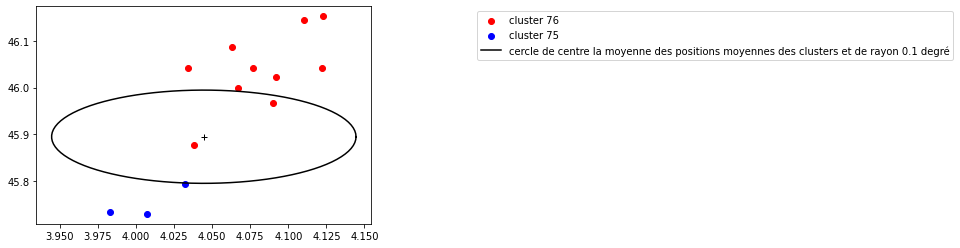

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3638       135406.0    45.793      4.032      75
3640      135405.75    45.729      4.007      75
3641  135405.716667    45.733      3.983      75
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3645  135404.866667    46.153      4.123      76
3647  135404.833333    46.146      4.110      76
3650      135404.75    46.086      4.063      76
3651  135404.666667    46.041      4.077      76
3652  135404.666667    46.041      4.122      76
3654  135404.633333    46.043      4.034      76
3656  135404.583333    46.022      4.092      76
3658  135404.516667    46.000      4.067      76
3660  135404.416667    45.966      4.090      76
3666      135404.25    45.877      4.038      76


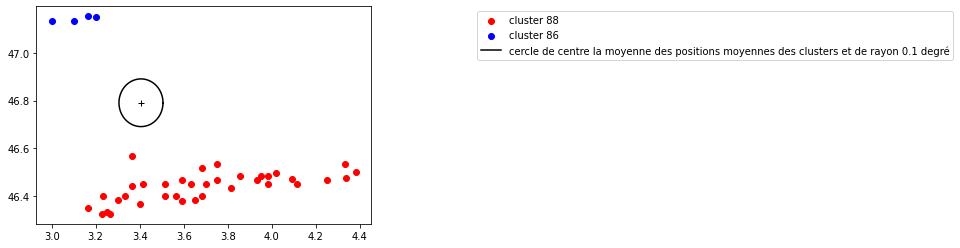

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3787  135383.716667    47.150      3.200      86
3788  135383.683333    47.154      3.167      86
3789  135383.666667    47.133      3.100      86
3803      135383.45    47.133      3.000      86
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667 

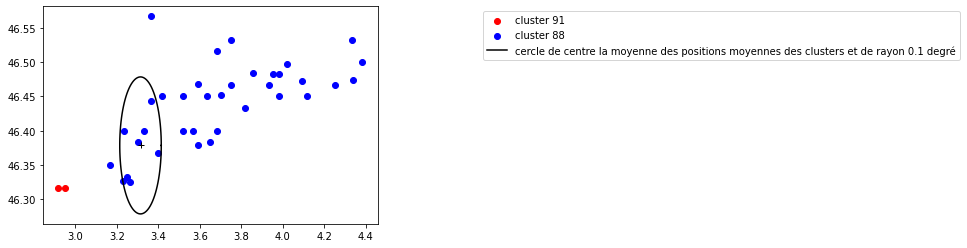

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0    46.533      3.750      88
3877       135381.0    46.452      3.703      88
3884      135380.95    46.567      3.367      88
3886  135380.933333 

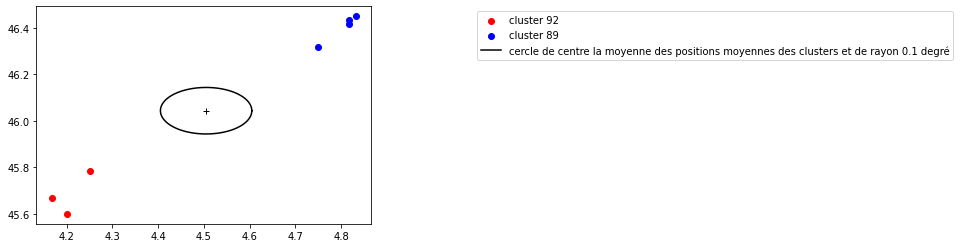

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92


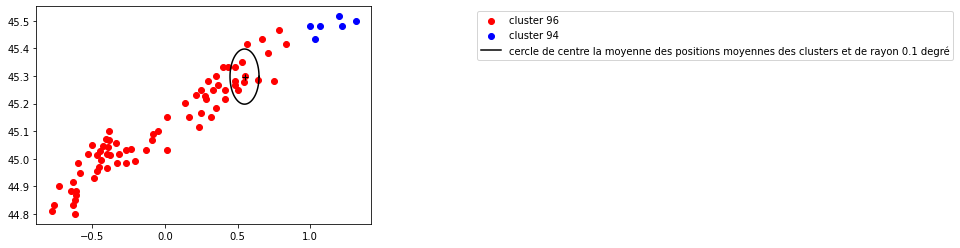

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      94
3958  135363.433333    45.517      1.200      94
3959  135363.416667    45.483      1.217      94
3968  135363.166667    45.483      1.067      94
3969  135363.133333    45.433      1.033      94
3970  135363.083333    45.483      1.000      94
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


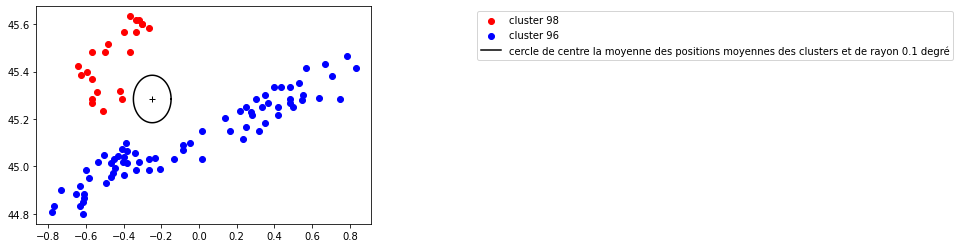

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      

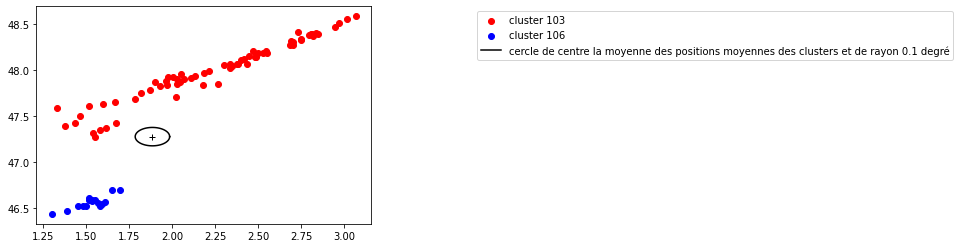

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4261      135338.95    48.583      3.067     103
4262  135338.916667    48.555      3.015     103
4263      135338.85 

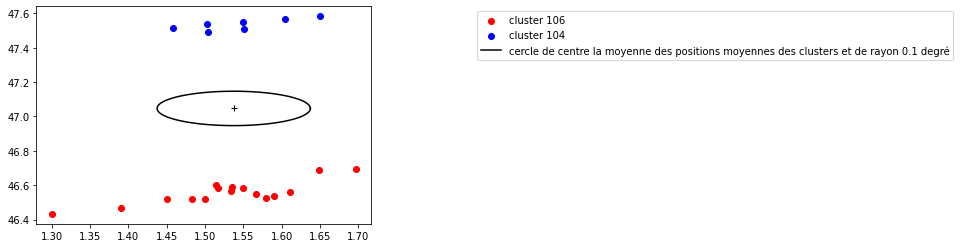

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333 

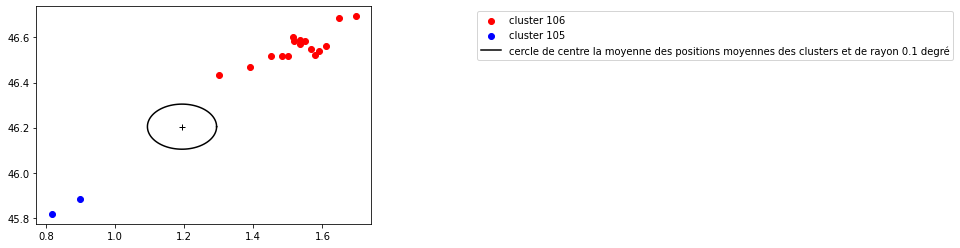

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106


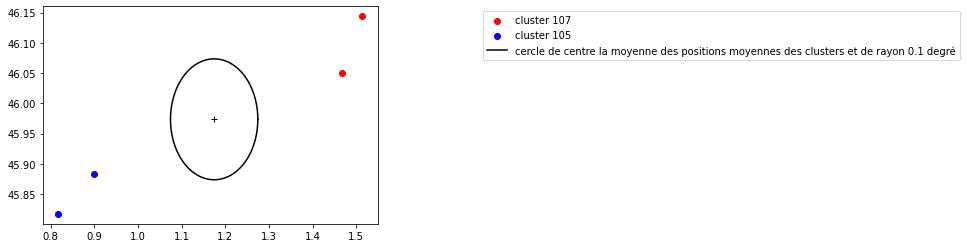

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4297      135337.95    46.144      1.514     107
4317  135337.683333    46.050      1.467     107


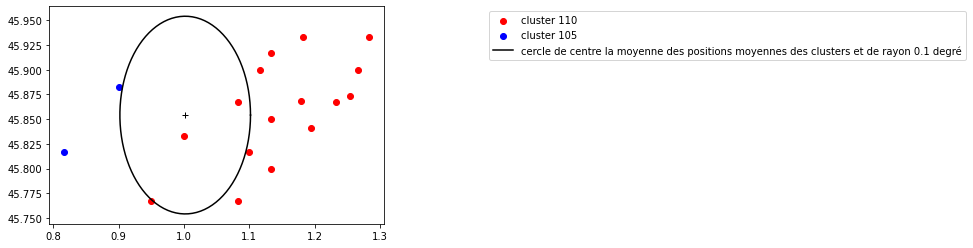

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110


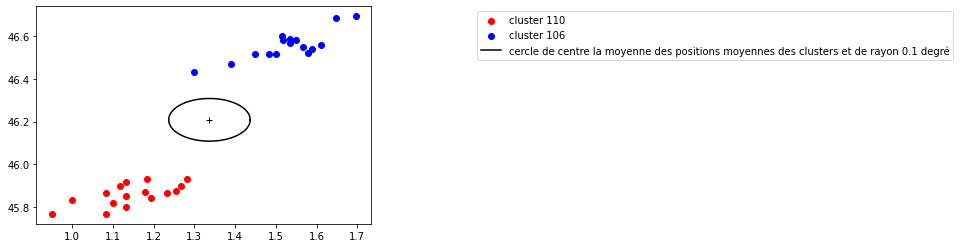

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333 

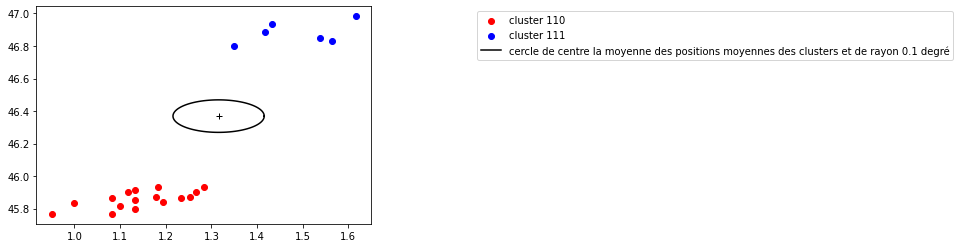

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333 

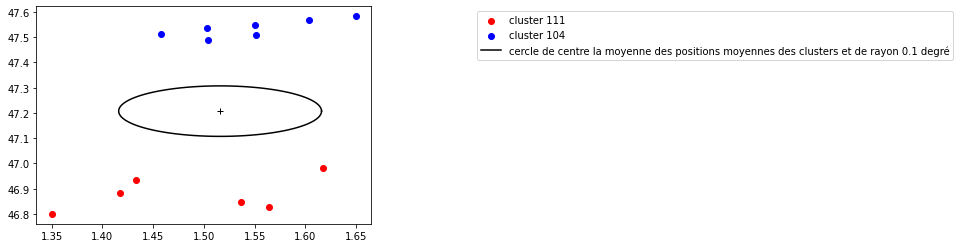

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111


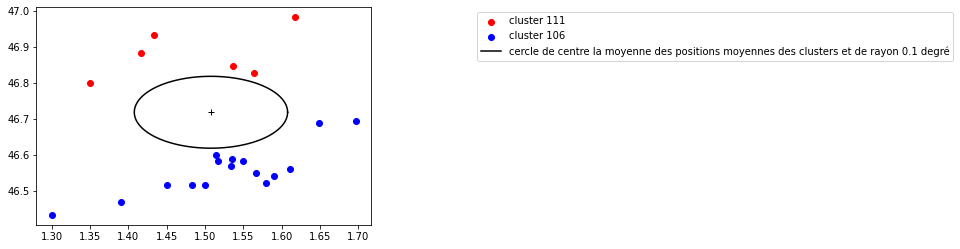

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

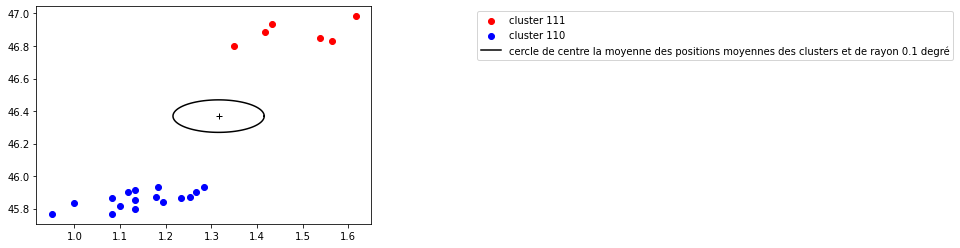

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

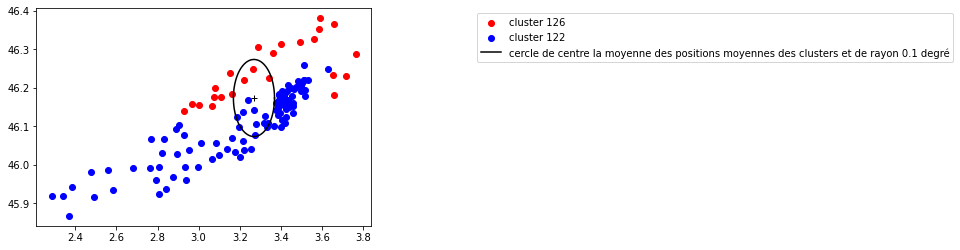

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     1

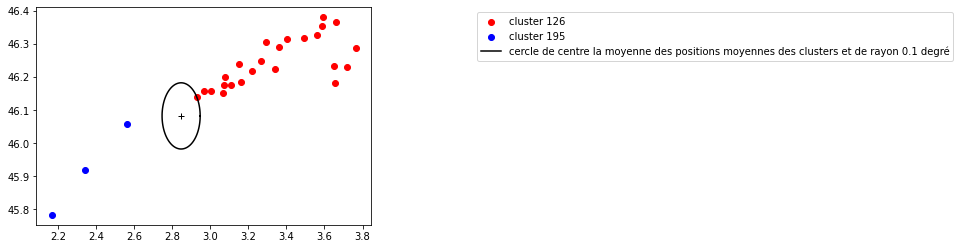

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5264   134976.7    45.783      2.168     195
5316   134975.5    46.059      2.562     195
5325  134975.25    45.919      2.341     195
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3

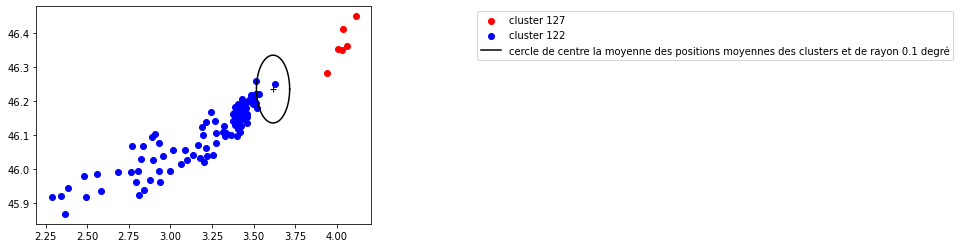

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


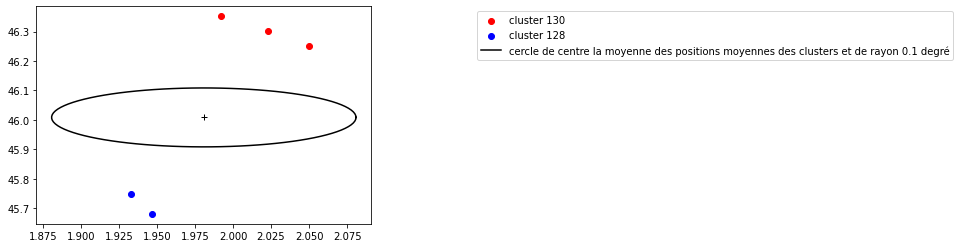

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130


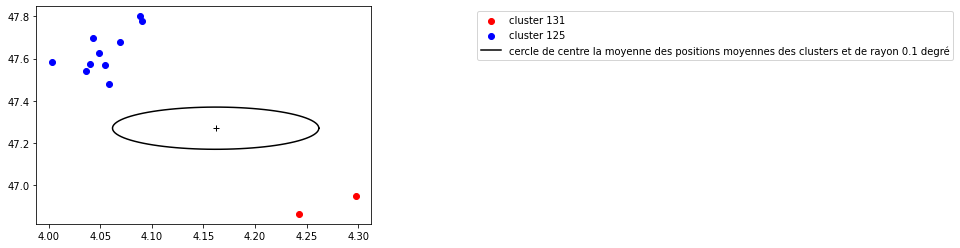

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


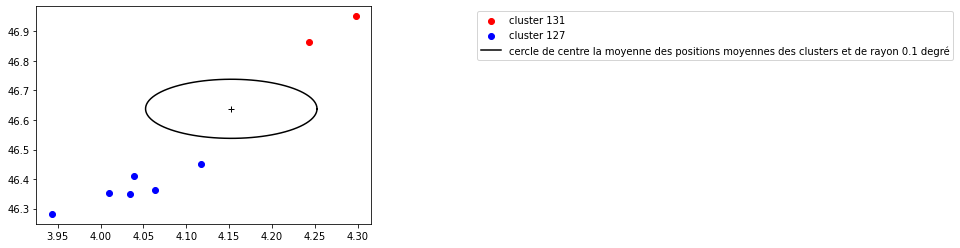

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


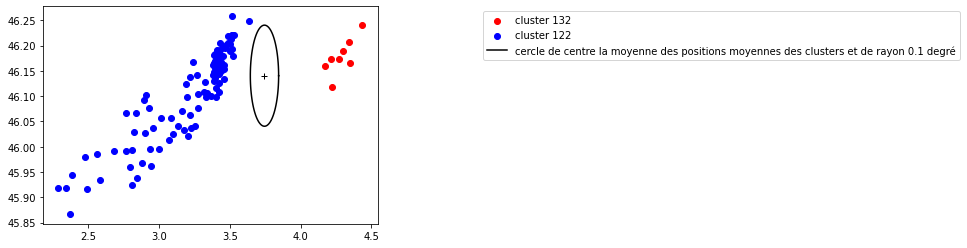

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     1

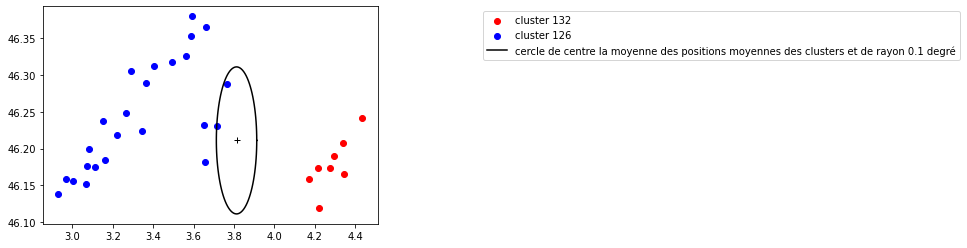

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.199      3.080     126
5279      134976.35    46.176      3.074     126
5281  134976.333333    46.231      3.718     126
5282  134976.283333 

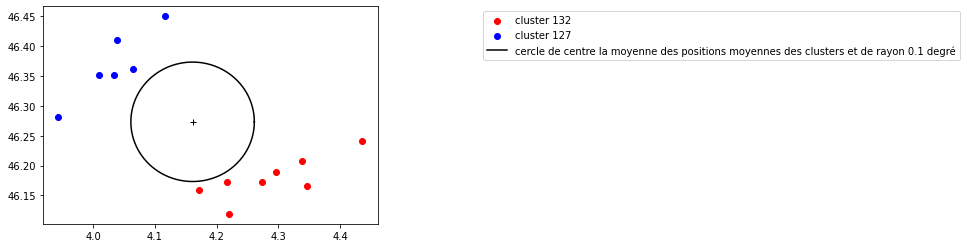

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


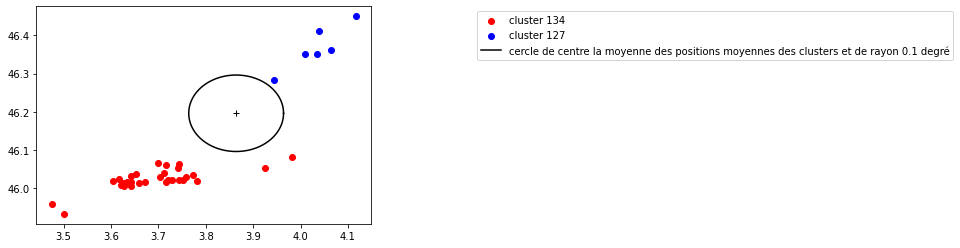

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333 

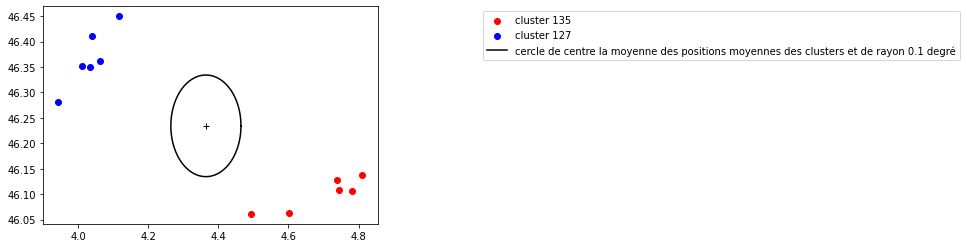

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135


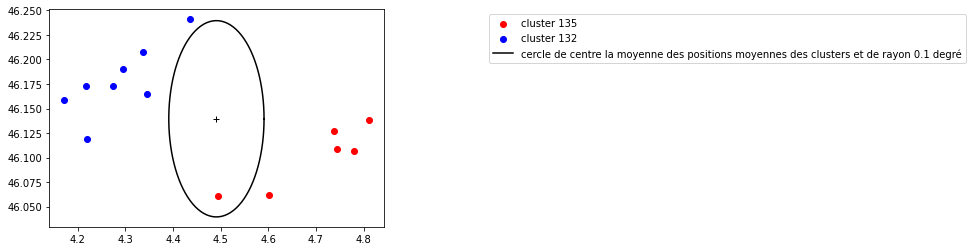

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135


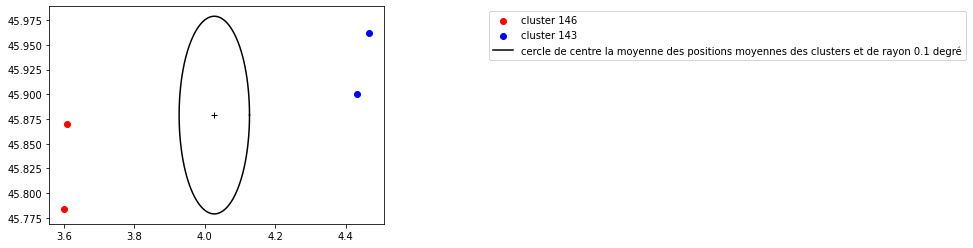

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


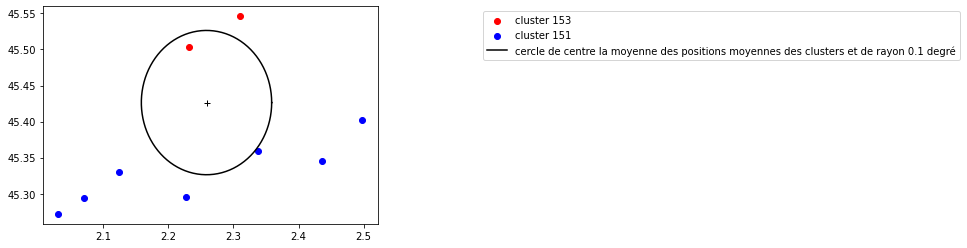

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5559  134928.916667    45.402      2.498     151
5565  134928.716667    45.345      2.436     151
5567       134928.5    45.359      2.338     151
5568      134928.35    45.295      2.228     151
5576      134927.95    45.294      2.071     151
5578  134927.916667    45.272      2.031     151
5579  134927.916667    45.330      2.124     151
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5601       134927.0    45.546      2.310     153
5605  134926.916667    45.503      2.232     153


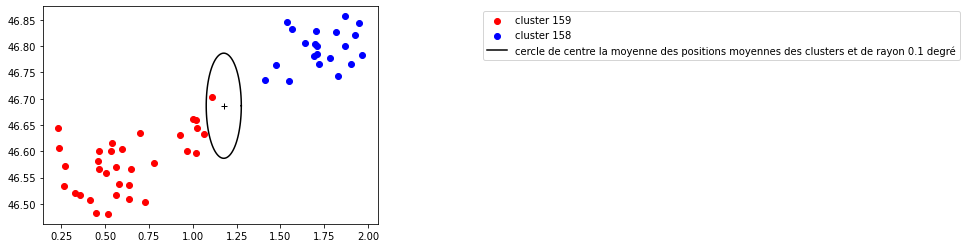

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6484  134667.416667    46.844      1.947     158
6485  134667.333333    46.857      1.865     158
6486  134667.216667    46.783      1.967     158
6487       134667.2    46.743      1.830     158
6488       134667.2    46.822      1.924     158
6489  134667.166667    46.827      1.817     158
6490  134667.166667    46.767      1.900     158
6491      134667.15    46.800      1.867     158
6492  134667.083333    46.778      1.784     158
6493       134667.0    46.804      1.695     158
6494       134667.0    46.828      1.704     158
6495       134667.0    46.786      1.711     158
6496       134667.0    46.801      1.710     158
6497  134666.983333    46.767      1.717     158
6498  134666.966667    46.781      1.693     158
6499      134666.95    46.847      1.538     158
6500      134666.95    46.806      1.639     158
6501      134666.95    46.833      1.567     158
6503  134666.766667    46.733      1.550     158
6505       134666.7 

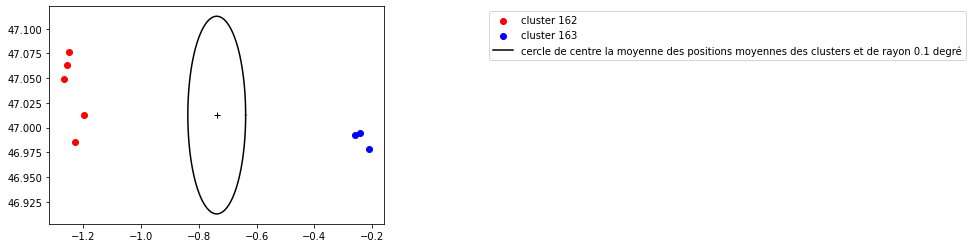

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162


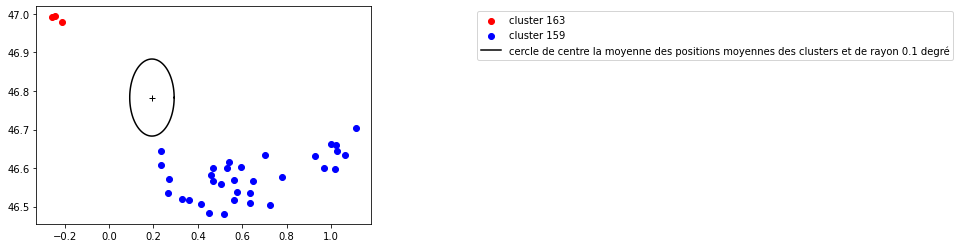

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

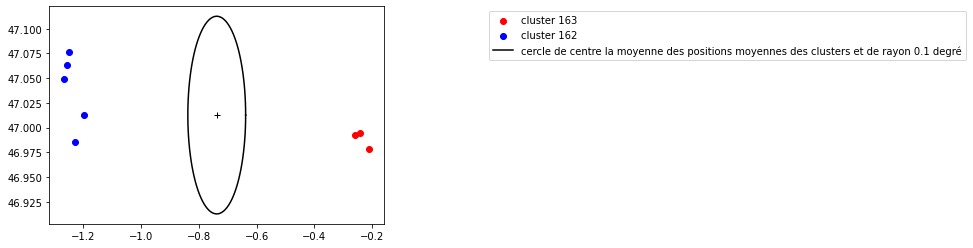

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163


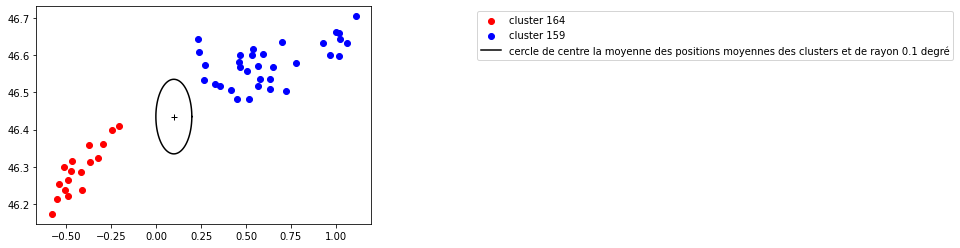

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

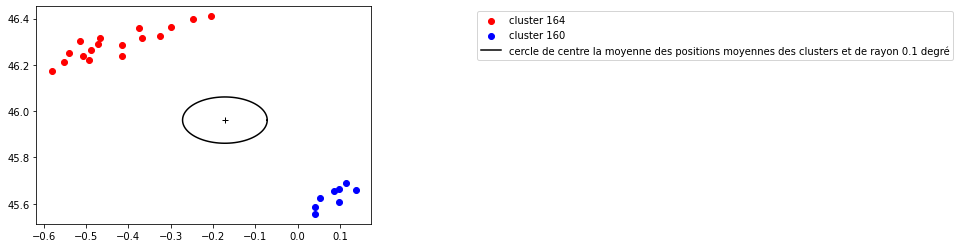

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333 

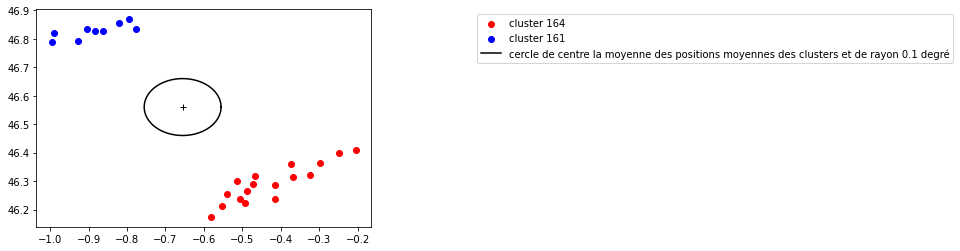

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333 

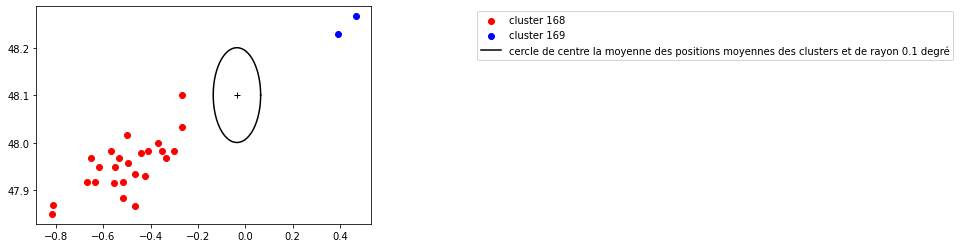

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15 

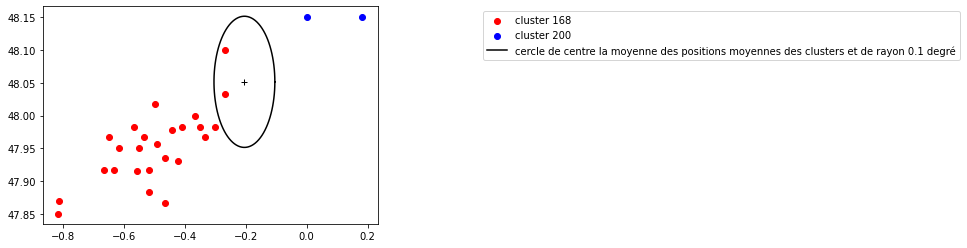

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6728  134605.766667     48.15      0.183     200
6737  134604.783333     48.15      0.000     200
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15 

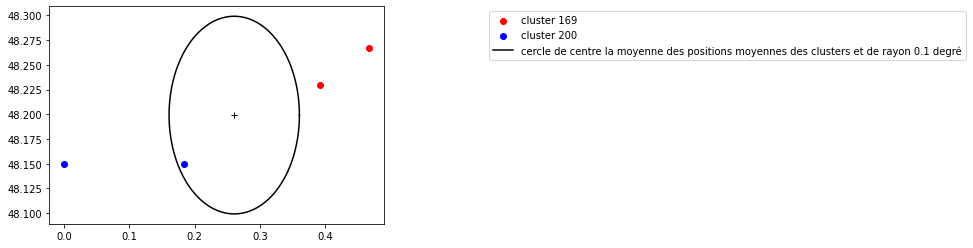

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6728  134605.766667     48.15      0.183     200
6737  134604.783333     48.15      0.000     200
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169


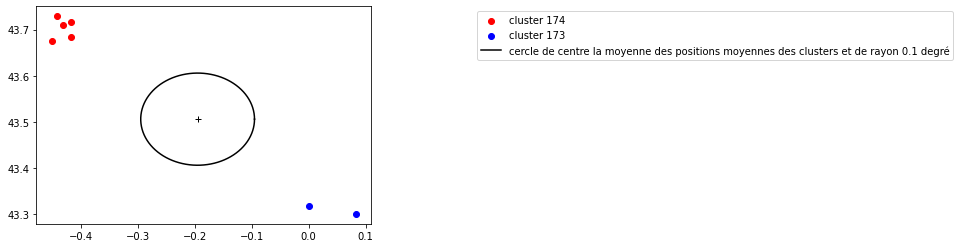

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6952       134496.4    43.300      0.083     173
6953  134496.183333    43.317      0.000     173
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174


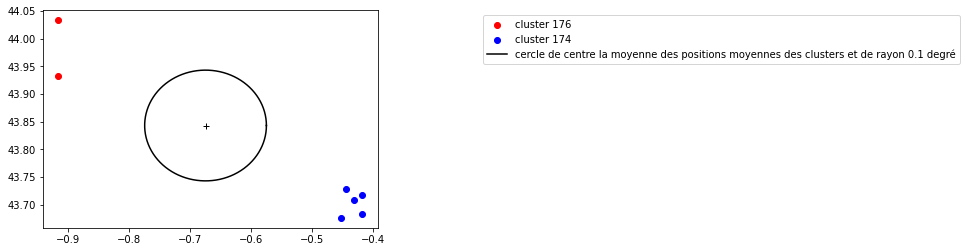

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6972  134493.666667    43.933     -0.917     176
6979       134493.2    44.033     -0.917     176


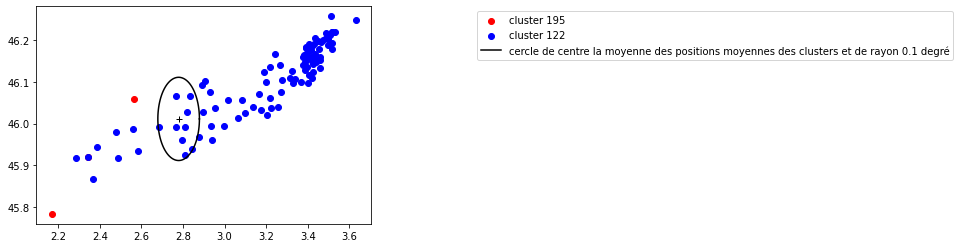

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5264   134976.7    45.783      2.168     195
5316   134975.5    46.059      2.562     195
5325  134975.25    45.919      2.341     195


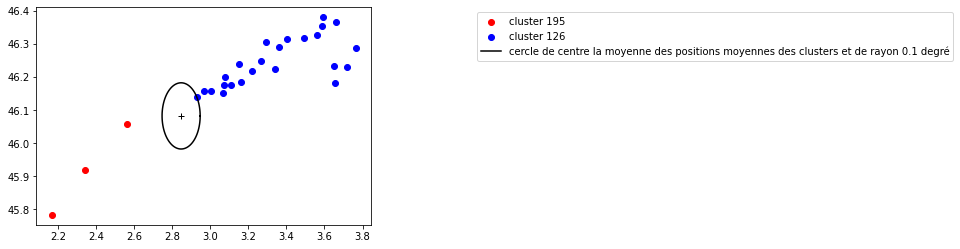

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.199      3.080     126
5279      134976.35    46.176      3.074     126
5281  134976.333333    46.231      3.718     126
5282  134976.283333 

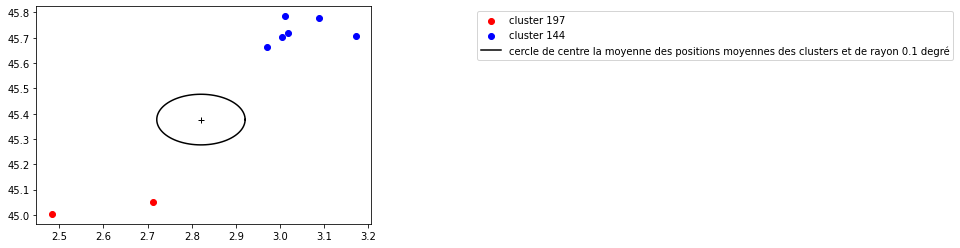

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5523  134951.016667    45.052      2.712     197
5527  134950.583333    45.004      2.483     197


In [ ]:
pipe_fusion_FR_time(visu_results_ter,3)

In [ ]:
def condition_densite_poubelle(visu_results,rapport,cluster1,seuil_densite = 70,c = 0.1):

  orage = visu_results[visu_results.CLASSI == cluster1]
  lat_mean = (orage.describe().iloc[1,0] + rapport[1])/2
  long_mean = (orage.describe().iloc[1,1] + rapport[2])/2

  # on définit un carré autour de notre position moyenne 

  lat_mean_up,lat_mean_down = lat_mean+c,lat_mean-c
  long_mean_up,long_mean_down = long_mean+c,long_mean-c

  # on réduit la taille du dataset démog en sélectionnant les carreaux proches de notre position moyenne entre orages

  demog_2 = demog_use[(demog_use.Latitude < lat_mean_up) & (demog_use.Latitude > lat_mean_down) & (demog_use.Longitude < long_mean_up) & (demog_use.Longitude > long_mean_down)]

  densite_moyenne = demog_2['Ind'].mean() #mean de Ind

  return densite_moyenne < seuil_densite

In [ ]:
#prendre point le plus proche
#distance avec centr mais pondérée par taille orage

In [ ]:
def fusion_poubelle(visu_results):
  trash = visu_results[visu_results.CLASSI == -1]
  n = len(trash)
  candidats = []
  for i in range(n):
    candi = []
    rapport = trash.iloc[i,:]
    time_event = rapport[0]
    time_low,time_high = time_event-3,time_event+3 #condition de temps validée
    possibles = visu_results[(visu_results.TIME_EVENT > time_low) &  (visu_results.TIME_EVENT < time_high)]
    clusters_ = np.array(np.unique(possibles.CLASSI.values))
    clusters_poss = clusters_[clusters_ > -1]
    for j in clusters_poss:
      if distance_cluster_rapport(visu_results,rapport,j,'moyenne')<1:
        if condition_densite_poubelle(visu_results,rapport,j):
          candi.append(j)
    if candi != []:
      a = [i,candi]
      candidats.append(a)
  return candidats

In [ ]:
#on regarde si certaines observations du cluster poubelle peuvent être ajoutées à des orages

In [ ]:
fusion_poub_2 = fusion_poubelle(visu_results_ter)

In [ ]:
fusion_poub_2

[[0, [1]],
 [2, [4, 5]],
 [4, [8]],
 [11, [12]],
 [13, [182]],
 [33, [30]],
 [34, [32]],
 [42, [37]],
 [43, [37]],
 [49, [48, 51]],
 [52, [50]],
 [57, [60]],
 [59, [65]],
 [60, [65]],
 [62, [70]],
 [64, [72]],
 [65, [73, 74]],
 [66, [73, 74]],
 [69, [88, 90]],
 [71, [94, 96, 98]],
 [72, [96, 98, 100, 101]],
 [73, [95]],
 [74, [97]],
 [75, [100, 101]],
 [78, [107, 110]],
 [79, [113]],
 [86, [125]],
 [87, [127, 193, 194]],
 [88, [121]],
 [89, [122, 126, 127, 131, 132, 134, 194]],
 [91, [125, 131]],
 [93, [125, 127, 131, 194]],
 [94, [129]],
 [95, [127, 132, 134, 194]],
 [96, [133]],
 [97, [131, 135]],
 [98, [134]],
 [100, [140]],
 [102, [140]],
 [103, [144]],
 [104, [145]],
 [105, [144, 197]],
 [106, [145]],
 [108, [145, 148]],
 [109, [147]],
 [110, [148, 150]],
 [111, [148]],
 [112, [148]],
 [119, [161, 163, 164]],
 [121, [160, 163]],
 [123, [160]],
 [125, [166, 167]],
 [134, [175, 179]],
 [138, [202]]]

In [ ]:
def plot_cluster_rapport(visu_results,cluster,rapport):
  orage = visu_results[visu_results.CLASSI == cluster]
  ## on trace l'orage et sa trajectoire régressée
  temps = [orage.iloc[i,0] - orage.iloc[-1,0] for i in range(len(orage))]
  plt.scatter(orage.LONGITUDE,orage.LATITUDE,c = temps, label = 'cluster candidat '+str(cluster))
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.scatter(rapport[2],rapport[1],marker ='x', linewidth = 3,color = 'red',label = 'rapport poubelle')
  plt.legend()
  plt.show()

In [ ]:
def plot_cluster_rapport_all(visu_results,trash):
  poubelle = visu_results[visu_results.CLASSI == -1]
  n = len(trash)
  for i in range(n):
    report_index = trash[i][0]
    candi = trash[i][1]
    print("ON TESTE LE RAPPORT D'INDICE",report_index,"DANS LE CLUSTER POUBELLE")
    for j in candi:
      plot_cluster_rapport(visu_results,j,poubelle.iloc[report_index,:])
      print('rapport dans poubelle',poubelle.iloc[report_index,:])
      print(visu_results[visu_results.CLASSI == j])

ON TESTE LE RAPPORT D'INDICE 0 DANS LE CLUSTER POUBELLE


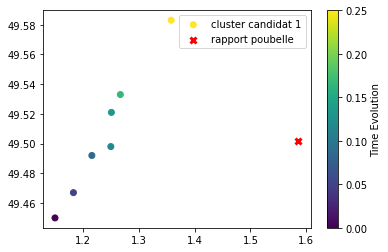

rapport dans poubelle TIME_EVENT    138356.966667
LATITUDE             49.502
LONGITUDE             1.586
CLASSI                   -1
Name: 26, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4   138358.416667    49.583      1.358       1
5   138358.333333    49.533      1.267       1
6        138358.3    49.521      1.251       1
7   138358.283333    49.498      1.250       1
8       138358.25    49.492      1.216       1
9   138358.216667    49.467      1.183       1
10  138358.166667    49.450      1.150       1
ON TESTE LE RAPPORT D'INDICE 2 DANS LE CLUSTER POUBELLE


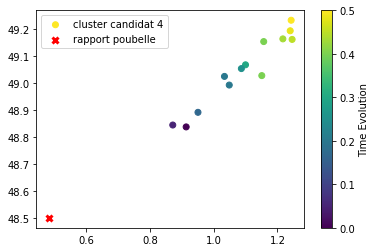

rapport dans poubelle TIME_EVENT    138356.416667
LATITUDE               48.5
LONGITUDE             0.483
CLASSI                   -1
Name: 30, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
28  138356.466667    49.232      1.243       4
29      138356.45    49.193      1.240       4
31  138356.416667    49.161      1.246       4
32       138356.4    49.163      1.217       4
33  138356.366667    49.153      1.157       4
34  138356.366667    49.027      1.151       4
35  138356.266667    49.067      1.100       4
36  138356.216667    49.053      1.087       4
37  138356.166667    49.024      1.034       4
38  138356.166667    48.992      1.049       4
39  138356.133333    48.891      0.951       4
40  138356.016667    48.844      0.872       4
41  138355.966667    48.837      0.914       4


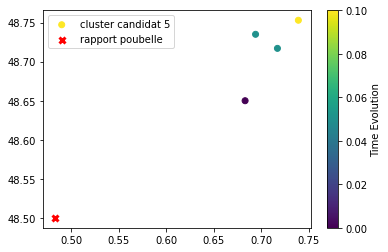

rapport dans poubelle TIME_EVENT    138356.416667
LATITUDE               48.5
LONGITUDE             0.483
CLASSI                   -1
Name: 30, dtype: object
   TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
42  138355.75    48.753      0.739       5
43   138355.7    48.735      0.694       5
44   138355.7    48.717      0.717       5
45  138355.65    48.650      0.683       5
ON TESTE LE RAPPORT D'INDICE 4 DANS LE CLUSTER POUBELLE


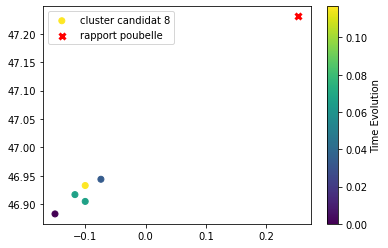

rapport dans poubelle TIME_EVENT    138284.133333
LATITUDE             47.231
LONGITUDE             0.253
CLASSI                   -1
Name: 55, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
56       138283.5    46.933     -0.100       8
57      138283.45    46.905     -0.100       8
58      138283.45    46.917     -0.117       8
59  138283.416667    46.944     -0.074       8
60  138283.383333    46.883     -0.150       8
ON TESTE LE RAPPORT D'INDICE 11 DANS LE CLUSTER POUBELLE


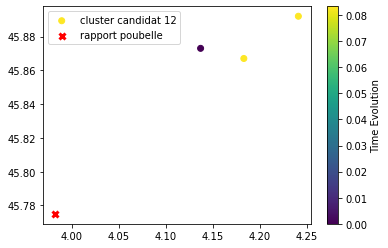

rapport dans poubelle TIME_EVENT    137252.666667
LATITUDE             45.775
LONGITUDE             3.982
CLASSI                   -1
Name: 404, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
401      137252.75    45.867      4.183      12
402      137252.75    45.892      4.241      12
403  137252.666667    45.873      4.137      12
ON TESTE LE RAPPORT D'INDICE 13 DANS LE CLUSTER POUBELLE


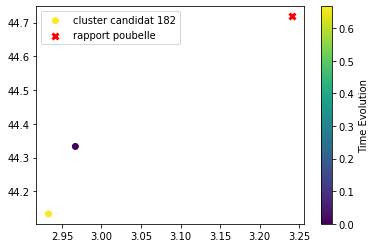

rapport dans poubelle TIME_EVENT    137228.75
LATITUDE         44.719
LONGITUDE         3.241
CLASSI               -1
Name: 433, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
429  137229.416667    44.133      2.933     182
432      137228.75    44.333      2.967     182
ON TESTE LE RAPPORT D'INDICE 33 DANS LE CLUSTER POUBELLE


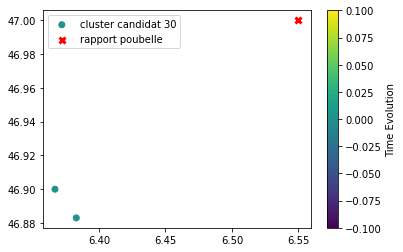

rapport dans poubelle TIME_EVENT    136746.483333
LATITUDE               47.0
LONGITUDE              6.55
CLASSI                   -1
Name: 976, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
980  136746.066667    46.900      6.367      30
981  136746.066667    46.883      6.383      30
ON TESTE LE RAPPORT D'INDICE 34 DANS LE CLUSTER POUBELLE


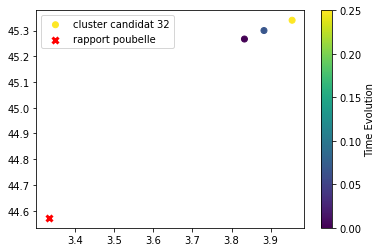

rapport dans poubelle TIME_EVENT    136745.416667
LATITUDE             44.572
LONGITUDE             3.332
CLASSI                   -1
Name: 990, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32
ON TESTE LE RAPPORT D'INDICE 42 DANS LE CLUSTER POUBELLE


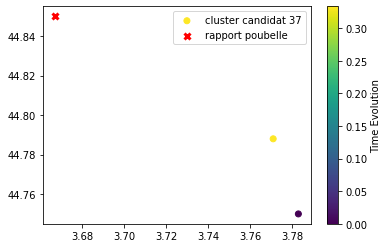

rapport dans poubelle TIME_EVENT    136459.416667
LATITUDE              44.85
LONGITUDE             3.667
CLASSI                   -1
Name: 1224, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1226      136458.25    44.788      3.771      37
1227  136457.916667    44.750      3.783      37
ON TESTE LE RAPPORT D'INDICE 43 DANS LE CLUSTER POUBELLE


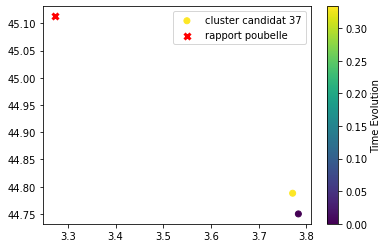

rapport dans poubelle TIME_EVENT    136459.333333
LATITUDE             45.113
LONGITUDE             3.273
CLASSI                   -1
Name: 1225, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1226      136458.25    44.788      3.771      37
1227  136457.916667    44.750      3.783      37
ON TESTE LE RAPPORT D'INDICE 49 DANS LE CLUSTER POUBELLE


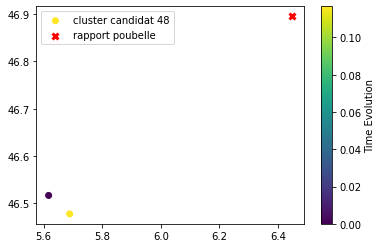

rapport dans poubelle TIME_EVENT    135596.166667
LATITUDE             46.895
LONGITUDE             6.449
CLASSI                   -1
Name: 2725, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2713      135596.45    46.478      5.689      48
2717  135596.333333    46.517      5.617      48


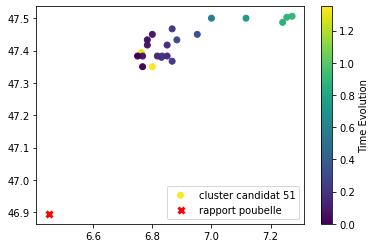

rapport dans poubelle TIME_EVENT    135596.166667
LATITUDE             46.895
LONGITUDE             6.449
CLASSI                   -1
Name: 2725, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2759  135595.783333    47.350      6.800      51
2762      135595.75    47.394      6.763      51
2780  135595.333333    47.506      7.273      51
2781  135595.316667    47.503      7.255      51
2782       135595.3    47.487      7.241      51
2785  135595.166667    47.500      7.117      51
2787       135595.0    47.500      7.000      51
2795  135594.766667    47.450      6.952      51
2797      135594.75    47.433      6.883      51
2798  135594.666667    47.367      6.867      51
2799  135594.666667    47.383      6.833      51
2800  135594.666667    47.467      6.867      51
2801      135594.65    47.379      6.831      51
2802  135594.616667    47.383      6.850      51
2803  135594.616667    47.417      6.850      51
2804  135594.583333    47.383      6.817      51
2808  1

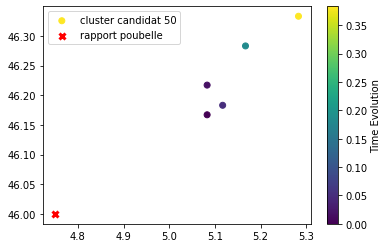

rapport dans poubelle TIME_EVENT    135595.0
LATITUDE          46.0
LONGITUDE         4.75
CLASSI              -1
Name: 2788, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2755  135595.883333    46.333      5.283      50
2766  135595.683333    46.283      5.167      50
2775      135595.55    46.183      5.117      50
2776  135595.516667    46.217      5.083      50
2777       135595.5    46.167      5.083      50
ON TESTE LE RAPPORT D'INDICE 57 DANS LE CLUSTER POUBELLE


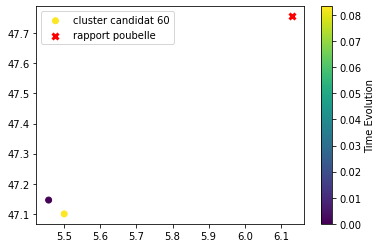

rapport dans poubelle TIME_EVENT    135504.466667
LATITUDE             47.756
LONGITUDE             6.131
CLASSI                   -1
Name: 3447, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3319      135506.25    47.100      5.500      60
3329  135506.166667    47.146      5.457      60
ON TESTE LE RAPPORT D'INDICE 59 DANS LE CLUSTER POUBELLE


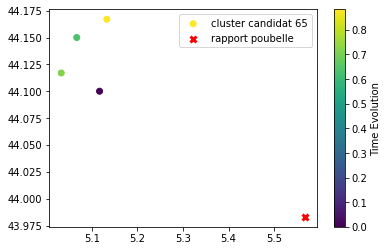

rapport dans poubelle TIME_EVENT    135448.15
LATITUDE         43.983
LONGITUDE         5.567
CLASSI               -1
Name: 3519, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3520  135447.666667    44.167      5.133      65
3521       135447.5    44.117      5.033      65
3522  135447.416667    44.150      5.067      65
3535  135446.783333    44.100      5.117      65
ON TESTE LE RAPPORT D'INDICE 60 DANS LE CLUSTER POUBELLE


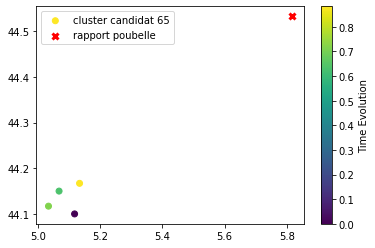

rapport dans poubelle TIME_EVENT    135447.0
LATITUDE        44.533
LONGITUDE        5.817
CLASSI              -1
Name: 3533, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3520  135447.666667    44.167      5.133      65
3521       135447.5    44.117      5.033      65
3522  135447.416667    44.150      5.067      65
3535  135446.783333    44.100      5.117      65
ON TESTE LE RAPPORT D'INDICE 62 DANS LE CLUSTER POUBELLE


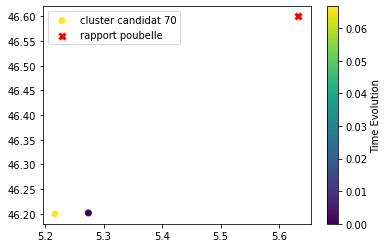

rapport dans poubelle TIME_EVENT    135428.383333
LATITUDE               46.6
LONGITUDE             5.633
CLASSI                   -1
Name: 3597, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3605       135427.3    46.200      5.217      70
3608  135427.233333    46.202      5.274      70
ON TESTE LE RAPPORT D'INDICE 64 DANS LE CLUSTER POUBELLE


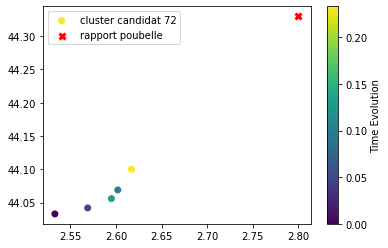

rapport dans poubelle TIME_EVENT    135426.166667
LATITUDE              44.33
LONGITUDE               2.8
CLASSI                   -1
Name: 3618, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3619       135426.0    44.100      2.617      72
3620       135425.9    44.056      2.595      72
3621  135425.866667    44.069      2.602      72
3622  135425.816667    44.042      2.569      72
3623  135425.766667    44.033      2.533      72
ON TESTE LE RAPPORT D'INDICE 65 DANS LE CLUSTER POUBELLE


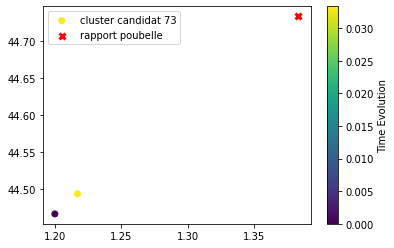

rapport dans poubelle TIME_EVENT    135424.35
LATITUDE         44.733
LONGITUDE         1.383
CLASSI               -1
Name: 3627, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73


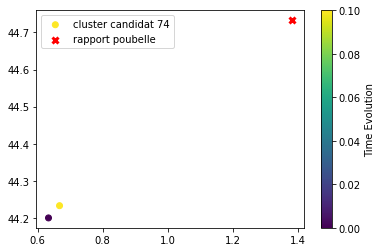

rapport dans poubelle TIME_EVENT    135424.35
LATITUDE         44.733
LONGITUDE         1.383
CLASSI               -1
Name: 3627, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74
ON TESTE LE RAPPORT D'INDICE 66 DANS LE CLUSTER POUBELLE


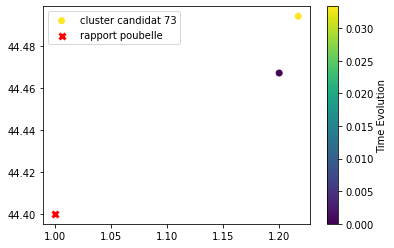

rapport dans poubelle TIME_EVENT    135423.266667
LATITUDE               44.4
LONGITUDE               1.0
CLASSI                   -1
Name: 3630, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73


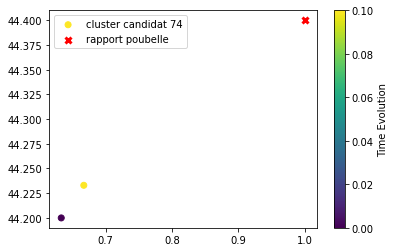

rapport dans poubelle TIME_EVENT    135423.266667
LATITUDE               44.4
LONGITUDE               1.0
CLASSI                   -1
Name: 3630, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74
ON TESTE LE RAPPORT D'INDICE 69 DANS LE CLUSTER POUBELLE


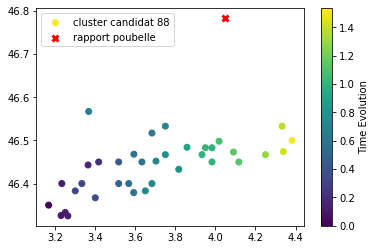

rapport dans poubelle TIME_EVENT    135381.366667
LATITUDE             46.783
LONGITUDE              4.05
CLASSI                   -1
Name: 3849, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876   

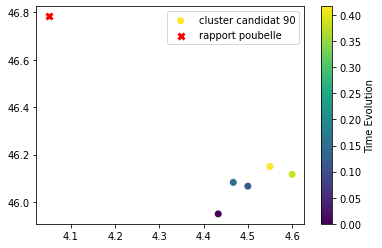

rapport dans poubelle TIME_EVENT    135381.366667
LATITUDE             46.783
LONGITUDE              4.05
CLASSI                   -1
Name: 3849, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3908      135380.45    46.150      4.550      90
3912  135380.416667    46.117      4.600      90
3915  135380.183333    46.083      4.467      90
3917      135380.15    46.067      4.500      90
3919  135380.033333    45.950      4.433      90
ON TESTE LE RAPPORT D'INDICE 71 DANS LE CLUSTER POUBELLE


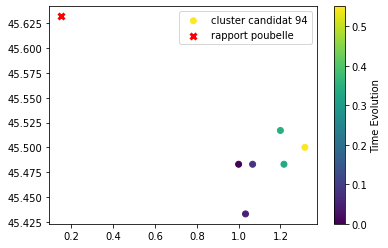

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      94
3958  135363.433333    45.517      1.200      94
3959  135363.416667    45.483      1.217      94
3968  135363.166667    45.483      1.067      94
3969  135363.133333    45.433      1.033      94
3970  135363.083333    45.483      1.000      94


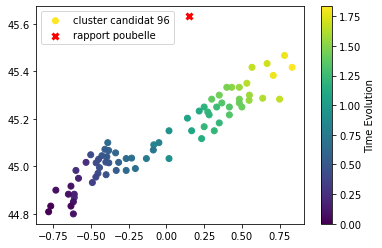

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


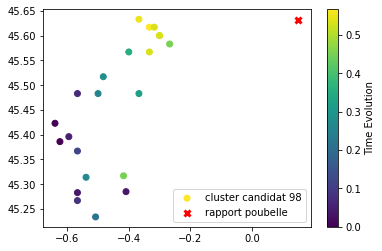

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

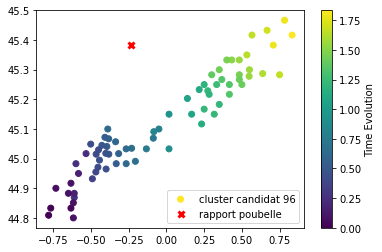

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


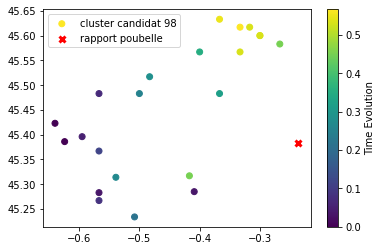

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

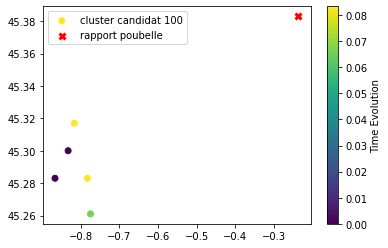

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4132  135360.166667    45.317     -0.817     100
4133  135360.166667    45.283     -0.783     100
4134      135360.15    45.261     -0.775     100
4136  135360.083333    45.300     -0.833     100
4137  135360.083333    45.283     -0.867     100


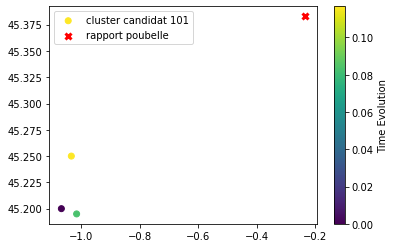

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4138  135360.033333    45.250     -1.033     101
4139       135360.0    45.195     -1.015     101
4143  135359.916667    45.200     -1.067     101
ON TESTE LE RAPPORT D'INDICE 73 DANS LE CLUSTER POUBELLE


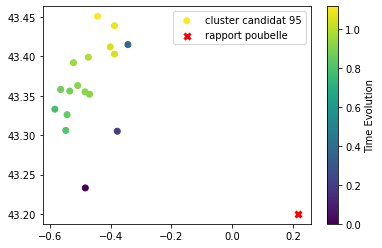

rapport dans poubelle TIME_EVENT    135360.983333
LATITUDE               43.2
LONGITUDE             0.217
CLASSI                   -1
Name: 4090, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3952  135363.616667    43.451     -0.443      95
3953  135363.583333    43.439     -0.387      95
3954      135363.55    43.403     -0.387      95
3955      135363.55    43.412     -0.401      95
3956  135363.483333    43.399     -0.473      95
3957      135363.45    43.392     -0.522      95
3960  135363.416667    43.355     -0.484      95
3961  135363.416667    43.363     -0.508      95
3962  135363.416667    43.352     -0.469      95
3963  135363.383333    43.356     -0.534      95
3964  135363.366667    43.358     -0.564      95
3965      135363.35    43.326     -0.543      95
3966  135363.316667    43.306     -0.547      95
3967  135363.283333    43.333     -0.583      95
3971  135362.866667    43.415     -0.343      95
3975       135362.7    43.305     -0.378      95
3985   

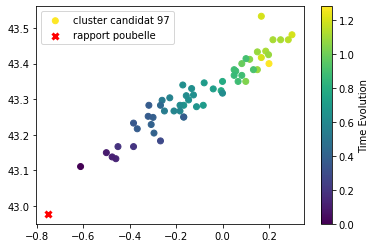

rapport dans poubelle TIME_EVENT    135360.833333
LATITUDE             42.978
LONGITUDE            -0.749
CLASSI                   -1
Name: 4107, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4009  135361.833333    43.400      0.200      97
4012      135361.75    43.533      0.167      97
4013      135361.75    43.417      0.167      97
4015      135361.75    43.481      0.299      97
4017       135361.7    43.467      0.283      97
4018  135361.666667    43.435      0.186      97
4019  135361.666667    43.467      0.250      97
4020  135361.666667    43.467      0.217      97
4023  135361.633333    43.383      0.150      97
4024  135361.633333    43.433      0.150      97
4026  135361.633333    43.425      0.198      97
4029       135361.6    43.412      0.117      97
4031  135361.583333    43.350      0.100      97
4034  135361.533333    43.400      0.083      97
4040  135361.466667    43.383      0.133      97
4042      135361.45    43.414      0.101      97
4045  1

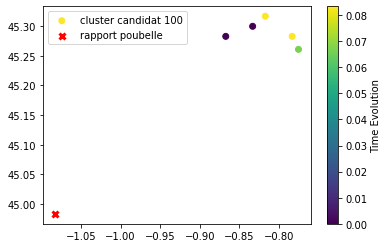

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4132  135360.166667    45.317     -0.817     100
4133  135360.166667    45.283     -0.783     100
4134      135360.15    45.261     -0.775     100
4136  135360.083333    45.300     -0.833     100
4137  135360.083333    45.283     -0.867     100


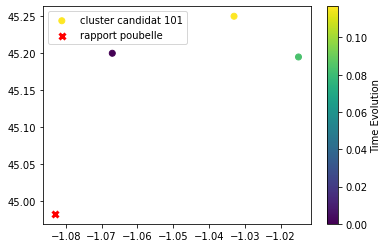

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4138  135360.033333    45.250     -1.033     101
4139       135360.0    45.195     -1.015     101
4143  135359.916667    45.200     -1.067     101
ON TESTE LE RAPPORT D'INDICE 78 DANS LE CLUSTER POUBELLE


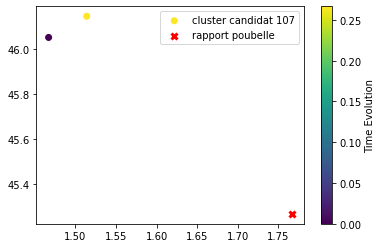

rapport dans poubelle TIME_EVENT    135337.75
LATITUDE         45.267
LONGITUDE         1.767
CLASSI               -1
Name: 4314, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4297      135337.95    46.144      1.514     107
4317  135337.683333    46.050      1.467     107


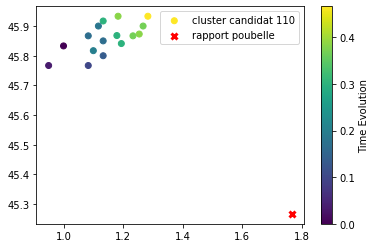

rapport dans poubelle TIME_EVENT    135337.75
LATITUDE         45.267
LONGITUDE         1.767
CLASSI               -1
Name: 4314, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
ON TESTE LE RAPPORT D'I

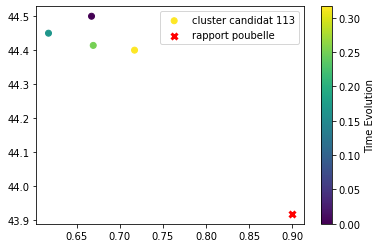

rapport dans poubelle TIME_EVENT    135337.433333
LATITUDE             43.917
LONGITUDE               0.9
CLASSI                   -1
Name: 4342, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4380  135336.983333    44.400      0.717     113
4382  135336.916667    44.414      0.669     113
4391  135336.833333    44.450      0.617     113
4396  135336.666667    44.500      0.667     113
ON TESTE LE RAPPORT D'INDICE 86 DANS LE CLUSTER POUBELLE


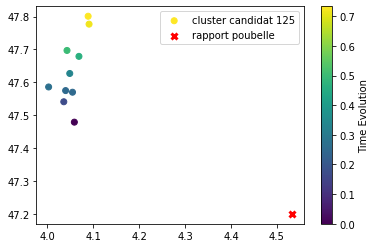

rapport dans poubelle TIME_EVENT    134980.666667
LATITUDE               47.2
LONGITUDE             4.533
CLASSI                   -1
Name: 5113, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125
ON TESTE LE RAPPORT D'INDICE 87 DANS LE CLUSTER POUBELLE


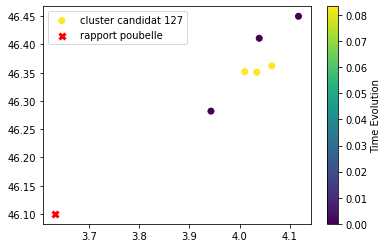

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


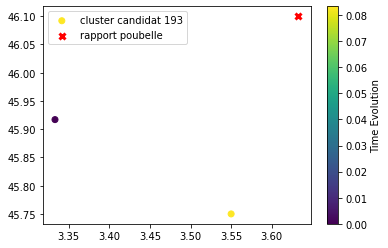

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5114  134980.666667    45.750      3.550     193
5115  134980.583333    45.917      3.333     193


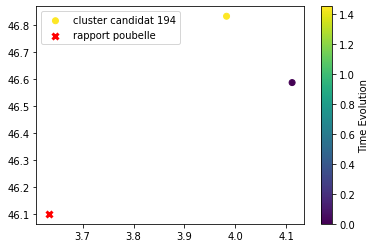

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5119  134979.666667    46.833      3.983     194
5175  134978.216667    46.587      4.112     194
ON TESTE LE RAPPORT D'INDICE 88 DANS LE CLUSTER POUBELLE


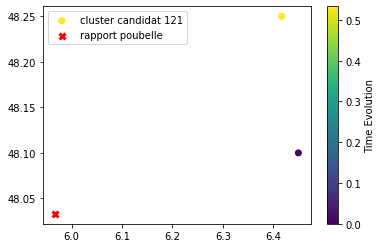

rapport dans poubelle TIME_EVENT    134979.3
LATITUDE        48.033
LONGITUDE        5.967
CLASSI              -1
Name: 5120, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5112       134980.7     48.25      6.417     121
5117  134980.166667     48.10      6.450     121
ON TESTE LE RAPPORT D'INDICE 89 DANS LE CLUSTER POUBELLE


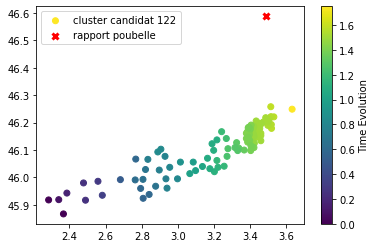

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


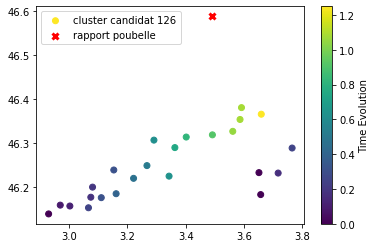

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

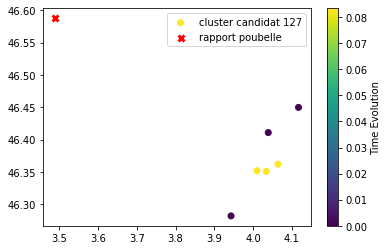

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


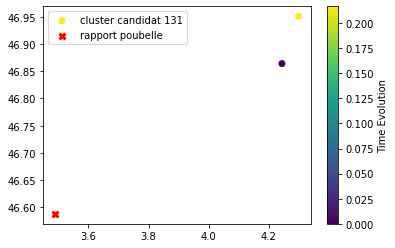

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


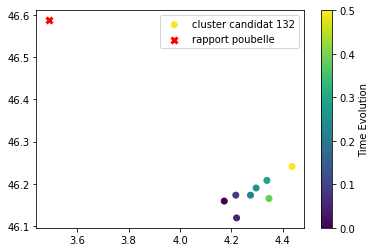

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


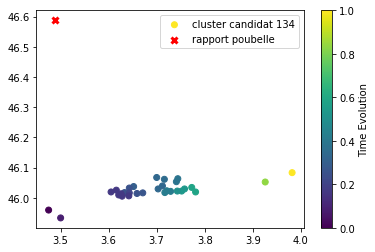

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  1

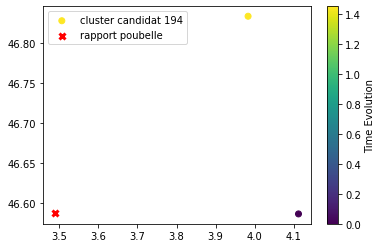

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5119  134979.666667    46.833      3.983     194
5175  134978.216667    46.587      4.112     194
ON TESTE LE RAPPORT D'INDICE 91 DANS LE CLUSTER POUBELLE


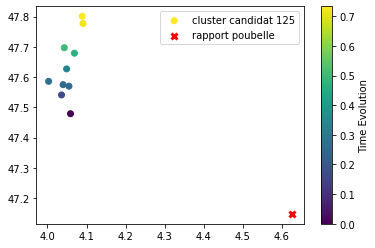

rapport dans poubelle TIME_EVENT    134976.666667
LATITUDE             47.148
LONGITUDE             4.626
CLASSI                   -1
Name: 5266, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


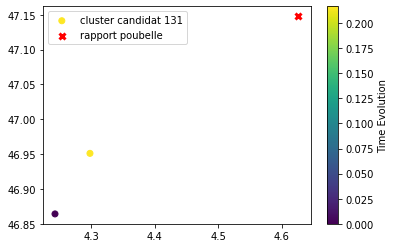

rapport dans poubelle TIME_EVENT    134976.666667
LATITUDE             47.148
LONGITUDE             4.626
CLASSI                   -1
Name: 5266, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 93 DANS LE CLUSTER POUBELLE


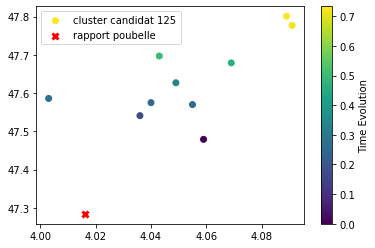

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


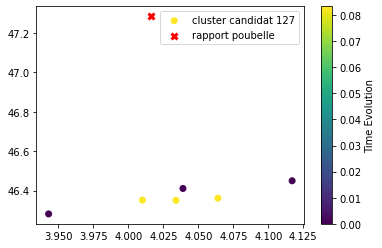

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


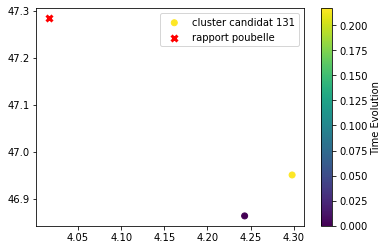

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


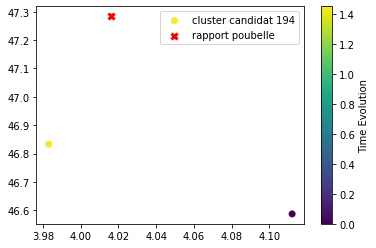

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5119  134979.666667    46.833      3.983     194
5175  134978.216667    46.587      4.112     194
ON TESTE LE RAPPORT D'INDICE 94 DANS LE CLUSTER POUBELLE


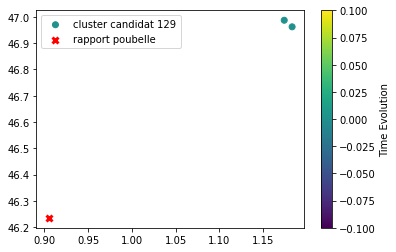

rapport dans poubelle TIME_EVENT    134976.35
LATITUDE         46.235
LONGITUDE         0.905
CLASSI               -1
Name: 5280, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5287  134976.166667    46.962      1.183     129
5288  134976.166667    46.987      1.174     129
ON TESTE LE RAPPORT D'INDICE 95 DANS LE CLUSTER POUBELLE


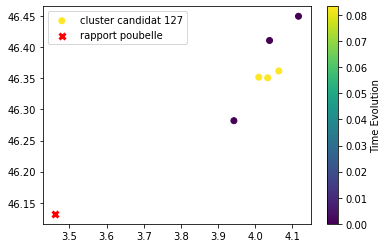

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


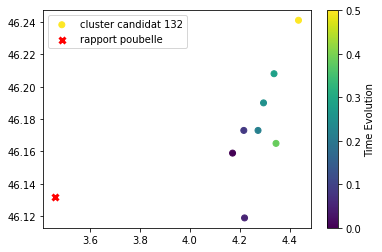

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


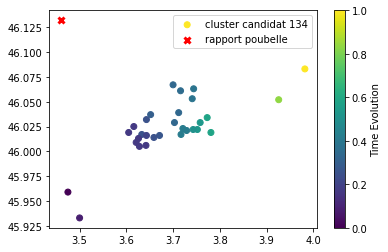

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  1

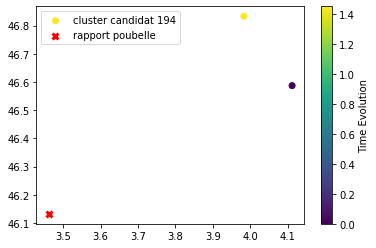

rapport dans poubelle TIME_EVENT    134975.783333
LATITUDE             46.132
LONGITUDE             3.461
CLASSI                   -1
Name: 5303, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5119  134979.666667    46.833      3.983     194
5175  134978.216667    46.587      4.112     194
ON TESTE LE RAPPORT D'INDICE 96 DANS LE CLUSTER POUBELLE


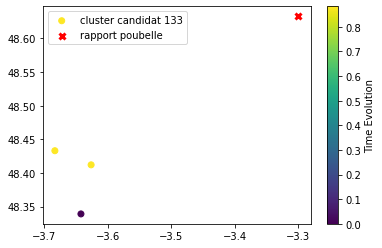

rapport dans poubelle TIME_EVENT    134974.666667
LATITUDE             48.633
LONGITUDE              -3.3
CLASSI                   -1
Name: 5338, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5320  134975.416667    48.433     -3.683     133
5321  134975.416667    48.412     -3.626     133
5345  134974.533333    48.339     -3.642     133
ON TESTE LE RAPPORT D'INDICE 97 DANS LE CLUSTER POUBELLE


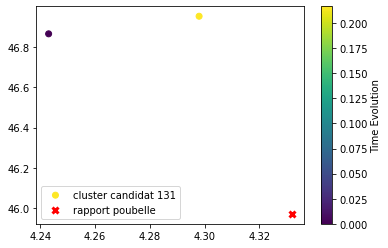

rapport dans poubelle TIME_EVENT    134973.633333
LATITUDE             45.973
LONGITUDE             4.332
CLASSI                   -1
Name: 5393, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


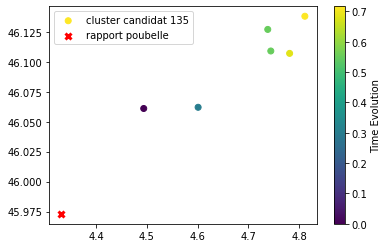

rapport dans poubelle TIME_EVENT    134973.633333
LATITUDE             45.973
LONGITUDE             4.332
CLASSI                   -1
Name: 5393, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135
ON TESTE LE RAPPORT D'INDICE 98 DANS LE CLUSTER POUBELLE


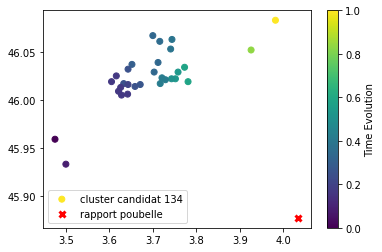

rapport dans poubelle TIME_EVENT    134973.133333
LATITUDE             45.877
LONGITUDE             4.035
CLASSI                   -1
Name: 5396, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  134974.416667    46.039      3.712     134
5357  134974.416667    46.067      3.700     134
5358  1

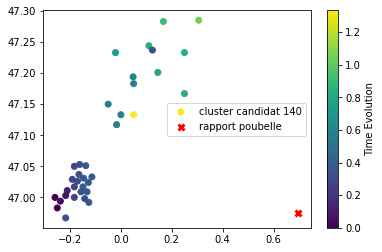

rapport dans poubelle TIME_EVENT    134972.083333
LATITUDE             46.975
LONGITUDE             0.698
CLASSI                   -1
Name: 5407, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5413  134970.916667    47.133      0.050     140
5415  134970.633333    47.285      0.306     140
5416       134970.5    47.283      0.167     140
5417  134970.416667    47.167      0.250     140
5418  134970.416667    47.233      0.250     140
5419  134970.416667    47.244      0.110     140
5420  134970.366667    47.201      0.145     140
5421  134970.316667    47.233     -0.021     140
5422  134970.183333    47.133      0.000     140
5423  134970.166667    47.183      0.050     140
5424  134970.166667    47.194      0.048     140
5425      134970.15    47.150     -0.050     140
5426      134970.15    47.117     -0.017     140
5427  134969.966667    47.024     -0.128     140
5428  134969.966667    47.033     -0.114     140
5429      134969.95    47.017     -0.149     140
5430   

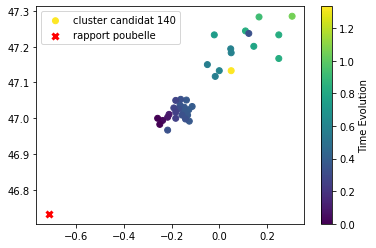

rapport dans poubelle TIME_EVENT    134968.75
LATITUDE         46.733
LONGITUDE        -0.717
CLASSI               -1
Name: 5451, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5413  134970.916667    47.133      0.050     140
5415  134970.633333    47.285      0.306     140
5416       134970.5    47.283      0.167     140
5417  134970.416667    47.167      0.250     140
5418  134970.416667    47.233      0.250     140
5419  134970.416667    47.244      0.110     140
5420  134970.366667    47.201      0.145     140
5421  134970.316667    47.233     -0.021     140
5422  134970.183333    47.133      0.000     140
5423  134970.166667    47.183      0.050     140
5424  134970.166667    47.194      0.048     140
5425      134970.15    47.150     -0.050     140
5426      134970.15    47.117     -0.017     140
5427  134969.966667    47.024     -0.128     140
5428  134969.966667    47.033     -0.114     140
5429      134969.95    47.017     -0.149     140
5430      134969.95    

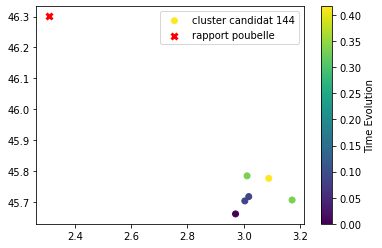

rapport dans poubelle TIME_EVENT    134955.25
LATITUDE         46.301
LONGITUDE         2.307
CLASSI               -1
Name: 5457, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
ON TESTE LE RAPPORT D'INDICE 104 DANS LE CLUSTER POUBELLE


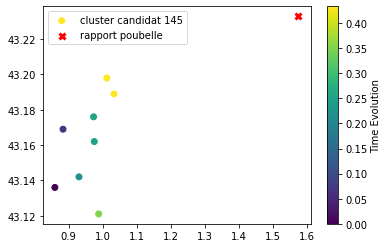

rapport dans poubelle TIME_EVENT    134953.833333
LATITUDE             43.233
LONGITUDE             1.576
CLASSI                   -1
Name: 5460, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145
ON TESTE LE RAPPORT D'INDICE 105 DANS LE CLUSTER POUBELLE


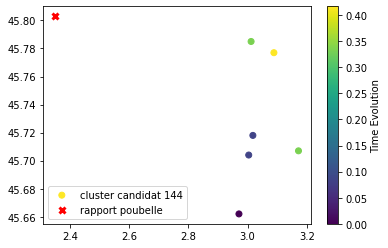

rapport dans poubelle TIME_EVENT    134953.416667
LATITUDE             45.803
LONGITUDE              2.35
CLASSI                   -1
Name: 5463, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144


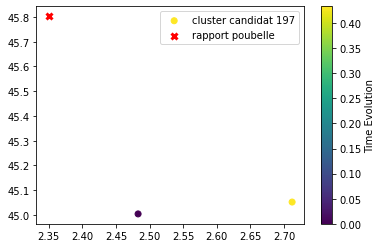

rapport dans poubelle TIME_EVENT    134953.416667
LATITUDE             45.803
LONGITUDE              2.35
CLASSI                   -1
Name: 5463, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5523  134951.016667    45.052      2.712     197
5527  134950.583333    45.004      2.483     197
ON TESTE LE RAPPORT D'INDICE 106 DANS LE CLUSTER POUBELLE


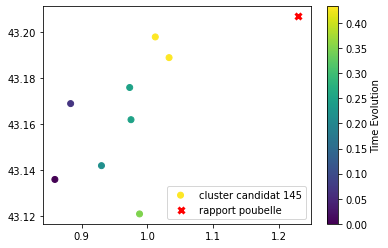

rapport dans poubelle TIME_EVENT    134953.216667
LATITUDE             43.207
LONGITUDE              1.23
CLASSI                   -1
Name: 5465, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145
ON TESTE LE RAPPORT D'INDICE 108 DANS LE CLUSTER POUBELLE


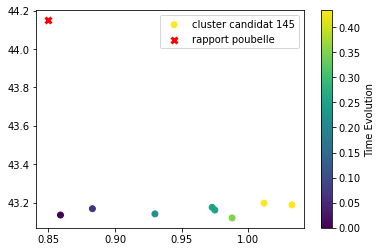

rapport dans poubelle TIME_EVENT    134952.983333
LATITUDE              44.15
LONGITUDE              0.85
CLASSI                   -1
Name: 5469, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5473  134952.883333    43.189      1.033     145
5474  134952.883333    43.198      1.012     145
5476       134952.8    43.121      0.988     145
5477       134952.7    43.176      0.973     145
5478       134952.7    43.162      0.975     145
5479  134952.666667    43.142      0.930     145
5481  134952.516667    43.169      0.883     145
5483      134952.45    43.136      0.859     145


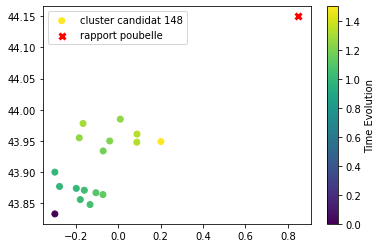

rapport dans poubelle TIME_EVENT    134952.983333
LATITUDE              44.15
LONGITUDE              0.85
CLASSI                   -1
Name: 5469, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  1

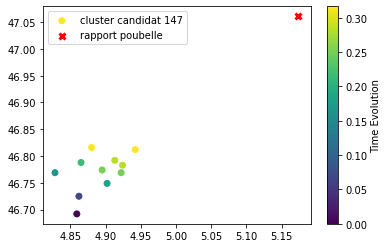

rapport dans poubelle TIME_EVENT    134952.9
LATITUDE        47.061
LONGITUDE        5.174
CLASSI              -1
Name: 5472, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5486  134952.233333    46.816      4.880     147
5487  134952.233333    46.812      4.942     147
5488       134952.2    46.792      4.913     147
5489       134952.2    46.783      4.924     147
5490  134952.166667    46.774      4.895     147
5491  134952.166667    46.769      4.922     147
5493  134952.133333    46.788      4.865     147
5494       134952.1    46.749      4.902     147
5495  134952.083333    46.769      4.828     147
5496  134951.983333    46.725      4.862     147
5497  134951.916667    46.692      4.859     147
ON TESTE LE RAPPORT D'INDICE 110 DANS LE CLUSTER POUBELLE


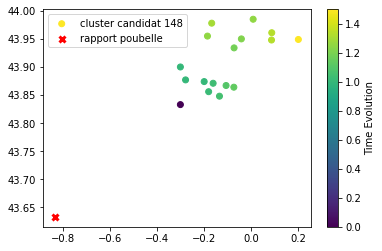

rapport dans poubelle TIME_EVENT    134952.666667
LATITUDE             43.633
LONGITUDE            -0.833
CLASSI                   -1
Name: 5480, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  1

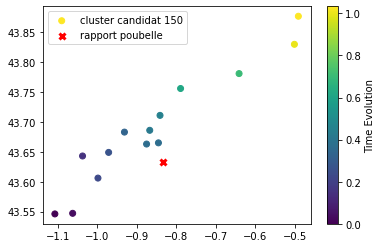

rapport dans poubelle TIME_EVENT    134952.666667
LATITUDE             43.633
LONGITUDE            -0.833
CLASSI                   -1
Name: 5480, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5521  134951.083333    43.877     -0.491     150
5522      134951.05    43.830     -0.501     150
5524      134950.75    43.781     -0.641     150
5526  134950.666667    43.756     -0.789     150
5528       134950.5    43.711     -0.841     150
5529  134950.466667    43.686     -0.867     150
5530  134950.416667    43.665     -0.845     150
5531  134950.416667    43.663     -0.875     150
5533  134950.383333    43.683     -0.931     150
5534  134950.316667    43.649     -0.971     150
5535  134950.283333    43.606     -0.998     150
5536       134950.2    43.643     -1.037     150
5537  134950.083333    43.547     -1.062     150
5538      134950.05    43.546     -1.107     150
ON TESTE LE RAPPORT D'INDICE 111 DANS LE CLUSTER POUBELLE


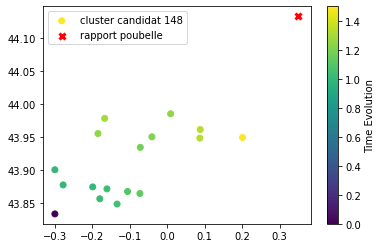

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE         44.133
LONGITUDE          0.35
CLASSI               -1
Name: 5484, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  134950.416667    

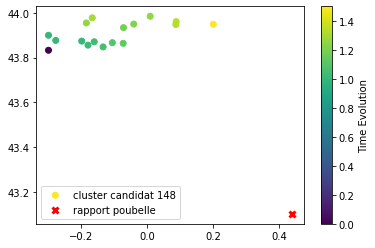

rapport dans poubelle TIME_EVENT    134951.75
LATITUDE         43.102
LONGITUDE          0.44
CLASSI               -1
Name: 5500, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  134950.416667    

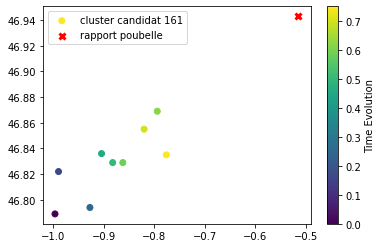

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161


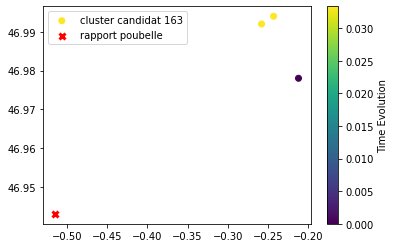

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163


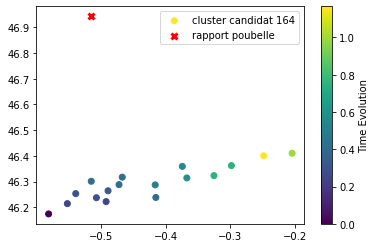

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333    46.288     -0.472     164
6580      134663.25    46.264     -0.489     164
6583  134663.216667    46.253     -0.539     164
6584       134663.2    46.237     -0.507     164
6585  134663.166667    46.214     -0.552     164
6586  134663.166667    46.222     -0.492     164
6588  134662.916667    46.1

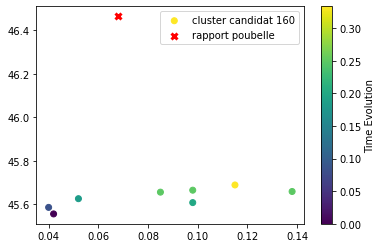

rapport dans poubelle TIME_EVENT    134664.533333
LATITUDE             46.464
LONGITUDE             0.068
CLASSI                   -1
Name: 6567, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160


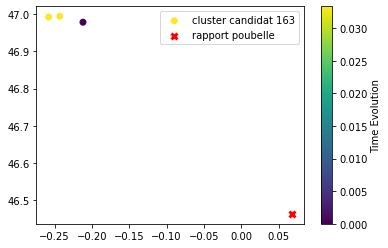

rapport dans poubelle TIME_EVENT    134664.533333
LATITUDE             46.464
LONGITUDE             0.068
CLASSI                   -1
Name: 6567, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
ON TESTE LE RAPPORT D'INDICE 123 DANS LE CLUSTER POUBELLE


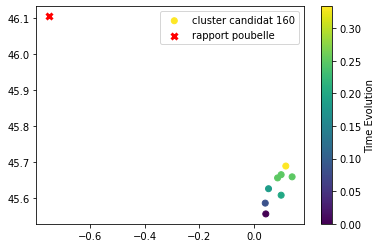

rapport dans poubelle TIME_EVENT    134662.416667
LATITUDE             46.105
LONGITUDE             -0.75
CLASSI                   -1
Name: 6591, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160
ON TESTE LE RAPPORT D'INDICE 125 DANS LE CLUSTER POUBELLE


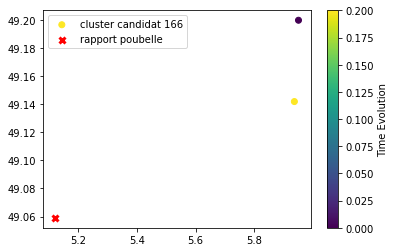

rapport dans poubelle TIME_EVENT    134613.366667
LATITUDE             49.059
LONGITUDE             5.122
CLASSI                   -1
Name: 6674, dtype: object
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6661  134614.25    49.142      5.936     166
6664  134614.05    49.200      5.950     166


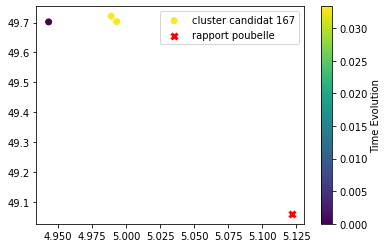

rapport dans poubelle TIME_EVENT    134613.366667
LATITUDE             49.059
LONGITUDE             5.122
CLASSI                   -1
Name: 6674, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6721  134611.416667    49.703      4.993     167
6722  134611.416667    49.721      4.989     167
6723  134611.383333    49.702      4.943     167
ON TESTE LE RAPPORT D'INDICE 134 DANS LE CLUSTER POUBELLE


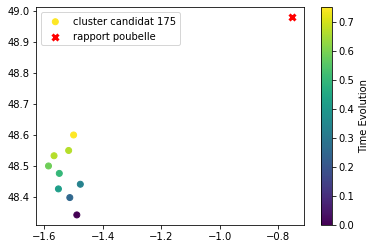

rapport dans poubelle TIME_EVENT    134493.45
LATITUDE          48.98
LONGITUDE        -0.752
CLASSI               -1
Name: 6977, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6967  134493.916667    48.600     -1.500     175
6968  134493.833333    48.550     -1.517     175
6969  134493.833333    48.533     -1.567     175
6970      134493.75    48.500     -1.586     175
6971  134493.666667    48.476     -1.549     175
6974  134493.583333    48.426     -1.552     175
6975       134493.5    48.441     -1.477     175
6978  134493.416667    48.398     -1.513     175
6981  134493.166667    48.342     -1.489     175


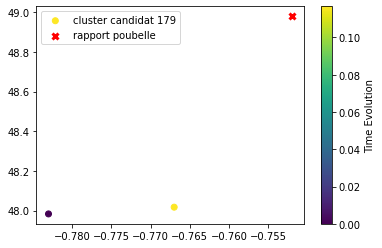

rapport dans poubelle TIME_EVENT    134493.45
LATITUDE          48.98
LONGITUDE        -0.752
CLASSI               -1
Name: 6977, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6990      134492.25    48.017     -0.767     179
6992  134492.133333    47.983     -0.783     179
ON TESTE LE RAPPORT D'INDICE 138 DANS LE CLUSTER POUBELLE


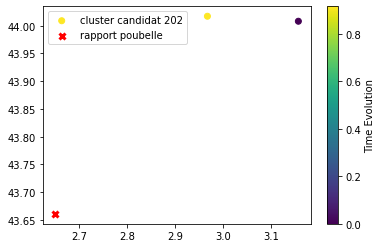

rapport dans poubelle TIME_EVENT    134201.666667
LATITUDE             43.661
LONGITUDE              2.65
CLASSI                   -1
Name: 7165, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
7160  134202.666667    44.017      2.967     202
7163      134201.75    44.008      3.156     202


In [ ]:
plot_cluster_rapport_all(visu_results_ter,fusion_poub_2)

In [ ]:
#premier élement : indice du rapport dans cluster poubelle, deuxième élement : numéro du cluster
candidats_fus_poub_2 = [[11,12],[52,50],[64,72],[65,73],[72,98],[75,100],[75,101]]

In [ ]:
visu_results_ter[visu_results_ter.CLASSI == -1].index

Int64Index([  26,   27,   30,   46,   55,   90,  248,  249,  252,  254,
            ...
            6966, 6977, 6988, 7118, 7140, 7165, 7251, 7268, 7275, 7342],
           dtype='int64', length=143)

In [ ]:
liste = visu_results_ter[visu_results_ter.CLASSI == -1].index
for e in candidats_fus_poub_2:
  i = liste[e[0]]
  visu_results_ter.loc[i,'CLASSI'] = e[1]

In [ ]:
visu_results_ter[visu_results_ter.CLASSI == -1]

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
26,138356.966667,49.502,1.586,-1
27,138356.7,48.333,1.933,-1
30,138356.416667,48.500,0.483,-1
46,138354.083333,48.183,-0.892,-1
55,138284.133333,47.231,0.253,-1
...,...,...,...,...
7165,134201.666667,43.661,2.650,-1
7251,133968.416667,43.583,7.117,-1
7268,133965.416667,46.817,-1.000,-1
7275,133944.416667,44.600,-0.933,-1


In [ ]:
#on a réduit le cluster poubelle de 188 à 137 éléments après stdbscan sur poubelle et poubelle avec orage

In [ ]:
#regarder si la position moyenne des deux candidats va dans le même sens que les pentes des deux candidats
#premier orage souvent à gauche du second

In [ ]:
def sens(df):

  #première étape : trouver la direction de l'orage (est ou ouest)
  #on va à l'est si longi(n+1)>longi(n)
  n = len(df)
  c = 0

  #inverse = [] #liste des indices qui vont à contre-sens

  for i in range(n-1):
    if df.iloc[i+1,2] - df.iloc[i,2] <0: #on va vers l'Est car le temps diminue quand i augmente
      c+=1

  if c>= (n-1)//2:
    return 1
  else:
    return 0


In [ ]:
visu_results.CLASSI

0         0
1         0
4         1
5         1
6         1
       ... 
7274    181
7275     -1
7308     -1
7309     -1
7342     -1
Name: CLASSI, Length: 1980, dtype: int64

In [ ]:
np.mean([sens(visu_results[visu_results.CLASSI == i]) for i in range(182)])

0.967032967032967

In [ ]:
le sens vaut 1 si va vers la droite/est

In [ ]:
def condition_tempo(visu_results,cluster1,cluster2):

  orage1 = visu_results[visu_results.CLASSI == cluster1]
  orage2 = visu_results[visu_results.CLASSI == cluster2]

  temps1 = np.mean(orage1.TIME_EVENT)
  temps2 = np.mean(orage2.TIME_EVENT)
  
  sens1 = sens(orage1)
  sens2 = sens(orage2)

  if sens1 == sens2:

    if sens1==1: #on va vers l'est

      if temps1 < temps2: #orage1 a lieu avant le 2
        return np.mean(orage1.LONGITUDE) < np.mean(orage2.LONGITUDE)

      else:
        return np.mean(orage1.LONGITUDE) > np.mean(orage2.LONGITUDE)

    else: #on va vers l'ouest
      if temps1 < temps2: #orage1 a lieu avant le 2
        return np.mean(orage1.LONGITUDE) > np.mean(orage2.LONGITUDE)

      else:
        return np.mean(orage1.LONGITUDE) < np.mean(orage2.LONGITUDE)

  else:
    return False


In [ ]:
candidats_fusion_bis = [[29,32],[88,91],[89,92],[94,96],[145,206],
                                 [158,159,164],[173,174,176],[135,203],[144,208],[126,201],[98,196]]

25%
50%
75%


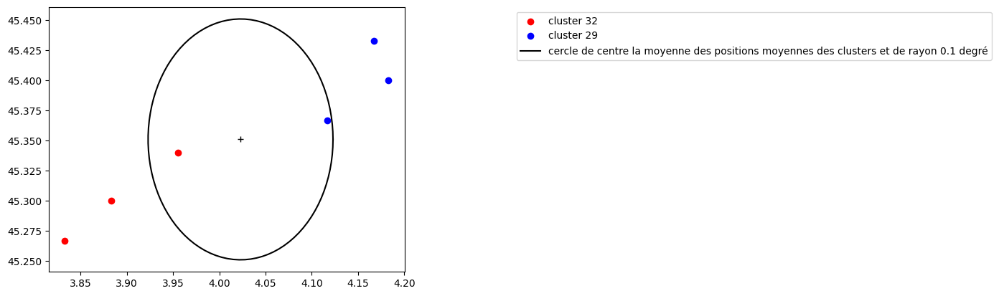

        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
977  136746.333333    45.400      4.183      29
978      136746.25    45.433      4.167      29
982  136745.966667    45.367      4.117      29
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32


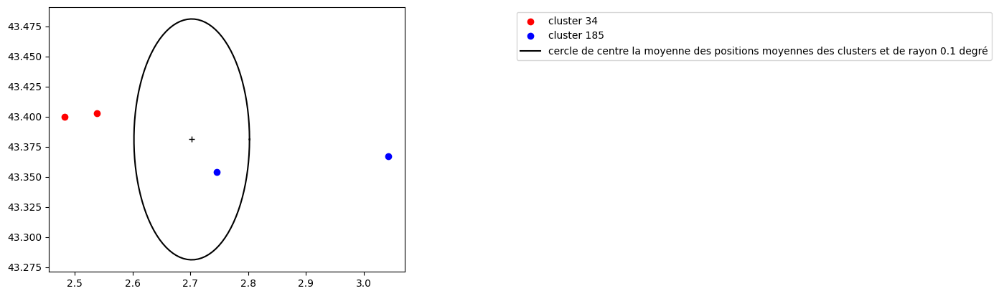

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1004  136727.916667    43.367      3.043     185
1005      136726.75    43.354      2.746     185
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34


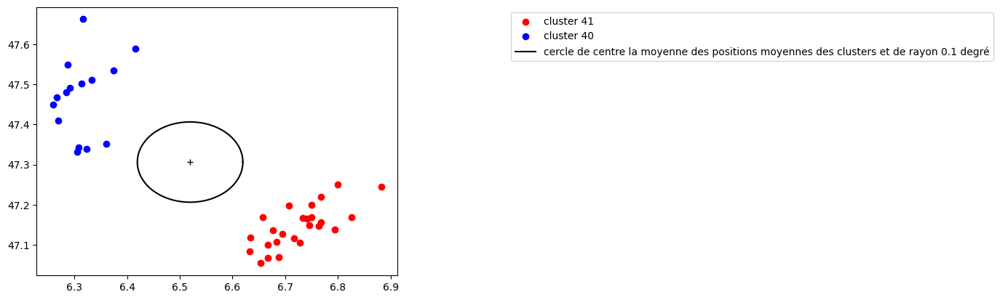

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1645  136077.283333    47.662      6.316      40
1656  136077.116667    47.589      6.416      40
1664      136077.05    47.549      6.288      40
1670       136077.0    47.535      6.374      40
1671  136076.966667    47.491      6.292      40
1672  136076.966667    47.501      6.314      40
1674      136076.95    47.511      6.333      40
1675  136076.916667    47.481      6.285      40
1677  136076.883333    47.449      6.260      40
1683  136076.833333    47.467      6.267      40
1692      136076.75    47.409      6.269      40
1705       136076.6    47.343      6.308      40
1706  136076.583333    47.351      6.361      40
1707  136076.583333    47.339      6.324      40
1708  136076.566667    47.332      6.306      40
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1684  136076.833333    47.244      6.882      41
1694      136076.75    47.168      6.825      41
1696  136076.716667    47.250      6.800      41
1697  136076.666667 

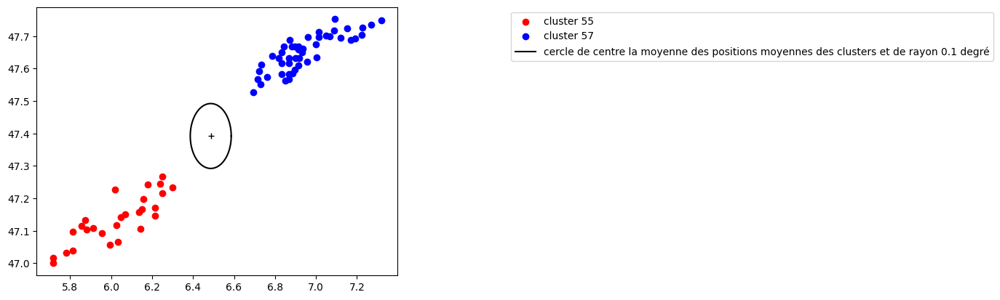

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3237       135507.0    47.749      7.319      57
3246  135506.916667    47.736      7.271      57
3249  135506.866667    47.704      7.224      57
3250  135506.866667    47.727      7.226      57
3252  135506.833333    47.692      7.192      57
3254  135506.816667    47.689      7.171      57
3255       135506.8    47.723      7.154      57
3256  135506.783333    47.752      7.092      57
3259  135506.766667    47.700      7.067      57
3260      135506.75    47.712      7.015      57
3264      135506.75    47.694      7.122      57
3265  135506.733333    47.717      7.089      57
3268  135506.683333    47.702      7.051      57
3270  135506.666667    47.675      6.998      57
3271  135506.666667    47.697      6.959      57
3272      135506.65    47.650      6.933      57
3274      135506.65    47.635      7.004      57
3275  135506.633333    47.696      7.012      57
3279  135506.616667    47.621      6.958      57
3280  135506.583333 

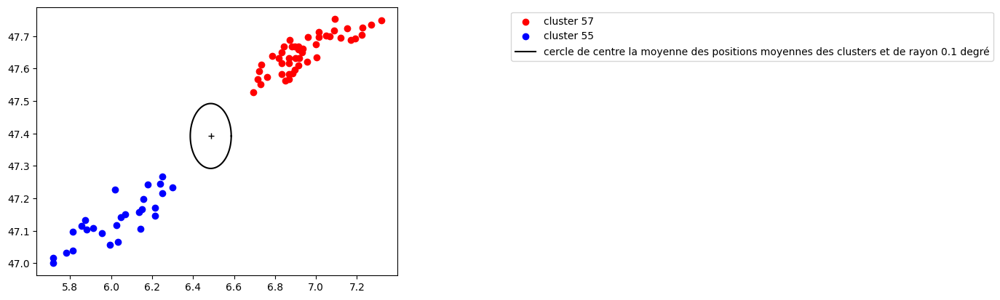

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3235       135507.0    47.217      6.250      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3240  135506.983333    47.267      6.250      55
3241  135506.966667    47.107      6.145      55
3242  135506.966667    47.147      6.215      55
3243      135506.95    47.243      6.180      55
3244      135506.95    47.199      6.159      55
3247       135506.9    47.167      6.150      55
3248  135506.883333    47.158      6.137      55
3251  135506.833333    47.152      6.069      55
3257  135506.783333    47.142      6.046      55
3258  135506.783333    47.117      6.025      55
3261      135506.75    47.067      6.033      55
3262      135506.75    47.226      6.020      55
3263      135506.75    47.056      5.993      55
3266       135506.7    47.093      5.956      55
3269  135506.683333    47.108      5.914      55
3273      135506.65 

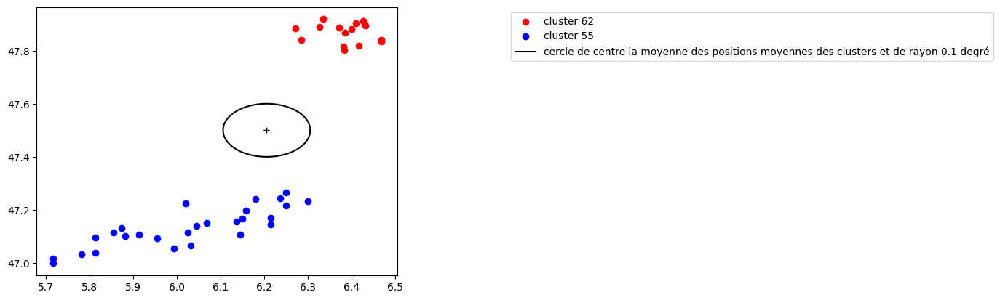

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3232  135507.066667    47.233      6.300      55
3235       135507.0    47.217      6.250      55
3238       135507.0    47.171      6.216      55
3239       135507.0    47.246      6.238      55
3240  135506.983333    47.267      6.250      55
3241  135506.966667    47.107      6.145      55
3242  135506.966667    47.147      6.215      55
3243      135506.95    47.243      6.180      55
3244      135506.95    47.199      6.159      55
3247       135506.9    47.167      6.150      55
3248  135506.883333    47.158      6.137      55
3251  135506.833333    47.152      6.069      55
3257  135506.783333    47.142      6.046      55
3258  135506.783333    47.117      6.025      55
3261      135506.75    47.067      6.033      55
3262      135506.75    47.226      6.020      55
3263      135506.75    47.056      5.993      55
3266       135506.7    47.093      5.956      55
3269  135506.683333    47.108      5.914      55
3273      135506.65 

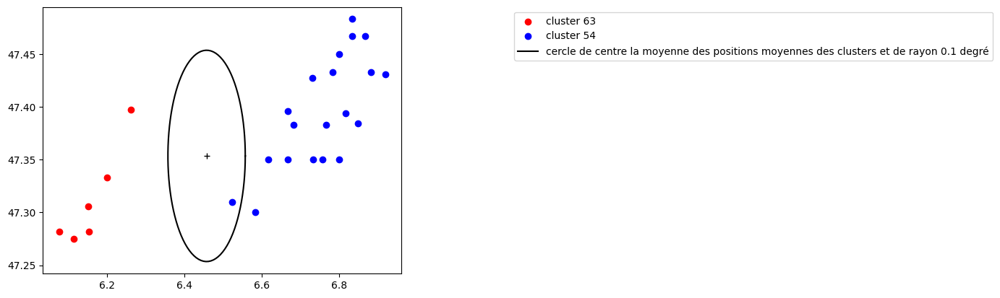

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3212  135507.833333    47.433      6.883      54
3213      135507.75    47.483      6.833      54
3214      135507.75    47.431      6.919      54
3215  135507.733333    47.467      6.867      54
3216       135507.7    47.433      6.783      54
3217  135507.683333    47.467      6.833      54
3218  135507.666667    47.384      6.849      54
3219      135507.65    47.394      6.817      54
3220  135507.616667    47.350      6.800      54
3221       135507.6    47.383      6.767      54
3222  135507.583333    47.350      6.757      54
3223  135507.566667    47.450      6.800      54
3224      135507.55    47.350      6.733      54
3225      135507.55    47.427      6.731      54
3226       135507.5    47.383      6.683      54
3227       135507.5    47.396      6.668      54
3228  135507.466667    47.350      6.617      54
3229      135507.45    47.350      6.667      54
3230  135507.416667    47.300      6.583      54
3231  135507.333333 

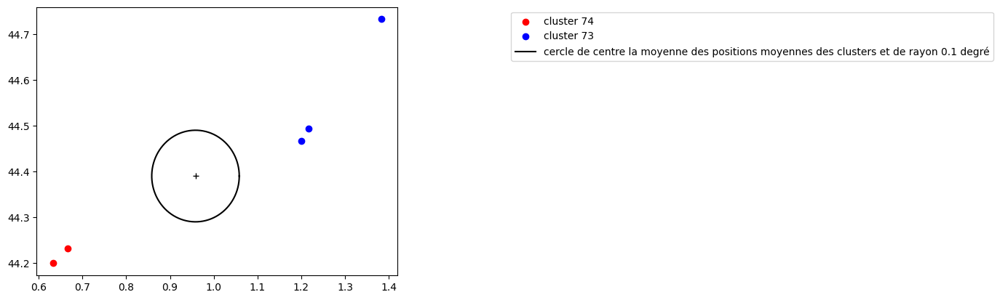

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3627      135424.35    44.733      1.383      73
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74


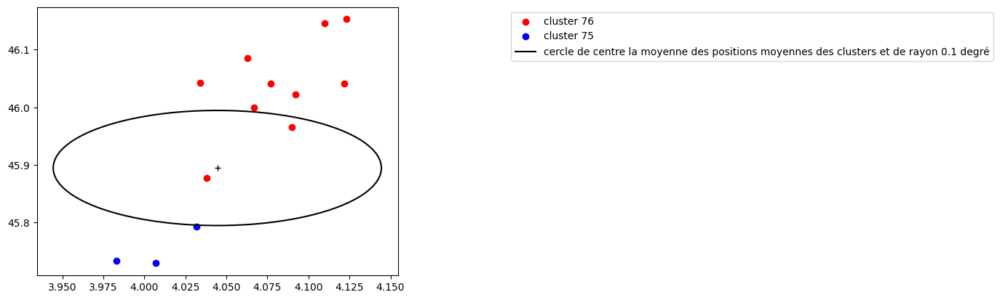

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3638       135406.0    45.793      4.032      75
3640      135405.75    45.729      4.007      75
3641  135405.716667    45.733      3.983      75
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3645  135404.866667    46.153      4.123      76
3647  135404.833333    46.146      4.110      76
3650      135404.75    46.086      4.063      76
3651  135404.666667    46.041      4.077      76
3652  135404.666667    46.041      4.122      76
3654  135404.633333    46.043      4.034      76
3656  135404.583333    46.022      4.092      76
3658  135404.516667    46.000      4.067      76
3660  135404.416667    45.966      4.090      76
3666      135404.25    45.877      4.038      76


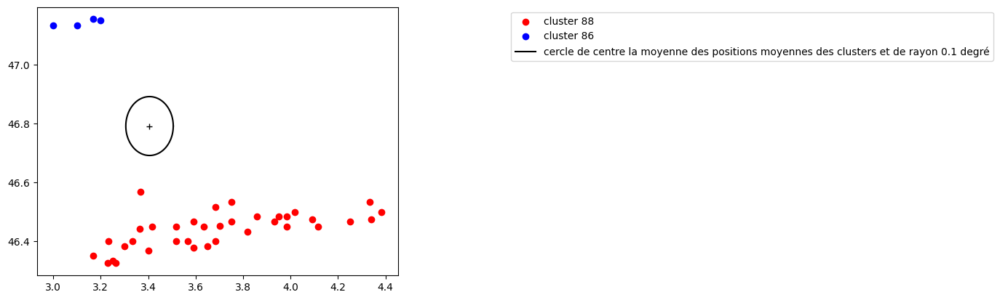

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3787  135383.716667    47.150      3.200      86
3788  135383.683333    47.154      3.167      86
3789  135383.666667    47.133      3.100      86
3803      135383.45    47.133      3.000      86
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667 

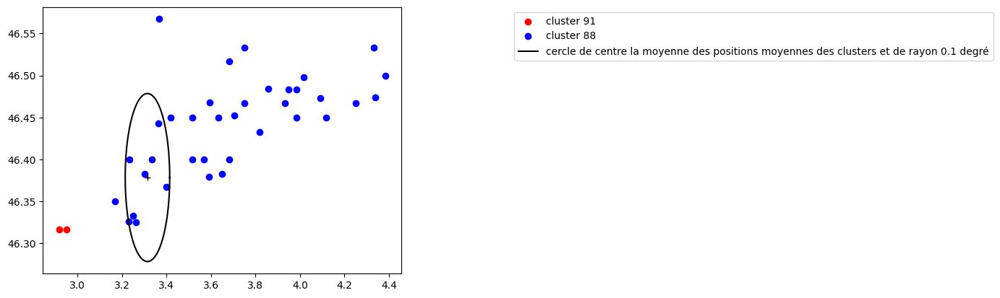

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0    46.533      3.750      88
3877       135381.0    46.452      3.703      88
3884      135380.95    46.567      3.367      88
3886  135380.933333 

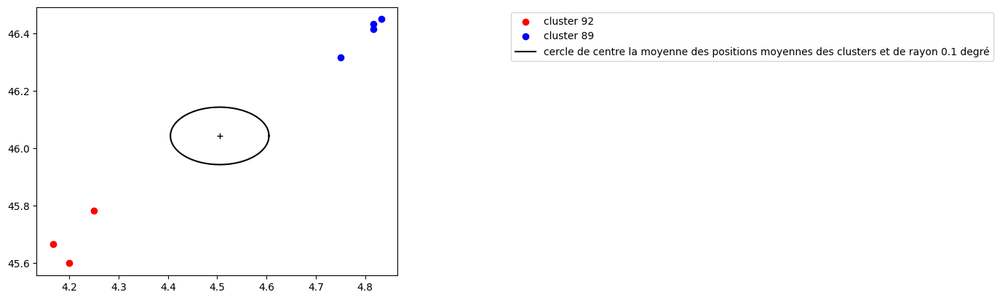

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92


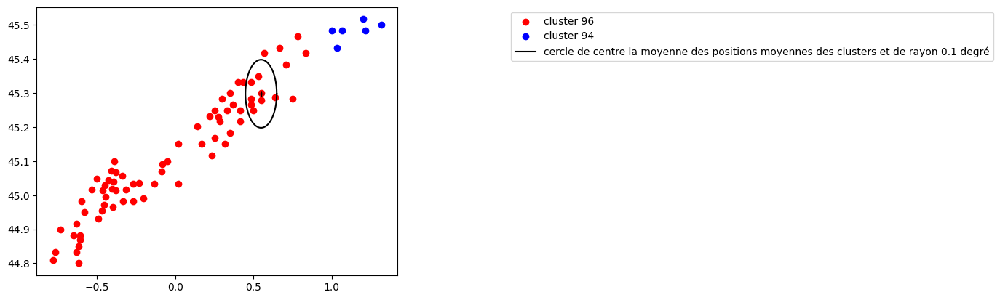

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      94
3958  135363.433333    45.517      1.200      94
3959  135363.416667    45.483      1.217      94
3968  135363.166667    45.483      1.067      94
3969  135363.133333    45.433      1.033      94
3970  135363.083333    45.483      1.000      94
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


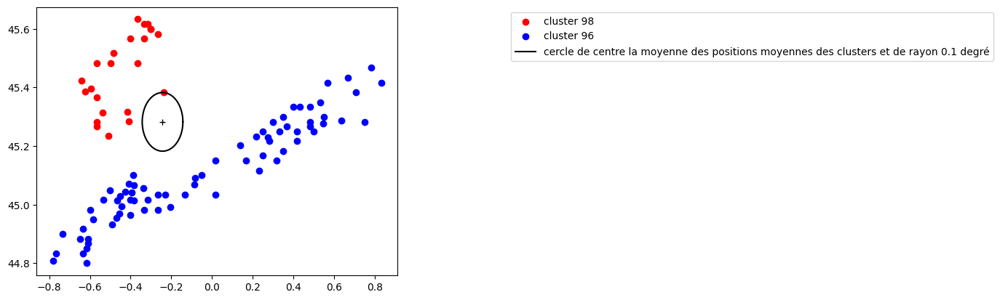

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4087  135361.033333    45.383     -0.236      98
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      

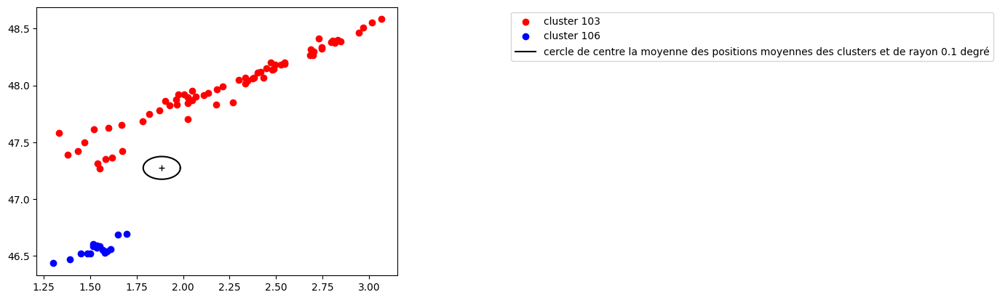

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4261      135338.95    48.583      3.067     103
4262  135338.916667    48.555      3.015     103
4263      135338.85 

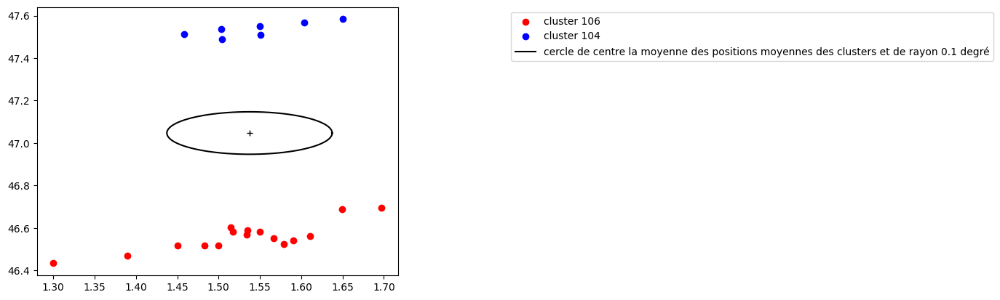

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333 

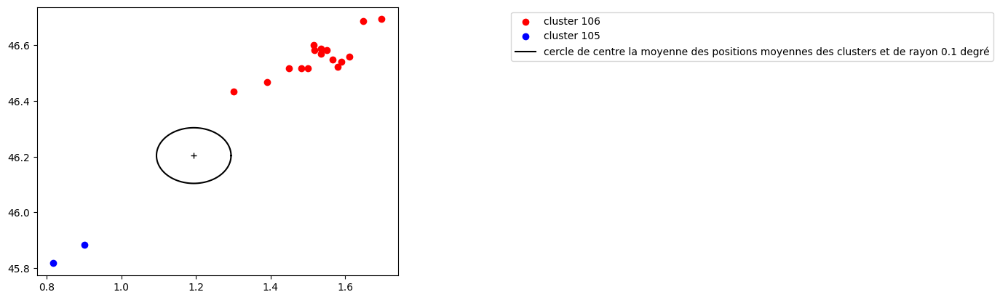

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106


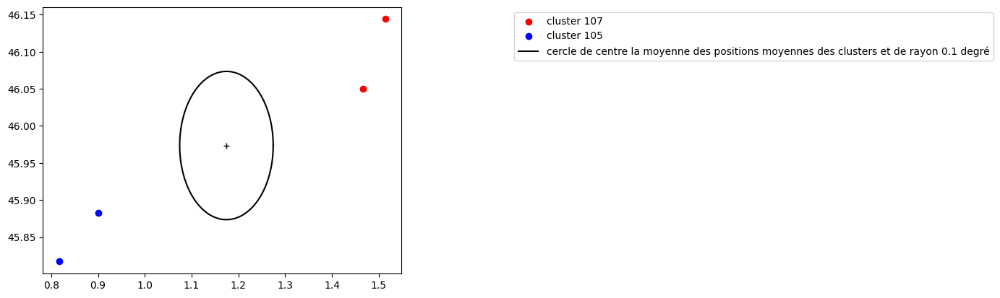

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4297      135337.95    46.144      1.514     107
4317  135337.683333    46.050      1.467     107


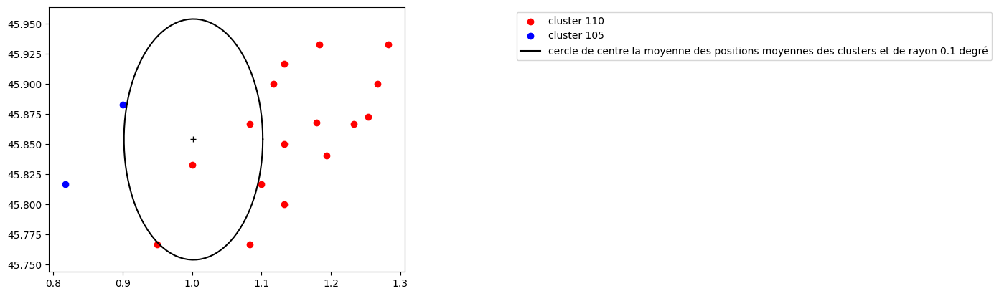

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4270      135338.45    45.883      0.900     105
4282  135338.316667    45.817      0.817     105
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110


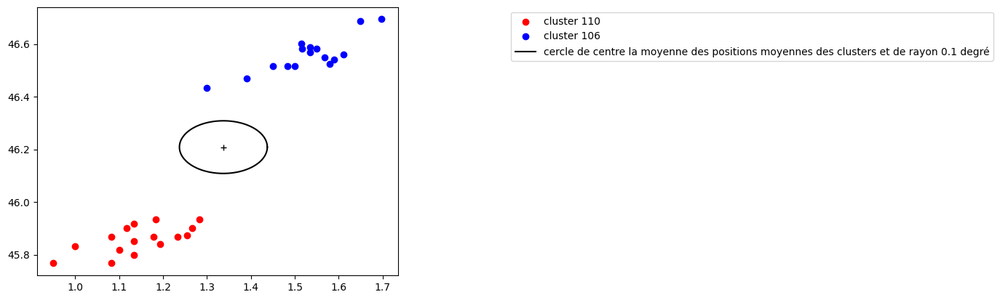

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333 

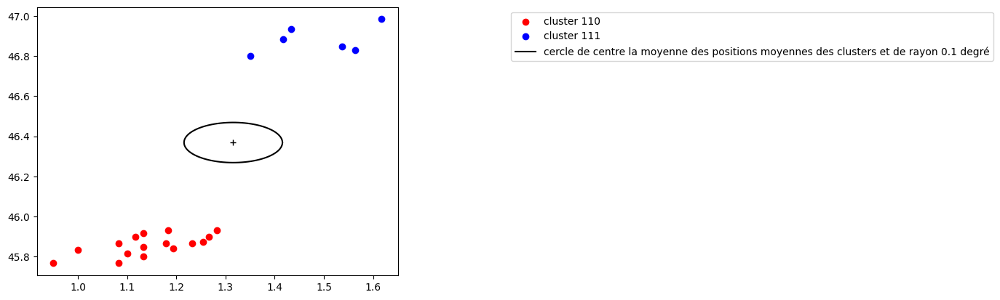

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333 

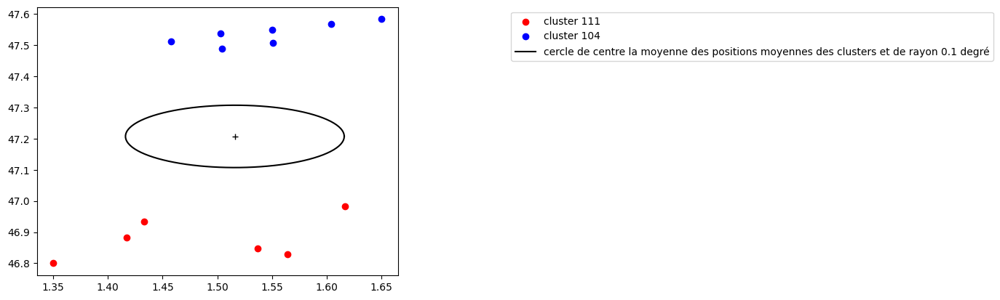

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111


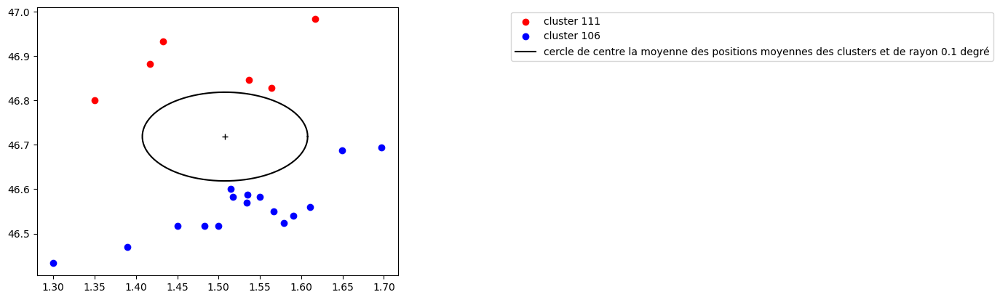

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

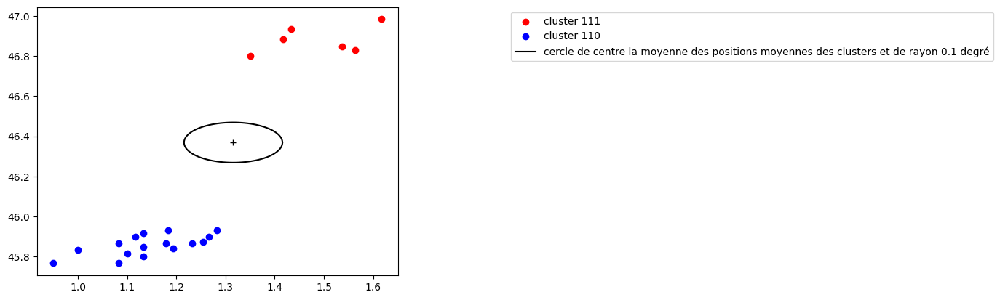

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333    45.933      1.183     110
4343  135337.416667    45.867      1.233     110
4344  135337.416667    45.900      1.267     110
4352      135337.35    45.841      1.194     110
4353      135337.35    45.917      1.133     110
4354      135337.35    45.868      1.179     110
4357      135337.25    45.817      1.100     110
4360  135337.233333    45.900      1.117     110
4361  135337.216667    45.850      1.133     110
4362  135337.216667    45.867      1.083     110
4365  135337.183333    45.800      1.133     110
4368      135337.15    45.767      1.083     110
4370  135337.083333    45.767      0.950     110
4375      135337.05    45.833      1.000     110
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

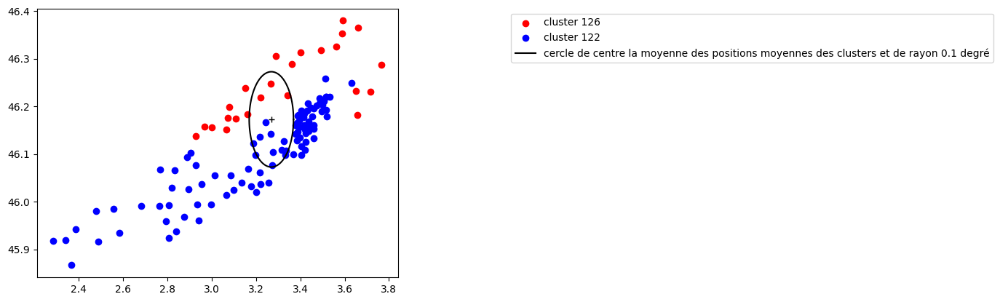

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     1

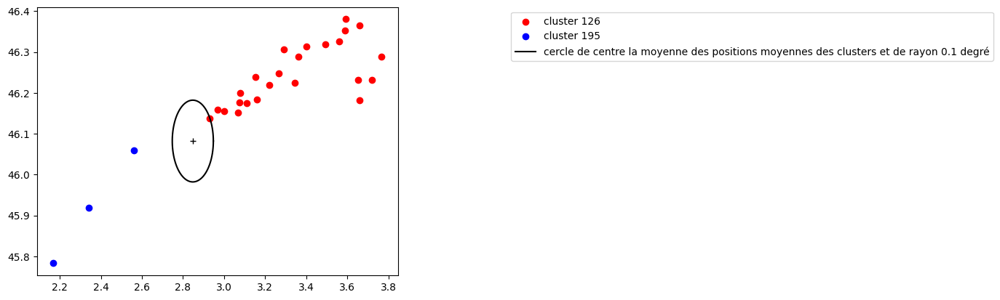

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5264   134976.7    45.783      2.168     195
5316   134975.5    46.059      2.562     195
5325  134975.25    45.919      2.341     195
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3

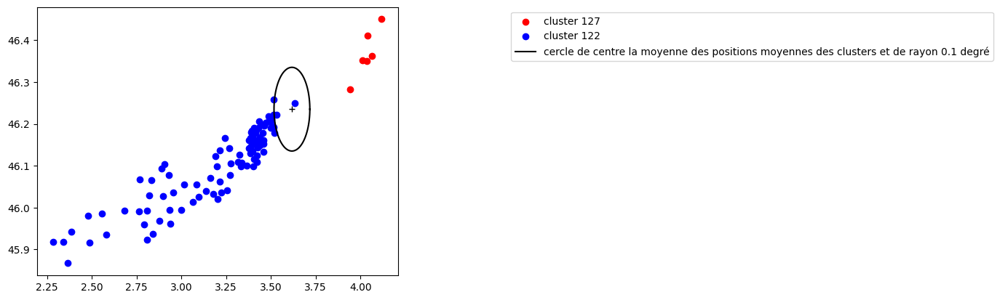

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127


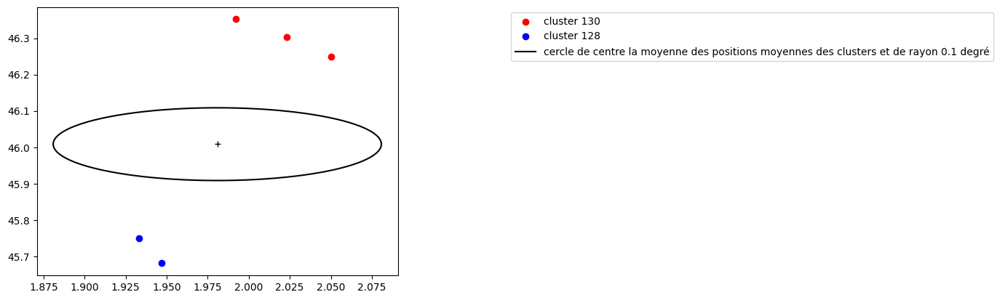

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130


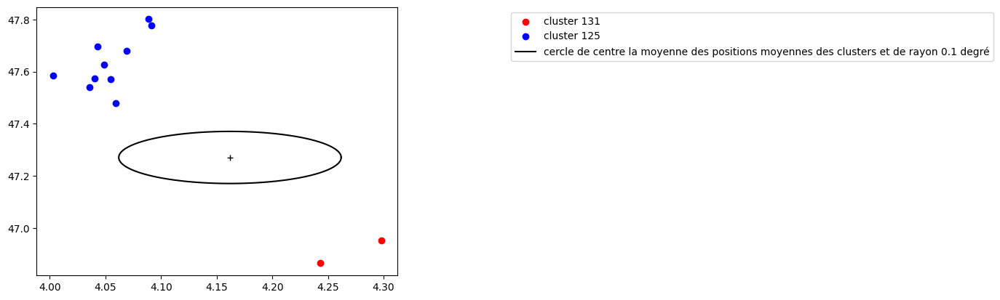

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


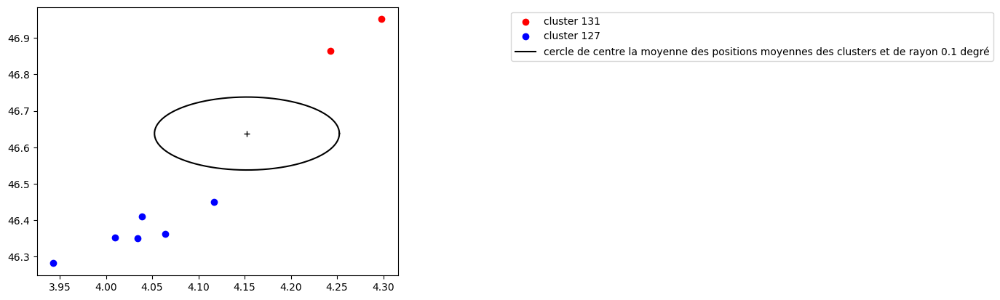

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


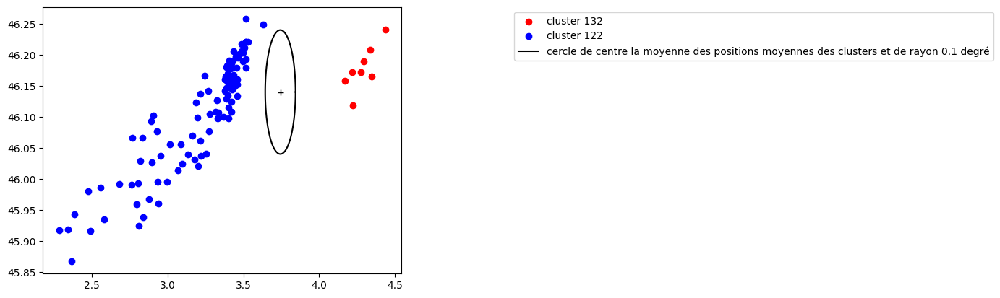

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     1

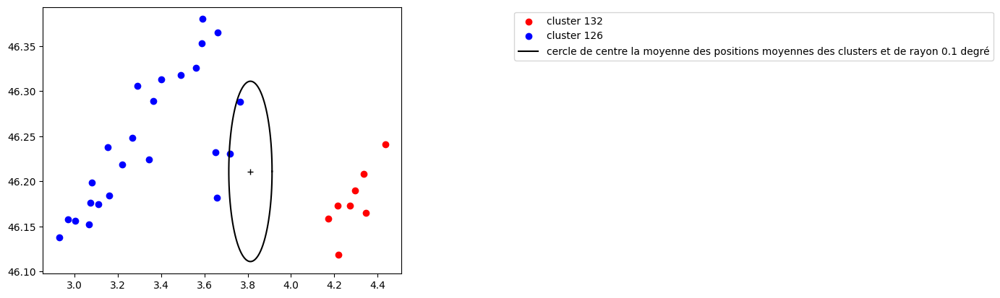

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.199      3.080     126
5279      134976.35    46.176      3.074     126
5281  134976.333333    46.231      3.718     126
5282  134976.283333 

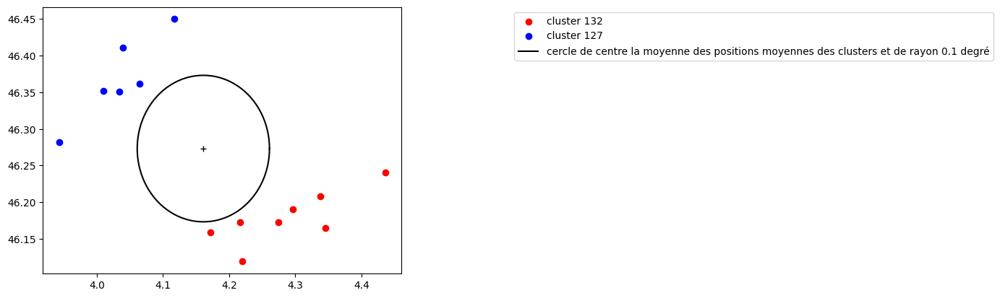

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132


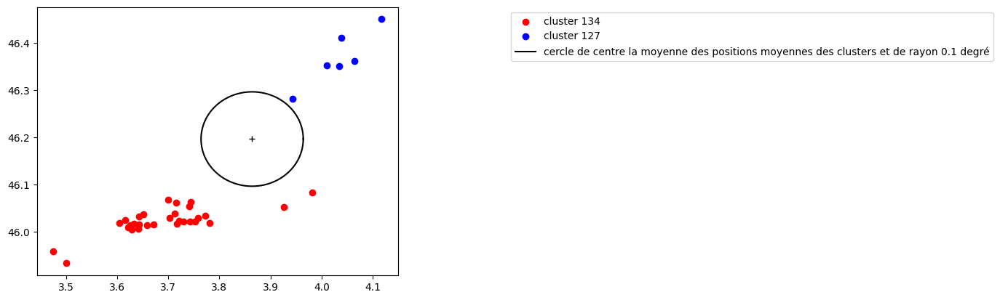

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333 

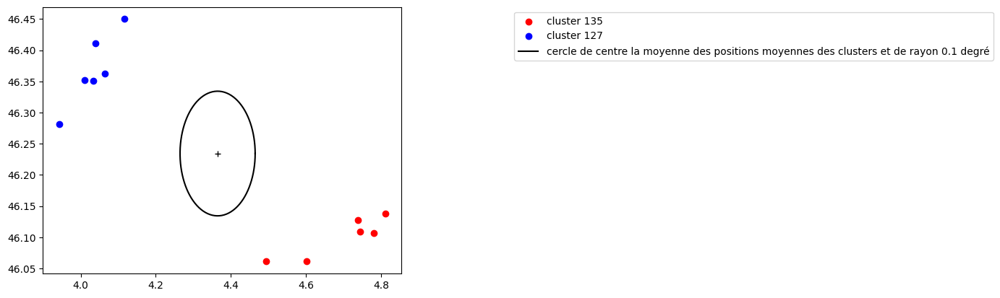

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135


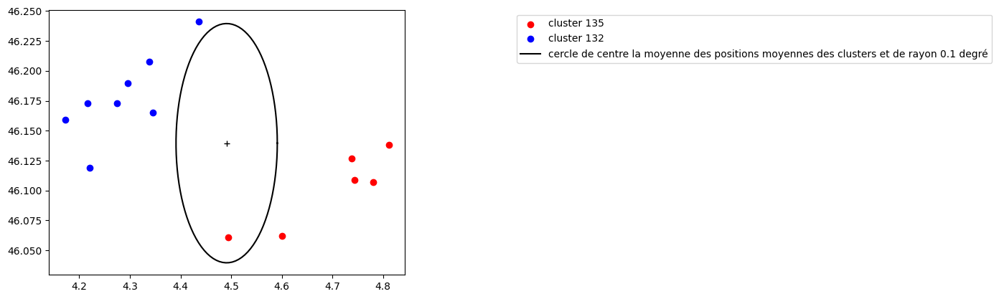

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135


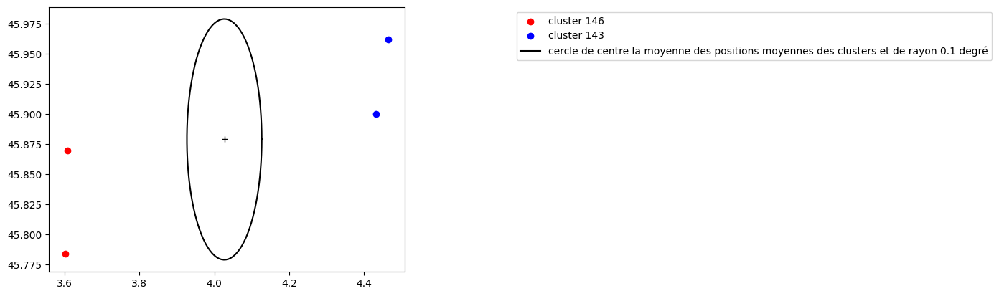

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


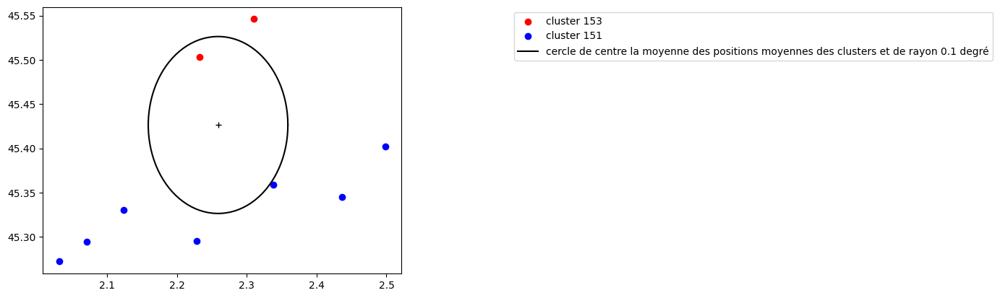

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5559  134928.916667    45.402      2.498     151
5565  134928.716667    45.345      2.436     151
5567       134928.5    45.359      2.338     151
5568      134928.35    45.295      2.228     151
5576      134927.95    45.294      2.071     151
5578  134927.916667    45.272      2.031     151
5579  134927.916667    45.330      2.124     151
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5601       134927.0    45.546      2.310     153
5605  134926.916667    45.503      2.232     153


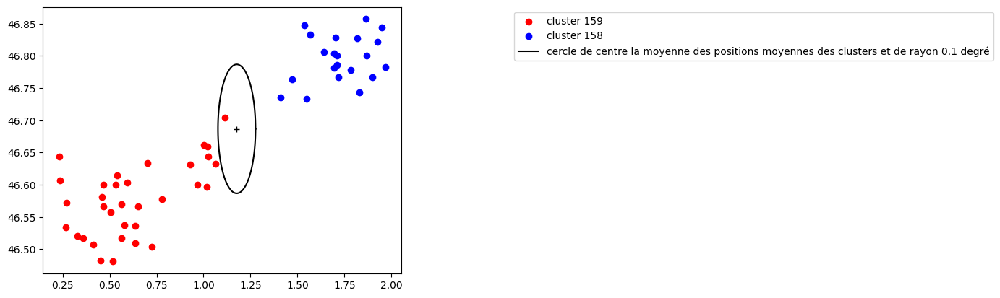

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6484  134667.416667    46.844      1.947     158
6485  134667.333333    46.857      1.865     158
6486  134667.216667    46.783      1.967     158
6487       134667.2    46.743      1.830     158
6488       134667.2    46.822      1.924     158
6489  134667.166667    46.827      1.817     158
6490  134667.166667    46.767      1.900     158
6491      134667.15    46.800      1.867     158
6492  134667.083333    46.778      1.784     158
6493       134667.0    46.804      1.695     158
6494       134667.0    46.828      1.704     158
6495       134667.0    46.786      1.711     158
6496       134667.0    46.801      1.710     158
6497  134666.983333    46.767      1.717     158
6498  134666.966667    46.781      1.693     158
6499      134666.95    46.847      1.538     158
6500      134666.95    46.806      1.639     158
6501      134666.95    46.833      1.567     158
6503  134666.766667    46.733      1.550     158
6505       134666.7 

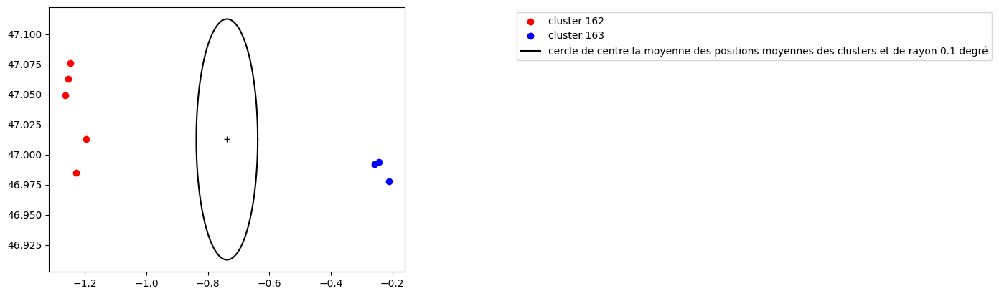

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162


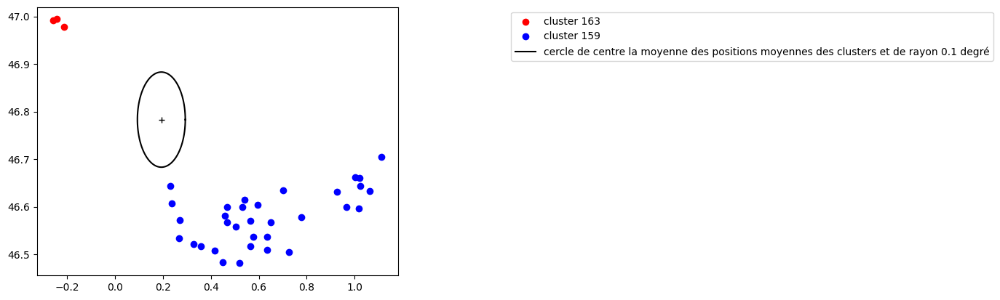

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

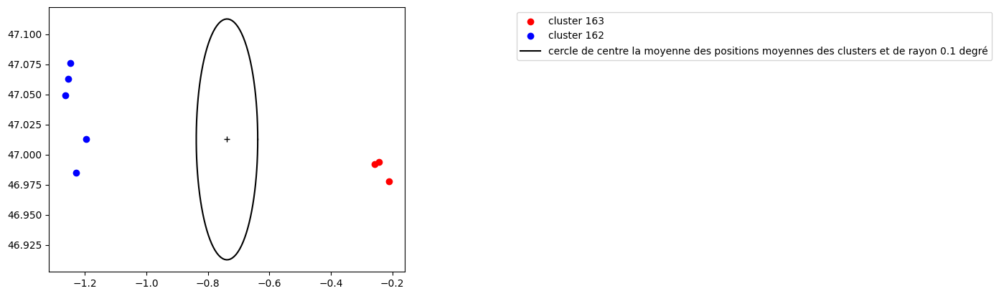

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6532       134665.3    47.076     -1.248     162
6537      134665.25    47.063     -1.255     162
6540  134665.216667    47.049     -1.265     162
6557       134665.0    47.013     -1.196     162
6561  134664.916667    46.985     -1.228     162
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163


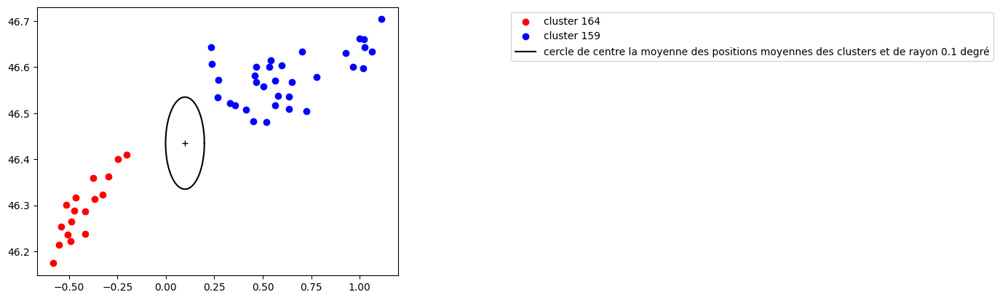

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

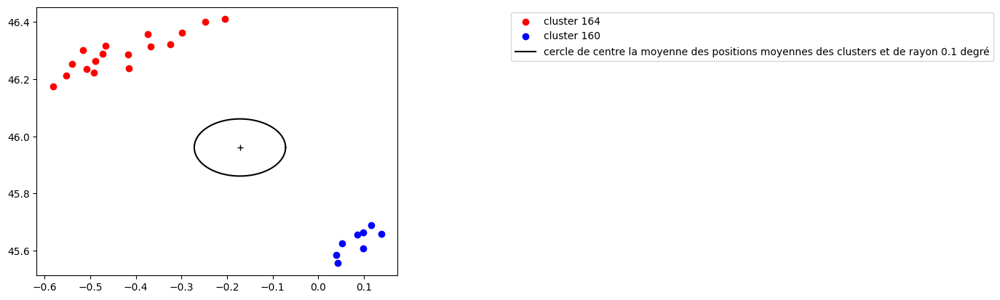

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333 

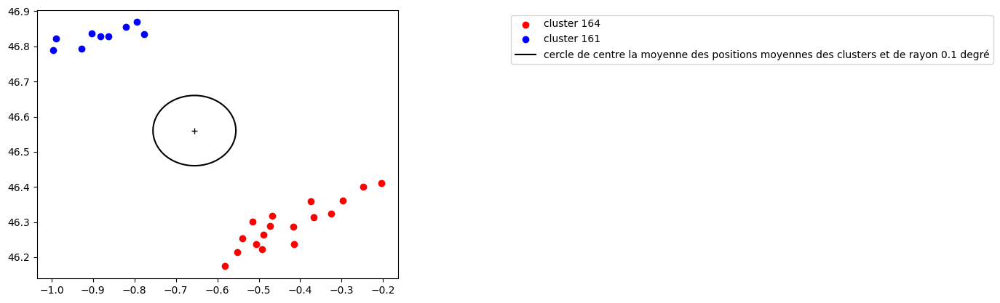

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333 

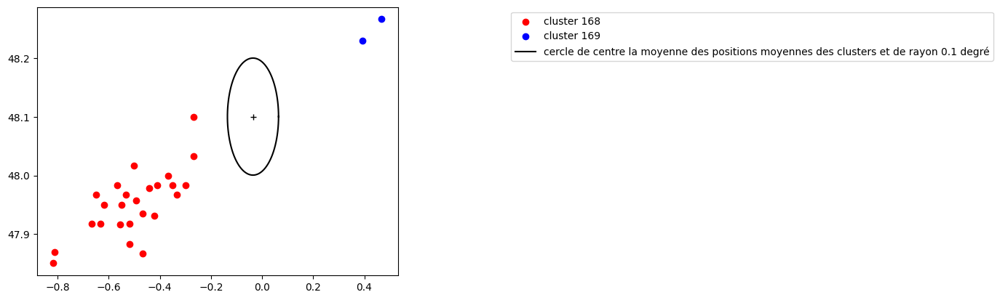

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15 

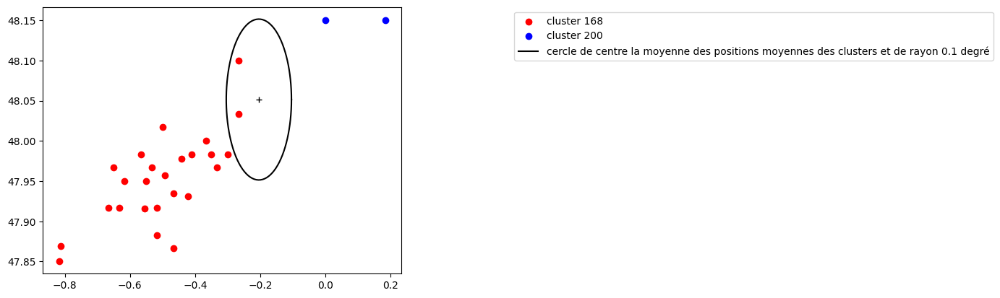

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6728  134605.766667     48.15      0.183     200
6737  134604.783333     48.15      0.000     200
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15 

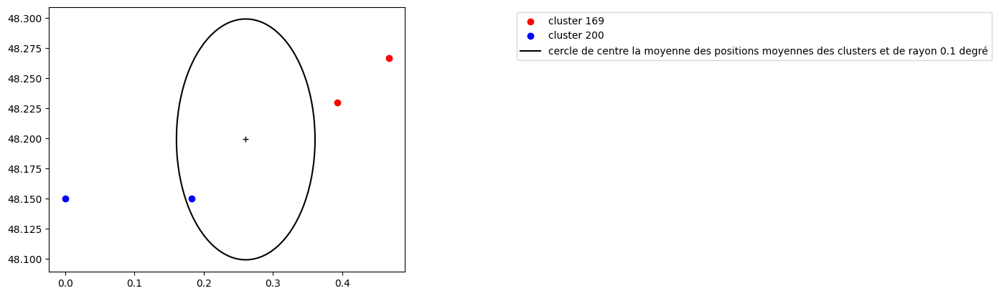

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6728  134605.766667     48.15      0.183     200
6737  134604.783333     48.15      0.000     200
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169


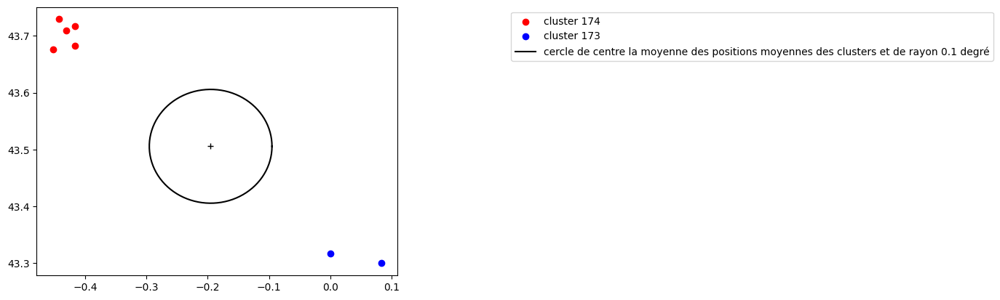

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6952       134496.4    43.300      0.083     173
6953  134496.183333    43.317      0.000     173
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174


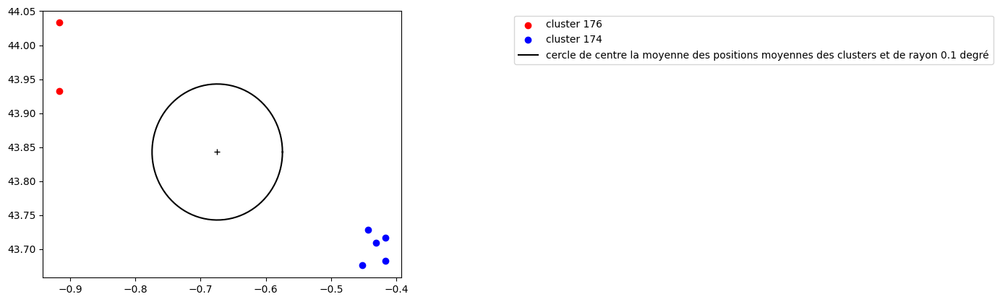

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6972  134493.666667    43.933     -0.917     176
6979       134493.2    44.033     -0.917     176


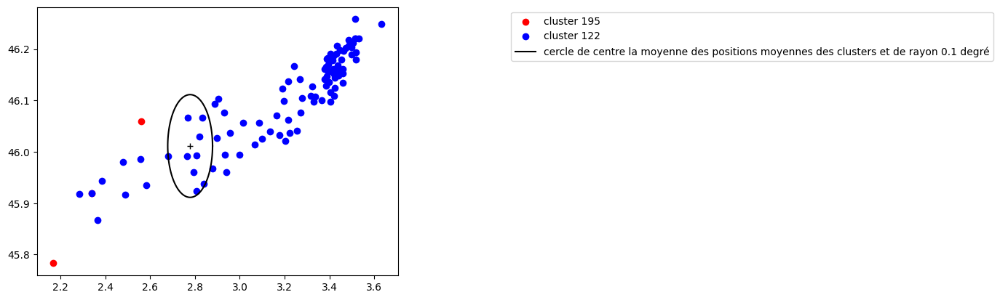

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]
     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5264   134976.7    45.783      2.168     195
5316   134975.5    46.059      2.562     195
5325  134975.25    45.919      2.341     195


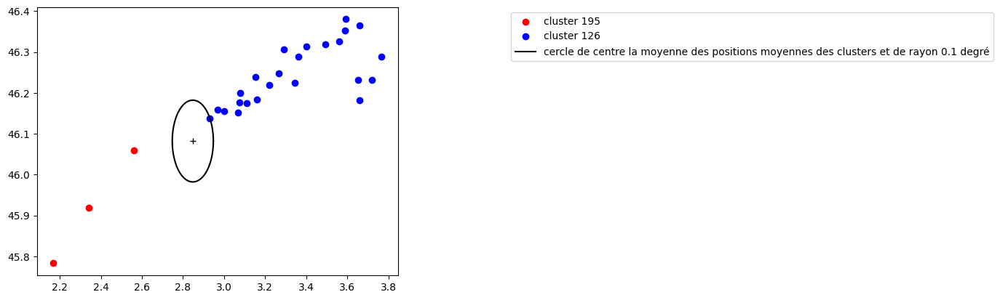

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.199      3.080     126
5279      134976.35    46.176      3.074     126
5281  134976.333333    46.231      3.718     126
5282  134976.283333 

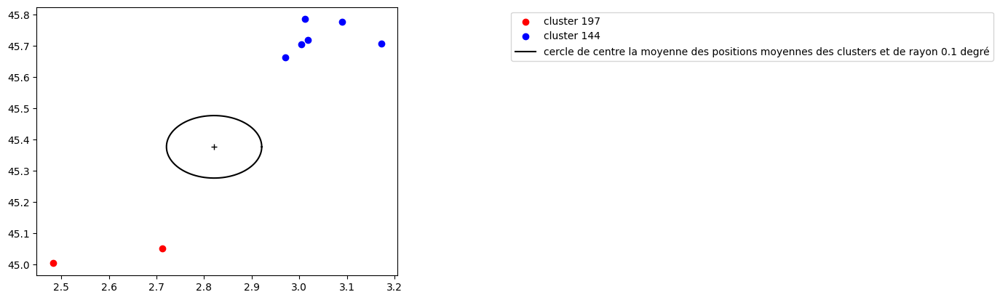

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5464      134953.25    45.777      3.089     144
5466  134953.166667    45.785      3.012     144
5467  134953.166667    45.707      3.172     144
5470  134952.916667    45.718      3.018     144
5471  134952.916667    45.704      3.004     144
5475  134952.833333    45.662      2.971     144
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5523  134951.016667    45.052      2.712     197
5527  134950.583333    45.004      2.483     197


In [ ]:
pipe_fusion_FR_time(visu_results_ter,3)

# 3ème test fusion

In [ ]:
visu_results_essai_3 = visu_results.copy()

In [ ]:
def sens(df):

  #première étape : trouver la direction de l'orage (est ou ouest)
  #on va à l'est si longi(n+1)>longi(n)
  n = len(df)
  c = 0

  for i in range(n-1):
    if df.iloc[i+1,2] - df.iloc[i,2] <0: #on va vers l'Est car le temps diminue quand i augmente
      c+=1

  if c>= (n-1)//2:
    return 1
  else:
    return 0


In [ ]:
def condition_tempo(visu_results,cluster1,cluster2):

  orage1 = visu_results[visu_results.CLASSI == cluster1]
  orage2 = visu_results[visu_results.CLASSI == cluster2]

  temps1 = np.mean(orage1.TIME_EVENT)
  temps2 = np.mean(orage2.TIME_EVENT)
  
  sens1 = sens(orage1)
  sens2 = sens(orage2)

  if sens1 == sens2:

    if sens1==1: #on va vers l'est

      if temps1 < temps2: #orage1 a lieu avant le 2
        return np.mean(orage1.LONGITUDE) < np.mean(orage2.LONGITUDE)

      else:
        return np.mean(orage1.LONGITUDE) > np.mean(orage2.LONGITUDE)

    else: #on va vers l'ouest
      if temps1 < temps2: #orage1 a lieu avant le 2
        return np.mean(orage1.LONGITUDE) > np.mean(orage2.LONGITUDE)

      else:
        return np.mean(orage1.LONGITUDE) < np.mean(orage2.LONGITUDE)

  else:
    return False

In [ ]:
def fusion4(visu_results,cluster1,cluster2,seuil_pente_degre = 30,seuil_distance = 1,type = "moyenne",
            seuil_temps = 3,seuil_densite = 70,c = 0.1):

  L = [condition_temps2(visu_results,cluster1,cluster2,seuil_temps),condition_distance(visu_results,cluster1,cluster2,seuil_distance,type),
       condition_pente(visu_results,cluster1,cluster2,seuil_pente_degre),condition_densite(visu_results,cluster1,cluster2,seuil_densite,c),
       condition_tempo(visu_results,cluster1,cluster2)]
  return sum(L) == len(L)

In [ ]:
#fusion cluster cluster
def fusion_recur(visu_results,temps):
  n = max(visu_results['CLASSI'])
  fus = []
  compteur = 0
  total = n+1
  for i in range(0,n+1):
    t_mean = np.mean(visu_results[visu_results.CLASSI == i].TIME_EVENT)
    sub_data = visu_results[(visu_results.TIME_EVENT < t_mean + temps) & (visu_results.TIME_EVENT > t_mean)]
    orages = np.unique(sub_data.CLASSI)
    orages_true = orages[1:]
    orages_true_true = [x for x in orages_true if x!=i]
    for j in orages_true_true:
      fus.append([i,j,fusion4(visu_results,i,j)])
    compteur +=1
    if compteur == total//4:
      print('25%')
    elif compteur == total//2:
      print('50%')
    elif compteur == (3*total)//4:
      print('75%')

  return fus,renvoie_true(fus)
      

In [ ]:
def pipe_fusion_recur(visu_results,temps):
  fus_r,true_fus_r = fusion_recur(visu_results,temps)
  if len(true_fus_r) == 0:
    print('pas de fusion')
  else:
    n = len(true_fus_r)
    print('NOMBRES DE FUSIONS CANDIDATS :')
    print(n)
    for i in range(n):
      fus_plot(visu_results,true_fus_r[i][0],true_fus_r[i][1])
      print(visu_results[visu_results.CLASSI == true_fus_r[i][1]])
      print(visu_results[visu_results.CLASSI == true_fus_r[i][0]])
    return true_fus_r

25%
50%
75%
NOMBRES DE FUSIONS CANDIDATS :
20


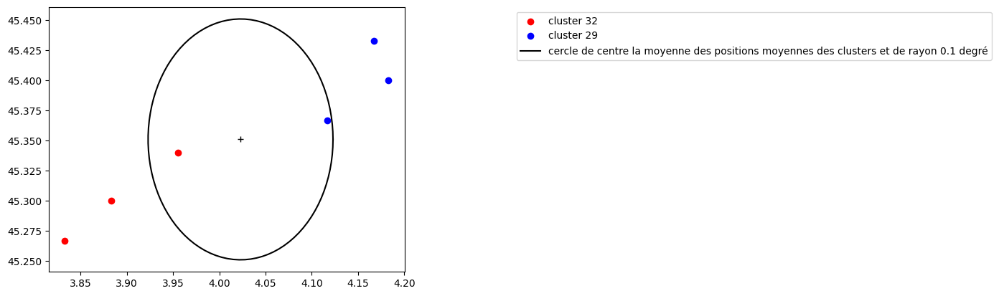

        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
977  136746.333333    45.400      4.183      29
978      136746.25    45.433      4.167      29
982  136745.966667    45.367      4.117      29
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
984  136745.666667    45.340      3.955      32
988  136745.483333    45.300      3.883      32
989  136745.416667    45.267      3.833      32


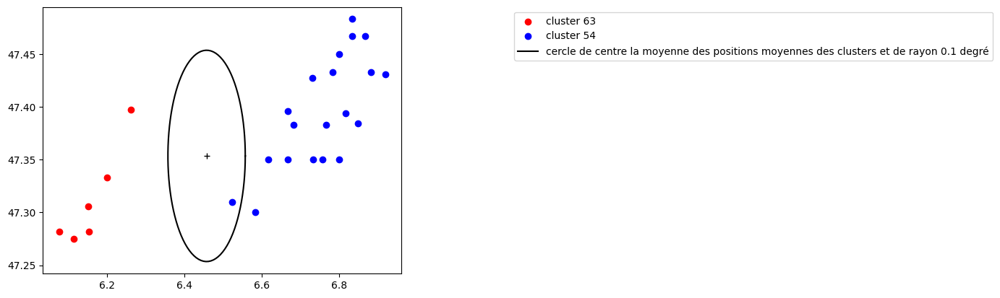

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3212  135507.833333    47.433      6.883      54
3213      135507.75    47.483      6.833      54
3214      135507.75    47.431      6.919      54
3215  135507.733333    47.467      6.867      54
3216       135507.7    47.433      6.783      54
3217  135507.683333    47.467      6.833      54
3218  135507.666667    47.384      6.849      54
3219      135507.65    47.394      6.817      54
3220  135507.616667    47.350      6.800      54
3221       135507.6    47.383      6.767      54
3222  135507.583333    47.350      6.757      54
3223  135507.566667    47.450      6.800      54
3224      135507.55    47.350      6.733      54
3225      135507.55    47.427      6.731      54
3226       135507.5    47.383      6.683      54
3227       135507.5    47.396      6.668      54
3228  135507.466667    47.350      6.617      54
3229      135507.45    47.350      6.667      54
3230  135507.416667    47.300      6.583      54
3231  135507.333333 

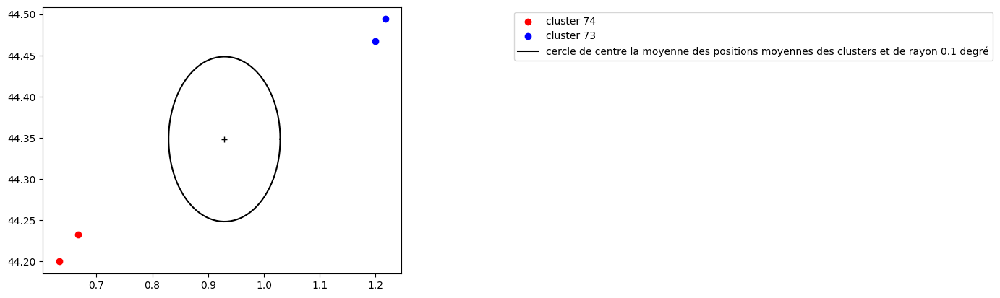

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74


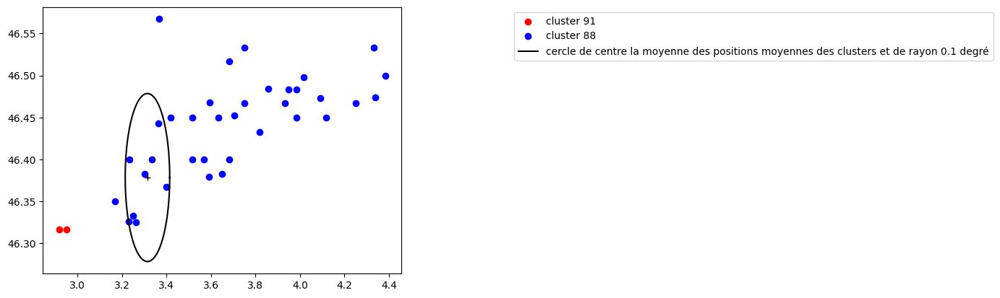

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      88
3833  135381.733333    46.474      4.339      88
3834  135381.666667    46.533      4.333      88
3836  135381.583333    46.467      4.250      88
3839  135381.433333    46.473      4.090      88
3840  135381.416667    46.450      4.117      88
3848  135381.383333    46.498      4.018      88
3852  135381.316667    46.483      3.950      88
3853       135381.3    46.450      3.983      88
3854       135381.3    46.483      3.983      88
3856  135381.283333    46.467      3.933      88
3861  135381.183333    46.484      3.858      88
3868  135381.083333    46.467      3.750      88
3869  135381.083333    46.433      3.817      88
3874  135381.016667    46.400      3.683      88
3875  135381.016667    46.383      3.650      88
3876       135381.0    46.533      3.750      88
3877       135381.0    46.452      3.703      88
3884      135380.95    46.567      3.367      88
3886  135380.933333 

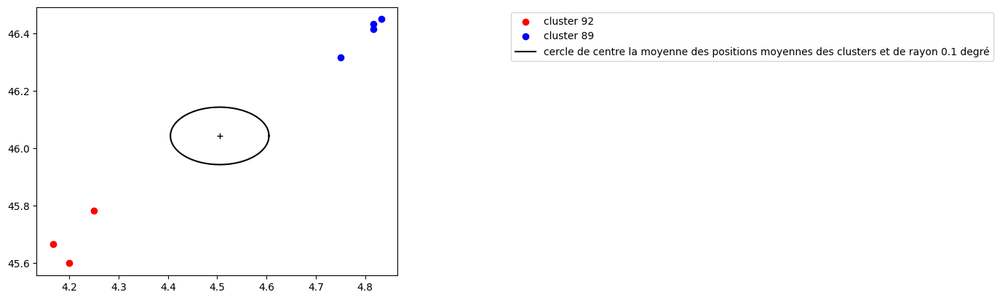

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92


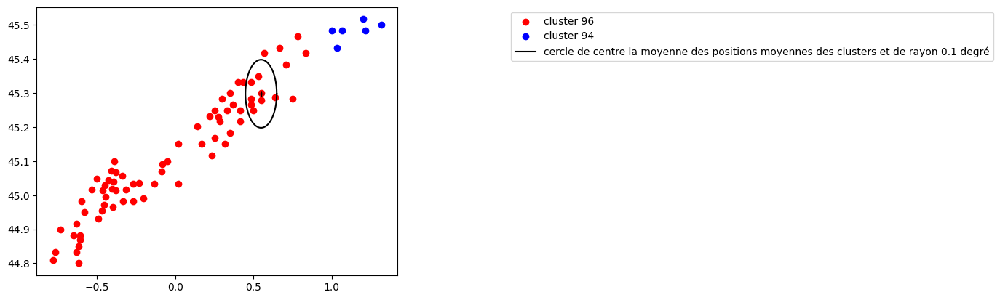

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      94
3958  135363.433333    45.517      1.200      94
3959  135363.416667    45.483      1.217      94
3968  135363.166667    45.483      1.067      94
3969  135363.133333    45.433      1.033      94
3970  135363.083333    45.483      1.000      94
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]


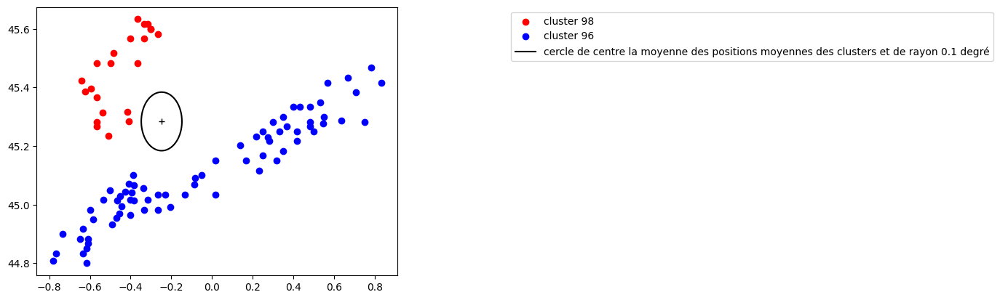

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3972  135362.833333    45.417      0.833      96
3973  135362.783333    45.467      0.783      96
3974  135362.783333    45.383      0.708      96
3976       135362.7    45.433      0.667      96
3977  135362.666667    45.283      0.750      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[73 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      

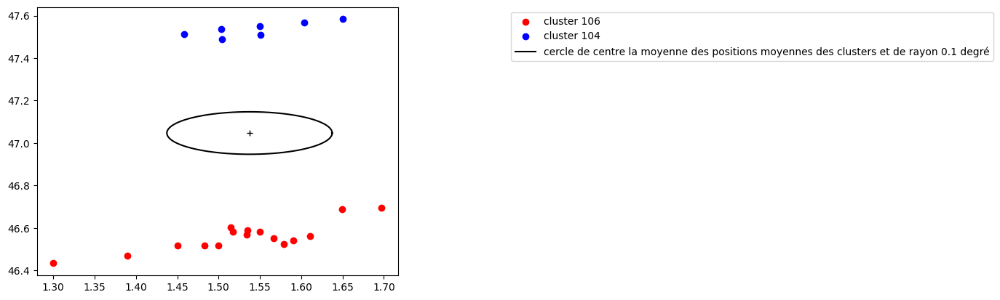

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333 

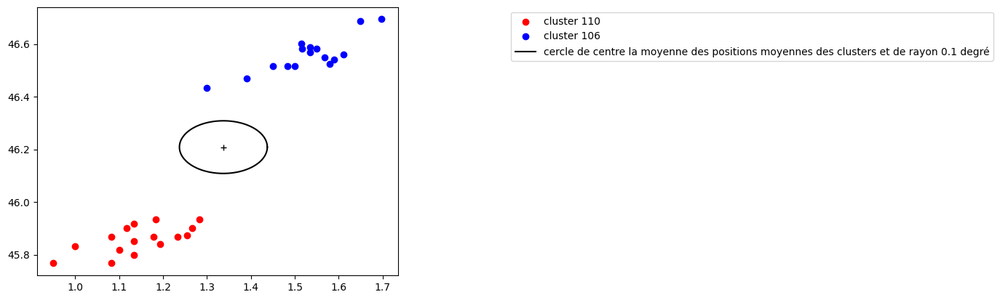

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333 

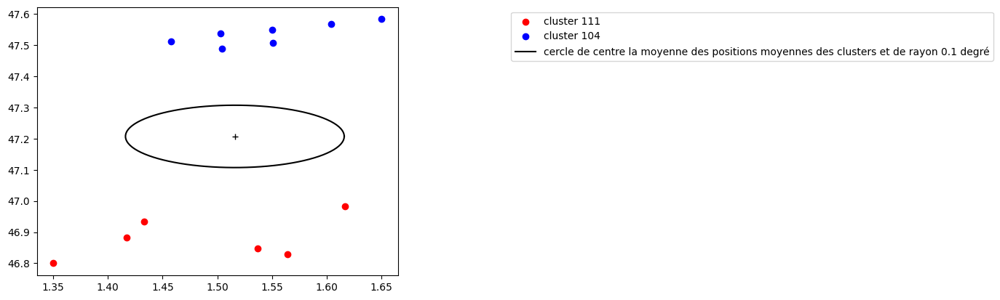

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111


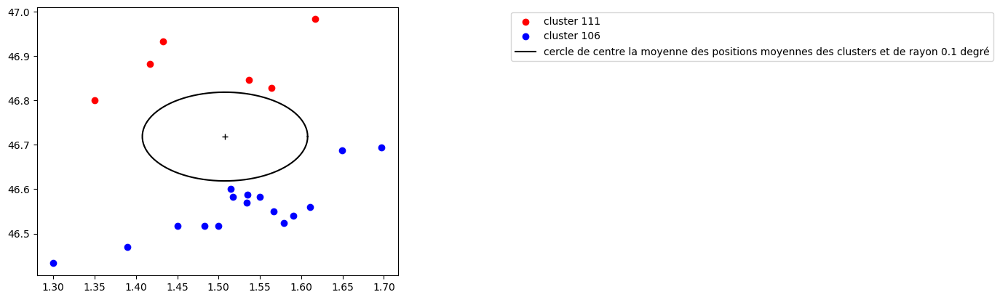

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

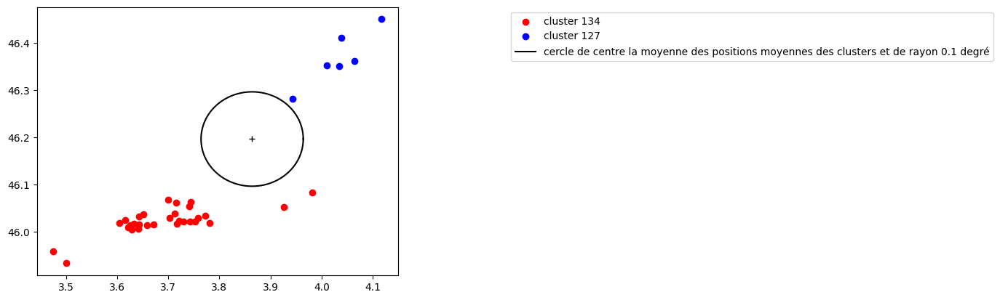

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333 

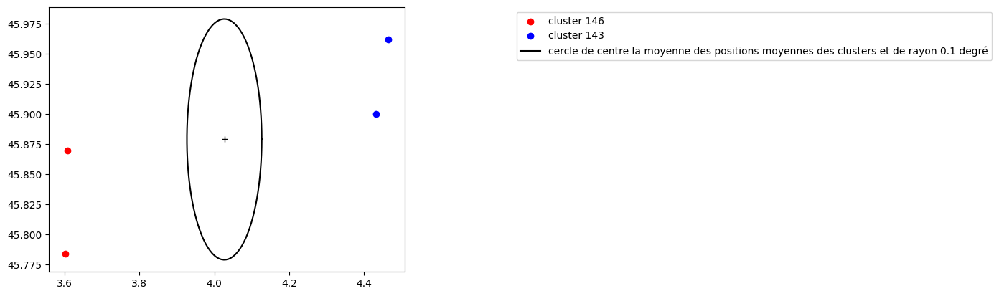

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


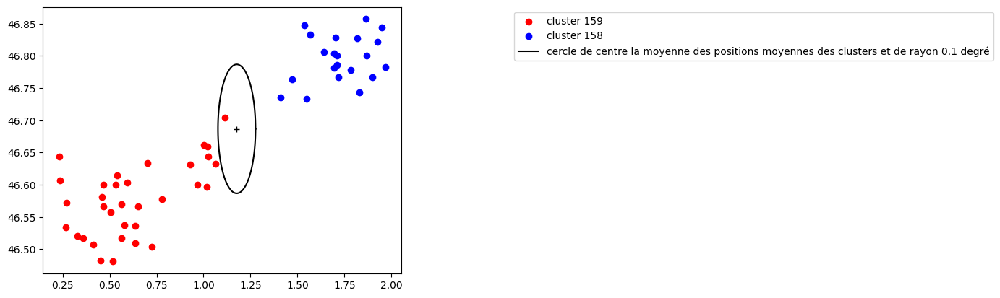

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6484  134667.416667    46.844      1.947     158
6485  134667.333333    46.857      1.865     158
6486  134667.216667    46.783      1.967     158
6487       134667.2    46.743      1.830     158
6488       134667.2    46.822      1.924     158
6489  134667.166667    46.827      1.817     158
6490  134667.166667    46.767      1.900     158
6491      134667.15    46.800      1.867     158
6492  134667.083333    46.778      1.784     158
6493       134667.0    46.804      1.695     158
6494       134667.0    46.828      1.704     158
6495       134667.0    46.786      1.711     158
6496       134667.0    46.801      1.710     158
6497  134666.983333    46.767      1.717     158
6498  134666.966667    46.781      1.693     158
6499      134666.95    46.847      1.538     158
6500      134666.95    46.806      1.639     158
6501      134666.95    46.833      1.567     158
6503  134666.766667    46.733      1.550     158
6505       134666.7 

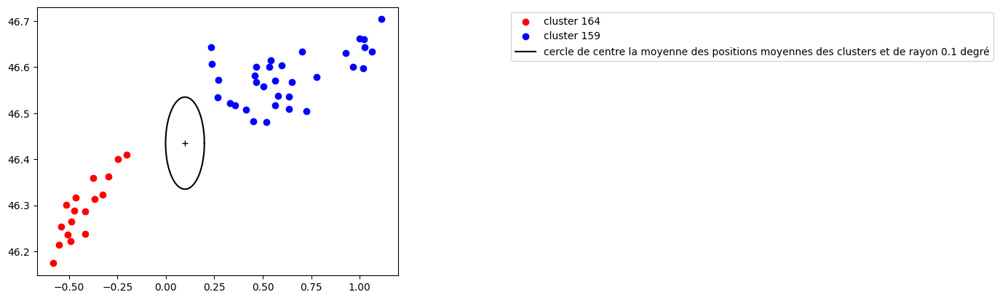

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6507  134666.283333    46.704      1.112     159
6508  134666.166667    46.660      1.020     159
6509  134666.166667    46.633      1.062     159
6510  134666.166667    46.644      1.025     159
6511  134666.133333    46.662      1.001     159
6512  134666.033333    46.597      1.017     159
6513       134666.0    46.600      0.967     159
6515       134666.0    46.631      0.927     159
6516       134665.7    46.578      0.777     159
6518  134665.583333    46.504      0.725     159
6520       134665.5    46.567      0.650     159
6523       134665.5    46.634      0.702     159
6524  134665.466667    46.536      0.635     159
6526      134665.45    46.509      0.636     159
6528  134665.433333    46.537      0.577     159
6531  134665.333333    46.517      0.564     159
6534  134665.283333    46.604      0.596     159
6535      134665.25    46.570      0.564     159
6538      134665.25    46.600      0.533     159
6539      134665.25 

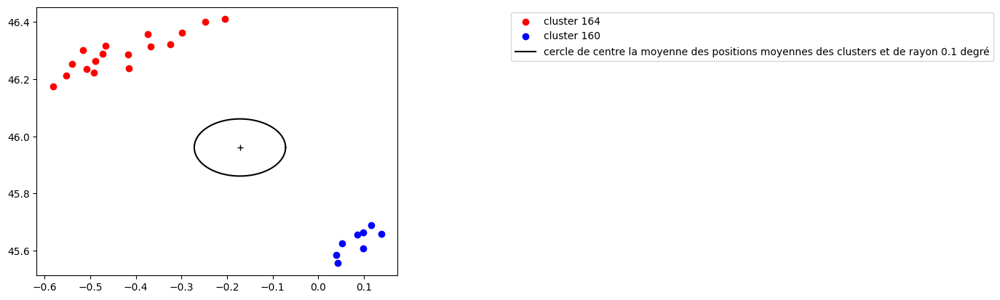

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6517  134665.583333    45.689      0.115     160
6519       134665.5    45.659      0.138     160
6521       134665.5    45.665      0.098     160
6522       134665.5    45.656      0.085     160
6525      134665.45    45.608      0.098     160
6527  134665.433333    45.626      0.052     160
6529  134665.333333    45.586      0.040     160
6536      134665.25    45.556      0.042     160
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6569  134664.083333    46.400     -0.248     164
6570  134663.916667    46.410     -0.204     164
6571  134663.666667    46.362     -0.298     164
6572  134663.666667    46.323     -0.325     164
6573       134663.5    46.314     -0.367     164
6574  134663.466667    46.359     -0.374     164
6575  134663.416667    46.287     -0.416     164
6576  134663.333333    46.301     -0.515     164
6577  134663.333333    46.317     -0.467     164
6578  134663.333333    46.238     -0.415     164
6579  134663.333333 

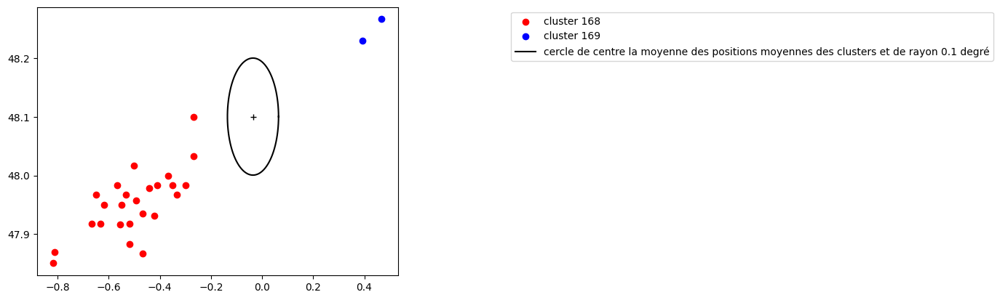

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15 

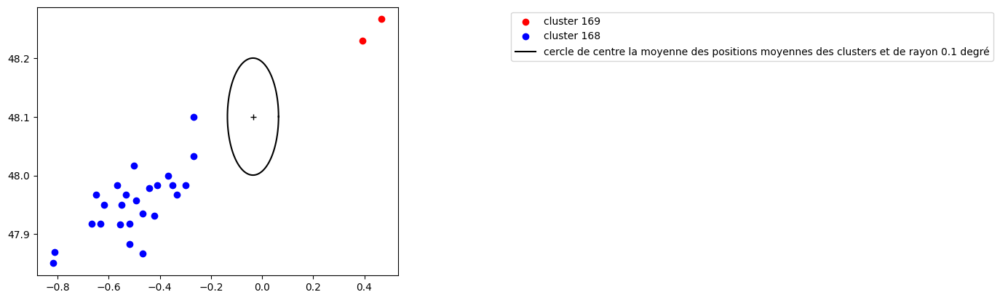

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15    47.978     -0.441     168
6748       134604.1    47.957     -0.493     168
6749  134604.083333    47.916     -0.556     168
6750  134604.083333 

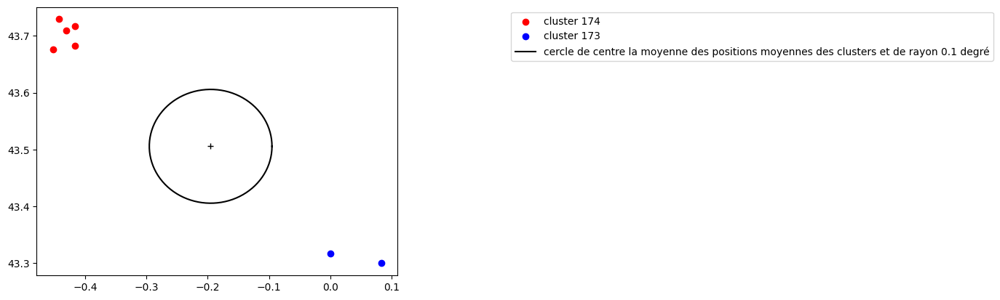

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6952       134496.4    43.300      0.083     173
6953  134496.183333    43.317      0.000     173
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174


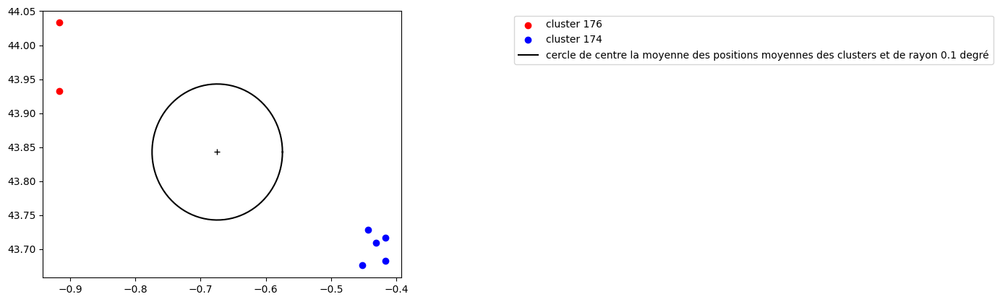

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6972  134493.666667    43.933     -0.917     176
6979       134493.2    44.033     -0.917     176


In [ ]:
fusion_candi = pipe_fusion_recur(visu_results_essai_3,3)

In [ ]:
ok_fusion = [[32, 29],[63,54],[91, 88],
 [96, 94],[110,106],[134,129],[146,143],[164,159],[159,158]]

In [ ]:
#ok avec les anciens essais de fusion, cohérent

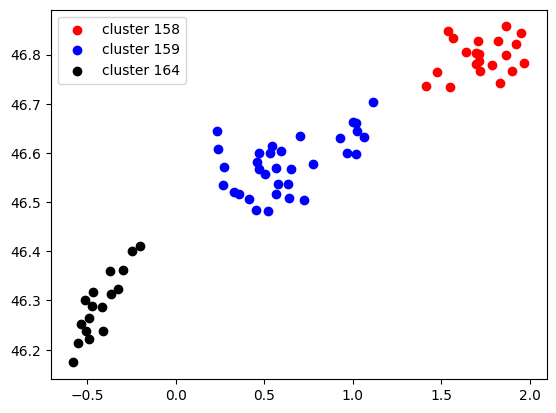

In [ ]:
  longi1 = visu_results[visu_results.CLASSI == 158].LONGITUDE.values
  lati1 = visu_results[visu_results.CLASSI == 158].LATITUDE.values

  longi2 = visu_results[visu_results.CLASSI == 159].LONGITUDE.values
  lati2 = visu_results[visu_results.CLASSI == 159].LATITUDE.values

  longi3 = visu_results[visu_results.CLASSI == 164].LONGITUDE.values
  lati3 = visu_results[visu_results.CLASSI == 164].LATITUDE.values

  plt.scatter(longi1,lati1,color = 'red',label = 'cluster 158')
  plt.scatter(longi2,lati2,color = 'blue',label = 'cluster 159')
  plt.scatter(longi3,lati3,color = 'black',label = 'cluster 164')
  plt.legend()

In [ ]:
big_orage = visu_results_essai_3[(visu_results_essai_3.CLASSI == 158) | (visu_results_essai_3.CLASSI == 159) | (visu_results_essai_3.CLASSI == 164)]

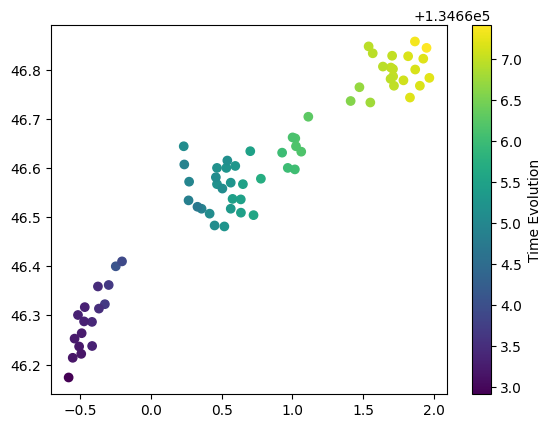

In [ ]:
lati = big_orage.LATITUDE
longi = big_orage.LONGITUDE
temps = big_orage.TIME_EVENT

plt.scatter(longi,lati,c = temps)
cbar = plt.colorbar()
cbar.set_label('Time Evolution')

In [ ]:
#on valide la fusion des 3 clusters

In [ ]:
ok_fusion_bos = [[32, 29],[63,54],[91, 88],
 [96, 94],[110,106],[134,129],[146,143],[164,159,158]]

In [ ]:
def update_classi(visu_results,ok_fusion):
  for e in ok_fusion:
    if len(e) == 2:
      a,b = e[0],e[1]
      indices = visu_results[visu_results.CLASSI == b].index
      for z in indices:
        visu_results.loc[z,'CLASSI'] = a
    elif len(e) == 3:
      a,b,c = e[0],e[1],e[2]
      indices = visu_results[(visu_results.CLASSI == b) | (visu_results.CLASSI == c)].index
      for z in indices:
        visu_results.loc[z,'CLASSI'] = a
  return visu_results

In [ ]:
visu_results_essai_3 = update_classi(visu_results_essai_3,ok_fusion_bos)

In [ ]:
visu_results_essai_3

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,181
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
np.unique(visu_results_essai_3.CLASSI, return_counts = True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  89,  90,  91,
         92,  93,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104, 105,
        106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118,
        119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131,
        132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144,
        145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157,
        160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172,
        173, 174, 175, 176, 177, 178, 179, 180, 181

## côté poubelle

In [ ]:
def condition_densite_poubelle_min(visu_results,rapport,cluster1,seuil_densite = 70,c = 0.1):

  orage = visu_results[visu_results.CLASSI == cluster1]

  # trouver le rapport le plus proche de celui dans la poubelle
  distances = [np.sqrt((orage.iloc[i,1]-rapport[1])**2 + (orage.iloc[i,2]-rapport[2])**2) for i in range(len(orage))]
  proche = distances.index(min(distances))
  plus_proche = orage.iloc[proche,:]

  # on calcule la moitié du segment entre ces deux rapports 
  lat_mean = (plus_proche[1] + rapport[1])/2
  long_mean = (plus_proche[2] + rapport[2])/2

  # on définit un carré autour de notre position moyenne 

  lat_mean_up,lat_mean_down = lat_mean+c,lat_mean-c
  long_mean_up,long_mean_down = long_mean+c,long_mean-c

  # on réduit la taille du dataset démog en sélectionnant les carreaux proches de notre position moyenne entre orages

  demog_2 = demog_use[(demog_use.Latitude < lat_mean_up) & (demog_use.Latitude > lat_mean_down) & (demog_use.Longitude < long_mean_up) & (demog_use.Longitude > long_mean_down)]

  densite_moyenne = demog_2['Ind'].mean() #mean de Ind

  return densite_moyenne < seuil_densite

In [ ]:
def fusion_poubelle_min(visu_results, seuil_distance_minimale):
  trash = visu_results[visu_results.CLASSI == -1]
  n = len(trash)
  candidats = []
  compteur = 0
  for i in range(n):
    candi = []
    rapport = trash.iloc[i,:]
    time_event = rapport[0]
    time_low,time_high = time_event-3,time_event+3 #condition de temps validée
    possibles = visu_results[(visu_results.TIME_EVENT > time_low) &  (visu_results.TIME_EVENT < time_high)]
    clusters_ = np.array(np.unique(possibles.CLASSI.values))
    clusters_poss = clusters_[clusters_ > -1]
    for j in clusters_poss:
      if distance_cluster_rapport(visu_results,rapport,j,'minimale')< seuil_distance_minimale:
        if condition_densite_poubelle_min(visu_results,rapport,j):
          candi.append(j)
          compteur +=1
    if candi != []:
      a = [i,candi]
      candidats.append(a)
  print("NOMBRES DE PROPOSITIONS DE FUSION D'UN RAPPORT POUBELLE AVEC UN CLUSTER : ")
  print(compteur)
  return candidats

In [ ]:
candi_poub = fusion_poubelle_min(visu_results_essai_3,0.5)

NOMBRES DE PROPOSITIONS DE FUSION D'UN RAPPORT POUBELLE AVEC UN CLUSTER : 
61


In [ ]:
candi_poub

[[0, [1]],
 [2, [5]],
 [4, [8]],
 [11, [12]],
 [25, [22]],
 [37, [30]],
 [45, [34]],
 [54, [37]],
 [66, [50]],
 [75, [65]],
 [82, [72]],
 [83, [73]],
 [84, [73, 74]],
 [89, [91]],
 [91, [96, 98]],
 [92, [96, 98]],
 [94, [97]],
 [95, [96, 100, 101]],
 [96, [102]],
 [111, [122, 126, 127]],
 [112, [127]],
 [113, [121]],
 [114, [126, 131, 132]],
 [115, [122, 126]],
 [117, [122, 128, 130]],
 [118, [131]],
 [120, [125, 131]],
 [123, [122, 126]],
 [124, [122, 128, 130]],
 [125, [133]],
 [126, [135]],
 [129, [134, 140]],
 [139, [150]],
 [140, [148]],
 [141, [149]],
 [143, [146, 149]],
 [154, [161, 163]],
 [156, [164]],
 [163, [168, 169]],
 [164, [168]],
 [177, [180]]]

In [ ]:
def plot_cluster_rapport(visu_results,cluster,rapport):
  orage = visu_results[visu_results.CLASSI == cluster]
  ## on trace l'orage et sa trajectoire régressée
  temps = [orage.iloc[i,0] - orage.iloc[-1,0] for i in range(len(orage))]
  plt.scatter(orage.LONGITUDE,orage.LATITUDE,c = temps, label = 'cluster candidat '+str(cluster))
  cbar = plt.colorbar()
  cbar.set_label('Time Evolution')
  plt.scatter(rapport[2],rapport[1],marker ='x', linewidth = 3,color = 'red',label = 'rapport poubelle')
  plt.legend()
  plt.show()

In [ ]:
def plot_cluster_rapport_all(visu_results,candi_trash):
  poubelle = visu_results[visu_results.CLASSI == -1]
  n = len(candi_trash)
  for i in range(n):
    report_index = candi_trash[i][0]
    candi = candi_trash[i][1]
    print("ON TESTE LE RAPPORT D'INDICE",report_index,"DANS LE CLUSTER POUBELLE")
    for j in candi:
      plot_cluster_rapport(visu_results,j,poubelle.iloc[report_index,:])
      print('rapport dans poubelle',poubelle.iloc[report_index,:])
      print(visu_results[visu_results.CLASSI == j])

ON TESTE LE RAPPORT D'INDICE 0 DANS LE CLUSTER POUBELLE


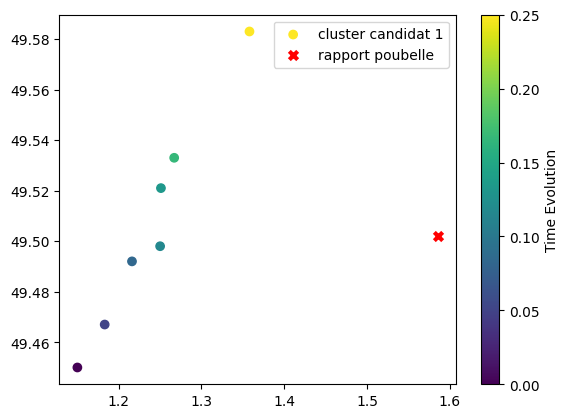

rapport dans poubelle TIME_EVENT    138356.966667
LATITUDE             49.502
LONGITUDE             1.586
CLASSI                   -1
Name: 26, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4   138358.416667    49.583      1.358       1
5   138358.333333    49.533      1.267       1
6        138358.3    49.521      1.251       1
7   138358.283333    49.498      1.250       1
8       138358.25    49.492      1.216       1
9   138358.216667    49.467      1.183       1
10  138358.166667    49.450      1.150       1
ON TESTE LE RAPPORT D'INDICE 2 DANS LE CLUSTER POUBELLE


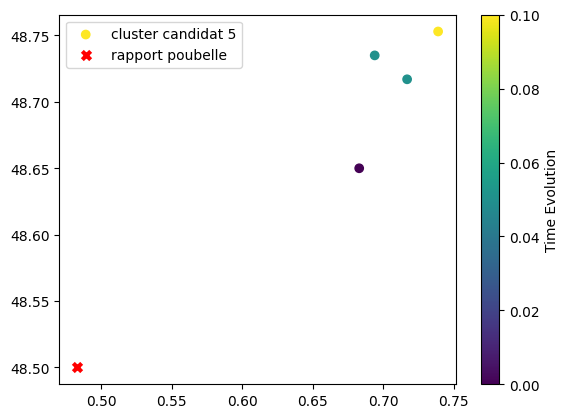

rapport dans poubelle TIME_EVENT    138356.416667
LATITUDE               48.5
LONGITUDE             0.483
CLASSI                   -1
Name: 30, dtype: object
   TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
42  138355.75    48.753      0.739       5
43   138355.7    48.735      0.694       5
44   138355.7    48.717      0.717       5
45  138355.65    48.650      0.683       5
ON TESTE LE RAPPORT D'INDICE 4 DANS LE CLUSTER POUBELLE


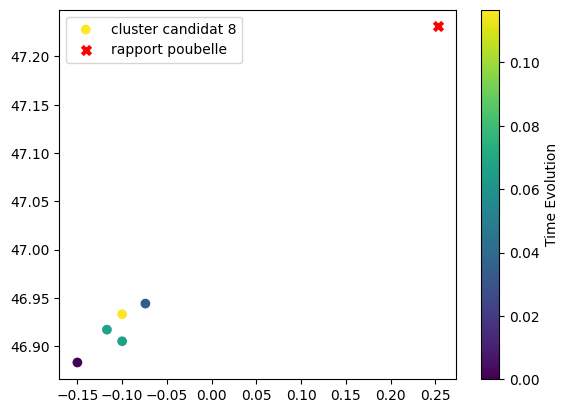

rapport dans poubelle TIME_EVENT    138284.133333
LATITUDE             47.231
LONGITUDE             0.253
CLASSI                   -1
Name: 55, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
56       138283.5    46.933     -0.100       8
57      138283.45    46.905     -0.100       8
58      138283.45    46.917     -0.117       8
59  138283.416667    46.944     -0.074       8
60  138283.383333    46.883     -0.150       8
ON TESTE LE RAPPORT D'INDICE 11 DANS LE CLUSTER POUBELLE


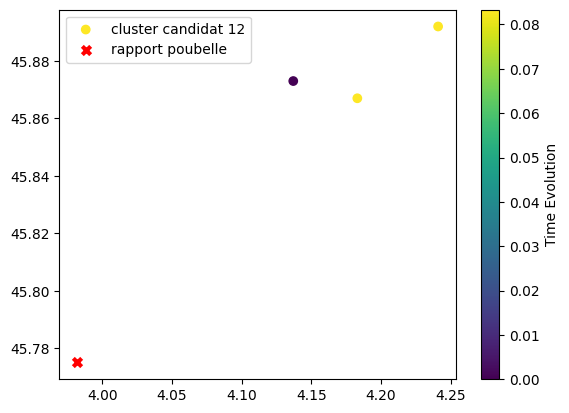

rapport dans poubelle TIME_EVENT    137252.666667
LATITUDE             45.775
LONGITUDE             3.982
CLASSI                   -1
Name: 404, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
401      137252.75    45.867      4.183      12
402      137252.75    45.892      4.241      12
403  137252.666667    45.873      4.137      12
ON TESTE LE RAPPORT D'INDICE 25 DANS LE CLUSTER POUBELLE


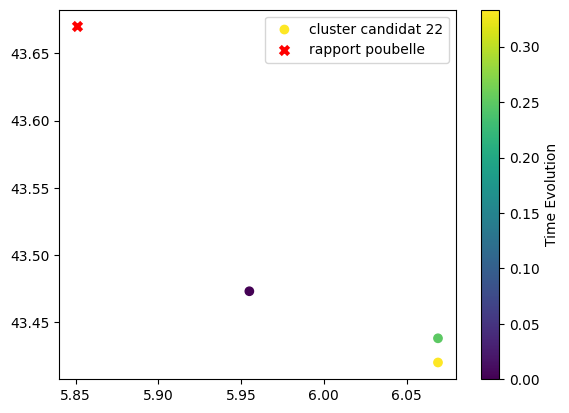

rapport dans poubelle TIME_EVENT    137130.666667
LATITUDE              43.67
LONGITUDE             5.851
CLASSI                   -1
Name: 515, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
512       137132.0    43.420      6.069      22
513  137131.916667    43.438      6.069      22
514  137131.666667    43.473      5.955      22
ON TESTE LE RAPPORT D'INDICE 37 DANS LE CLUSTER POUBELLE


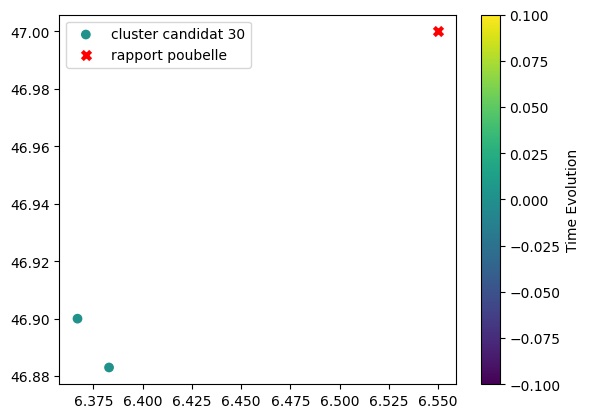

rapport dans poubelle TIME_EVENT    136746.483333
LATITUDE               47.0
LONGITUDE              6.55
CLASSI                   -1
Name: 976, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
980  136746.066667    46.900      6.367      30
981  136746.066667    46.883      6.383      30
ON TESTE LE RAPPORT D'INDICE 45 DANS LE CLUSTER POUBELLE


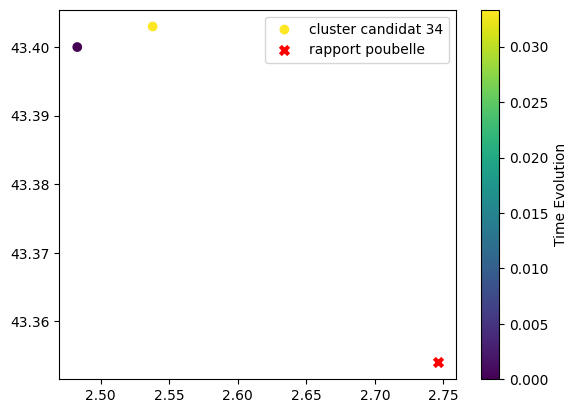

rapport dans poubelle TIME_EVENT    136726.75
LATITUDE         43.354
LONGITUDE         2.746
CLASSI               -1
Name: 1005, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34
ON TESTE LE RAPPORT D'INDICE 54 DANS LE CLUSTER POUBELLE


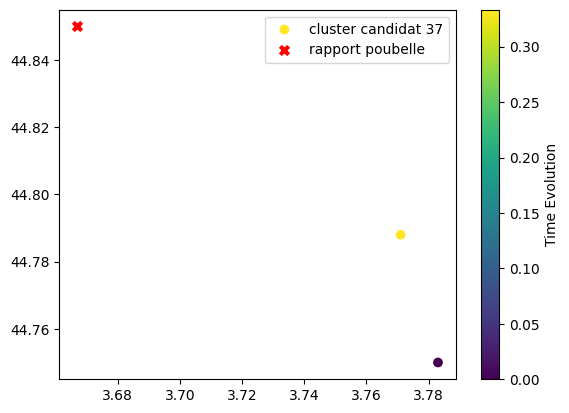

rapport dans poubelle TIME_EVENT    136459.416667
LATITUDE              44.85
LONGITUDE             3.667
CLASSI                   -1
Name: 1224, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1226      136458.25    44.788      3.771      37
1227  136457.916667    44.750      3.783      37
ON TESTE LE RAPPORT D'INDICE 66 DANS LE CLUSTER POUBELLE


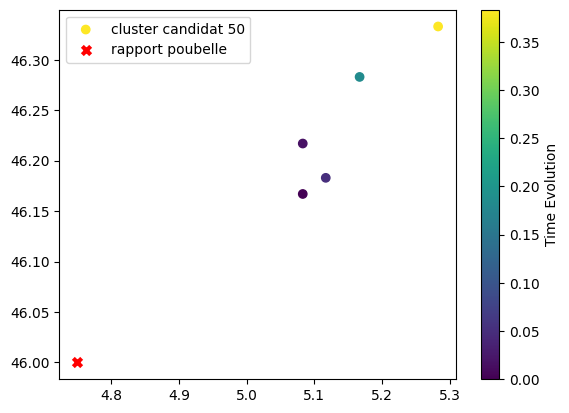

rapport dans poubelle TIME_EVENT    135595.0
LATITUDE          46.0
LONGITUDE         4.75
CLASSI              -1
Name: 2788, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
2755  135595.883333    46.333      5.283      50
2766  135595.683333    46.283      5.167      50
2775      135595.55    46.183      5.117      50
2776  135595.516667    46.217      5.083      50
2777       135595.5    46.167      5.083      50
ON TESTE LE RAPPORT D'INDICE 75 DANS LE CLUSTER POUBELLE


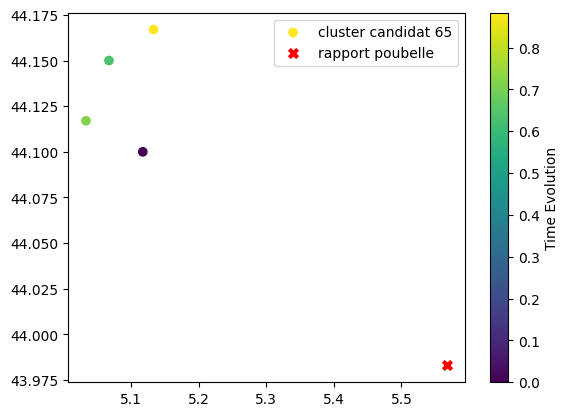

rapport dans poubelle TIME_EVENT    135448.15
LATITUDE         43.983
LONGITUDE         5.567
CLASSI               -1
Name: 3519, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3520  135447.666667    44.167      5.133      65
3521       135447.5    44.117      5.033      65
3522  135447.416667    44.150      5.067      65
3535  135446.783333    44.100      5.117      65
ON TESTE LE RAPPORT D'INDICE 82 DANS LE CLUSTER POUBELLE


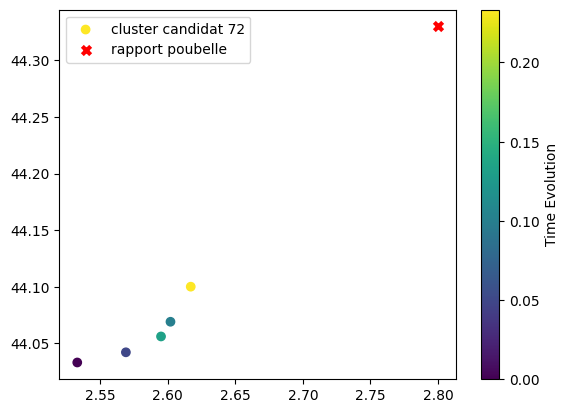

rapport dans poubelle TIME_EVENT    135426.166667
LATITUDE              44.33
LONGITUDE               2.8
CLASSI                   -1
Name: 3618, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3619       135426.0    44.100      2.617      72
3620       135425.9    44.056      2.595      72
3621  135425.866667    44.069      2.602      72
3622  135425.816667    44.042      2.569      72
3623  135425.766667    44.033      2.533      72
ON TESTE LE RAPPORT D'INDICE 83 DANS LE CLUSTER POUBELLE


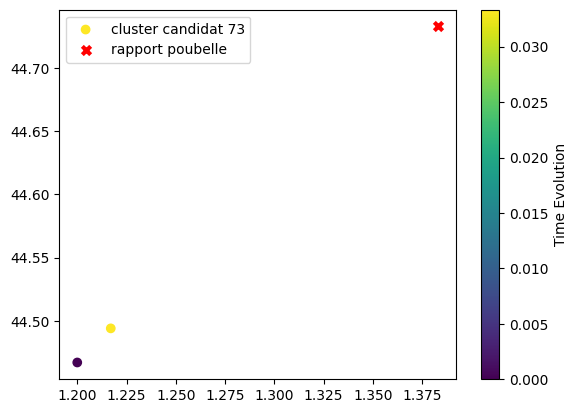

rapport dans poubelle TIME_EVENT    135424.35
LATITUDE         44.733
LONGITUDE         1.383
CLASSI               -1
Name: 3627, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73
ON TESTE LE RAPPORT D'INDICE 84 DANS LE CLUSTER POUBELLE


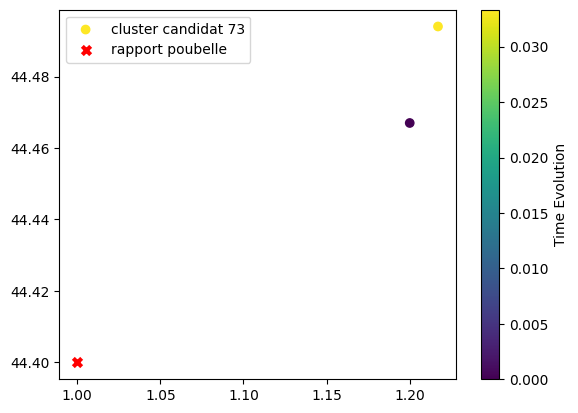

rapport dans poubelle TIME_EVENT    135423.266667
LATITUDE               44.4
LONGITUDE               1.0
CLASSI                   -1
Name: 3630, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3628      135423.75    44.494      1.217      73
3629  135423.716667    44.467      1.200      73


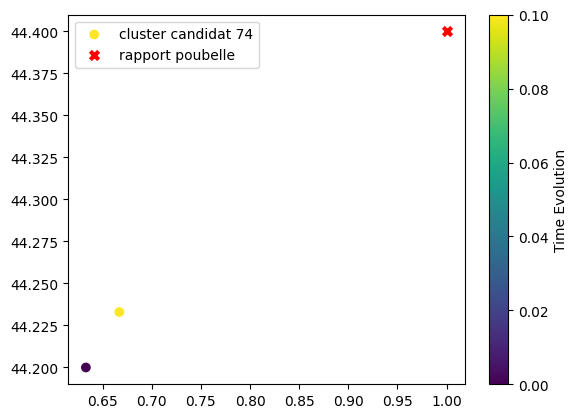

rapport dans poubelle TIME_EVENT    135423.266667
LATITUDE               44.4
LONGITUDE               1.0
CLASSI                   -1
Name: 3630, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3631  135422.383333    44.233      0.667      74
3632  135422.283333    44.200      0.633      74
ON TESTE LE RAPPORT D'INDICE 89 DANS LE CLUSTER POUBELLE


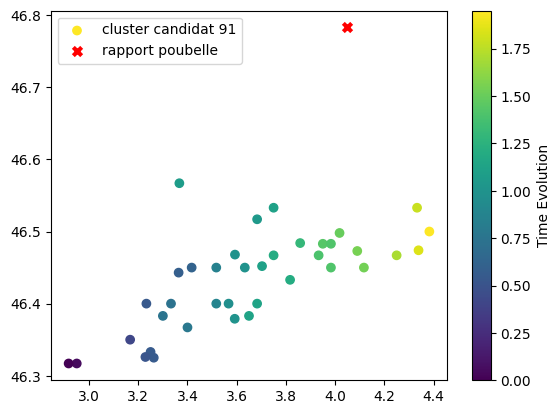

rapport dans poubelle TIME_EVENT    135381.366667
LATITUDE             46.783
LONGITUDE              4.05
CLASSI                   -1
Name: 3849, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      91
3833  135381.733333    46.474      4.339      91
3834  135381.666667    46.533      4.333      91
3836  135381.583333    46.467      4.250      91
3839  135381.433333    46.473      4.090      91
3840  135381.416667    46.450      4.117      91
3848  135381.383333    46.498      4.018      91
3852  135381.316667    46.483      3.950      91
3853       135381.3    46.450      3.983      91
3854       135381.3    46.483      3.983      91
3856  135381.283333    46.467      3.933      91
3861  135381.183333    46.484      3.858      91
3868  135381.083333    46.467      3.750      91
3869  135381.083333    46.433      3.817      91
3874  135381.016667    46.400      3.683      91
3875  135381.016667    46.383      3.650      91
3876   

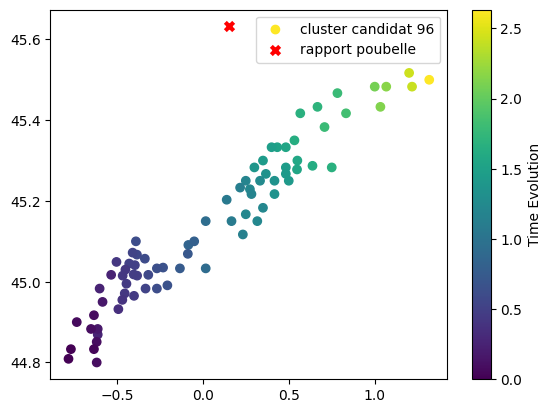

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]


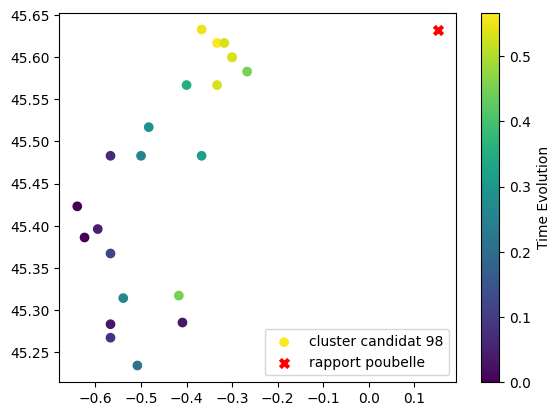

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

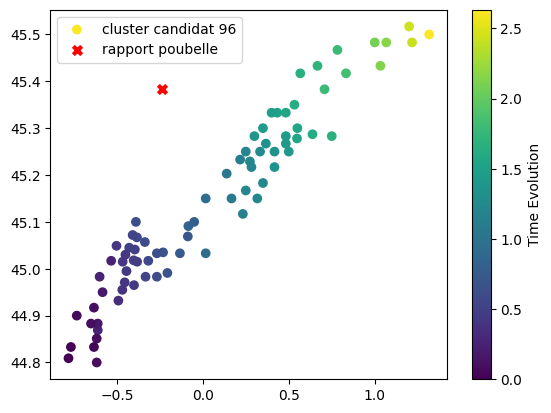

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]


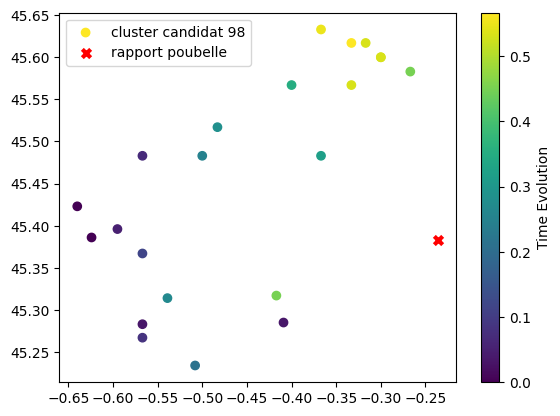

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

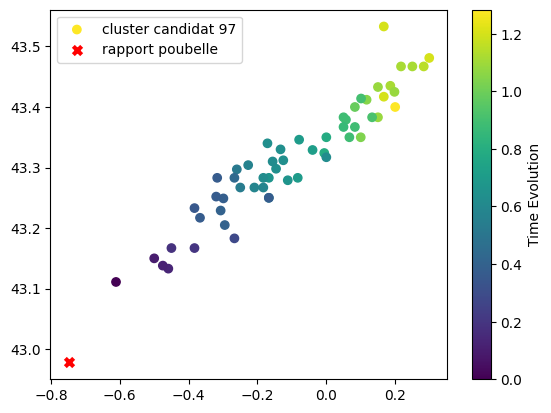

rapport dans poubelle TIME_EVENT    135360.833333
LATITUDE             42.978
LONGITUDE            -0.749
CLASSI                   -1
Name: 4107, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4009  135361.833333    43.400      0.200      97
4012      135361.75    43.533      0.167      97
4013      135361.75    43.417      0.167      97
4015      135361.75    43.481      0.299      97
4017       135361.7    43.467      0.283      97
4018  135361.666667    43.435      0.186      97
4019  135361.666667    43.467      0.250      97
4020  135361.666667    43.467      0.217      97
4023  135361.633333    43.383      0.150      97
4024  135361.633333    43.433      0.150      97
4026  135361.633333    43.425      0.198      97
4029       135361.6    43.412      0.117      97
4031  135361.583333    43.350      0.100      97
4034  135361.533333    43.400      0.083      97
4040  135361.466667    43.383      0.133      97
4042      135361.45    43.414      0.101      97
4045  1

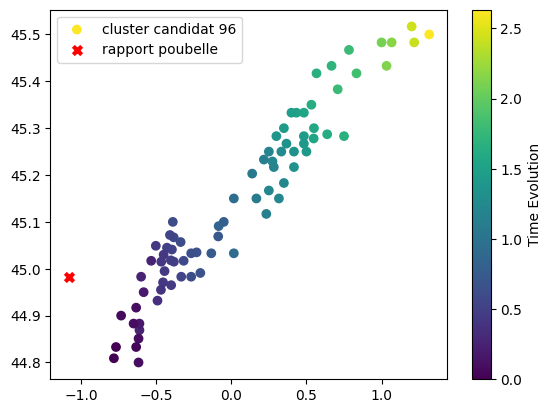

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]


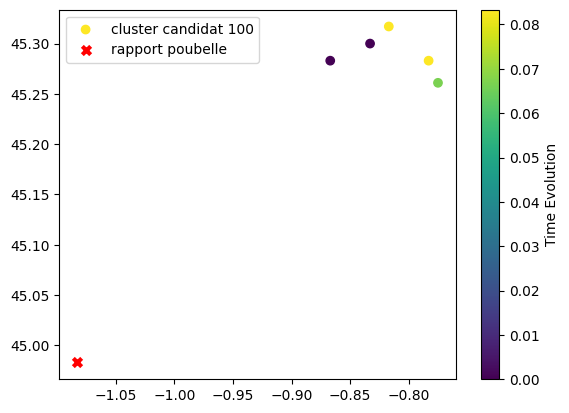

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4132  135360.166667    45.317     -0.817     100
4133  135360.166667    45.283     -0.783     100
4134      135360.15    45.261     -0.775     100
4136  135360.083333    45.300     -0.833     100
4137  135360.083333    45.283     -0.867     100


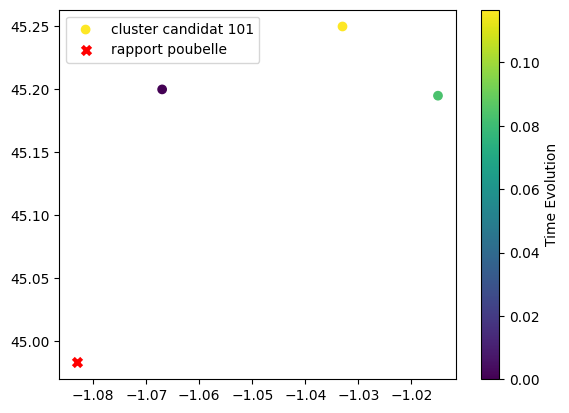

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4138  135360.033333    45.250     -1.033     101
4139       135360.0    45.195     -1.015     101
4143  135359.916667    45.200     -1.067     101
ON TESTE LE RAPPORT D'INDICE 96 DANS LE CLUSTER POUBELLE


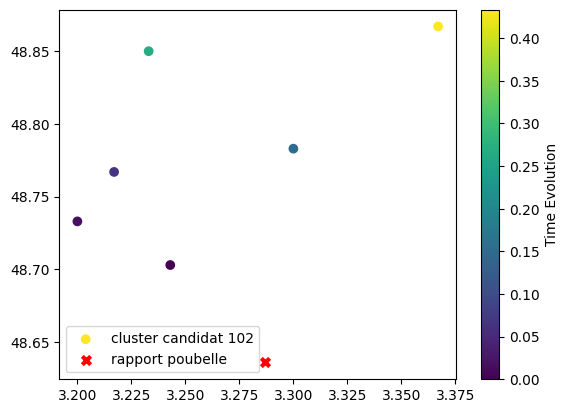

rapport dans poubelle TIME_EVENT    135340.916667
LATITUDE             48.636
LONGITUDE             3.287
CLASSI                   -1
Name: 4250, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4253      135339.85    48.867      3.367     102
4254  135339.683333    48.850      3.233     102
4255  135339.566667    48.783      3.300     102
4257  135339.483333    48.767      3.217     102
4258  135339.433333    48.733      3.200     102
4259  135339.416667    48.703      3.243     102
ON TESTE LE RAPPORT D'INDICE 111 DANS LE CLUSTER POUBELLE


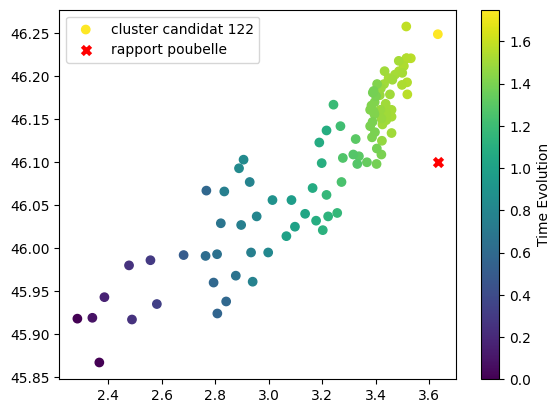

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


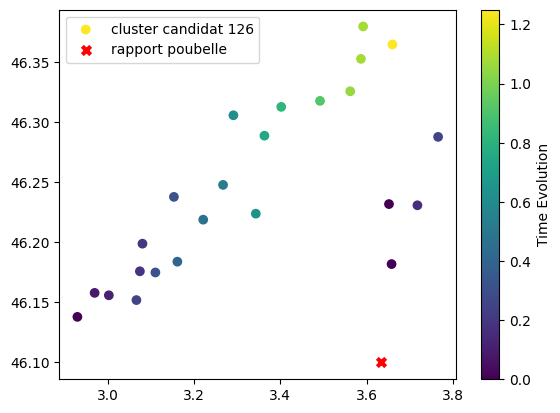

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

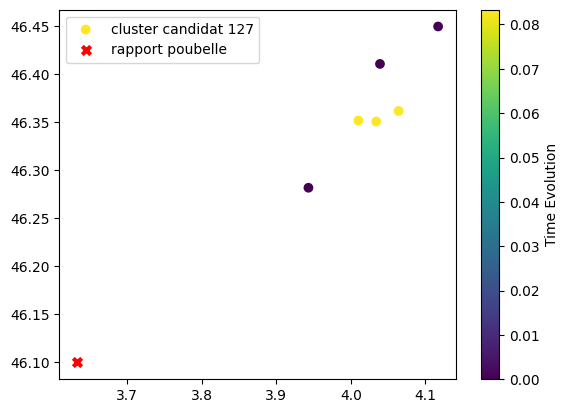

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
ON TESTE LE RAPPORT D'INDICE 112 DANS LE CLUSTER POUBELLE


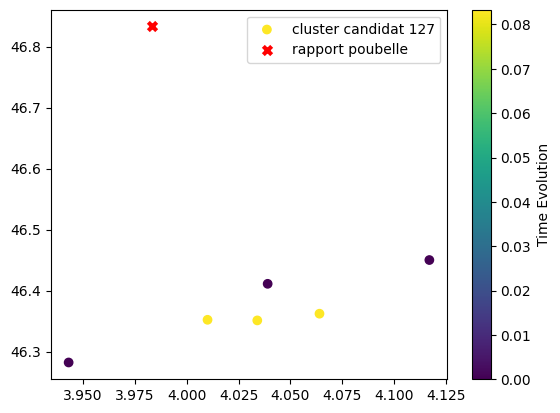

rapport dans poubelle TIME_EVENT    134979.666667
LATITUDE             46.833
LONGITUDE             3.983
CLASSI                   -1
Name: 5119, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
ON TESTE LE RAPPORT D'INDICE 113 DANS LE CLUSTER POUBELLE


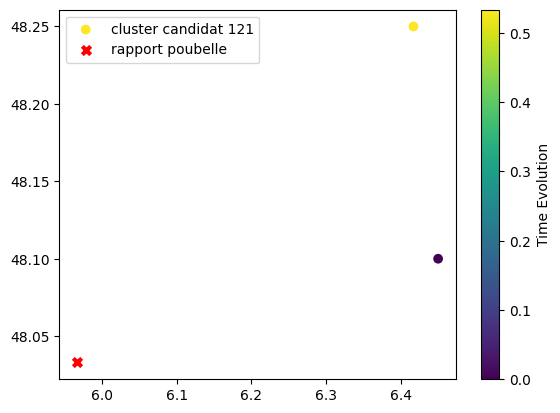

rapport dans poubelle TIME_EVENT    134979.3
LATITUDE        48.033
LONGITUDE        5.967
CLASSI              -1
Name: 5120, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5112       134980.7     48.25      6.417     121
5117  134980.166667     48.10      6.450     121
ON TESTE LE RAPPORT D'INDICE 114 DANS LE CLUSTER POUBELLE


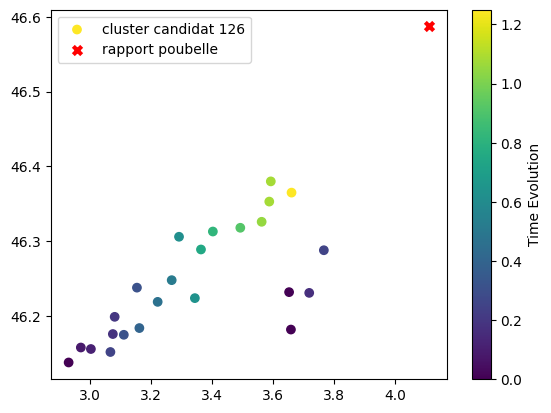

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

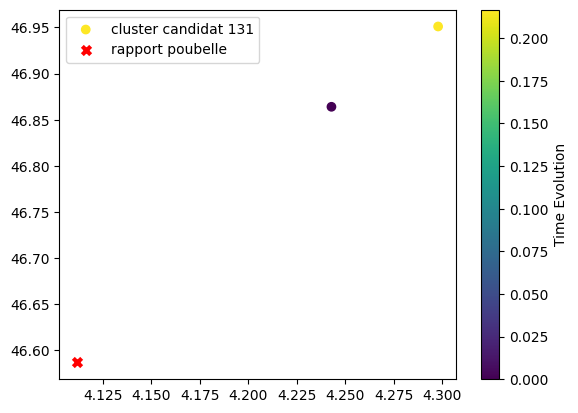

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


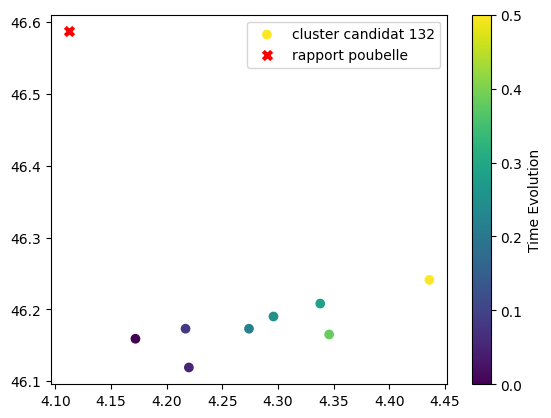

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
ON TESTE LE RAPPORT D'INDICE 115 DANS LE CLUSTER POUBELLE


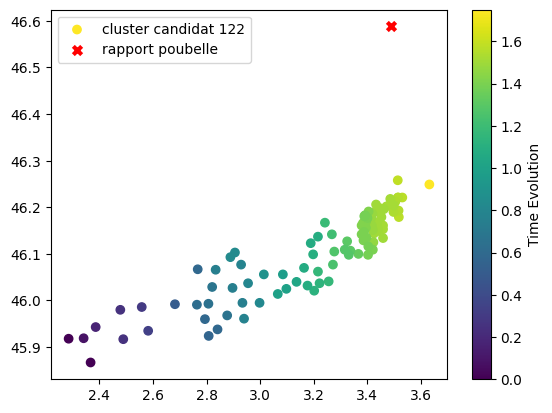

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


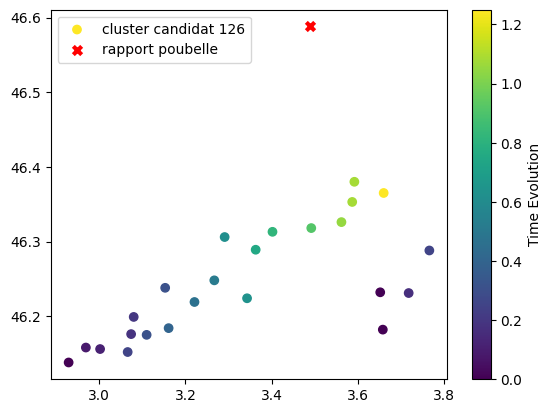

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

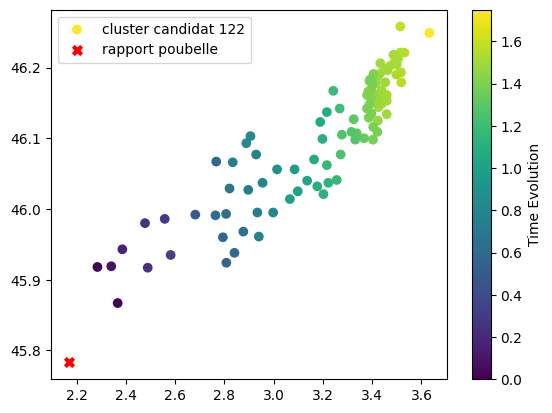

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


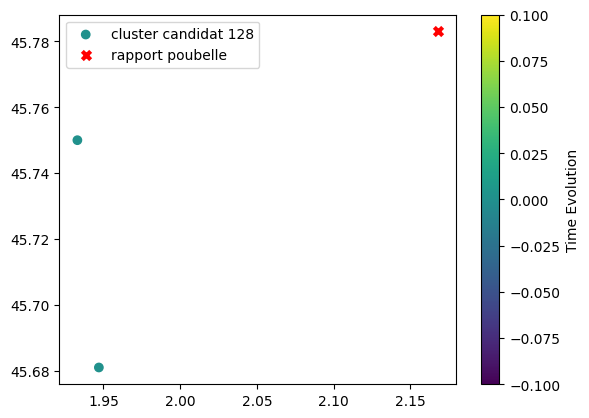

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


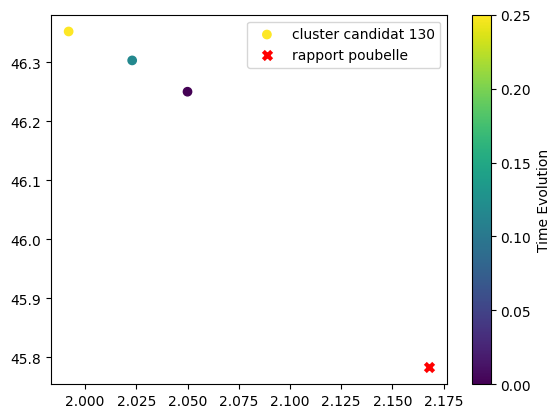

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 118 DANS LE CLUSTER POUBELLE


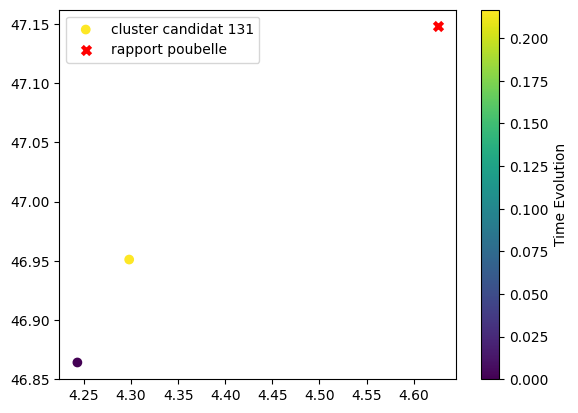

rapport dans poubelle TIME_EVENT    134976.666667
LATITUDE             47.148
LONGITUDE             4.626
CLASSI                   -1
Name: 5266, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 120 DANS LE CLUSTER POUBELLE


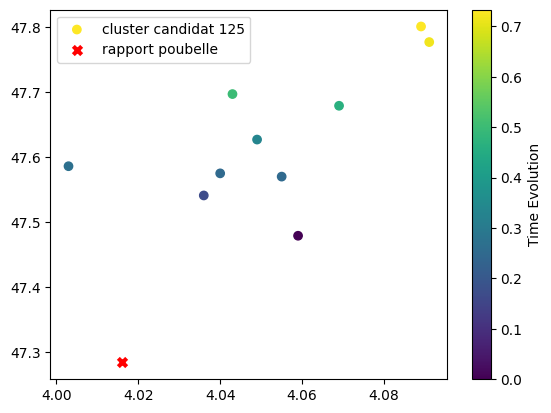

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


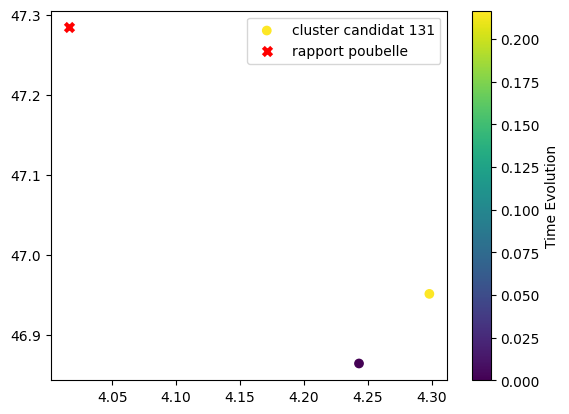

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 123 DANS LE CLUSTER POUBELLE


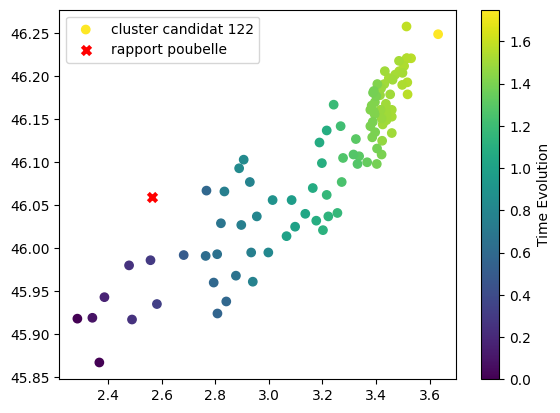

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


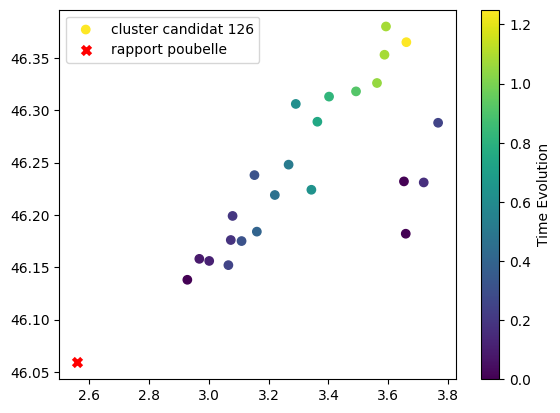

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.1

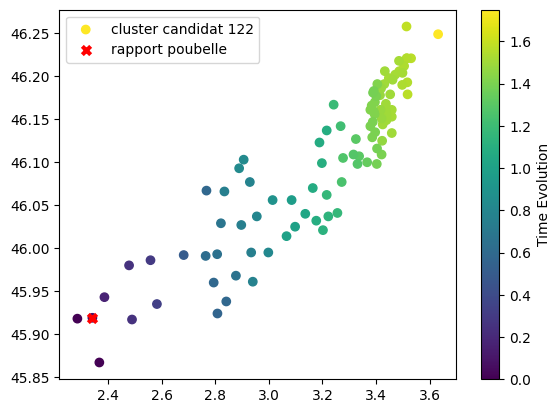

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


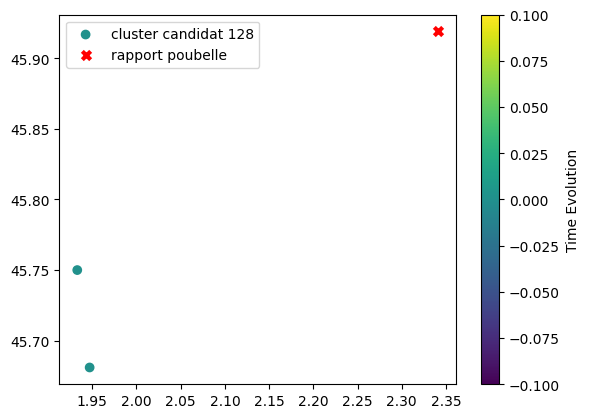

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


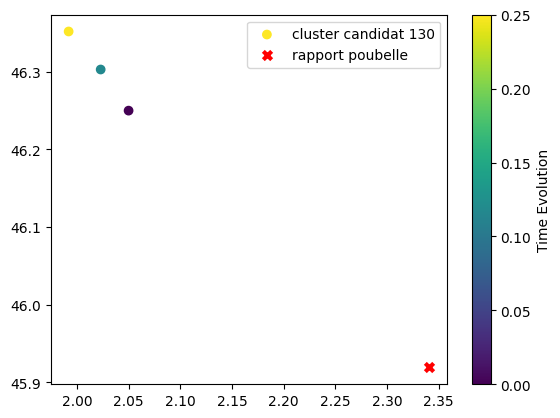

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 125 DANS LE CLUSTER POUBELLE


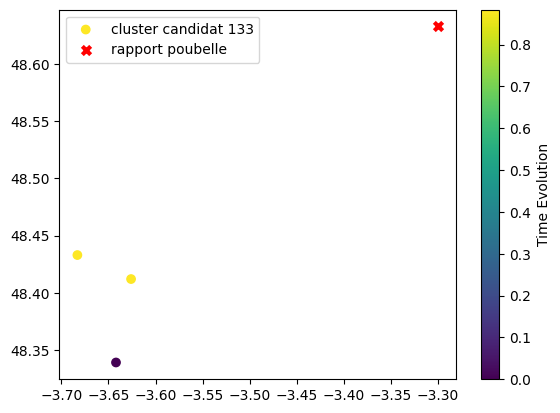

rapport dans poubelle TIME_EVENT    134974.666667
LATITUDE             48.633
LONGITUDE              -3.3
CLASSI                   -1
Name: 5338, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5320  134975.416667    48.433     -3.683     133
5321  134975.416667    48.412     -3.626     133
5345  134974.533333    48.339     -3.642     133
ON TESTE LE RAPPORT D'INDICE 126 DANS LE CLUSTER POUBELLE


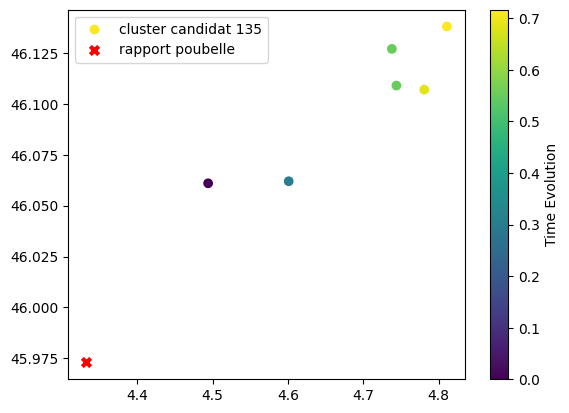

rapport dans poubelle TIME_EVENT    134973.633333
LATITUDE             45.973
LONGITUDE             4.332
CLASSI                   -1
Name: 5393, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135
ON TESTE LE RAPPORT D'INDICE 129 DANS LE CLUSTER POUBELLE


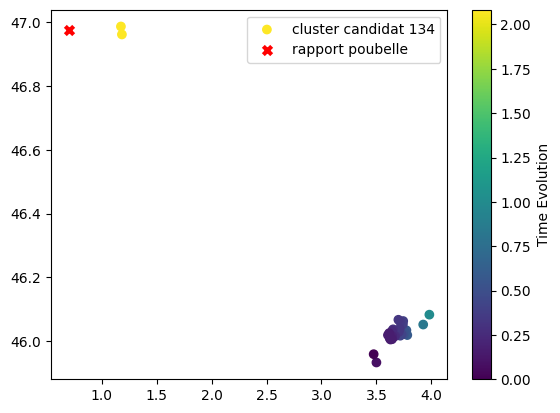

rapport dans poubelle TIME_EVENT    134972.083333
LATITUDE             46.975
LONGITUDE             0.698
CLASSI                   -1
Name: 5407, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5287  134976.166667    46.962      1.183     134
5288  134976.166667    46.987      1.174     134
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333    46.061      3.716     134
5355  134974.416667    46.029      3.703     134
5356  1

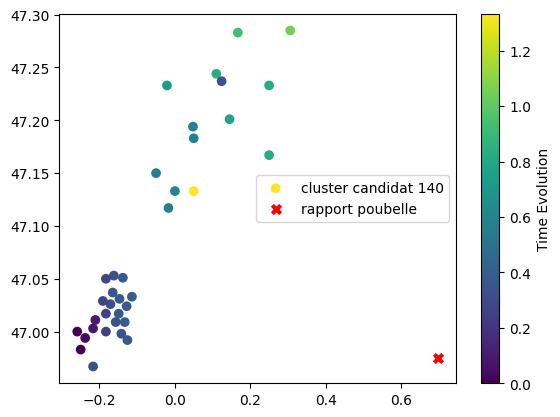

rapport dans poubelle TIME_EVENT    134972.083333
LATITUDE             46.975
LONGITUDE             0.698
CLASSI                   -1
Name: 5407, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5413  134970.916667    47.133      0.050     140
5415  134970.633333    47.285      0.306     140
5416       134970.5    47.283      0.167     140
5417  134970.416667    47.167      0.250     140
5418  134970.416667    47.233      0.250     140
5419  134970.416667    47.244      0.110     140
5420  134970.366667    47.201      0.145     140
5421  134970.316667    47.233     -0.021     140
5422  134970.183333    47.133      0.000     140
5423  134970.166667    47.183      0.050     140
5424  134970.166667    47.194      0.048     140
5425      134970.15    47.150     -0.050     140
5426      134970.15    47.117     -0.017     140
5427  134969.966667    47.024     -0.128     140
5428  134969.966667    47.033     -0.114     140
5429      134969.95    47.017     -0.149     140
5430   

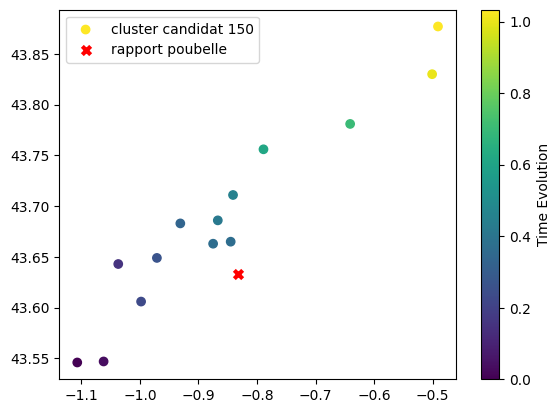

rapport dans poubelle TIME_EVENT    134952.666667
LATITUDE             43.633
LONGITUDE            -0.833
CLASSI                   -1
Name: 5480, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5521  134951.083333    43.877     -0.491     150
5522      134951.05    43.830     -0.501     150
5524      134950.75    43.781     -0.641     150
5526  134950.666667    43.756     -0.789     150
5528       134950.5    43.711     -0.841     150
5529  134950.466667    43.686     -0.867     150
5530  134950.416667    43.665     -0.845     150
5531  134950.416667    43.663     -0.875     150
5533  134950.383333    43.683     -0.931     150
5534  134950.316667    43.649     -0.971     150
5535  134950.283333    43.606     -0.998     150
5536       134950.2    43.643     -1.037     150
5537  134950.083333    43.547     -1.062     150
5538      134950.05    43.546     -1.107     150
ON TESTE LE RAPPORT D'INDICE 140 DANS LE CLUSTER POUBELLE


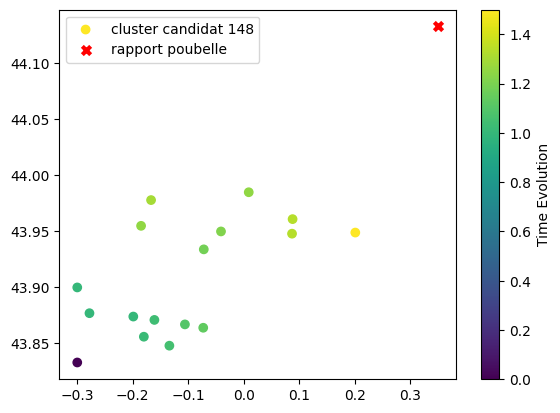

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE         44.133
LONGITUDE          0.35
CLASSI               -1
Name: 5484, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  134950.416667    

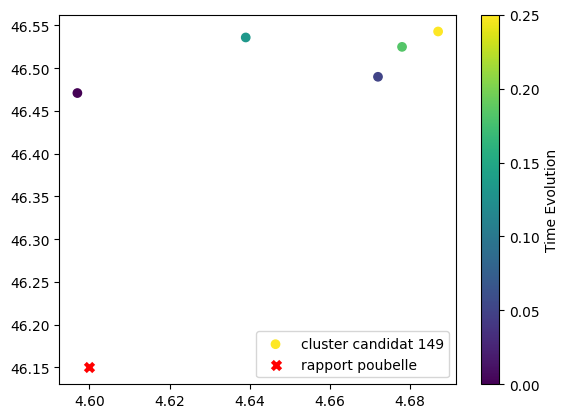

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE          46.15
LONGITUDE           4.6
CLASSI               -1
Name: 5485, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5506  134951.616667    46.543      4.687     149
5508      134951.55    46.525      4.678     149
5511       134951.5    46.536      4.639     149
5515  134951.416667    46.490      4.672     149
5519  134951.366667    46.471      4.597     149
ON TESTE LE RAPPORT D'INDICE 143 DANS LE CLUSTER POUBELLE


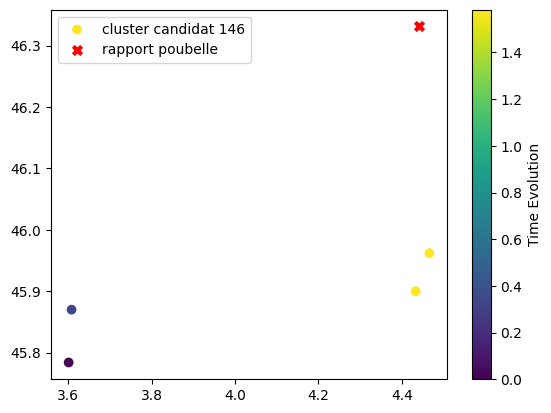

rapport dans poubelle TIME_EVENT    134951.2
LATITUDE        46.331
LONGITUDE        4.441
CLASSI              -1
Name: 5520, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461      134953.75    45.962      4.466     146
5462      134953.75    45.900      4.433     146
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


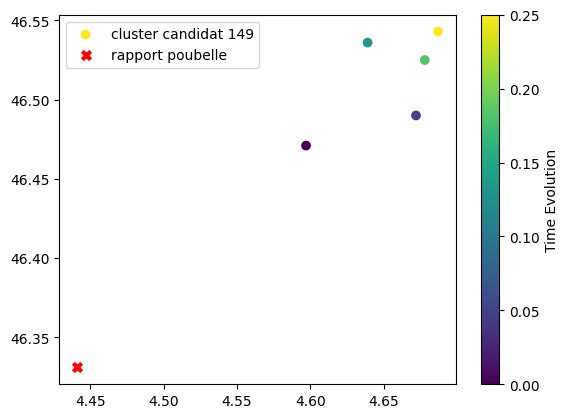

rapport dans poubelle TIME_EVENT    134951.2
LATITUDE        46.331
LONGITUDE        4.441
CLASSI              -1
Name: 5520, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5506  134951.616667    46.543      4.687     149
5508      134951.55    46.525      4.678     149
5511       134951.5    46.536      4.639     149
5515  134951.416667    46.490      4.672     149
5519  134951.366667    46.471      4.597     149
ON TESTE LE RAPPORT D'INDICE 154 DANS LE CLUSTER POUBELLE


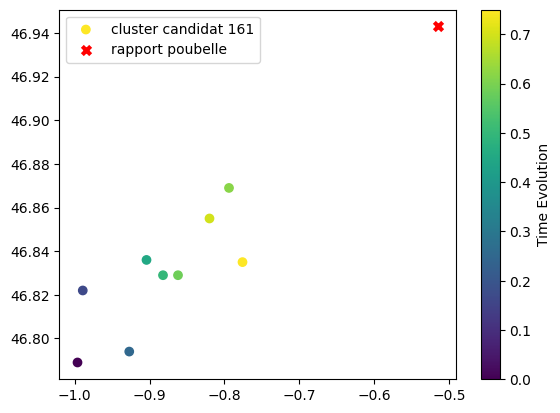

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161


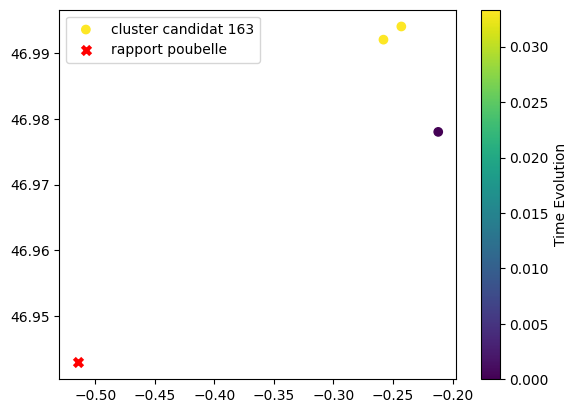

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
ON TESTE LE RAPPORT D'INDICE 156 DANS LE CLUSTER POUBELLE


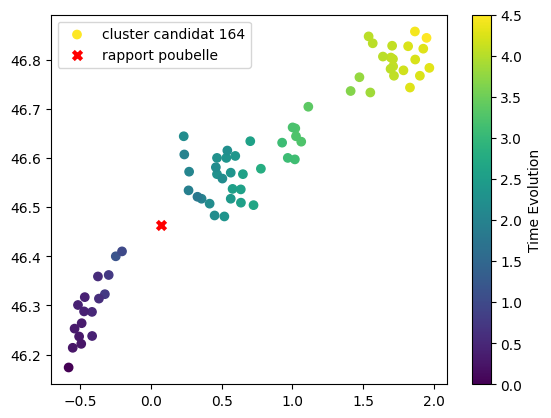

rapport dans poubelle TIME_EVENT    134664.533333
LATITUDE             46.464
LONGITUDE             0.068
CLASSI                   -1
Name: 6567, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6484  134667.416667    46.844      1.947     164
6485  134667.333333    46.857      1.865     164
6486  134667.216667    46.783      1.967     164
6487       134667.2    46.743      1.830     164
6488       134667.2    46.822      1.924     164
...             ...       ...        ...     ...
6583  134663.216667    46.253     -0.539     164
6584       134663.2    46.237     -0.507     164
6585  134663.166667    46.214     -0.552     164
6586  134663.166667    46.222     -0.492     164
6588  134662.916667    46.174     -0.581     164

[71 rows x 4 columns]
ON TESTE LE RAPPORT D'INDICE 163 DANS LE CLUSTER POUBELLE


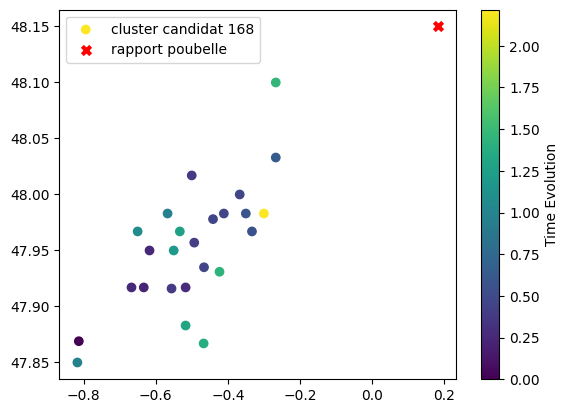

rapport dans poubelle TIME_EVENT    134605.766667
LATITUDE              48.15
LONGITUDE             0.183
CLASSI                   -1
Name: 6728, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747   

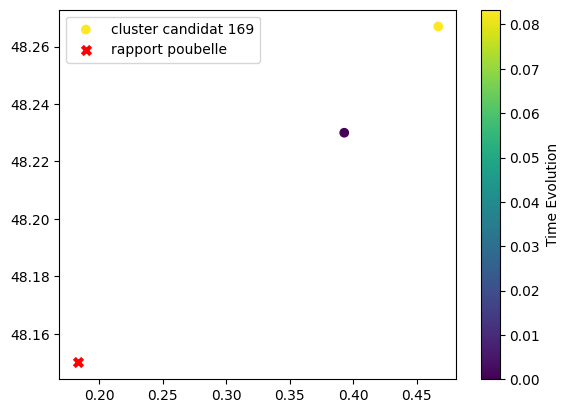

rapport dans poubelle TIME_EVENT    134605.766667
LATITUDE              48.15
LONGITUDE             0.183
CLASSI                   -1
Name: 6728, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
ON TESTE LE RAPPORT D'INDICE 164 DANS LE CLUSTER POUBELLE


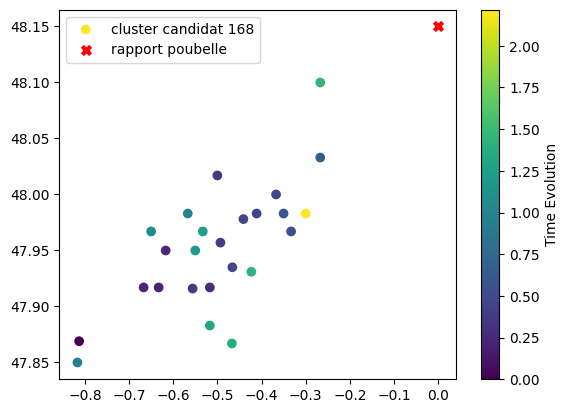

rapport dans poubelle TIME_EVENT    134604.783333
LATITUDE              48.15
LONGITUDE               0.0
CLASSI                   -1
Name: 6737, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747   

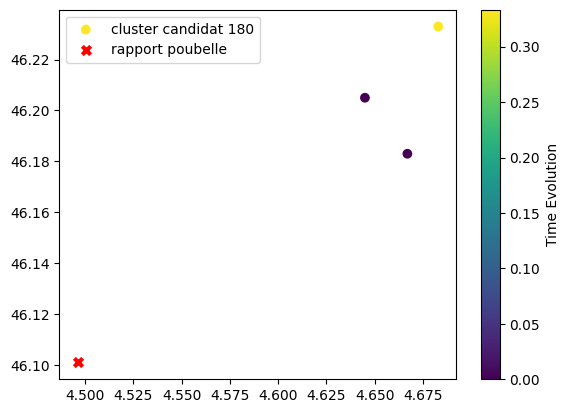

rapport dans poubelle TIME_EVENT    134228.583333
LATITUDE             46.101
LONGITUDE             4.496
CLASSI                   -1
Name: 7118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
7120  134228.333333    46.233      4.683     180
7122       134228.0    46.183      4.667     180
7123       134228.0    46.205      4.645     180


In [ ]:
plot_cluster_rapport_all(visu_results_essai_3,candi_poub)

In [ ]:
#pb : souvent des petits clusters osont candidats -> pas de sens de regarder la régression linéaire lat sur long pour éliminer des 
#candidats de fusion possibles

In [ ]:
#premier élement : indice du rapport dans cluster poubelle, deuxième élement : numéro du cluster
fus_poub_candi = [[11,12],[66,50],[70,63],[82,72],[83,73],[84,73],[117,122],[126,135],[143,149],[156,164]]

rapport numéro 11 dans le cluster poubelle


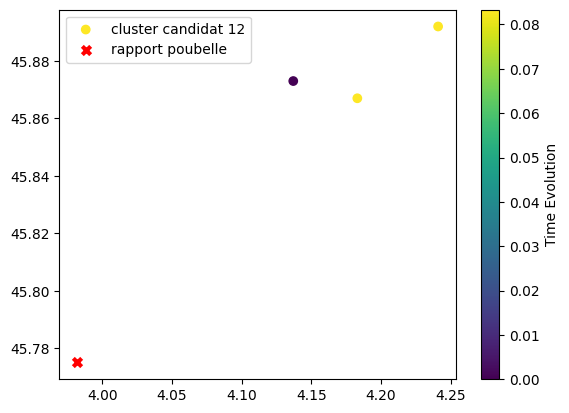

rapport numéro 66 dans le cluster poubelle


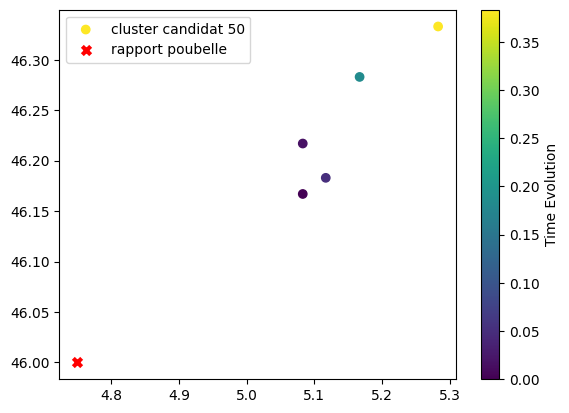

rapport numéro 70 dans le cluster poubelle


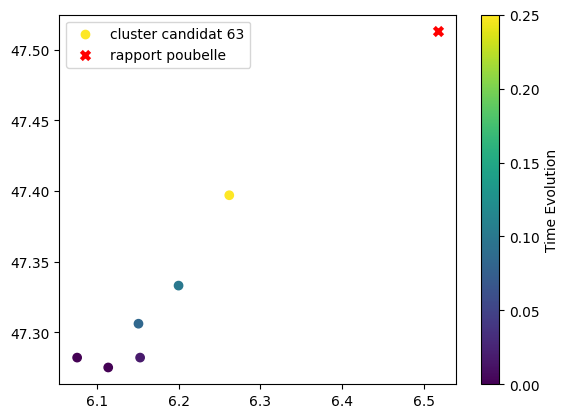

rapport numéro 82 dans le cluster poubelle


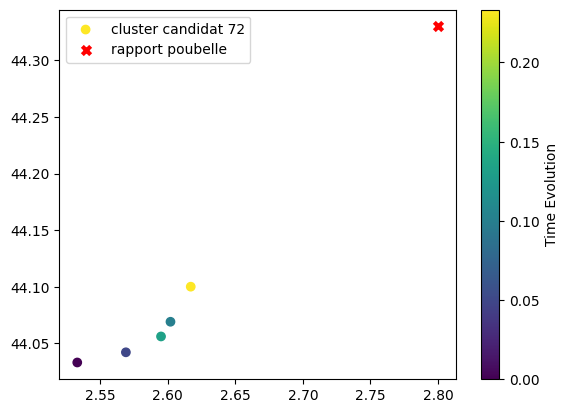

rapport numéro 83 dans le cluster poubelle


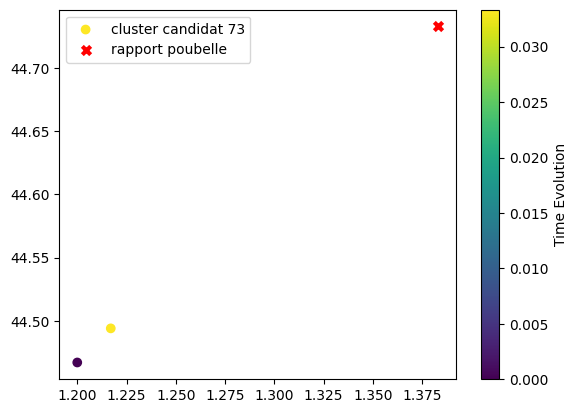

rapport numéro 84 dans le cluster poubelle


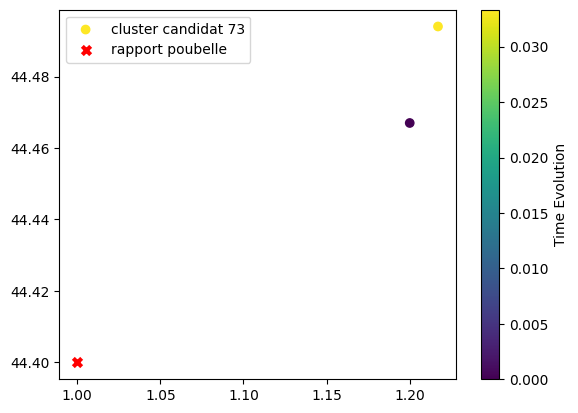

rapport numéro 84 dans le cluster poubelle


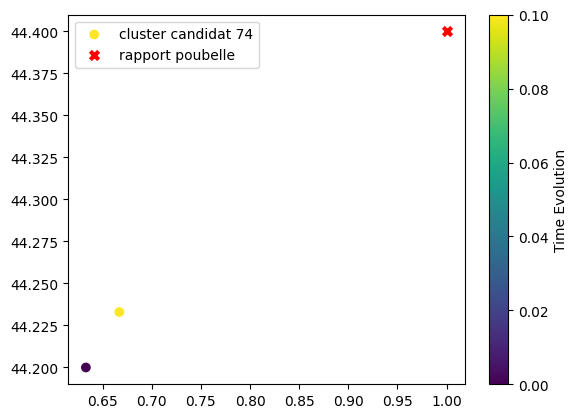

rapport numéro 126 dans le cluster poubelle


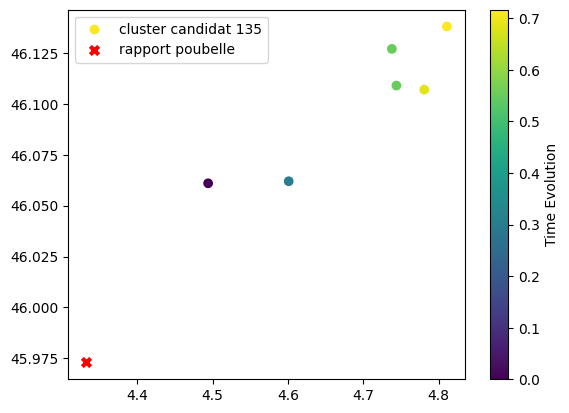

rapport numéro 143 dans le cluster poubelle


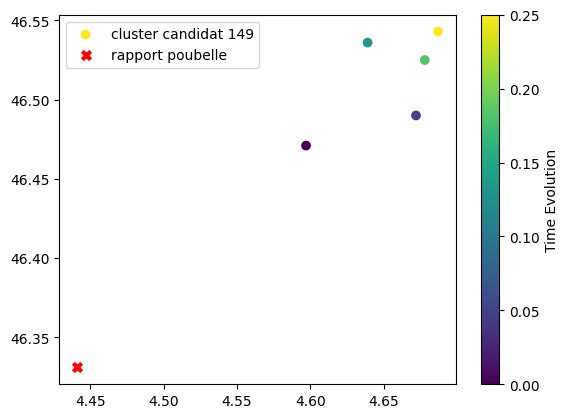

rapport numéro 156 dans le cluster poubelle


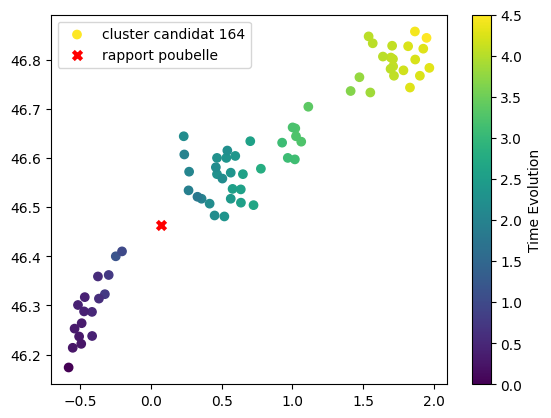

In [ ]:
liste = visu_results_essai_3[visu_results_essai_3.CLASSI == -1].index
for e in fus_poub_candi:
  i = liste[e[0]]
  rapport = visu_results_essai_3.loc[i,:][:-1]
  print('rapport numéro',str(e[0]),'dans le cluster poubelle')
  plot_cluster_rapport(visu_results_essai_3,e[1],rapport)

In [ ]:
def update_poub(visu_results_essai_3,fus_poub_candi):
  liste = visu_results_essai_3[visu_results_essai_3.CLASSI == -1].index
  for e in fus_poub_candi:
    i = liste[e[0]]
    visu_results_essai_3.loc[i,'CLASSI'] = e[1]
  return visu_results_essai_3

In [ ]:
visu_results_essai_3 = update_poub(visu_results_essai_3,fus_poub_candi)

In [ ]:
visu_results_essai_3

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,181
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
len(visu_results[visu_results.CLASSI == -1]), len(visu_results_essai_3[visu_results_essai_3.CLASSI == -1])

(188, 179)

In [ ]:
#2ème passage 

In [ ]:
candi_poub_v2 = fusion_poubelle_min(visu_results_essai_3,0.5)

NOMBRES DE PROPOSITIONS DE FUSION D UN RAPPORT POUBELLE AVEC UN CLUSTER : 
51


In [ ]:
candi_poub

[[0, [1]],
 [2, [5]],
 [4, [8]],
 [11, [12]],
 [25, [22]],
 [37, [30]],
 [45, [34]],
 [54, [37]],
 [66, [50]],
 [70, [63]],
 [75, [65]],
 [82, [72]],
 [83, [73]],
 [84, [73, 74]],
 [89, [91]],
 [91, [96, 98]],
 [92, [96, 98]],
 [94, [97]],
 [95, [96, 100, 101]],
 [96, [102]],
 [111, [122, 126, 127]],
 [112, [127]],
 [113, [121]],
 [114, [126, 131, 132]],
 [115, [122, 126]],
 [117, [122, 128, 130]],
 [118, [131]],
 [120, [125, 131]],
 [123, [122, 126]],
 [124, [122, 128, 130]],
 [125, [133]],
 [126, [135]],
 [129, [140]],
 [139, [150]],
 [140, [148]],
 [141, [149]],
 [143, [143, 149]],
 [154, [161, 163]],
 [156, [164]],
 [163, [168, 169]],
 [164, [168]],
 [177, [180]]]

In [ ]:
[11,66,70,82,83,84,126,135,143,156]

In [ ]:
candi_poub_v2 # rien de nouveau, aucun cluster nouvellement crée ne permet une nouvelle fusion entre un autre rapport poubelle et ce même cluster

[[0, [1]],
 [2, [5]],
 [4, [8]],
 [24, [22]],
 [36, [30]],
 [44, [34]],
 [53, [37]],
 [72, [65]],
 [83, [91]],
 [85, [96, 98]],
 [86, [96, 98]],
 [88, [97]],
 [89, [96, 100, 101]],
 [90, [102]],
 [105, [122, 126, 127]],
 [106, [127]],
 [107, [121]],
 [108, [126, 131, 132]],
 [109, [122, 126]],
 [111, [122, 128, 130]],
 [112, [131]],
 [114, [125, 131]],
 [117, [122, 126]],
 [118, [122, 128, 130]],
 [119, [133]],
 [120, [135]],
 [122, [140]],
 [132, [150]],
 [133, [148]],
 [134, [149]],
 [146, [161, 163]],
 [154, [168, 169]],
 [155, [168]],
 [168, [180]]]

ON TESTE LE RAPPORT D'INDICE 0 DANS LE CLUSTER POUBELLE


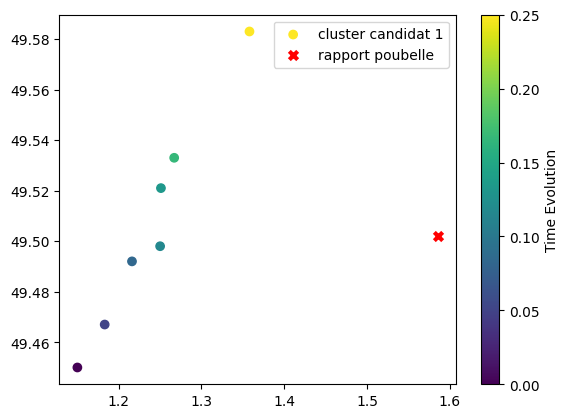

rapport dans poubelle TIME_EVENT    138356.966667
LATITUDE             49.502
LONGITUDE             1.586
CLASSI                   -1
Name: 26, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4   138358.416667    49.583      1.358       1
5   138358.333333    49.533      1.267       1
6        138358.3    49.521      1.251       1
7   138358.283333    49.498      1.250       1
8       138358.25    49.492      1.216       1
9   138358.216667    49.467      1.183       1
10  138358.166667    49.450      1.150       1
ON TESTE LE RAPPORT D'INDICE 2 DANS LE CLUSTER POUBELLE


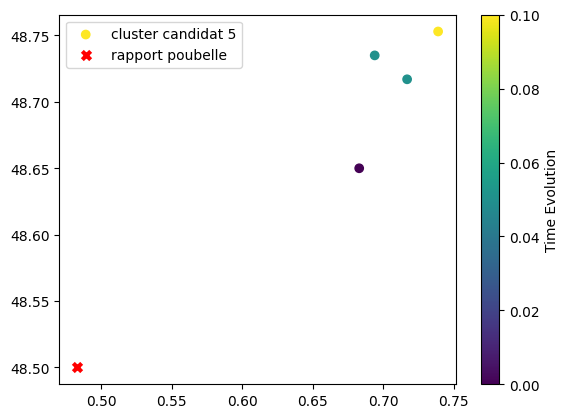

rapport dans poubelle TIME_EVENT    138356.416667
LATITUDE               48.5
LONGITUDE             0.483
CLASSI                   -1
Name: 30, dtype: object
   TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
42  138355.75    48.753      0.739       5
43   138355.7    48.735      0.694       5
44   138355.7    48.717      0.717       5
45  138355.65    48.650      0.683       5
ON TESTE LE RAPPORT D'INDICE 4 DANS LE CLUSTER POUBELLE


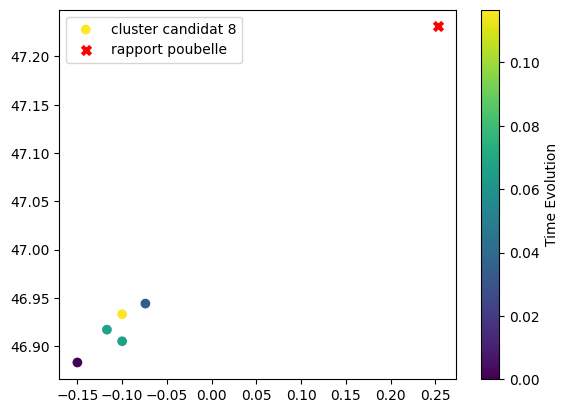

rapport dans poubelle TIME_EVENT    138284.133333
LATITUDE             47.231
LONGITUDE             0.253
CLASSI                   -1
Name: 55, dtype: object
       TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
56       138283.5    46.933     -0.100       8
57      138283.45    46.905     -0.100       8
58      138283.45    46.917     -0.117       8
59  138283.416667    46.944     -0.074       8
60  138283.383333    46.883     -0.150       8
ON TESTE LE RAPPORT D'INDICE 24 DANS LE CLUSTER POUBELLE


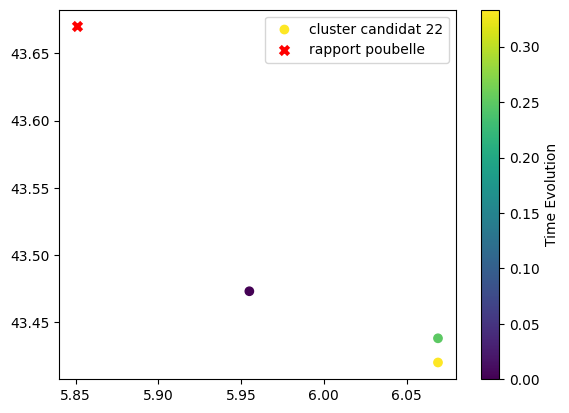

rapport dans poubelle TIME_EVENT    137130.666667
LATITUDE              43.67
LONGITUDE             5.851
CLASSI                   -1
Name: 515, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
512       137132.0    43.420      6.069      22
513  137131.916667    43.438      6.069      22
514  137131.666667    43.473      5.955      22
ON TESTE LE RAPPORT D'INDICE 36 DANS LE CLUSTER POUBELLE


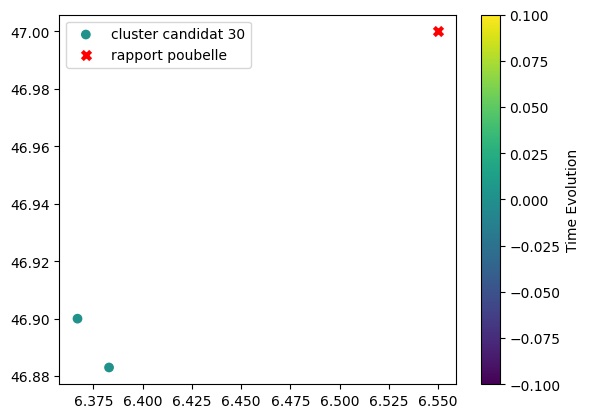

rapport dans poubelle TIME_EVENT    136746.483333
LATITUDE               47.0
LONGITUDE              6.55
CLASSI                   -1
Name: 976, dtype: object
        TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
980  136746.066667    46.900      6.367      30
981  136746.066667    46.883      6.383      30
ON TESTE LE RAPPORT D'INDICE 44 DANS LE CLUSTER POUBELLE


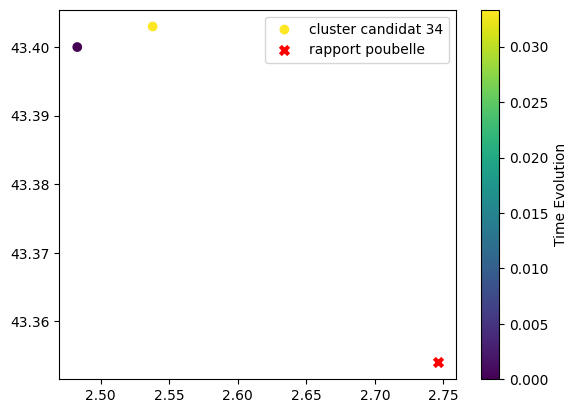

rapport dans poubelle TIME_EVENT    136726.75
LATITUDE         43.354
LONGITUDE         2.746
CLASSI               -1
Name: 1005, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1007  136726.283333    43.403      2.538      34
1008      136726.25    43.400      2.483      34
ON TESTE LE RAPPORT D'INDICE 53 DANS LE CLUSTER POUBELLE


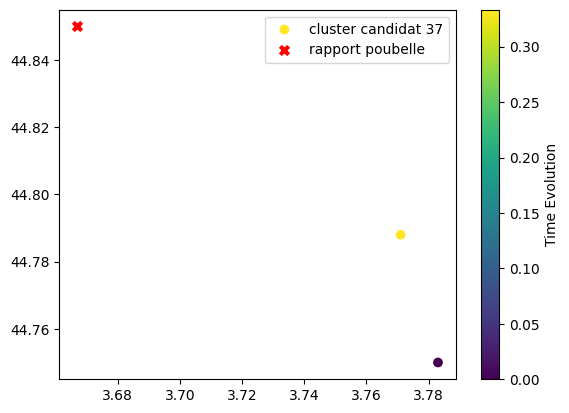

rapport dans poubelle TIME_EVENT    136459.416667
LATITUDE              44.85
LONGITUDE             3.667
CLASSI                   -1
Name: 1224, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
1226      136458.25    44.788      3.771      37
1227  136457.916667    44.750      3.783      37
ON TESTE LE RAPPORT D'INDICE 72 DANS LE CLUSTER POUBELLE


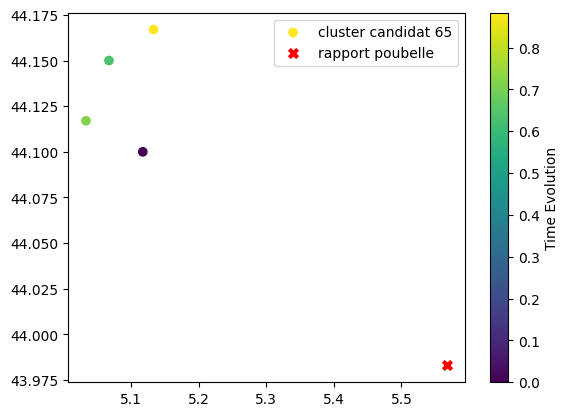

rapport dans poubelle TIME_EVENT    135448.15
LATITUDE         43.983
LONGITUDE         5.567
CLASSI               -1
Name: 3519, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3520  135447.666667    44.167      5.133      65
3521       135447.5    44.117      5.033      65
3522  135447.416667    44.150      5.067      65
3535  135446.783333    44.100      5.117      65
ON TESTE LE RAPPORT D'INDICE 83 DANS LE CLUSTER POUBELLE


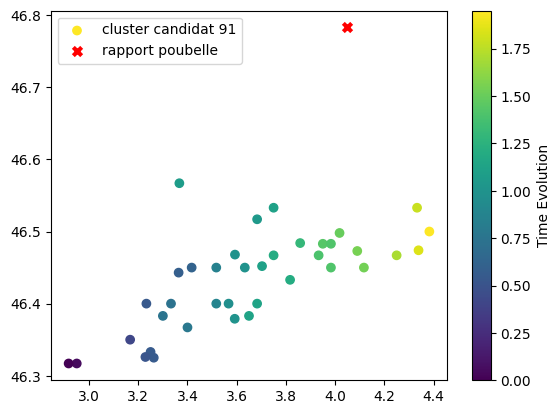

rapport dans poubelle TIME_EVENT    135381.366667
LATITUDE             46.783
LONGITUDE              4.05
CLASSI                   -1
Name: 3849, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3829  135381.833333    46.500      4.383      91
3833  135381.733333    46.474      4.339      91
3834  135381.666667    46.533      4.333      91
3836  135381.583333    46.467      4.250      91
3839  135381.433333    46.473      4.090      91
3840  135381.416667    46.450      4.117      91
3848  135381.383333    46.498      4.018      91
3852  135381.316667    46.483      3.950      91
3853       135381.3    46.450      3.983      91
3854       135381.3    46.483      3.983      91
3856  135381.283333    46.467      3.933      91
3861  135381.183333    46.484      3.858      91
3868  135381.083333    46.467      3.750      91
3869  135381.083333    46.433      3.817      91
3874  135381.016667    46.400      3.683      91
3875  135381.016667    46.383      3.650      91
3876   

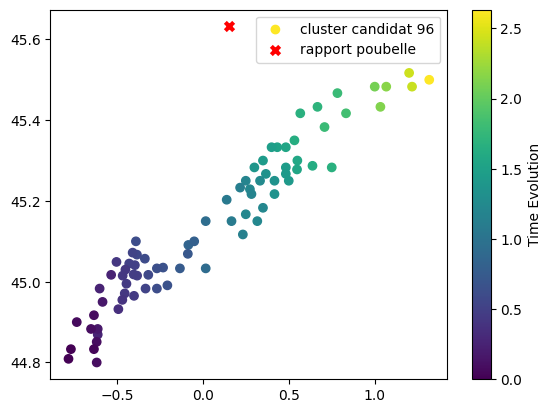

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]


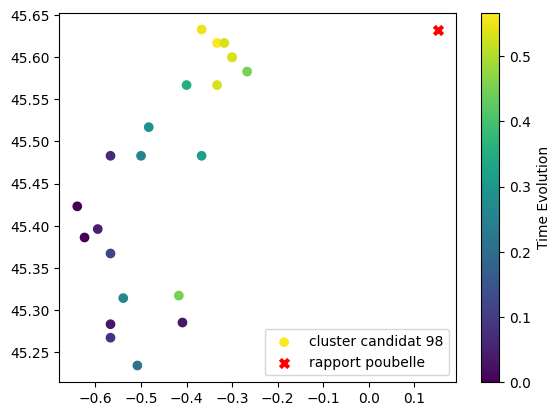

rapport dans poubelle TIME_EVENT    135362.166667
LATITUDE             45.632
LONGITUDE             0.152
CLASSI                   -1
Name: 4002, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

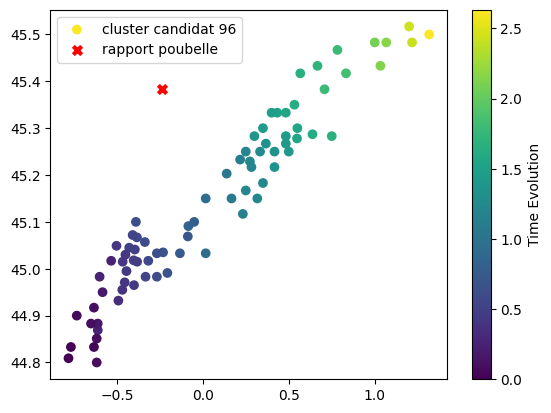

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]


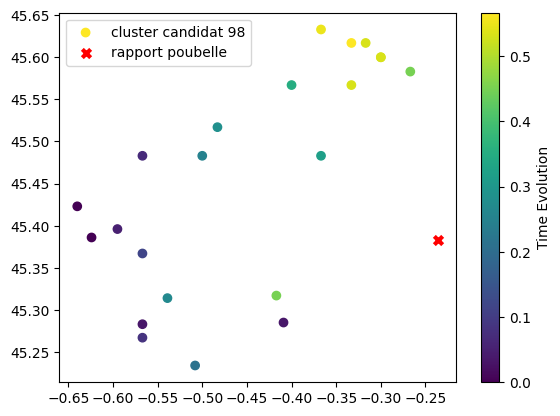

rapport dans poubelle TIME_EVENT    135361.033333
LATITUDE             45.383
LONGITUDE            -0.236
CLASSI                   -1
Name: 4087, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      98
4109  135360.833333    45.583     -0.267      98
4111  135360.733333    45.567     -0.400      98
4113       135360.7    45.483     -0.367      98
4117  135360.666667    45.517     -0.483      98
4120      135360.65    45.314     -0.539      98
4121  135360.633333    45.483     -0.500      98
4122       135360.6    45.234     -0.508      98
4124       135360.5    45.367     -0.567      98
4125  135360.466667    45.267     -0.567      98
4126   

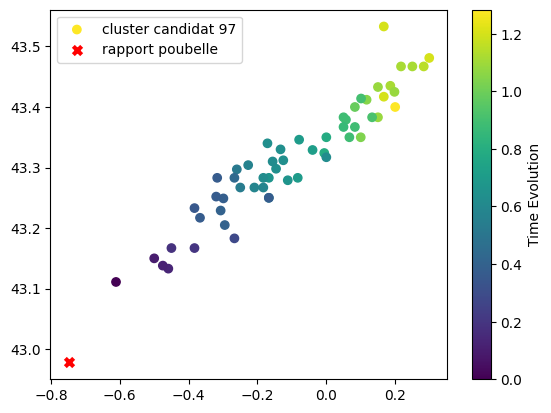

rapport dans poubelle TIME_EVENT    135360.833333
LATITUDE             42.978
LONGITUDE            -0.749
CLASSI                   -1
Name: 4107, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4009  135361.833333    43.400      0.200      97
4012      135361.75    43.533      0.167      97
4013      135361.75    43.417      0.167      97
4015      135361.75    43.481      0.299      97
4017       135361.7    43.467      0.283      97
4018  135361.666667    43.435      0.186      97
4019  135361.666667    43.467      0.250      97
4020  135361.666667    43.467      0.217      97
4023  135361.633333    43.383      0.150      97
4024  135361.633333    43.433      0.150      97
4026  135361.633333    43.425      0.198      97
4029       135361.6    43.412      0.117      97
4031  135361.583333    43.350      0.100      97
4034  135361.533333    43.400      0.083      97
4040  135361.466667    43.383      0.133      97
4042      135361.45    43.414      0.101      97
4045  1

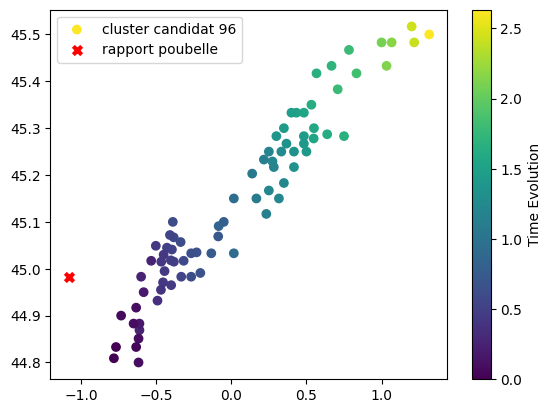

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]


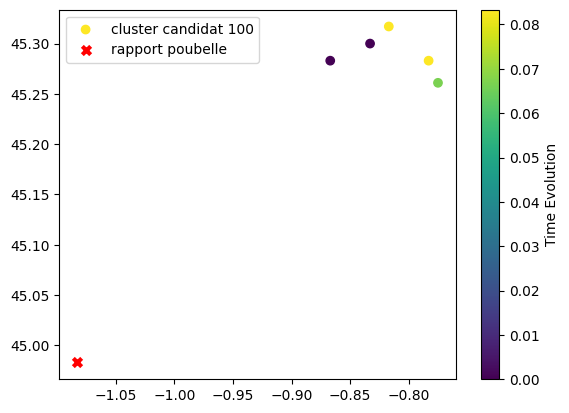

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4132  135360.166667    45.317     -0.817     100
4133  135360.166667    45.283     -0.783     100
4134      135360.15    45.261     -0.775     100
4136  135360.083333    45.300     -0.833     100
4137  135360.083333    45.283     -0.867     100


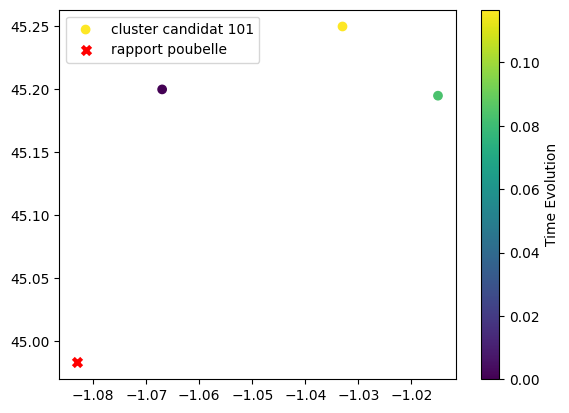

rapport dans poubelle TIME_EVENT    135359.916667
LATITUDE             44.983
LONGITUDE            -1.083
CLASSI                   -1
Name: 4144, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4138  135360.033333    45.250     -1.033     101
4139       135360.0    45.195     -1.015     101
4143  135359.916667    45.200     -1.067     101
ON TESTE LE RAPPORT D'INDICE 90 DANS LE CLUSTER POUBELLE


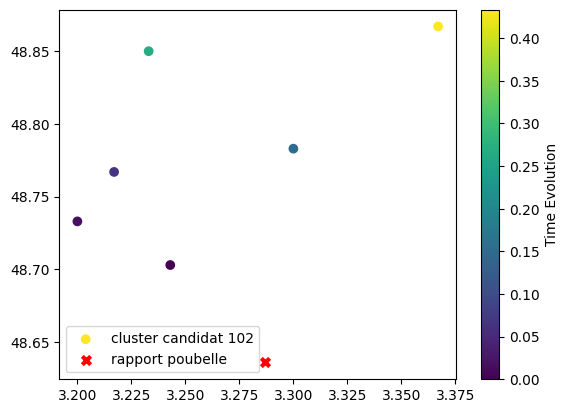

rapport dans poubelle TIME_EVENT    135340.916667
LATITUDE             48.636
LONGITUDE             3.287
CLASSI                   -1
Name: 4250, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4253      135339.85    48.867      3.367     102
4254  135339.683333    48.850      3.233     102
4255  135339.566667    48.783      3.300     102
4257  135339.483333    48.767      3.217     102
4258  135339.433333    48.733      3.200     102
4259  135339.416667    48.703      3.243     102
ON TESTE LE RAPPORT D'INDICE 105 DANS LE CLUSTER POUBELLE


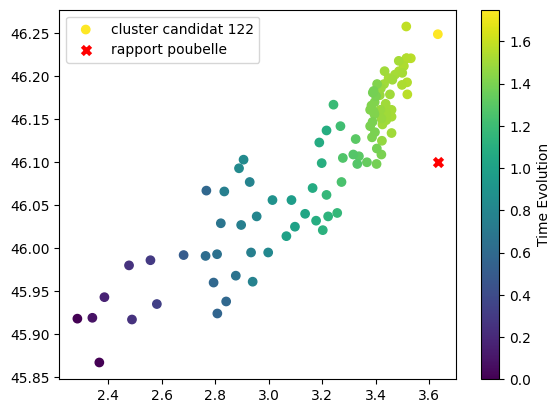

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


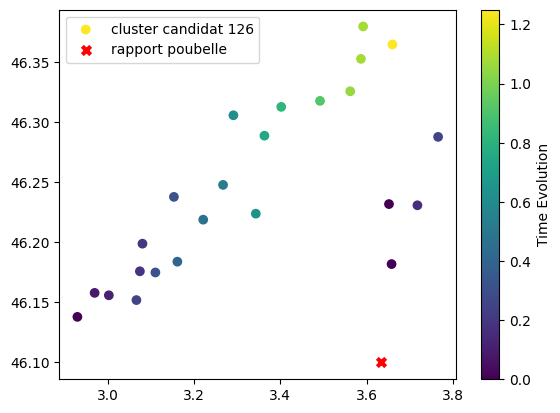

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

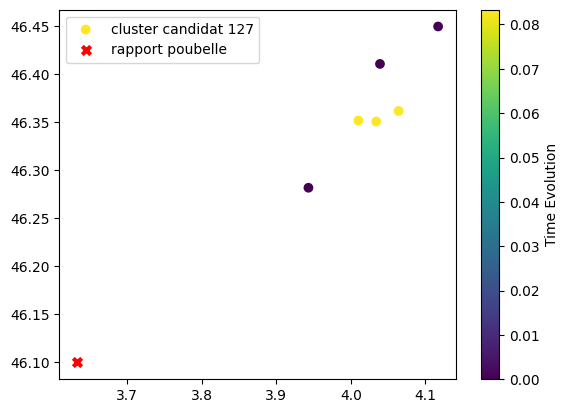

rapport dans poubelle TIME_EVENT    134979.833333
LATITUDE               46.1
LONGITUDE             3.633
CLASSI                   -1
Name: 5118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
ON TESTE LE RAPPORT D'INDICE 106 DANS LE CLUSTER POUBELLE


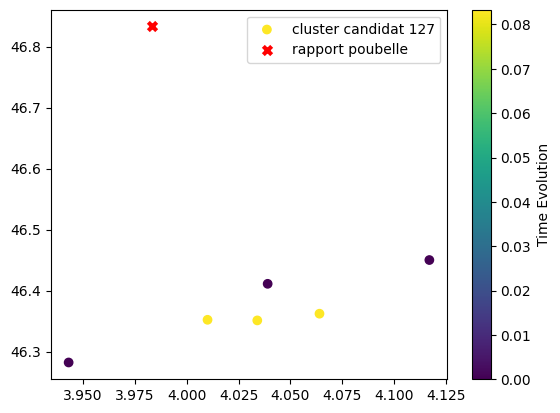

rapport dans poubelle TIME_EVENT    134979.666667
LATITUDE             46.833
LONGITUDE             3.983
CLASSI                   -1
Name: 5119, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
ON TESTE LE RAPPORT D'INDICE 107 DANS LE CLUSTER POUBELLE


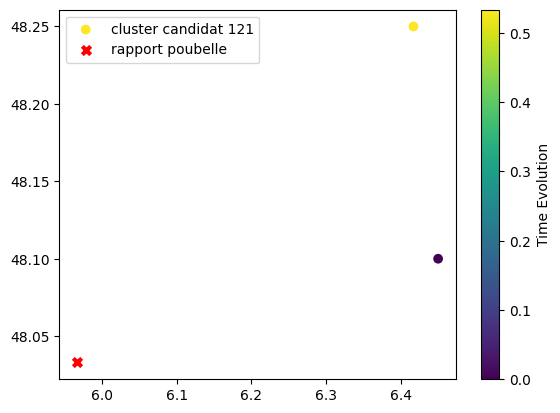

rapport dans poubelle TIME_EVENT    134979.3
LATITUDE        48.033
LONGITUDE        5.967
CLASSI              -1
Name: 5120, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5112       134980.7     48.25      6.417     121
5117  134980.166667     48.10      6.450     121
ON TESTE LE RAPPORT D'INDICE 108 DANS LE CLUSTER POUBELLE


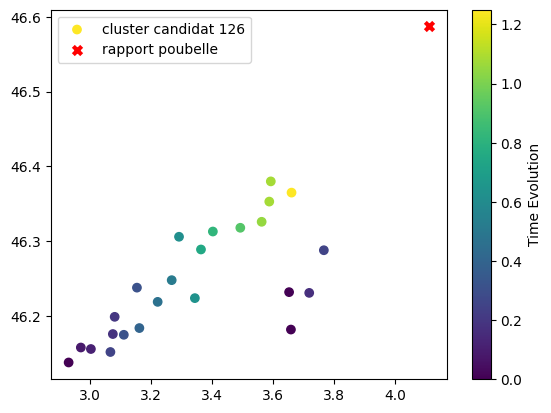

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

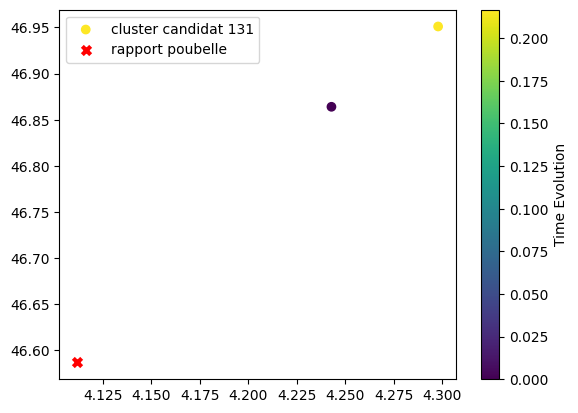

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131


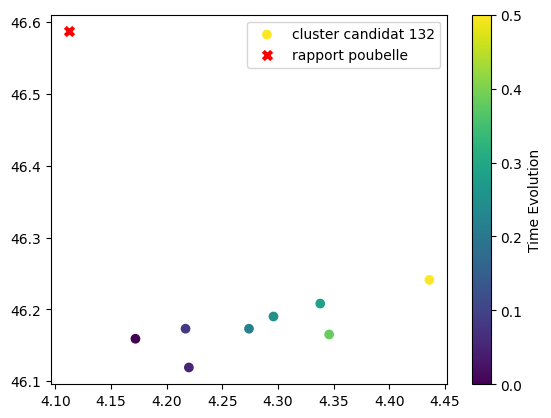

rapport dans poubelle TIME_EVENT    134978.216667
LATITUDE             46.587
LONGITUDE             4.112
CLASSI                   -1
Name: 5175, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5298  134975.916667    46.241      4.436     132
5302       134975.8    46.165      4.346     132
5309       134975.7    46.208      4.338     132
5312  134975.666667    46.190      4.296     132
5313  134975.633333    46.173      4.274     132
5315       134975.5    46.173      4.217     132
5317  134975.466667    46.119      4.220     132
5319  134975.416667    46.159      4.172     132
ON TESTE LE RAPPORT D'INDICE 109 DANS LE CLUSTER POUBELLE


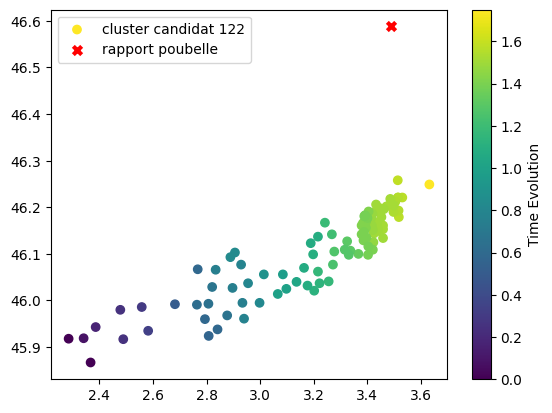

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


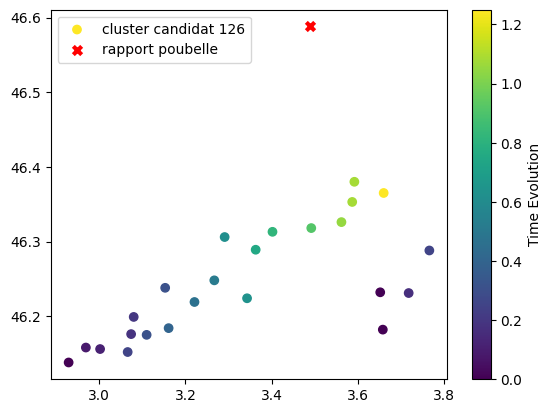

rapport dans poubelle TIME_EVENT    134977.083333
LATITUDE             46.588
LONGITUDE             3.489
CLASSI                   -1
Name: 5243, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  1

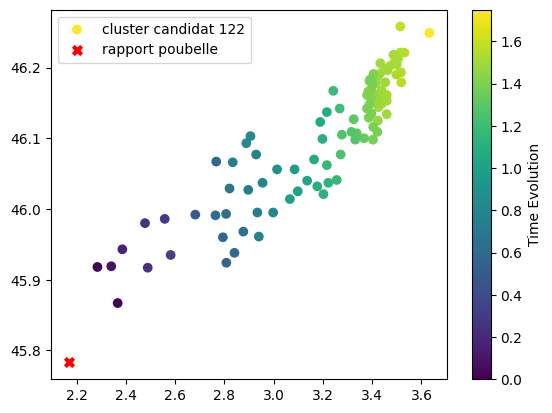

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


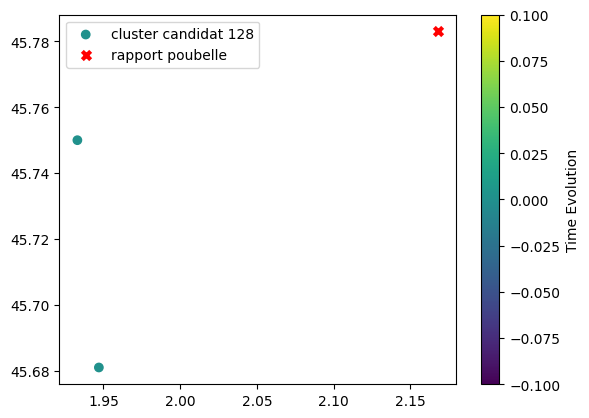

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


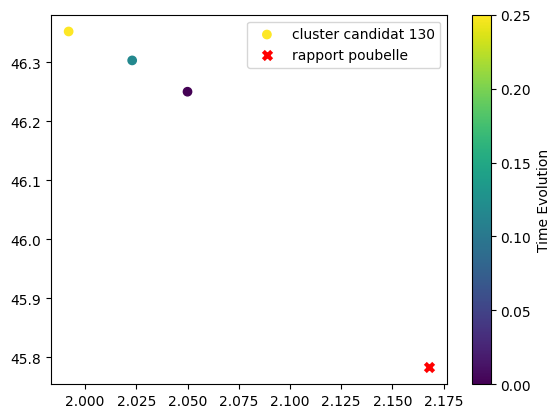

rapport dans poubelle TIME_EVENT    134976.7
LATITUDE        45.783
LONGITUDE        2.168
CLASSI              -1
Name: 5264, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 112 DANS LE CLUSTER POUBELLE


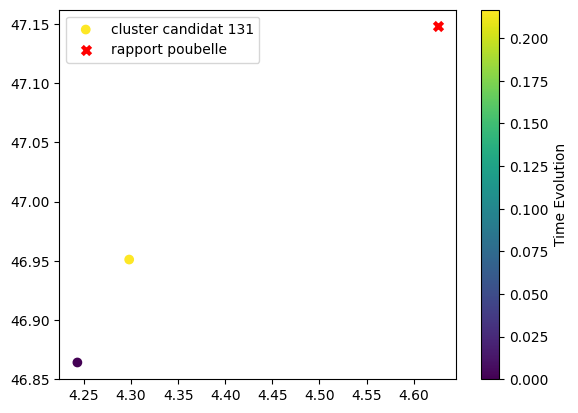

rapport dans poubelle TIME_EVENT    134976.666667
LATITUDE             47.148
LONGITUDE             4.626
CLASSI                   -1
Name: 5266, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 114 DANS LE CLUSTER POUBELLE


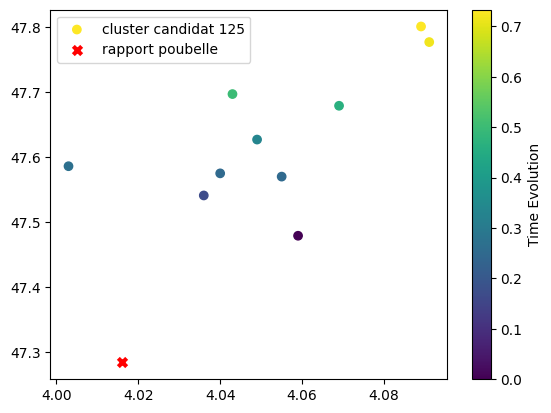

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5206  134977.683333    47.801      4.089     125
5210  134977.666667    47.777      4.091     125
5221      134977.45    47.697      4.043     125
5224  134977.416667    47.679      4.069     125
5225  134977.283333    47.627      4.049     125
5230  134977.216667    47.586      4.003     125
5232       134977.2    47.570      4.055     125
5233       134977.2    47.575      4.040     125
5237  134977.116667    47.541      4.036     125
5247      134976.95    47.479      4.059     125


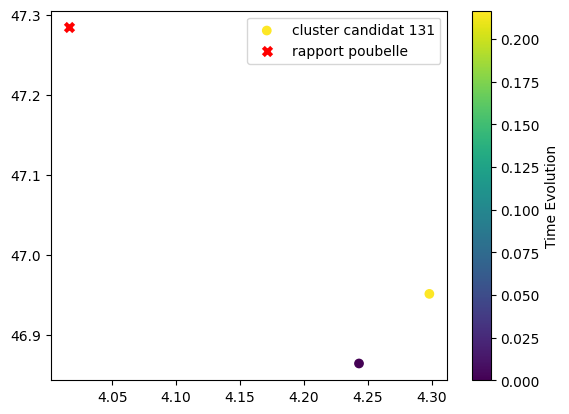

rapport dans poubelle TIME_EVENT    134976.616667
LATITUDE             47.284
LONGITUDE             4.016
CLASSI                   -1
Name: 5269, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5295  134975.933333    46.951      4.298     131
5308  134975.716667    46.864      4.243     131
ON TESTE LE RAPPORT D'INDICE 117 DANS LE CLUSTER POUBELLE


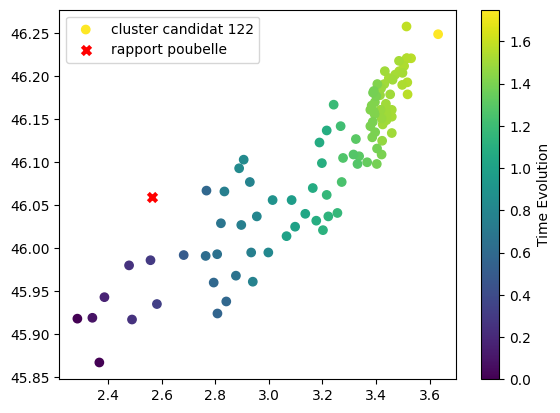

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


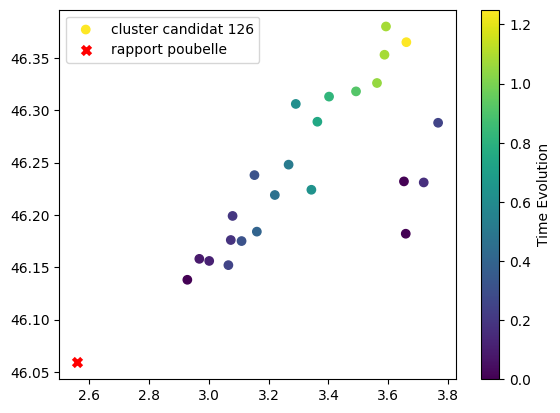

rapport dans poubelle TIME_EVENT    134975.5
LATITUDE        46.059
LONGITUDE        2.562
CLASSI              -1
Name: 5316, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5223  134977.416667    46.365      3.660     126
5226      134977.25    46.380      3.592     126
5227      134977.25    46.353      3.587     126
5229  134977.216667    46.326      3.562     126
5242  134977.083333    46.318      3.492     126
5246  134976.983333    46.313      3.402     126
5252  134976.916667    46.289      3.363     126
5261       134976.8    46.224      3.343     126
5262  134976.783333    46.306      3.291     126
5265  134976.683333    46.248      3.267     126
5268  134976.633333    46.219      3.221     126
5270  134976.566667    46.184      3.161     126
5271  134976.483333    46.238      3.153     126
5272  134976.483333    46.175      3.110     126
5273  134976.416667    46.288      3.766     126
5276  134976.416667    46.152      3.066     126
5278  134976.366667    46.1

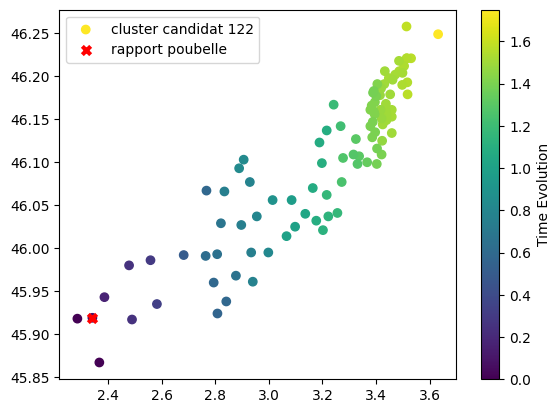

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5121  134978.666667    46.249      3.632     122
5122       134978.5    46.258      3.514     122
5123  134978.483333    46.179      3.518     122
5124  134978.483333    46.221      3.515     122
5125  134978.483333    46.221      3.531     122
...             ...       ...        ...     ...
5236  134977.166667    45.980      2.478     122
5244  134977.083333    45.943      2.386     122
5245       134977.0    45.919      2.341     122
5256  134976.916667    45.918      2.285     122
5257  134976.916667    45.867      2.367     122

[98 rows x 4 columns]


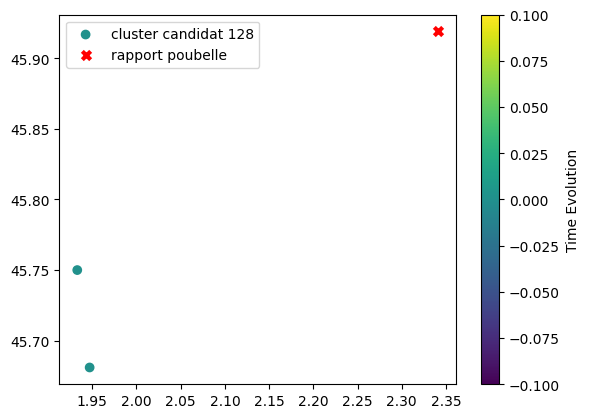

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5274  134976.416667    45.750      1.933     128
5275  134976.416667    45.681      1.947     128


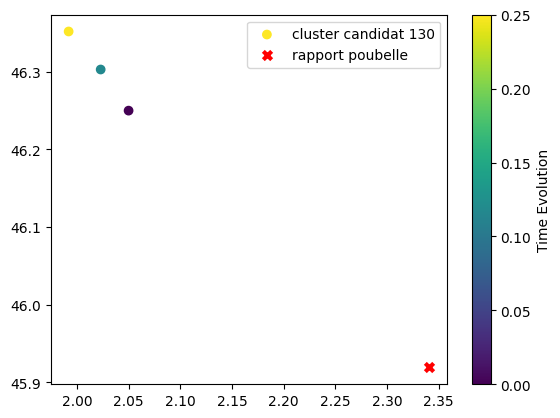

rapport dans poubelle TIME_EVENT    134975.25
LATITUDE         45.919
LONGITUDE         2.341
CLASSI               -1
Name: 5325, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5294  134976.066667    46.352      1.992     130
5296  134975.933333    46.303      2.023     130
5301  134975.816667    46.250      2.050     130
ON TESTE LE RAPPORT D'INDICE 119 DANS LE CLUSTER POUBELLE


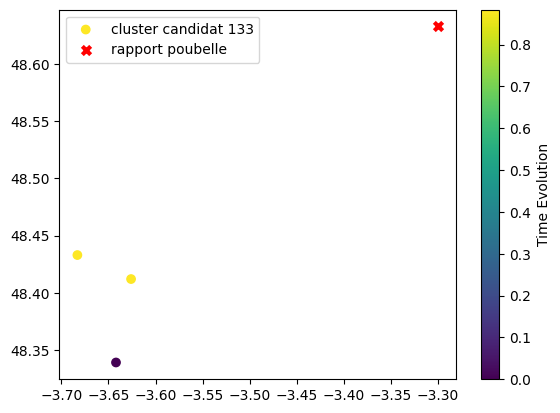

rapport dans poubelle TIME_EVENT    134974.666667
LATITUDE             48.633
LONGITUDE              -3.3
CLASSI                   -1
Name: 5338, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5320  134975.416667    48.433     -3.683     133
5321  134975.416667    48.412     -3.626     133
5345  134974.533333    48.339     -3.642     133
ON TESTE LE RAPPORT D'INDICE 120 DANS LE CLUSTER POUBELLE


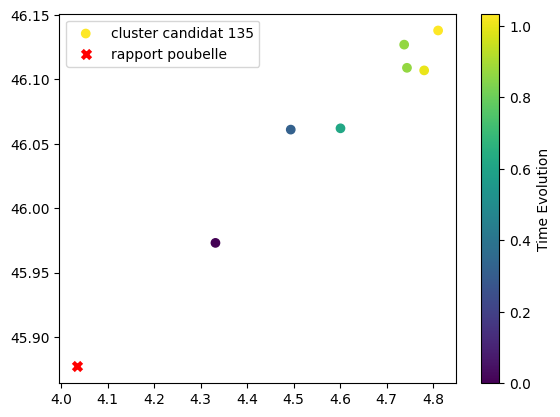

rapport dans poubelle TIME_EVENT    134973.133333
LATITUDE             45.877
LONGITUDE             4.035
CLASSI                   -1
Name: 5396, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5337  134974.666667    46.138      4.811     135
5341  134974.633333    46.107      4.781     135
5346       134974.5    46.109      4.744     135
5347       134974.5    46.127      4.738     135
5368      134974.25    46.062      4.601     135
5387      134973.95    46.061      4.494     135
5393  134973.633333    45.973      4.332     135
ON TESTE LE RAPPORT D'INDICE 122 DANS LE CLUSTER POUBELLE


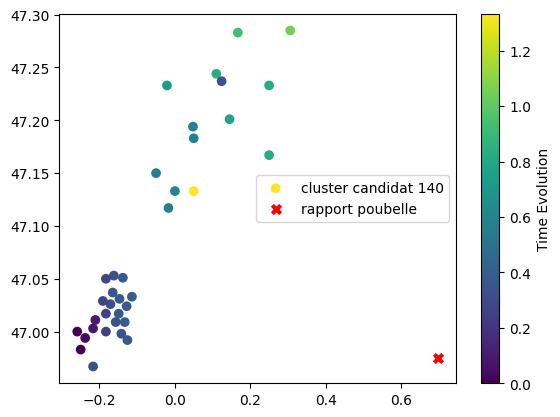

rapport dans poubelle TIME_EVENT    134972.083333
LATITUDE             46.975
LONGITUDE             0.698
CLASSI                   -1
Name: 5407, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5413  134970.916667    47.133      0.050     140
5415  134970.633333    47.285      0.306     140
5416       134970.5    47.283      0.167     140
5417  134970.416667    47.167      0.250     140
5418  134970.416667    47.233      0.250     140
5419  134970.416667    47.244      0.110     140
5420  134970.366667    47.201      0.145     140
5421  134970.316667    47.233     -0.021     140
5422  134970.183333    47.133      0.000     140
5423  134970.166667    47.183      0.050     140
5424  134970.166667    47.194      0.048     140
5425      134970.15    47.150     -0.050     140
5426      134970.15    47.117     -0.017     140
5427  134969.966667    47.024     -0.128     140
5428  134969.966667    47.033     -0.114     140
5429      134969.95    47.017     -0.149     140
5430   

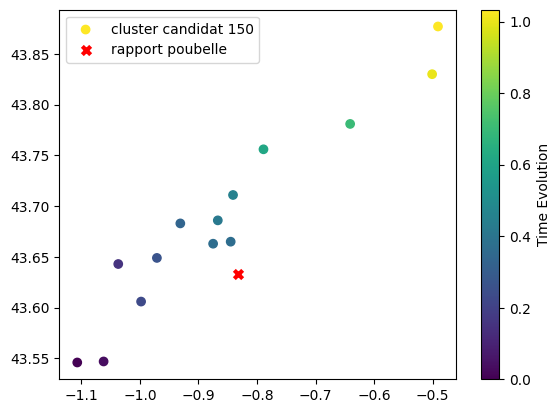

rapport dans poubelle TIME_EVENT    134952.666667
LATITUDE             43.633
LONGITUDE            -0.833
CLASSI                   -1
Name: 5480, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5521  134951.083333    43.877     -0.491     150
5522      134951.05    43.830     -0.501     150
5524      134950.75    43.781     -0.641     150
5526  134950.666667    43.756     -0.789     150
5528       134950.5    43.711     -0.841     150
5529  134950.466667    43.686     -0.867     150
5530  134950.416667    43.665     -0.845     150
5531  134950.416667    43.663     -0.875     150
5533  134950.383333    43.683     -0.931     150
5534  134950.316667    43.649     -0.971     150
5535  134950.283333    43.606     -0.998     150
5536       134950.2    43.643     -1.037     150
5537  134950.083333    43.547     -1.062     150
5538      134950.05    43.546     -1.107     150
ON TESTE LE RAPPORT D'INDICE 133 DANS LE CLUSTER POUBELLE


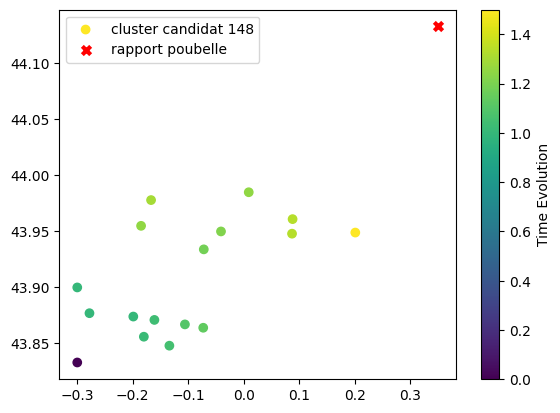

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE         44.133
LONGITUDE          0.35
CLASSI               -1
Name: 5484, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5498  134951.916667    43.949      0.201     148
5499      134951.75    43.948      0.087     148
5501      134951.75    43.961      0.088     148
5502  134951.716667    43.978     -0.167     148
5503  134951.666667    43.985      0.009     148
5504  134951.666667    43.955     -0.185     148
5505  134951.633333    43.950     -0.041     148
5507       134951.6    43.934     -0.072     148
5509      134951.55    43.864     -0.073     148
5510  134951.516667    43.867     -0.106     148
5512  134951.466667    43.848     -0.134     148
5513      134951.45    43.871     -0.161     148
5514  134951.433333    43.856     -0.180     148
5516  134951.416667    43.877     -0.278     148
5517  134951.416667    43.874     -0.199     148
5518  134951.416667    43.900     -0.300     148
5532  134950.416667    

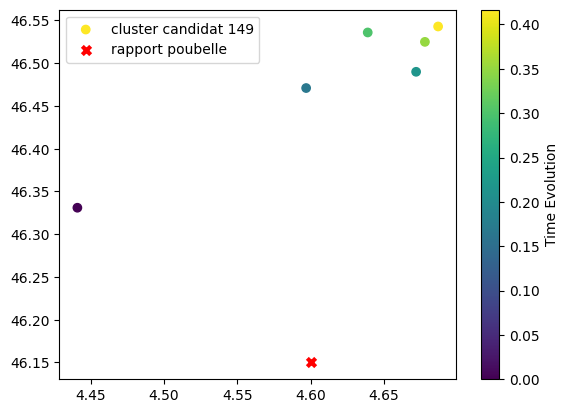

rapport dans poubelle TIME_EVENT    134952.25
LATITUDE          46.15
LONGITUDE           4.6
CLASSI               -1
Name: 5485, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5506  134951.616667    46.543      4.687     149
5508      134951.55    46.525      4.678     149
5511       134951.5    46.536      4.639     149
5515  134951.416667    46.490      4.672     149
5519  134951.366667    46.471      4.597     149
5520       134951.2    46.331      4.441     149
ON TESTE LE RAPPORT D'INDICE 146 DANS LE CLUSTER POUBELLE


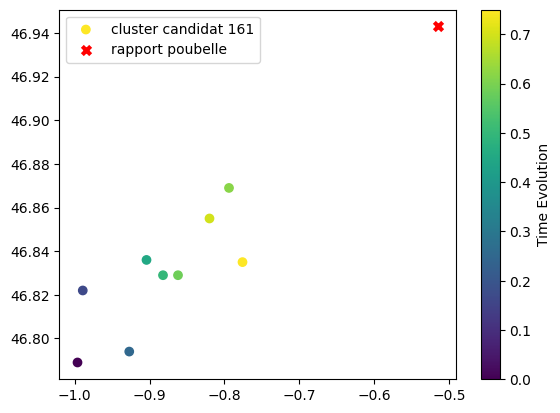

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6530  134665.333333    46.835     -0.776     161
6533  134665.283333    46.855     -0.820     161
6542       134665.2    46.869     -0.794     161
6545  134665.166667    46.829     -0.862     161
6551  134665.083333    46.829     -0.882     161
6556  134665.033333    46.836     -0.904     161
6563  134664.833333    46.794     -0.927     161
6564      134664.75    46.822     -0.989     161
6566  134664.583333    46.789     -0.996     161


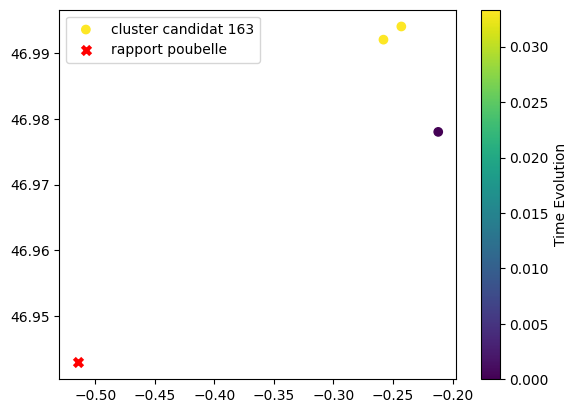

rapport dans poubelle TIME_EVENT    134666.0
LATITUDE        46.943
LONGITUDE       -0.515
CLASSI              -1
Name: 6514, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6541       134665.2    46.992     -0.258     163
6543       134665.2    46.994     -0.243     163
6544  134665.166667    46.978     -0.212     163
ON TESTE LE RAPPORT D'INDICE 154 DANS LE CLUSTER POUBELLE


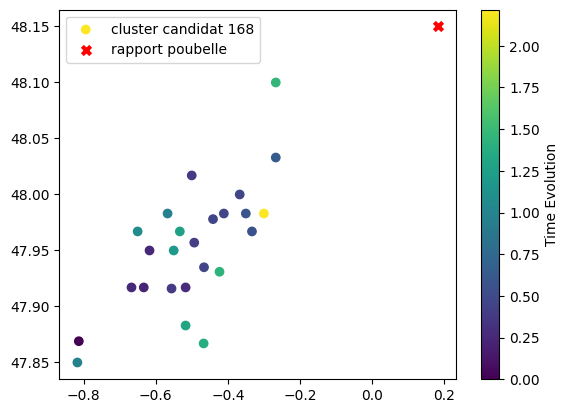

rapport dans poubelle TIME_EVENT    134605.766667
LATITUDE              48.15
LONGITUDE             0.183
CLASSI                   -1
Name: 6728, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747   

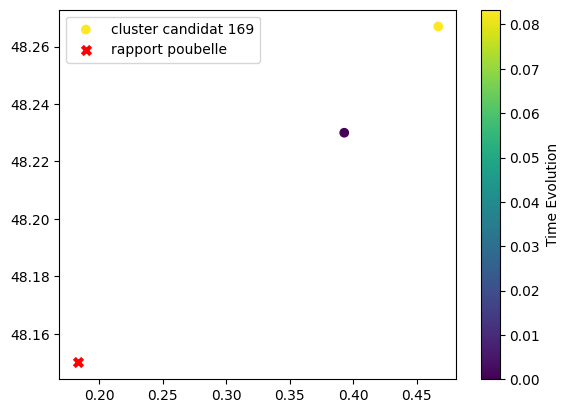

rapport dans poubelle TIME_EVENT    134605.766667
LATITUDE              48.15
LONGITUDE             0.183
CLASSI                   -1
Name: 6728, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
ON TESTE LE RAPPORT D'INDICE 155 DANS LE CLUSTER POUBELLE


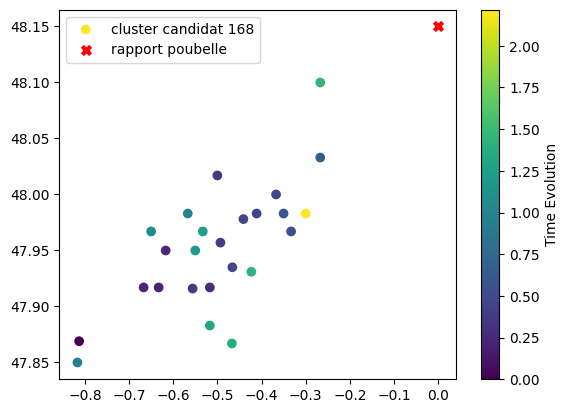

rapport dans poubelle TIME_EVENT    134604.783333
LATITUDE              48.15
LONGITUDE               0.0
CLASSI                   -1
Name: 6737, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747   

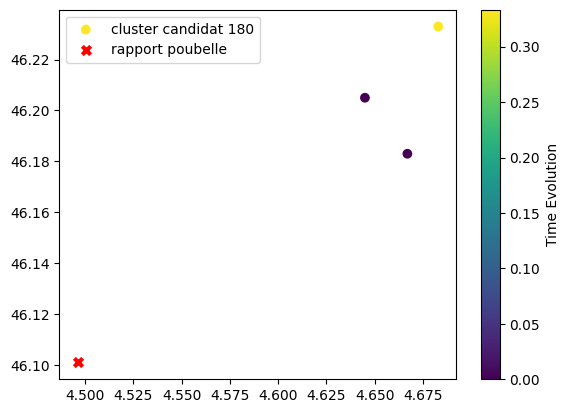

rapport dans poubelle TIME_EVENT    134228.583333
LATITUDE             46.101
LONGITUDE             4.496
CLASSI                   -1
Name: 7118, dtype: object
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
7120  134228.333333    46.233      4.683     180
7122       134228.0    46.183      4.667     180
7123       134228.0    46.205      4.645     180


In [ ]:
plot_cluster_rapport_all(visu_results_essai_3,candi_poub_v2)

In [ ]:
#relancer fusion seulement entre clusters ?

25%
50%
75%
NOMBRES DE FUSIONS CANDIDATS :
14


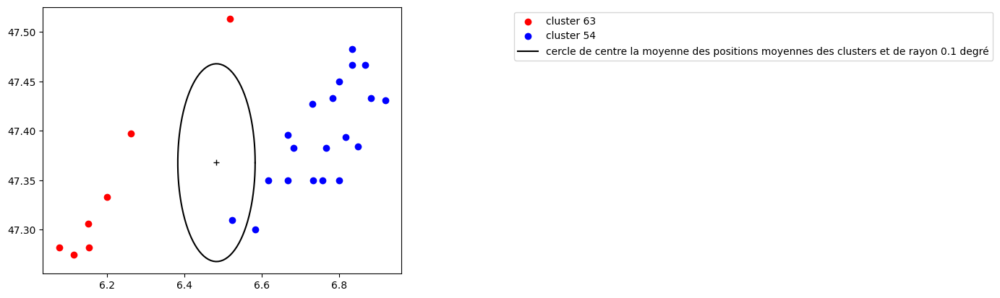

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3212  135507.833333    47.433      6.883      54
3213      135507.75    47.483      6.833      54
3214      135507.75    47.431      6.919      54
3215  135507.733333    47.467      6.867      54
3216       135507.7    47.433      6.783      54
3217  135507.683333    47.467      6.833      54
3218  135507.666667    47.384      6.849      54
3219      135507.65    47.394      6.817      54
3220  135507.616667    47.350      6.800      54
3221       135507.6    47.383      6.767      54
3222  135507.583333    47.350      6.757      54
3223  135507.566667    47.450      6.800      54
3224      135507.55    47.350      6.733      54
3225      135507.55    47.427      6.731      54
3226       135507.5    47.383      6.683      54
3227       135507.5    47.396      6.668      54
3228  135507.466667    47.350      6.617      54
3229      135507.45    47.350      6.667      54
3230  135507.416667    47.300      6.583      54
3231  135507.333333 

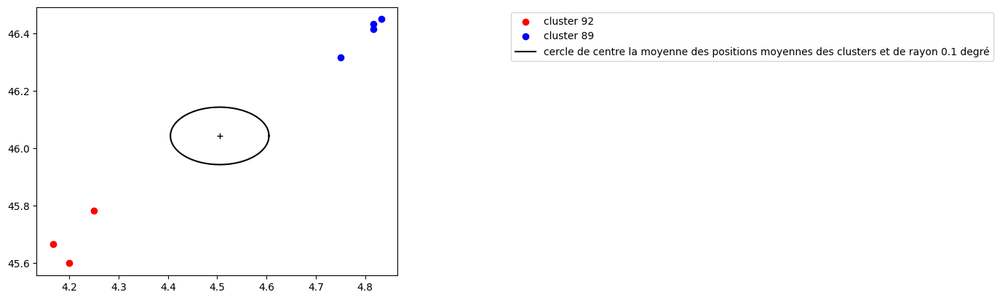

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3885      135380.95    46.450      4.833      89
3887  135380.916667    46.433      4.817      89
3890  135380.883333    46.417      4.817      89
3899  135380.716667    46.317      4.750      89
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3924  135379.666667    45.600      4.200      92
3925  135379.666667    45.783      4.250      92
3927  135379.416667    45.667      4.167      92


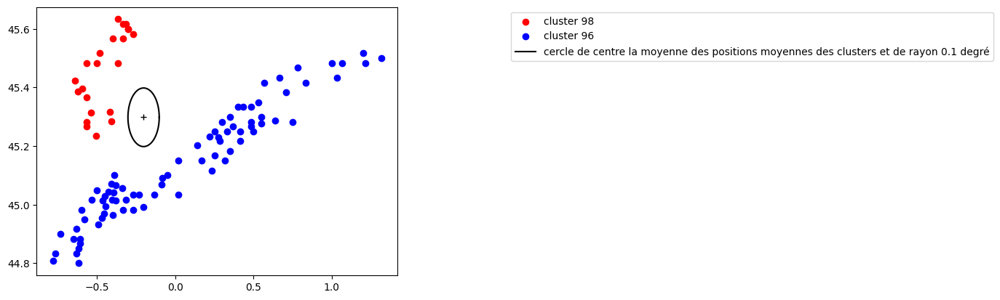

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
3951  135363.633333    45.500      1.317      96
3958  135363.433333    45.517      1.200      96
3959  135363.416667    45.483      1.217      96
3968  135363.166667    45.483      1.067      96
3969  135363.133333    45.433      1.033      96
...             ...       ...        ...     ...
4083  135361.083333    44.800     -0.617      96
4084  135361.066667    44.900     -0.733      96
4086  135361.033333    44.833     -0.633      96
4088       135361.0    44.833     -0.767      96
4089       135361.0    44.809     -0.781      96

[79 rows x 4 columns]
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4093      135360.95    45.617     -0.333      98
4095  135360.933333    45.633     -0.367      98
4100  135360.916667    45.600     -0.300      98
4101  135360.916667    45.617     -0.317      98
4102  135360.916667    45.567     -0.333      98
4103  135360.916667    45.600     -0.300      98
4106  135360.833333    45.317     -0.417      

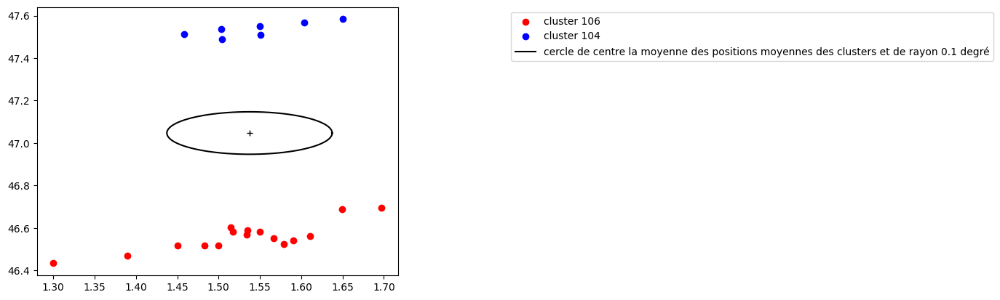

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333 

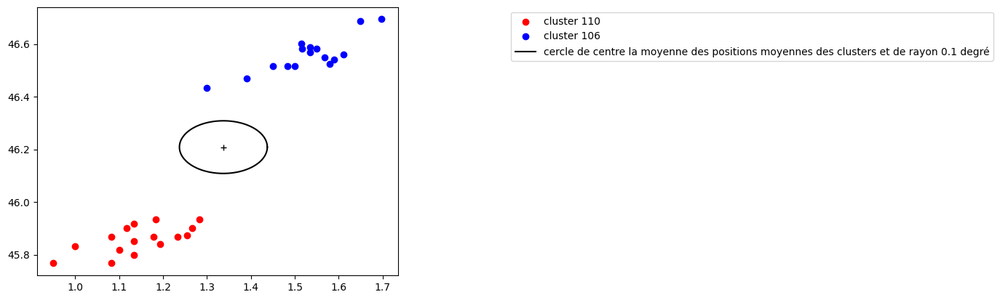

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4331  135337.516667    45.933      1.283     110
4339  135337.433333    45.873      1.254     110
4340  135337.433333 

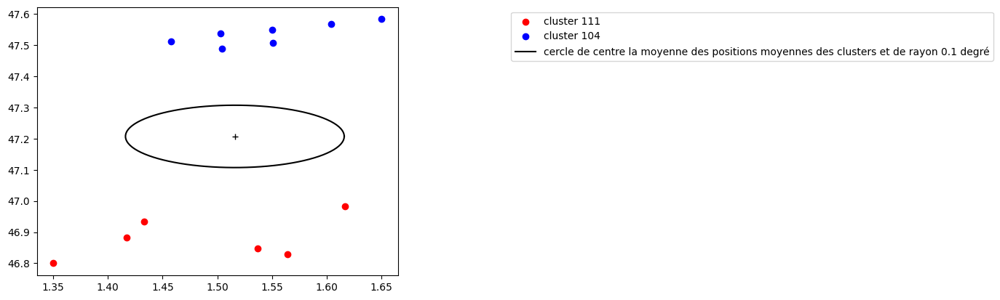

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4264  135338.666667    47.583      1.650     104
4266  135338.616667    47.567      1.604     104
4267  135338.583333    47.550      1.550     104
4268  135338.516667    47.508      1.551     104
4269       135338.5    47.538      1.503     104
4272  135338.433333    47.489      1.504     104
4275  135338.416667    47.512      1.458     104
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333    46.983      1.617     111
4395  135336.683333    46.933      1.433     111
4399  135336.616667    46.883      1.417     111
4401  135336.433333    46.800      1.350     111


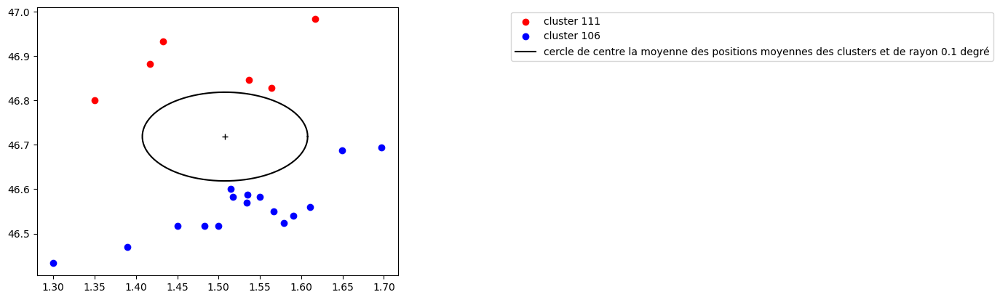

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4284       135338.3    46.694      1.697     106
4285  135338.283333    46.688      1.649     106
4291       135338.0    46.583      1.517     106
4292       135338.0    46.560      1.611     106
4293  135337.966667    46.583      1.550     106
4294  135337.966667    46.588      1.535     106
4295  135337.966667    46.540      1.590     106
4296  135337.966667    46.601      1.515     106
4298      135337.95    46.569      1.534     106
4300  135337.933333    46.550      1.567     106
4302  135337.916667    46.523      1.579     106
4306  135337.883333    46.517      1.450     106
4308      135337.85    46.517      1.500     106
4309      135337.85    46.517      1.483     106
4320  135337.666667    46.469      1.390     106
4327      135337.55    46.433      1.300     106
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
4346  135337.416667    46.828      1.564     111
4347  135337.416667    46.847      1.537     111
4387  135336.883333 

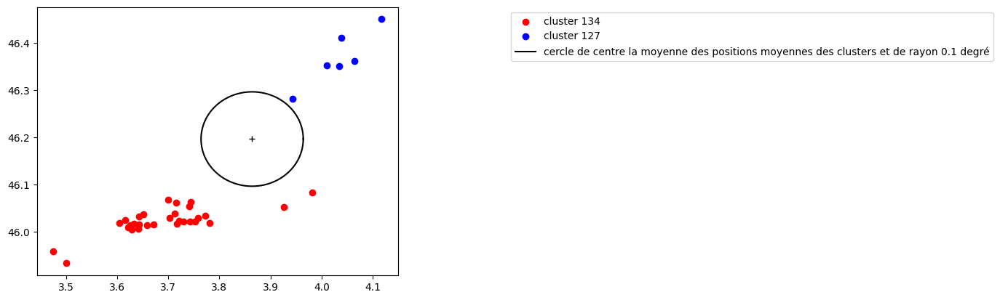

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5253  134976.916667    46.352      4.010     127
5254  134976.916667    46.362      4.064     127
5255  134976.916667    46.351      4.034     127
5258  134976.833333    46.450      4.117     127
5259  134976.833333    46.282      3.943     127
5260  134976.833333    46.411      4.039     127
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5328  134975.083333    46.083      3.982     134
5331  134974.916667    46.052      3.926     134
5339  134974.666667    46.034      3.773     134
5340  134974.666667    46.019      3.781     134
5342  134974.616667    46.022      3.752     134
5343  134974.616667    46.029      3.758     134
5344  134974.583333    46.022      3.743     134
5348       134974.5    46.017      3.717     134
5349       134974.5    46.023      3.721     134
5350       134974.5    46.021      3.729     134
5351  134974.466667    46.053      3.741     134
5352  134974.466667    46.063      3.744     134
5353  134974.433333 

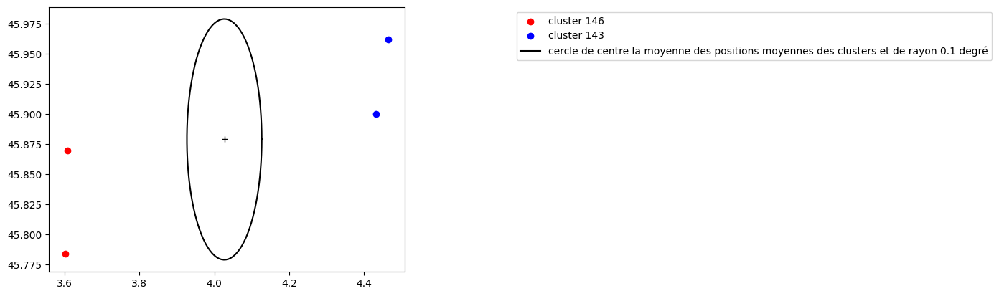

     TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5461  134953.75    45.962      4.466     143
5462  134953.75    45.900      4.433     143
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5482       134952.5    45.870      3.608     146
5492  134952.166667    45.784      3.601     146


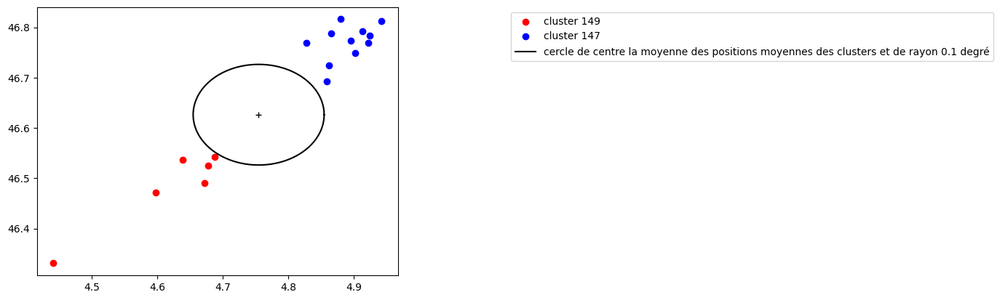

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5486  134952.233333    46.816      4.880     147
5487  134952.233333    46.812      4.942     147
5488       134952.2    46.792      4.913     147
5489       134952.2    46.783      4.924     147
5490  134952.166667    46.774      4.895     147
5491  134952.166667    46.769      4.922     147
5493  134952.133333    46.788      4.865     147
5494       134952.1    46.749      4.902     147
5495  134952.083333    46.769      4.828     147
5496  134951.983333    46.725      4.862     147
5497  134951.916667    46.692      4.859     147
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
5506  134951.616667    46.543      4.687     149
5508      134951.55    46.525      4.678     149
5511       134951.5    46.536      4.639     149
5515  134951.416667    46.490      4.672     149
5519  134951.366667    46.471      4.597     149
5520       134951.2    46.331      4.441     149


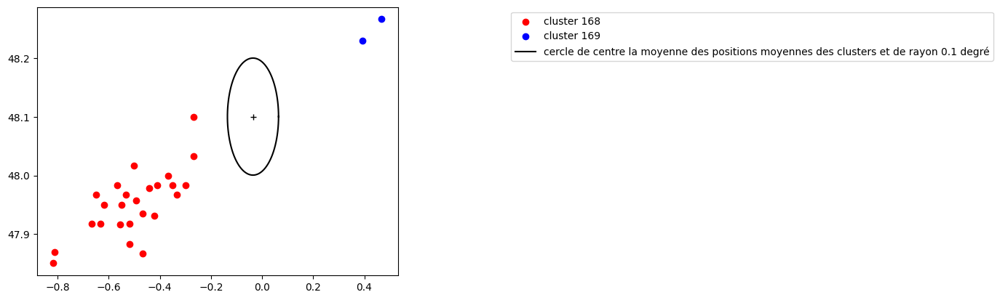

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6729       134605.2    48.267      0.467     169
6732  134605.116667    48.230      0.393     169
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15 

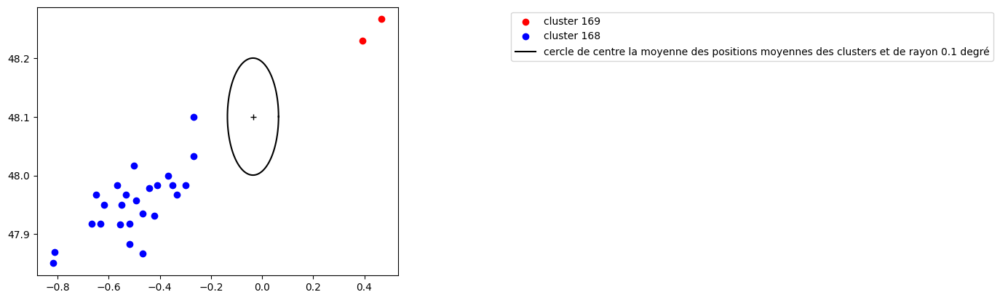

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6727  134605.916667    47.983     -0.300     168
6730  134605.166667    48.100     -0.267     168
6731  134605.133333    47.931     -0.423     168
6733  134605.083333    47.867     -0.467     168
6734       134605.0    47.883     -0.517     168
6735  134604.966667    47.967     -0.533     168
6736       134604.9    47.950     -0.550     168
6738  134604.766667    47.967     -0.650     168
6739  134604.666667    47.850     -0.817     168
6740  134604.666667    47.983     -0.567     168
6741  134604.333333    48.033     -0.267     168
6742  134604.283333    47.983     -0.350     168
6743      134604.25    47.967     -0.333     168
6744  134604.166667    48.000     -0.367     168
6745  134604.166667    47.935     -0.466     168
6746  134604.166667    47.983     -0.411     168
6747      134604.15    47.978     -0.441     168
6748       134604.1    47.957     -0.493     168
6749  134604.083333    47.916     -0.556     168
6750  134604.083333 

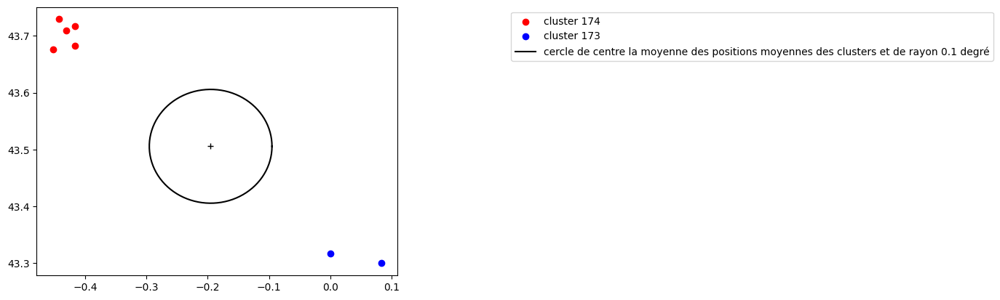

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6952       134496.4    43.300      0.083     173
6953  134496.183333    43.317      0.000     173
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174


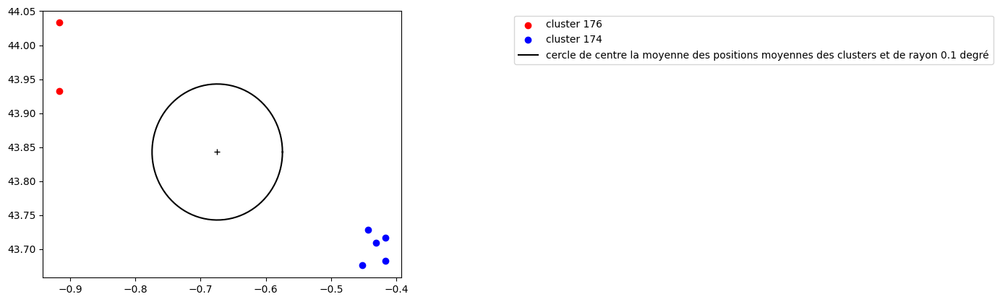

         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6959      134494.75    43.717     -0.417     174
6960  134494.716667    43.709     -0.431     174
6961  134494.716667    43.729     -0.443     174
6962  134494.666667    43.676     -0.452     174
6963  134494.666667    43.683     -0.417     174
         TIME_EVENT  LATITUDE  LONGITUDE  CLASSI
6972  134493.666667    43.933     -0.917     176
6979       134493.2    44.033     -0.917     176


In [ ]:
fusion_candi_2 = pipe_fusion_recur(visu_results_essai_3,3)

In [ ]:
[149,147] #nouvelle fusion

In [ ]:
visu_results_essai_3 = update_classi(visu_results_essai_3,[[149,147]])

In [ ]:
visu_results_essai_3

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
0,138376.166667,45.567,5.933,0
1,138375.783333,45.596,5.875,0
4,138358.416667,49.583,1.358,1
5,138358.333333,49.533,1.267,1
6,138358.3,49.521,1.251,1
...,...,...,...,...
7274,133961.583333,43.279,2.460,181
7275,133944.416667,44.600,-0.933,-1
7308,133604.2,48.669,5.114,-1
7309,133604.083333,48.636,4.952,-1


In [ ]:
len(np.unique(visu_results_essai_3.CLASSI,return_counts = False))

177

In [ ]:
#suite : mini stdbscan un peu moins restrictif que sur la poubelle puis (fusion cluster cluster et poubelle cluster) * répétition

# Allemagne

In [ ]:
demog_DE = pd.read_csv("/content/drive/MyDrive/population_deu_2019-07-01.csv")

In [ ]:
demog_DE.shape

(32446528, 3)

In [ ]:
demog_DE.head(3)

,Lat,Lon,Population
0,50.911806,6.717917,3.774709
1,52.041806,14.516250,0.931790
2,49.426250,7.744028,3.666325


In [ ]:
#arrondir les lat et long au centième et ensuite group by et sommer les densités

In [ ]:
demog_DE['LAT']=demog_DE['Lat'].apply(lambda data: round(data,3))
demog_DE['LONG']=demog_DE['Lon'].apply(lambda data: round(data,3))

In [ ]:
357588/32446528 # maillage 100 fois plus fin qu'en France

0.011020840195906323

In [ ]:
demog_DE = demog_DE.drop(columns=['Lat', 'Lon'])

In [ ]:
demog_small = demog_DE.groupby(["LAT", "LONG"]).sum()

In [ ]:
demog_small.head(3)

Population
LAT    LONG              
47.274 10.180    1.289519
47.278 10.179    3.868558
       10.195    2.579038

In [ ]:
demog_small.index

MultiIndex([(47.274,  10.18),
            (47.278, 10.179),
            (47.278, 10.195),
            ( 47.28, 10.178),
            ( 47.28,  10.23),
            (47.282, 10.219),
            (47.284, 10.206),
            (47.284, 10.207),
            (47.285,  10.22),
            (47.286, 10.212),
            ...
            (55.049,  8.438),
            (55.049,  8.444),
            ( 55.05,  8.427),
            (55.052,  8.401),
            (55.052,  8.402),
            (55.052,  8.409),
            (55.052,   8.41),
            (55.053,  8.401),
            (55.053,  8.409),
            (55.053,   8.41)],
           names=['LAT', 'LONG'], length=6689212)

In [ ]:
demog_small.loc[(47.278,10.179),:]

Population    3.868558
Name: (47.278, 10.179), dtype: float64

In [ ]:
demog_DE_new = demog_small.reset_index(level=[0,1])

In [ ]:
demog_DE_new

,LAT,LONG,Population
0,47.274,10.180,1.289519
1,47.278,10.179,3.868558
2,47.278,10.195,2.579038
3,47.280,10.178,1.289519
4,47.280,10.230,2.579038
...,...,...,...
6689207,55.052,8.409,1.626575
6689208,55.052,8.410,1.626575
6689209,55.053,8.401,4.879726
6689210,55.053,8.409,1.626575


In [ ]:
spa = [0.1,0.3,0.5,0.7]
for i in spa:
  visu(df5,'DE',2022,i,1,2)


In [ ]:
temp = [1,1.3,1.5,1.7,2]
for i in temp:
  visu(df5,'DE',2022,0.3,i,2)

#aucun changement

In [ ]:
data_DE = df5[df5.YEAR == 2022]
data_DE = data_DE[data_DE.COUNTRY == 'DE']
data_DE = data_DE[['TIME_EVENT','LATITUDE','LONGITUDE']]
model_DE = ST_DBSCAN(eps1=0.3, eps2=1,
                         min_samples=2)
model_DE.fit(data_DE)
classi_DE = model_DE.labels
visu_DE = data_DE.copy()
visu_DE['CLASSI'] = classi_DE
orages_DE = cluster2(data_DE,classi_DE)

In [ ]:
l_DE = np.unique(classi_DE, return_counts = True)[1]

In [ ]:
len(np.unique(classi_DE, return_counts = True)[0])

77

model = spatial:  0.3 , time : 1 , min_samples : 2
we cluster 76 orages in DE during the year 2022
we can't cluster 62 obsverations over 577 ( 10.7 %)
In DE during the year 2022 the mean number of observations per orage is 6.776
In DE during the year 2022 the median number of observations per orage is 4.0
the biggest orage has been reported 41 times
the biggest orage has moved : 1.2 longitude degrees and 0.2 latitude degrees
the biggest orage has last : 3 h 0 min


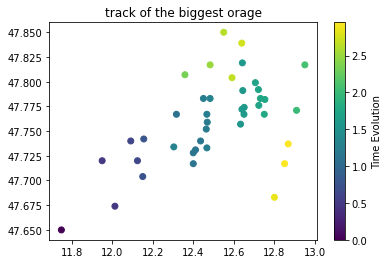

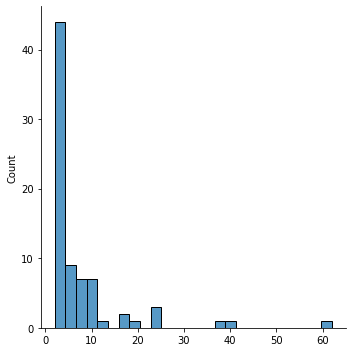

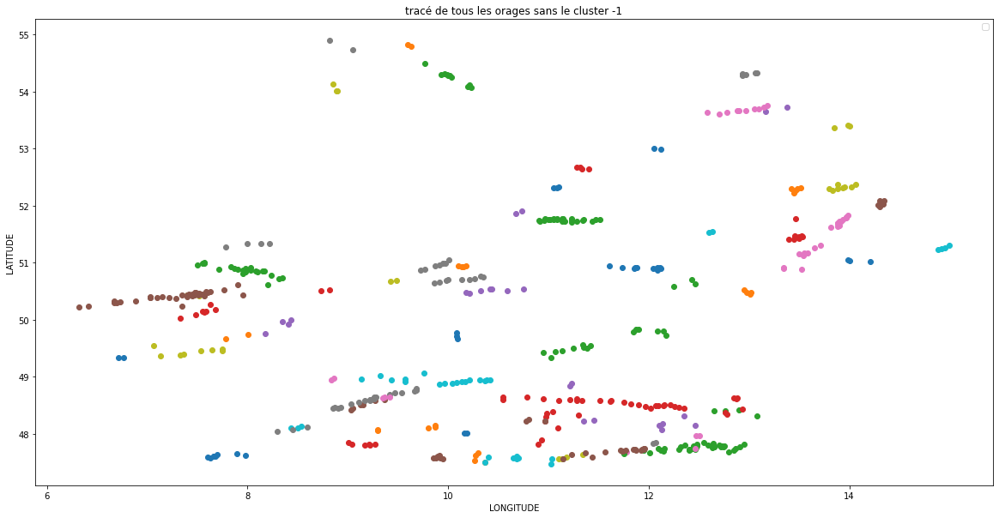

In [ ]:
results_DE = visu(df5,'DE',2022,0.3,1,2)

In [ ]:
#tracer distribution des pentes (voir si les orages vont dans le même sens)
#inclure aussi 2021 voire 2020 pour l'allemagne
#faire fusion clusters puis poubelle
#voir les petits clusters


In [ ]:
results_DE

,TIME_EVENT,LATITUDE,LONGITUDE,CLASSI
183,137544.083333,53.783,11.517,-1
184,137541.583333,53.550,12.983,-1
186,137539.75,52.983,12.117,0
187,137539.75,54.800,9.633,1
188,137539.666667,54.817,9.600,1
...,...,...,...,...
7117,134229.333333,50.667,10.483,-1
7166,134201.35,48.043,8.305,-1
7228,134032.416667,47.900,7.667,-1
7235,134012.583333,50.267,8.450,75


In [ ]:
n = len(results_DE)
x = [i for i in range(len(np.unique(classi_DE, return_counts = True)[0])-1)]
pentes_DE = []
for i in x:
  pentes_DE.append(regression(results_DE,i)[0])
  

In [ ]:
max(pentes_DE),min(pentes_DE)

(19.200000000004547, -4.558139534883545)

Text(0.5, 1.0, 'Zoom sur le centre')

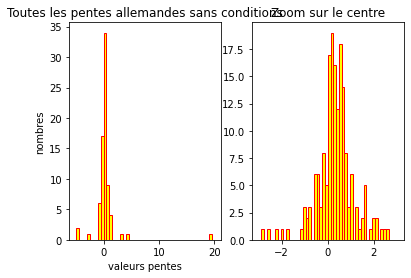

In [ ]:
plt.subplot(121)
plt.hist(pentes_DE, range = (-5,20), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('valeurs pentes')
plt.ylabel('nombres')
plt.title('Toutes les pentes allemandes sans conditions')

plt.subplot(122)
plt.hist(pentes, range = (-3,3), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.title('Zoom sur le centre')

Text(0.5, 1.0, 'Toutes les pentes allemandes en 2022 avec minimum 5 rapports')

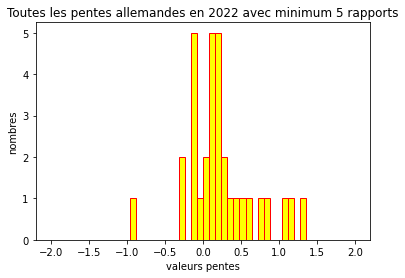

In [ ]:

xx_DE = [i for i in range(len(np.unique(classi_DE, return_counts = True)[0])-1)]
pentes2_DE = []
for i in xx_DE:
  if len(results_DE[results_DE.CLASSI == i]) >4:
    pentes2_DE.append(regression(results_DE,i)[0])
  
plt.hist(pentes2_DE, range = (-2,2), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('valeurs pentes')
plt.ylabel('nombres')
plt.title('Toutes les pentes allemandes en 2022 avec minimum 5 rapports' )

In [ ]:
pas = np.linspace(0.1,0.5,5)
for i in pas:
  visu_from_year(df5,'DE',2019,i,1,2)

model = spatial:  0.3 , time : 1 , min_samples : 2
we cluster 231 orages in DE during the year 2019
we can't cluster 245 obsverations over 1704 ( 14.4 %)
In DE during the year 2019 the mean number of observations per orage is 6.316
In DE during the year 2019 the median number of observations per orage is 3.0
the biggest orage has been reported 68 times
the biggest orage has moved : 2.558 longitude degrees and 0.75 latitude degrees
the biggest orage has last : 4 h 42 min


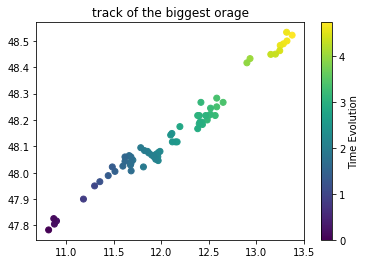

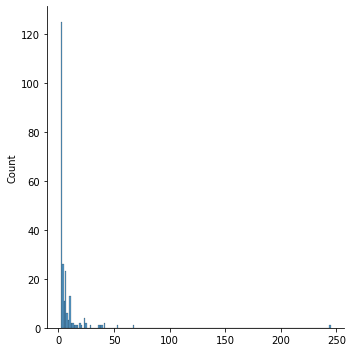

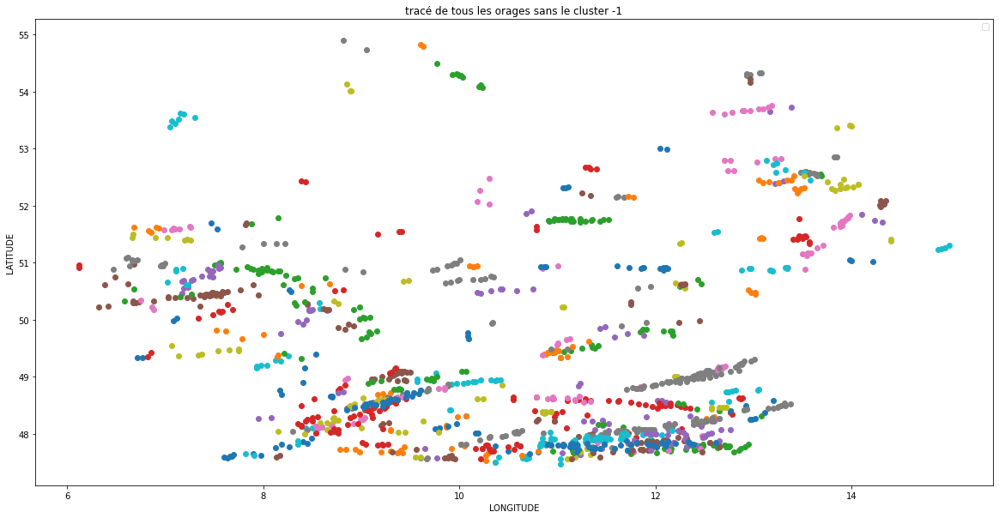

In [ ]:
results_DE_3y = visu_from_year(df5,'DE',2019,0.3,1,2)

In [ ]:
max(results_DE_3y['CLASSI'])

230

Text(0.5, 1.0, 'Toutes les pentes allemandes depuis 2020 avec minimum 4 rapports')

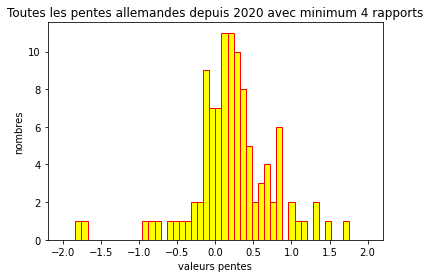

In [ ]:
xx_DE_3y = [i for i in range(max(results_DE_3y['CLASSI'])+1)]
pentes3_DE = []
for i in xx_DE_3y:
  if len(results_DE_3y[results_DE_3y.CLASSI == i]) >3:
    pentes3_DE.append(regression(results_DE_3y,i)[0])
  
plt.hist(pentes3_DE, range = (-2,2), bins = 50, color = 'yellow',
            edgecolor = 'red')
plt.xlabel('valeurs pentes')
plt.ylabel('nombres')
plt.title('Toutes les pentes allemandes depuis 2020 avec minimum 4 rapports' )

In [ ]:
regression_visu(visu_DE,11),regression_visu(visu_DE,8)

In [ ]:
condition_pente(visu_DE,11,8,20)